# Import Relevant Packages and Custom Helper Functions 

### - Stored in `BoT_Exports/helper.py` to make code cleaner across .ipynb notebooks and .py scripts

In [1]:
from helper import *

# Ignore FutureWarning
warnings.simplefilter(action='ignore', category=FutureWarning)
pd.set_option('mode.chained_assignment', None)  # to avoid SettingWithCopyWarning

In [2]:
df_export_ANALYSIS = pd.read_pickle("data/cleaned/total_export_FirstAnalysis.pkl")
display(df_export_ANALYSIS)
display(df_export_ANALYSIS.columns)

class,Agriculture,Rice,Rubber,Durian,Other_Fruits,"Horticultural_products,_n.i.e.",Animal_products,Fishery,Crustaceans,Fish,...,Medicinal_and_surgical_equipment_and_supplies,Toiletries_and_cosmetics,Furniture_and_parts,Other_Manufacturing_products,Other_Exports,Re-Exports_1,Total_Exports_(Customs_basis),Coverage_Adjustment,Timing_Adjustment,"Exports,_f.o.b._(BOP_basis)"
1995-01-01,584.19,196.61,229.04,0.54,1.97,116.57,39.46,212.42,152.2,33.27,...,20.84,8.56,61.75,258.65,50.89,11.44,3995.51,-67.51,0,3928
1995-02-01,550.96,186.2,216.29,0.58,2.6,104.63,40.65,178.9,120.85,30.25,...,19.48,9.14,57.44,260.53,40.87,4.8,3995.11,-46.11,0,3949
1995-03-01,605.24,175.64,238.01,3.29,4.13,132.28,51.9,248.28,176.01,37.45,...,21.91,14.36,75.61,348.3,67.21,6.24,5188.91,-105.91,0,5083
1995-04-01,453.51,107.99,181.01,11.73,6.4,103.94,42.44,204.25,146.65,30.94,...,17.15,10.83,54.71,249.9,43.43,7.11,4065.8,-60.8,0,4005
1995-05-01,587.16,191.15,216.77,15.06,12.38,107.54,44.26,241.44,177.62,35.12,...,22.08,11.66,69.34,323.11,62.26,6.44,4880.42,-91.42,0,4789
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-11-01,1552.72,637.49,361.63,48.69,191.81,159.33,153.77,131.44,67.61,37.64,...,166.14,306.43,142.73,877.52,266.27,27.45,23479.71,-379.79,0,23099.92
2023-12-01,1394.08,532.27,306.66,77.54,210.95,129.23,137.43,121.63,62.49,33.4,...,164.92,302.98,135.5,824.87,454.12,11.43,22791.55,-411.25,0,22380.3
2024-01-01,1536.73,602.49,326.87,48.63,240.71,163.27,154.76,129.63,57.6,40.46,...,182.95,308.17,118.5,790.58,493.7,21.75,22649.88,-637.67,0,22012.2
2024-02-01,1446.91,523.91,419.1,50.46,127.29,169.21,156.94,122.05,58.28,33.84,...,173.53,319.35,126.65,850.15,771.18,13.4,23384.86,-348.41,0,23036.45


Index(['Agriculture', 'Rice', 'Rubber', 'Durian', 'Other_Fruits',
       'Horticultural_products,_n.i.e.', 'Animal_products', 'Fishery',
       'Crustaceans', 'Fish', 'Cuttlefish,_squid,_octopus',
       'Fishery_products,_n.i.e.', 'Forestry', 'Mining', 'Crude_oil',
       'Mineral_products,_n.i.e.', 'Manufacturing',
       'Agro-manufacturing_Products', 'Apparels_and_Textile_Materials',
       'Footware_and_parts', 'Electronics', 'Electrical_Appliances',
       'Metal_&_Steel', 'Automotive',
       'Aircrafts,_ships,_floating_structures,_and_locomotive',
       'Machinery_&_Equipment', 'Jewellery',
       'Chemicals_&_Petro-chemical_Products', 'Petroleum_products',
       'Photographic_&_cinematographic_instruments_&_supplies',
       'Medicinal_and_surgical_equipment_and_supplies',
       'Toiletries_and_cosmetics', 'Furniture_and_parts',
       'Other_Manufacturing_products', 'Other_Exports', 'Re-Exports_1',
       'Total_Exports_(Customs_basis)', 'Coverage_Adjustment',
       'Timi

In [3]:
#combine deseasonalised data (previously some had issues with certian timeseries and had to be rerun after the loop)
# import os
# COMBINED_deseasonalised_value_dict = {}

# directory = "/home/wheelfredie/scripts/BoT_Exports/data/cleaned/deseasonalised_x13"

# for filename in os.listdir(directory):
#     if filename.endswith(".pickle") and "dict_deseasonalized_value" in filename:
#         with open(directory + "/" + filename, "rb") as f:
#             temp_dict = pickle.load(f)
#             COMBINED_deseasonalised_value_dict.update(temp_dict)
#             print(filename)

# with open("data/cleaned/COMBINED_deseasonalised_value_dict.pkl", "wb") as f:
#     pickle.dump(COMBINED_deseasonalised_value_dict, f)
    
with open("data/cleaned/COMBINED_deseasonalised_value_dict.pkl", "rb") as f:
    COMBINED_deseasonalised_value_dict = pickle.load(f)
    
display(COMBINED_deseasonalised_value_dict)

{'Rice':             observed     seasadj       trend  irregular  seasonal_factor
 1995-01-01    196.61  178.265141  186.478635   0.955955         1.102908
 1995-02-01    186.20  205.441992  180.540166   1.137930         0.906339
 1995-03-01    175.64  181.019323  173.110849   1.045684         0.970283
 1995-04-01    107.99  117.286865  164.738659   0.711957         0.920734
 1995-05-01    191.15  200.064212  156.435754   1.278891         0.955443
 ...              ...         ...         ...        ...              ...
 2023-11-01    637.49  527.750224  494.900962   1.066375         1.207939
 2023-12-01    532.27  453.193097  505.805571   0.895983         1.174488
 2024-01-01    602.49  539.961243  513.968437   1.050573         1.115802
 2024-02-01    523.91  536.841248  523.435752   1.025611         0.975912
 2024-03-01    484.76  493.576523  535.992976   0.920864         0.982137
 
 [351 rows x 5 columns],
 'Rubber':             observed     seasadj       trend  irregular  seasonal_

# Analyse each of the individual component export timeseries (represented by cols)

# 1. **Agriculture**

In [4]:
df = df_export_ANALYSIS.copy()
name = df.columns[0]
name

'Agriculture'

class,Agriculture
1995-01-01,584.19
1995-02-01,550.96
1995-03-01,605.24
1995-04-01,453.51
1995-05-01,587.16
...,...
2023-11-01,1552.72
2023-12-01,1394.08
2024-01-01,1536.73
2024-02-01,1446.91


<Axes: title={'center': 'Export Value % Change (Agriculture)'}>

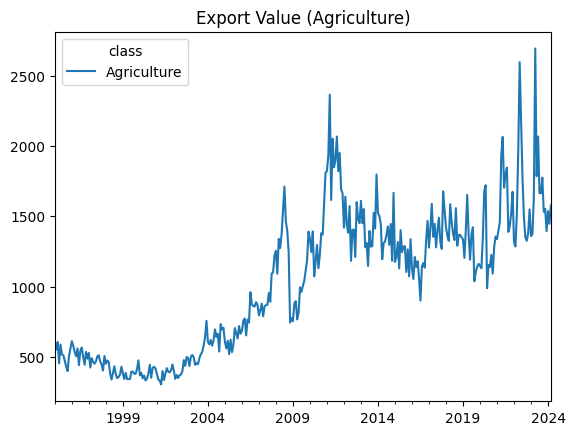

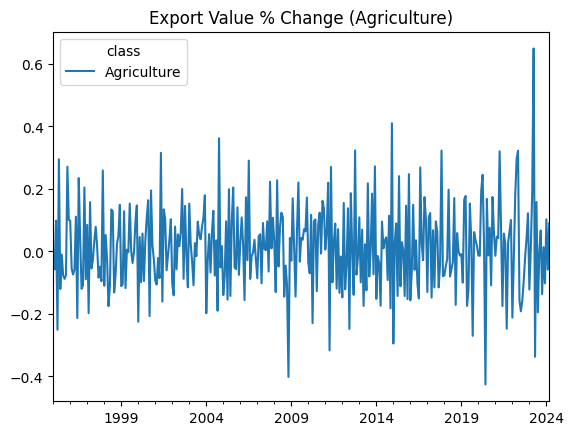

In [5]:
df = df_export_ANALYSIS[[name]]
display(df)
df.plot(title=f"Export Value ({name})", label=f"{name}")
df.pct_change().plot(title=f"Export Value % Change ({name})", label=f"{name} % Change")

In [6]:
ts = df.pct_change().dropna()
ts

class,Agriculture
1995-02-01,-0.056882
1995-03-01,0.098519
1995-04-01,-0.250694
1995-05-01,0.294701
1995-06-01,-0.120393
...,...
2023-11-01,0.013478
2023-12-01,-0.102169
2024-01-01,0.102326
2024-02-01,-0.058449


### check if the data timeseries & statistical assumptions validity (stationary, seasonality, autocorrelation)

Running ADF Test for Stationarity...
ADF Statistic: -5.195082665088777
p-value: 8.997610064288814e-06
Critical Value 1%: -3.4502011472639724
Critical Value 5%: -2.8702852297358983
Critical Value 10%: -2.5714292194077513
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.11911592573952522
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


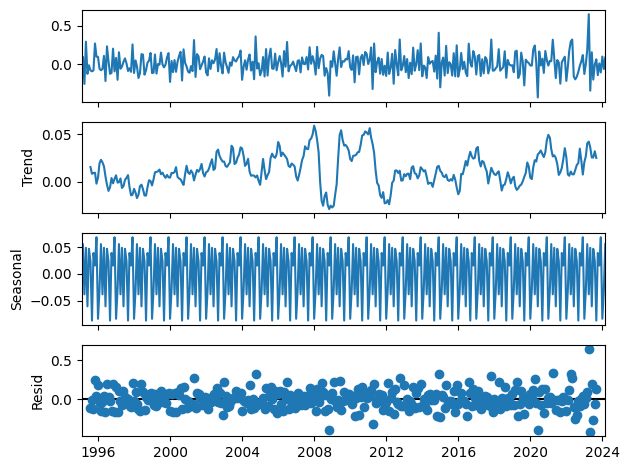


Plotting Residuals for Homoscedasticity Check...


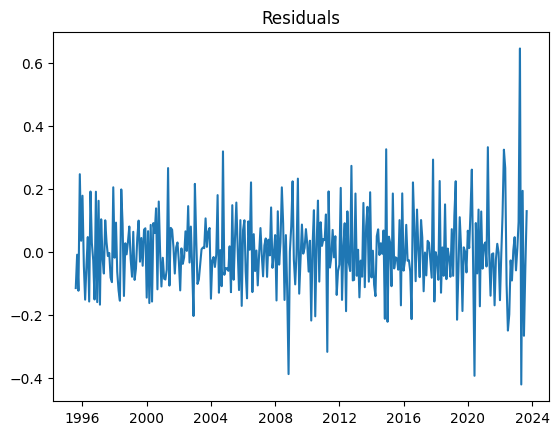

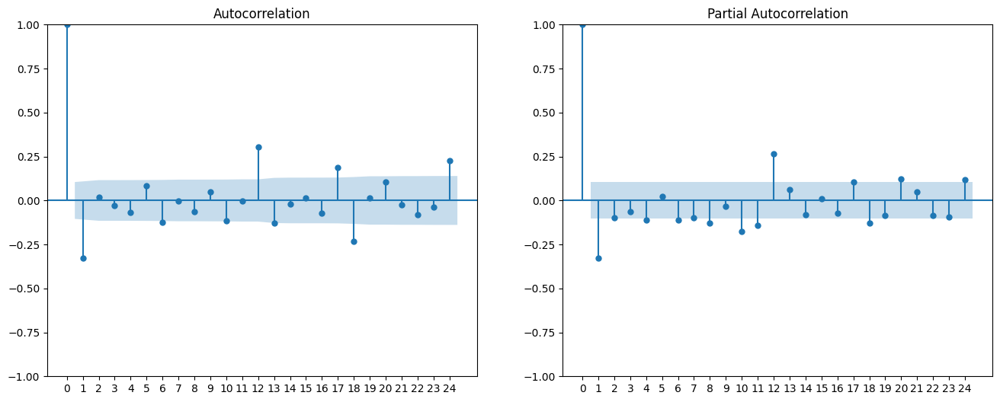


Time series assumptions are met.


True

In [7]:
#freq 12 is used since the data is monthly, so the seasonality is 12 months YoY
check_time_series_assumptions(ts, freq=12)

### Deseasonalise (by YoY and industry X-13)

#### **Setup for X-13 (ubuntu version, Windows OS can just be downloaded from the US Census page & add to PATH)**

Step 1: Download the X-13ARIMA-SEATS Executable
Open a terminal on your Ubuntu machine.
Download the Linux/Unix executable with ASCII output from the web:
```
https://www.census.gov/data/software/x13as.X-13ARIMA-SEATS.html
```
Step 2: Extract the Downloaded File
Extract the tar.gz file to a directory of choice, cd there:
```
sudo tar -xzf x13as_V1.1_B39.tar.gz -C /opt/x13as
```
The extracted directory should contain the `x13as` executable. 

Step 3: Change File permission to be executable w/o sudo
```
sudo chmod +x /home/wheelfredie/scripts/BoT_Exports/data/others/x13as/x13as_ascii
```

Step 4: Add to `$PATH`
```
nano ~/.bashrc
```

add:
```
export PATH="/home/wheelfredie/scripts/BoT_Exports/data/others/x13as:$PATH"
```
reload bash and exit terminal
```
source ~/.bashrc
```

Step 5: Command should work
```
x13as_ascii
```
otherwise investigate path via `echo $PATH' or directory permissions 


X-13 deseasonality, ran and saved as .pkl files

In [8]:
# X13-ARIMA-SEATS deseasonalization
# #DEsesonality using X13 by US Census Bureau
# from tqdm import tqdm
# import pickle
# import json
# import pandas as pd
# import numpy as np
# from statsmodels.tsa.x13 import x13_arima_analysis
# from statsmodels.tsa.x13 import X13Warning
# import warnings

# # Suppress specific X13 warnings
# warnings.filterwarnings("ignore", category=X13Warning)

# df = pd.read_csv('data/cleaned/total_export_ANALYSIS.csv', index_col=0)
# df.index = pd.to_datetime(df.index)

# x13_path='/home/wheelfredie/scripts/BoT_Exports/data/others/x13as'
# freq='M'

# dict_deseasonalized_value = {}
# dict_deseasonalized_pct_change = {}

# cols = df.columns.to_list()
# for col in tqdm(cols,
#                 desc='Deseasonalizing timeseries...'):
#    try:
#       #deseasonalize the value 
#       ts = df[col].replace(0, 1e-10).ffill().bfill().dropna()

#       result = x13_arima_analysis(ts, 
#                               x12path=x13_path, 
#                               freq=freq)

#       # Convert components to DataFrame
#       df1 = pd.DataFrame({
#                      'observed': result.observed,
#                      'seasadj': result.seasadj,
#                      'trend': result.trend,
#                      'irregular': result.irregular,
#                      'seasonal_factor': result.observed / result.seasadj
#                   })
#       dict_deseasonalized_value[col] = df1

#    except:
#       pass
    
#    try:
#       #deseasonalize the pct_change of the value
#       ts = ts.pct_change().replace(0, 1e-10).dropna()

#       result = x13_arima_analysis(ts, 
#                                  x12path=x13_path, 
#                                  freq=freq)

#       # Convert components to DataFrame
#       df2 = pd.DataFrame({
#                            'observed': result.observed,
#                            'seasadj': result.seasadj,
#                            'trend': result.trend,
#                            'irregular': result.irregular,
#                            'seasonal_factor': result.observed / result.seasadj
#                         })

#       dict_deseasonalized_pct_change[col] = df2
#    except:
#       pass
    
# #convert dictionary to pickle and json
# with open('/data/cleaned/deseasonalised_x13/dict_deseasonalized_value.pickle', 'wb') as handle:
#     pickle.dump(dict_deseasonalized_value, handle, protocol=pickle.HIGHEST_PROTOCOL)
    
# with open('/data/cleaned/deseasonalised_x13/dict_deseasonalized_pct_change.pickle', 'wb') as handle:
#     pickle.dump(dict_deseasonalized_pct_change, handle, protocol=pickle.HIGHEST_PROTOCOL)

#read the pickle file (UPDATED via 'update_sarimax.py' for latest code version)
with open(f'data/cleaned/deseasonalised_x13/update/dict_deseasonalized_value_{name}.pickle', 'rb') as handle:
    dict_deseasonalized_value = pickle.load(handle)[name]
adj_ts = dict_deseasonalized_value['seasadj'].pct_change().dropna()


Running ADF Test for Stationarity...
ADF Statistic: -6.504929905828064
p-value: 1.137401698060269e-08
Critical Value 1%: -3.4499043309021955
Critical Value 5%: -2.870154885338925
Critical Value 10%: -2.5713597190254385
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.07228608151793027
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


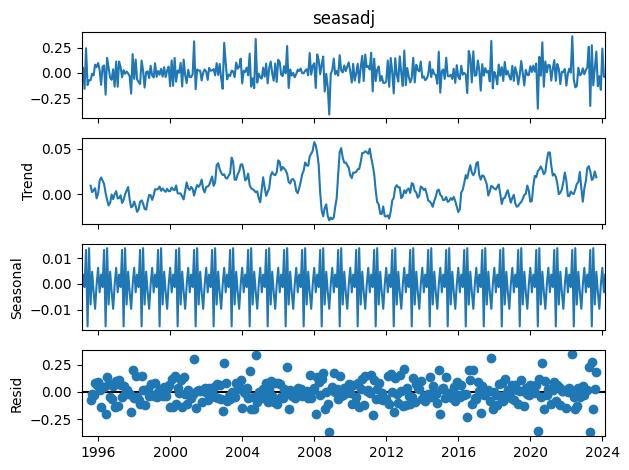


Plotting Residuals for Homoscedasticity Check...


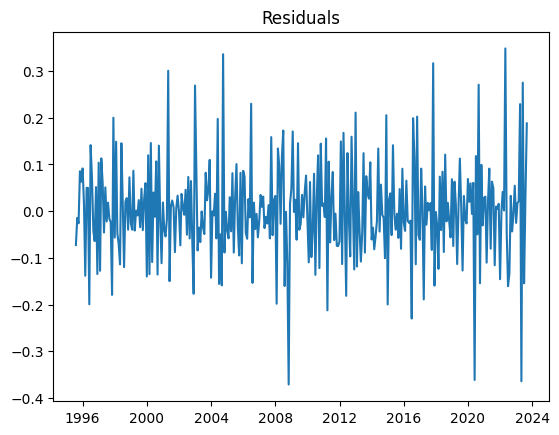

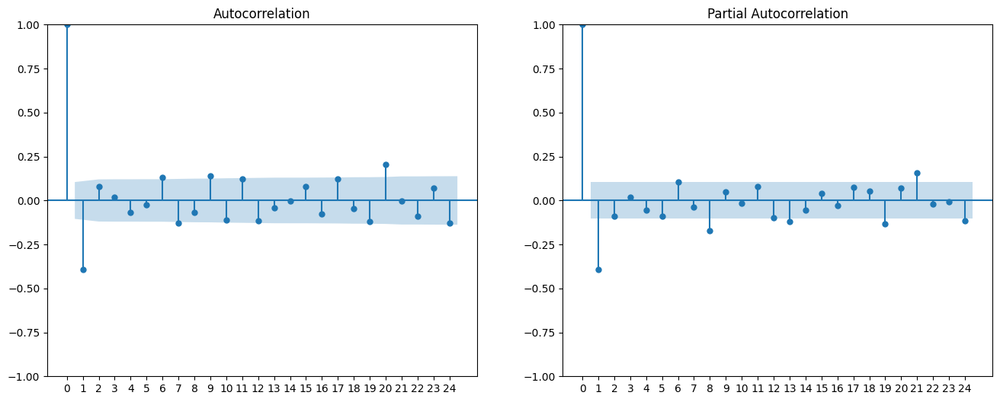


Time series assumptions are met.


True

In [9]:
check_time_series_assumptions(adj_ts, freq=12)

# Gridsearch for SARIMA parameters & validity

runtime: ~5minutes

In [10]:
# #this is actualling done on a rolling walk forward basis for the timeseries forecasting
# model = auto_arima(adj_ts, seasonal=True, m=12, trace=True, error_action='ignore', suppress_warnings=True)
# display(model.summary())

# Runtime ~40 minutes for rolling walkforward forecast, results saved as pickle

In [11]:
# #Walk Forward parameters
# window_size = 180  # 15 years of monthly data
# total_observations = len(adj_ts)  # Total data points
# steps = total_observations - window_size  # Remaining points after initial training window

# # Generate periods DataFrame
# periods_df = generate_periods_df(adj_ts, window_size, steps)
# # Display the DataFrame with walk-forward periods
# display(periods_df)

# # ###
# # #FOR TESTING
# # periods_df = periods_df[:5] ###REMOVE----REMOVE---REMOVE--FOR--LIVE RUN####
# # ###

# # Perform walk-forward forecasting
# rolling_forecasts = walk_forward_forecasting(adj_ts, periods_df)
# # Display the first few predictions
# display(rolling_forecasts)

## consolidated df of actual vs forecasted values with error metrics
# forecast = pd.DataFrame(rolling_forecasts, columns=['forecast'])
# actual = adj_ts[adj_ts.index.isin(forecast.index)]

# df_accuracy = calculate_accuracy_metrics(actual, forecast)
# df_accuracy

'''
As runtime is long,
67 + 4 extra = 71 Timeseries
Estimated runtime = 71 * (40/60)hours = >47+ hours with non linear compute scaling

Therefore this is pre-ran in parallel in bash terminal and loaded from the pickle file
Pre-ran script path: "BoT_Exports/run_sarimax_RollWalkForward.py"
'''
df_accuracy = pd.read_pickle(f"data/cleaned/SARIMA_RollWalkForward/combined/accuracy/df_accuracy_{name}.pickle")
df_accuracy.columns.name = name
display(df_accuracy)

Agriculture,actual,forecast,error,abs_error,squared_error,abs_percentage_error
2010-02-01,-0.095051,-0.025370,-0.069681,0.069681,0.004855,0.733089
2010-03-01,0.089923,0.027485,0.062439,0.062439,0.003899,0.694354
2010-04-01,-0.075884,-0.019145,-0.056739,0.056739,0.003219,0.747703
2010-05-01,-0.005640,0.037153,-0.042793,0.042793,0.001831,7.587469
2010-06-01,0.091125,-0.019013,0.110138,0.110138,0.012130,1.208641
...,...,...,...,...,...,...
2023-11-01,-0.031345,0.042831,-0.074176,0.074176,0.005502,2.366407
2023-12-01,-0.166677,0.061904,-0.228580,0.228580,0.052249,1.371399
2024-01-01,0.240665,0.079977,0.160688,0.160688,0.025821,0.667683
2024-02-01,-0.036947,-0.069714,0.032768,0.032768,0.001074,0.886891


### **Forecast are all Out-Of-Sample on a rolling basis**

'Total Mean Absolute Error (Per Forecast): 0.07682719459738918'

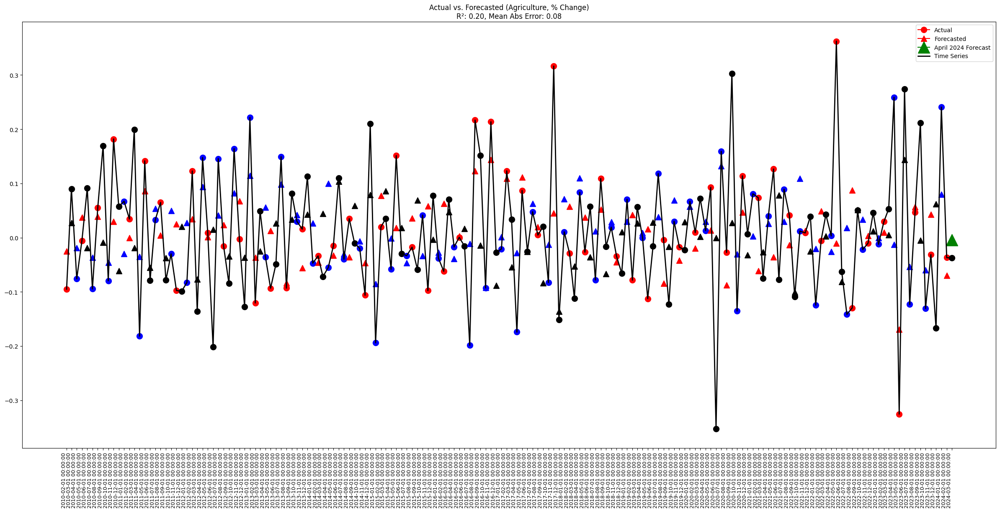

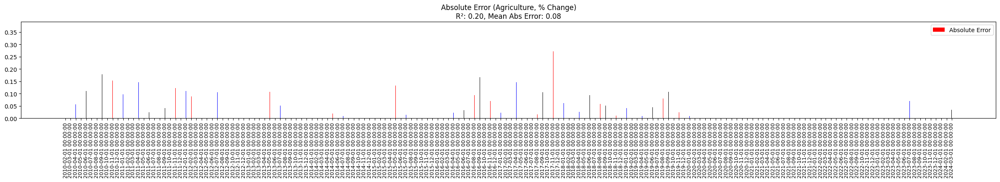

In [12]:
average_abs_error = df_accuracy["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_accuracy, name)

# These is repeated for analysis on the other timeseries
(However it is compressed into a cell for simplicity of read unless there is an issue with the timeseries in terms or statistical properties which requires further analysis/transformation/stabalization)

# Rice

In [13]:
df = df_export_ANALYSIS.copy()
name = df.columns[1]
display(f"Component: {name}")

'Component: Rice'

'Timeseries of component in % form:'

class,Rice
1995-02-01,-0.052947
1995-03-01,-0.056713
1995-04-01,-0.385163
1995-05-01,0.770071
1995-06-01,-0.315093
...,...
2023-11-01,0.216445
2023-12-01,-0.165054
2024-01-01,0.131926
2024-02-01,-0.130425


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -6.487194758089419
p-value: 1.252349578834437e-08
Critical Value 1%: -3.449846029628477
Critical Value 5%: -2.870129281376164
Critical Value 10%: -2.5713460670144603
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.031331742245834
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


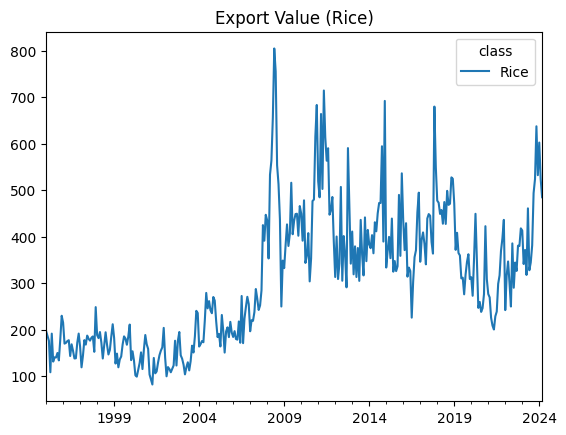

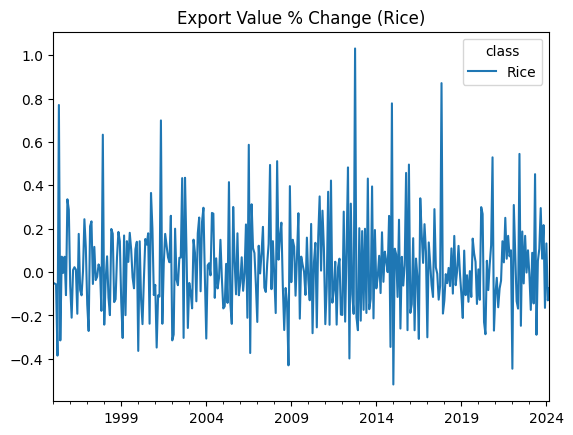

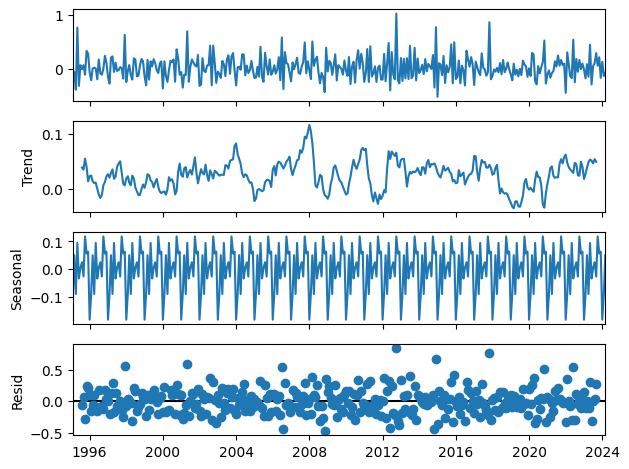


Plotting Residuals for Homoscedasticity Check...


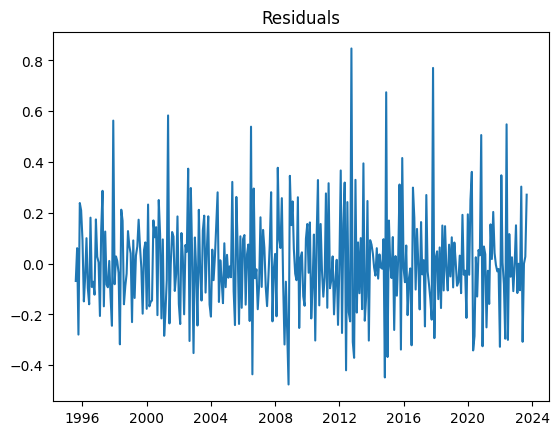

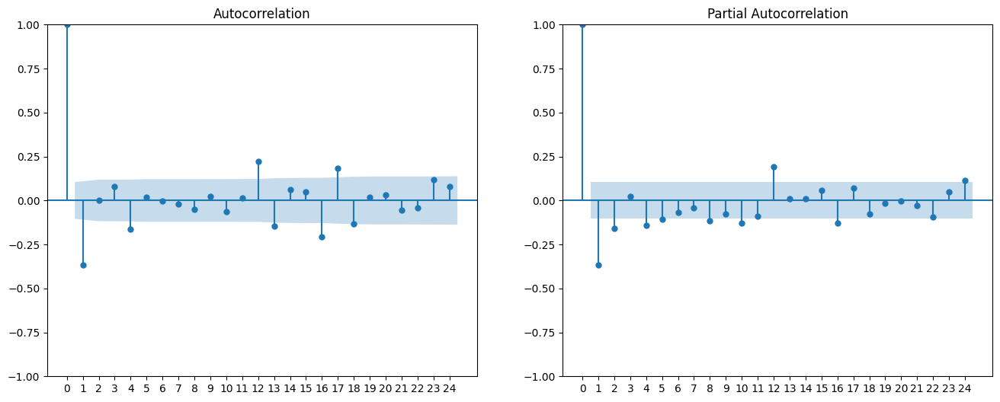


Time series assumptions are met.


True

'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -10.68959662059167
p-value: 3.755641134637406e-19
Critical Value 1%: -3.4494474563375737
Critical Value 5%: -2.8699542285903887
Critical Value 10%: -2.5712527305187987
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.036948282148716996
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


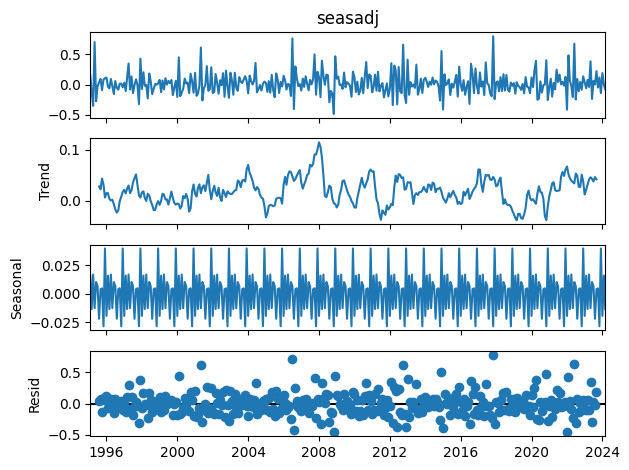


Plotting Residuals for Homoscedasticity Check...


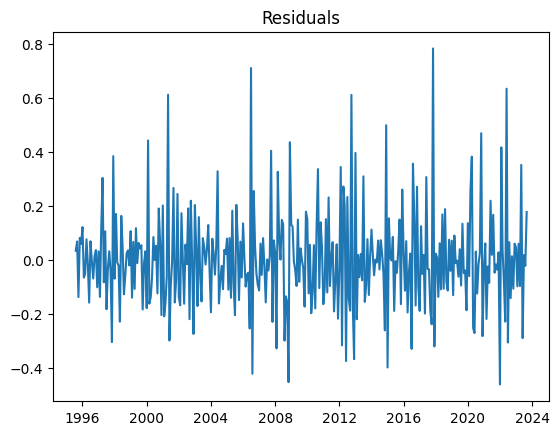

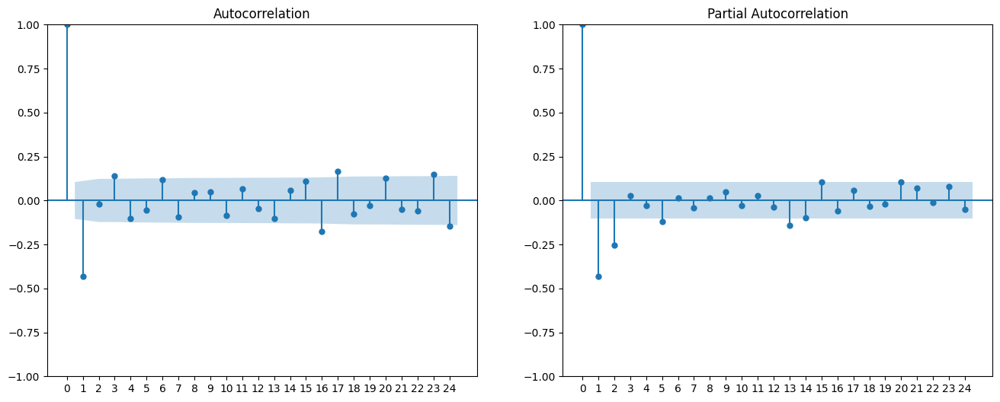


Time series assumptions are met.


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Data of Actual vs Forecasted values with error metrics:'

Rice,actual,forecast,error,abs_error,squared_error,abs_percentage_error
2010-02-01,-0.122352,-0.068625,-0.053727,0.053727,0.002887,0.439119
2010-03-01,0.047302,0.011891,0.035410,0.035410,0.001254,0.748604
2010-04-01,-0.163013,-0.016417,-0.146596,0.146596,0.021490,0.899287
2010-05-01,-0.100385,0.103554,-0.203940,0.203940,0.041591,2.031569
2010-06-01,0.109553,0.081706,0.027847,0.027847,0.000775,0.254188
...,...,...,...,...,...,...
2023-12-01,-0.141274,-0.033351,-0.107922,0.107922,0.011647,0.763925
2024-01-01,0.191460,0.175817,0.015642,0.015642,0.000245,0.081701
2024-02-01,-0.005778,-0.074062,0.068284,0.068284,0.004663,11.817517
2024-03-01,-0.080591,-0.046221,-0.034370,0.034370,0.001181,0.426471


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Total Mean Absolute Error (Per Forecast): 0.12881888593863053'

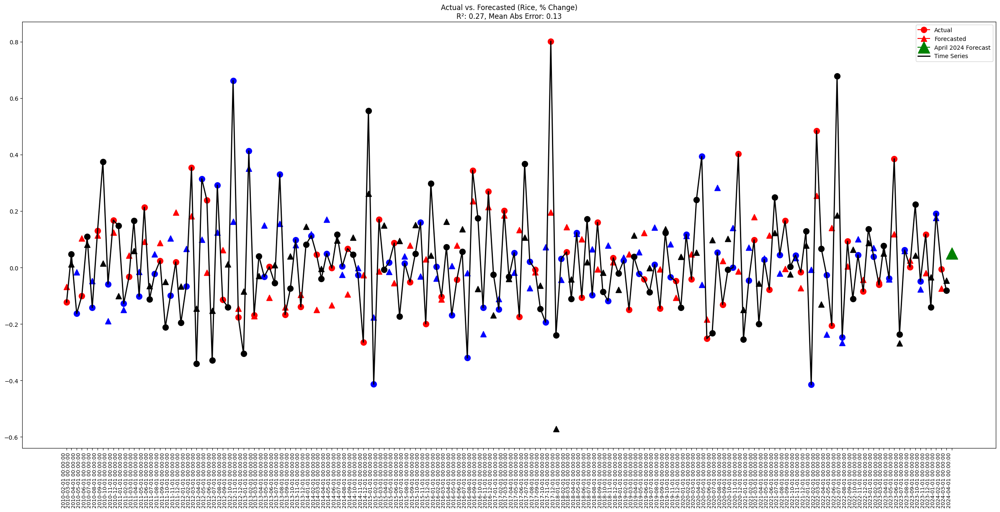

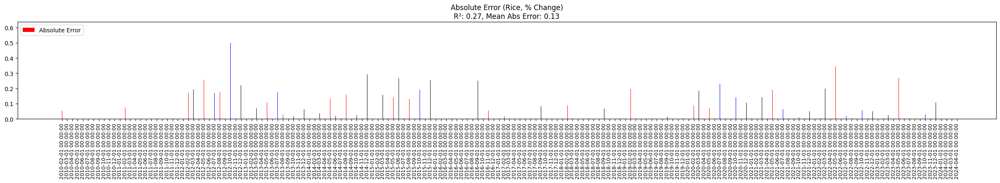

In [14]:
df = df_export_ANALYSIS[[name]]

df.plot(title=f"Export Value ({name})", label=f"{name}")
df.pct_change().plot(title=f"Export Value % Change ({name})", label=f"{name} % Change")
ts = df.pct_change().dropna()
display("Timeseries of component in % form:")
display(ts)
display("-" * 150)

### check if the data timeseries & statistical assumptions validity (stationary, seasonality, autocorrelation)
#freq 12 is used since the data is monthly, so the seasonality is 12 months YoY
display("Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):")
display(check_time_series_assumptions(ts, freq=12))
display("-" * 150)

#read the pickle file
with open(f'data/cleaned/deseasonalised_x13/update/dict_deseasonalized_value_{name}.pickle', 'rb') as handle:
    dict_deseasonalized_value = pickle.load(handle)[name]
adj_ts = dict_deseasonalized_value['seasadj'].pct_change().dropna()
display("Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):")
check_time_series_assumptions(adj_ts, freq=12)
display("-" * 150)

df_accuracy = pd.read_pickle(f"data/cleaned/SARIMA_RollWalkForward/combined/updated/accuracy/df_accuracy_{name}.pickle")
df_accuracy.columns.name = name
#Forecast are all Out-Of-Sample on a rolling basis
display("Data of Actual vs Forecasted values with error metrics:")
display(df_accuracy)
display("-" * 150)

#Plot Actual vs Forecasted values with error metrics
average_abs_error = df_accuracy["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_accuracy, name)


## Rubber

In [15]:
df = df_export_ANALYSIS.copy()
name = df.columns[2]
display(f"Component: {name}")

'Component: Rubber'

'Timeseries of component in % form:'

class,Rubber
1995-02-01,-0.055667
1995-03-01,0.100421
1995-04-01,-0.239486
1995-05-01,0.197558
1995-06-01,0.156848
...,...
2023-11-01,0.051189
2023-12-01,-0.152006
2024-01-01,0.065904
2024-02-01,0.282161


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -13.106077679704486
p-value: 1.671466152784553e-24
Critical Value 1%: -3.449336554273722
Critical Value 5%: -2.8699055166063085
Critical Value 10%: -2.571226758215748
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.1310051968820044
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


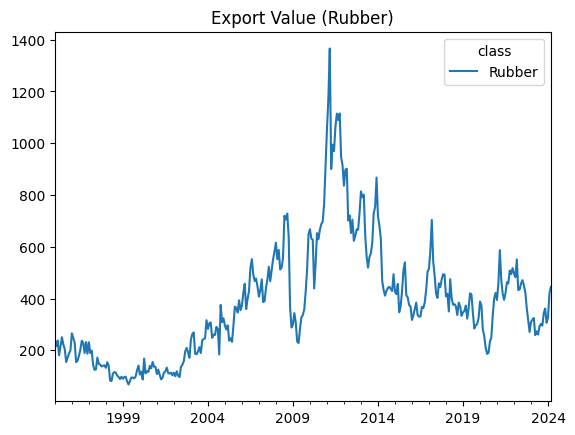

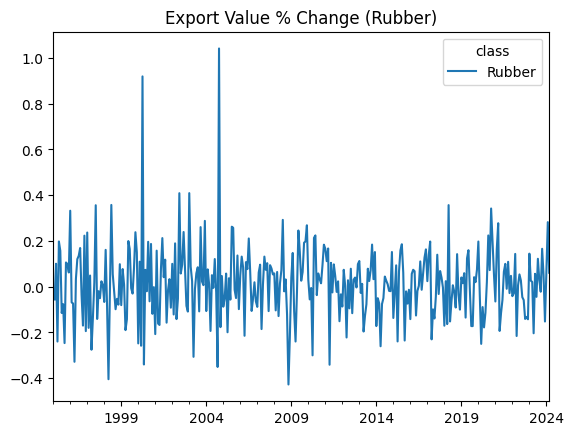

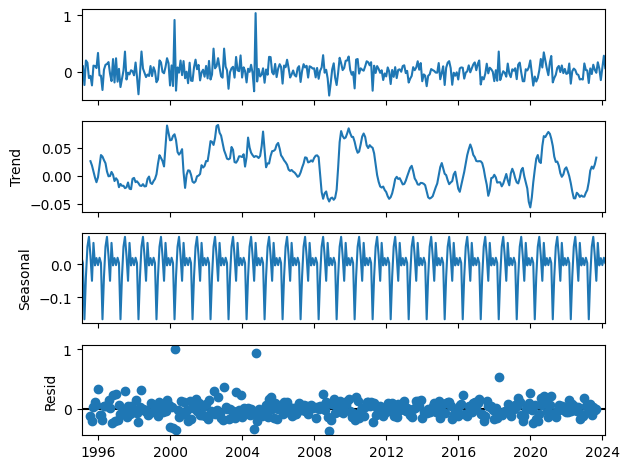


Plotting Residuals for Homoscedasticity Check...


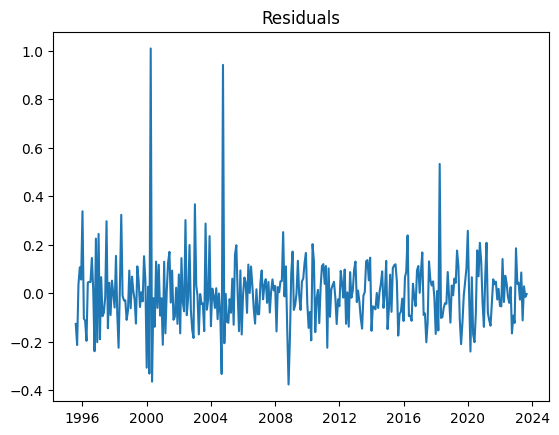

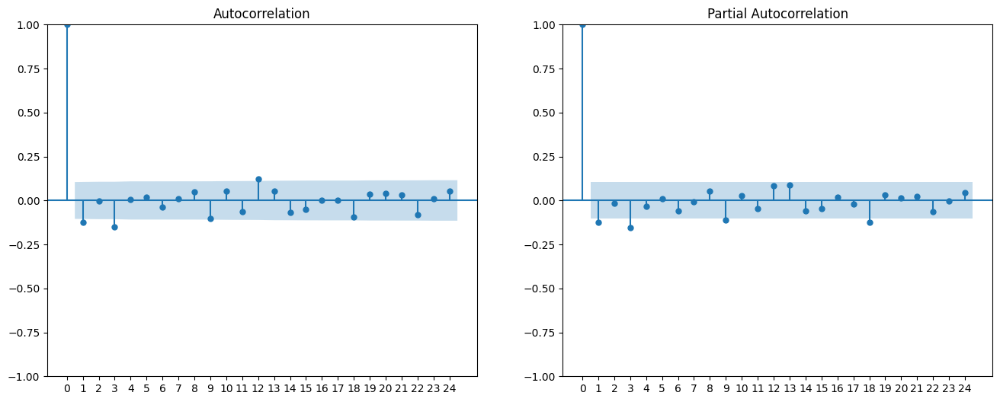


Time series assumptions are met.


True

'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -22.12214900240001
p-value: 0.0
Critical Value 1%: -3.449226932880019
Critical Value 5%: -2.869857365438656
Critical Value 10%: -2.571201085130664
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.14365447105696572
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


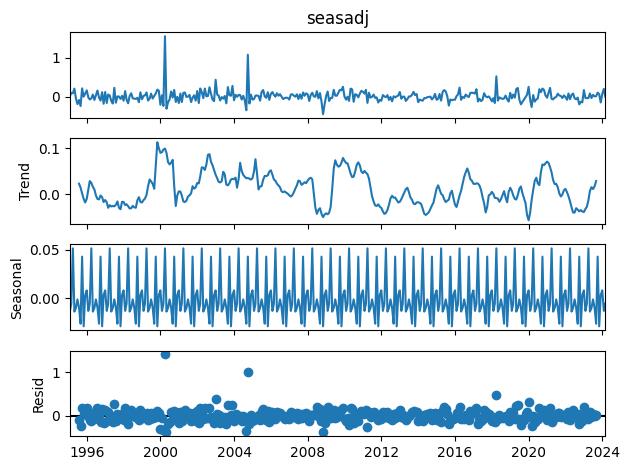


Plotting Residuals for Homoscedasticity Check...


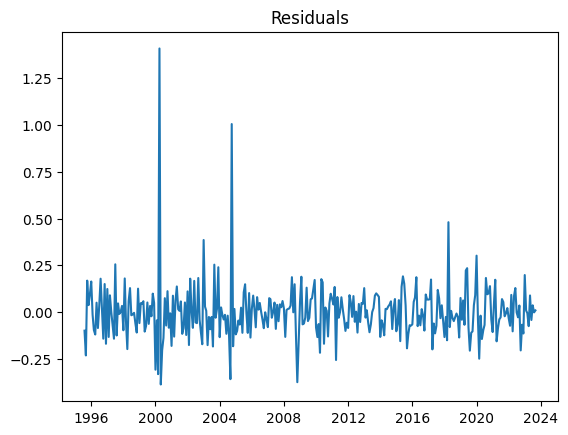

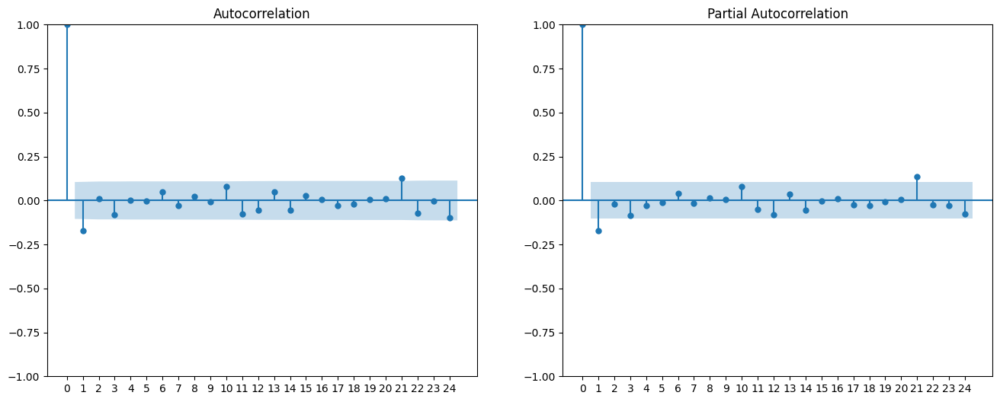


Time series assumptions are met.


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Data of Actual vs Forecasted values with error metrics:'

Rubber,actual,forecast,error,abs_error,squared_error,abs_percentage_error
2010-02-01,-0.078375,0.000334,-0.078709,0.078709,0.006195,1.004258
2010-03-01,-0.002378,0.041979,-0.044357,0.044357,0.001968,18.650189
2010-04-01,-0.109102,0.031840,-0.140942,0.140942,0.019865,1.291838
2010-05-01,0.207537,0.059429,0.148108,0.148108,0.021936,0.713648
2010-06-01,0.186257,-0.024825,0.211081,0.211081,0.044555,1.133282
...,...,...,...,...,...,...
2023-12-01,-0.151016,0.011612,-0.162629,0.162629,0.026448,1.076894
2024-01-01,0.070841,0.029946,0.040896,0.040896,0.001672,0.577284
2024-02-01,0.201136,0.017526,0.183609,0.183609,0.033712,0.912864
2024-03-01,0.000494,-0.028519,0.029013,0.029013,0.000842,58.749997


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Total Mean Absolute Error (Per Forecast): 0.08708156791004627'

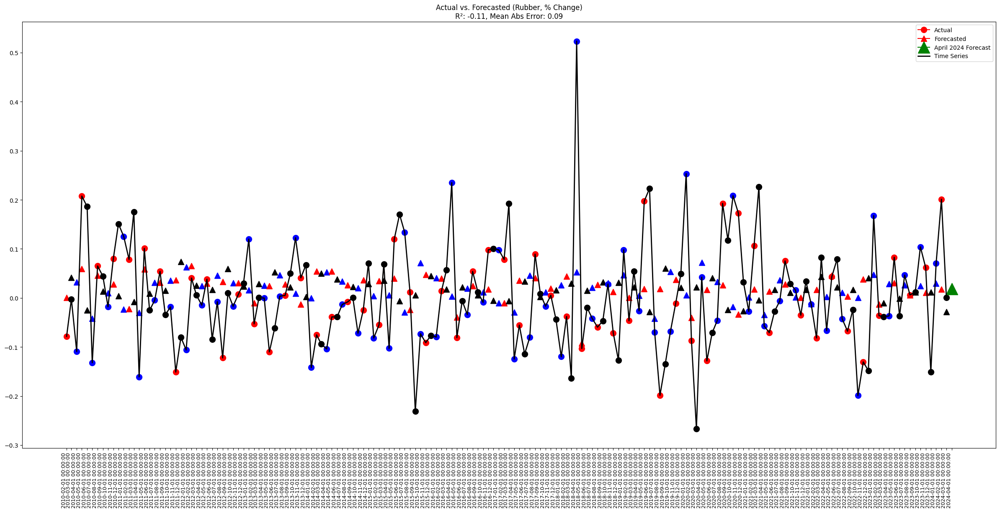

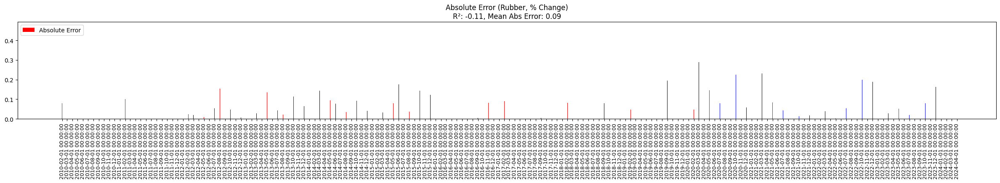

In [16]:
df = df_export_ANALYSIS[[name]]

df.plot(title=f"Export Value ({name})", label=f"{name}")
df.pct_change().plot(title=f"Export Value % Change ({name})", label=f"{name} % Change")
ts = df.pct_change().dropna()
display("Timeseries of component in % form:")
display(ts)
display("-" * 150)

### check if the data timeseries & statistical assumptions validity (stationary, seasonality, autocorrelation)
#freq 12 is used since the data is monthly, so the seasonality is 12 months YoY
display("Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):")
display(check_time_series_assumptions(ts, freq=12))
display("-" * 150)

#read the pickle file
with open(f'data/cleaned/deseasonalised_x13/update/dict_deseasonalized_value_{name}.pickle', 'rb') as handle:
    dict_deseasonalized_value = pickle.load(handle)[name]
adj_ts = dict_deseasonalized_value['seasadj'].pct_change().dropna()
display("Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):")
check_time_series_assumptions(adj_ts, freq=12)
display("-" * 150)

df_accuracy = pd.read_pickle(f"data/cleaned/SARIMA_RollWalkForward/combined/updated/accuracy/df_accuracy_{name}.pickle")
df_accuracy.columns.name = name
#Forecast are all Out-Of-Sample on a rolling basis
display("Data of Actual vs Forecasted values with error metrics:")
display(df_accuracy)
display("-" * 150)

#Plot Actual vs Forecasted values with error metrics
average_abs_error = df_accuracy["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_accuracy, name)


## Durian

In [17]:
df = df_export_ANALYSIS.copy()
name = df.columns[3]
display(f"Component: {name}")

'Component: Durian'

'Timeseries of component in % form:'

class,Durian
1995-02-01,0.074074
1995-03-01,4.672414
1995-04-01,2.565350
1995-05-01,0.283887
1995-06-01,-0.636786
...,...
2023-11-01,-0.252418
2023-12-01,0.592524
2024-01-01,-0.372840
2024-02-01,0.037631


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -2.666297288716745
p-value: 0.08005407384840707
Critical Value 1%: -3.4500219858626227
Critical Value 5%: -2.870206553997666
Critical Value 10%: -2.571387268879483
is_stationary: False

Running KPSS Test for Stationarity...
KPSS Statistic: 0.3833605025381945
p-value: 0.08432736959560583
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


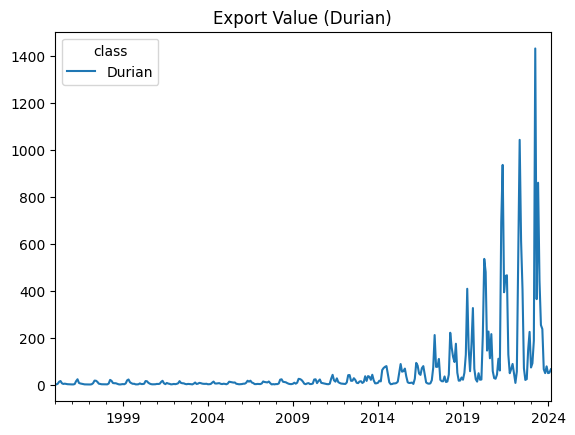

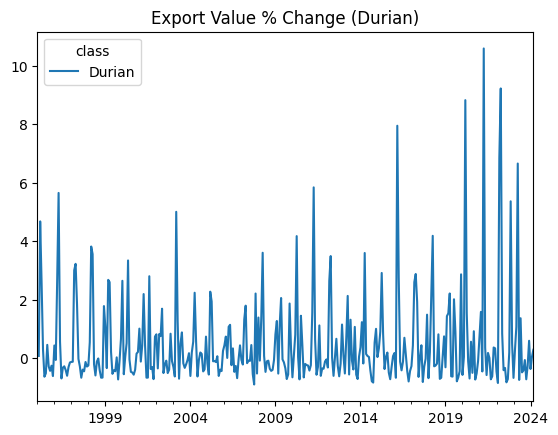

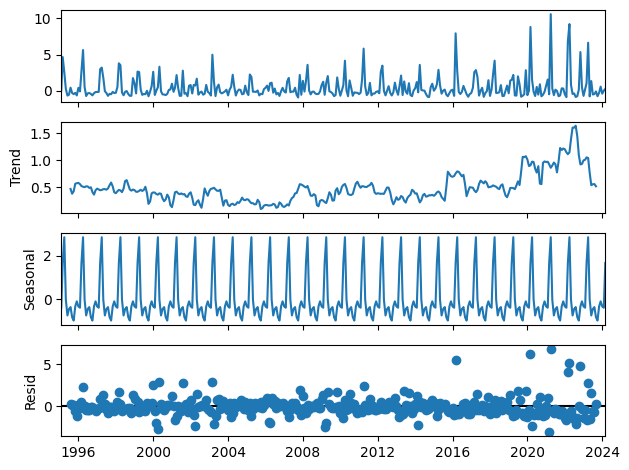


Plotting Residuals for Homoscedasticity Check...


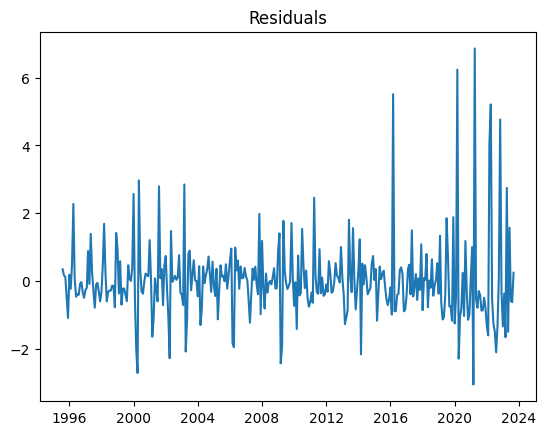

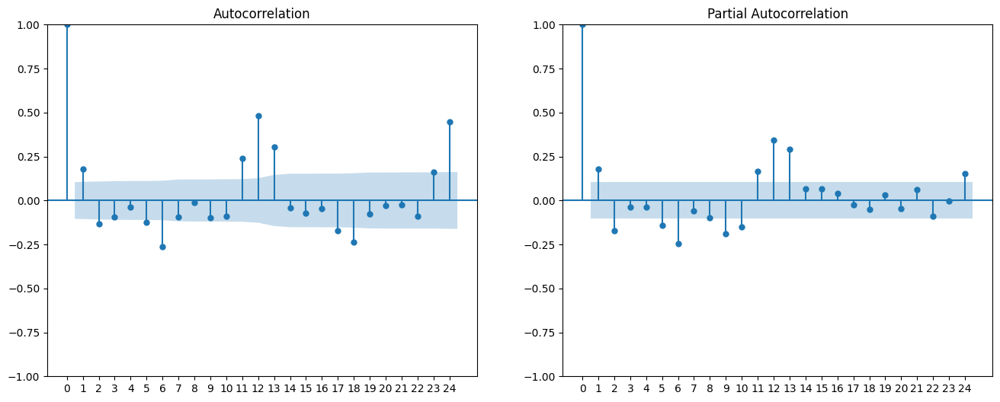


Time series assumptions are not met. Further investigation needed.


False

'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -5.654259579766532
p-value: 9.702019584150628e-07
Critical Value 1%: -3.449846029628477
Critical Value 5%: -2.870129281376164
Critical Value 10%: -2.5713460670144603
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.515421804117269
p-value: 0.03819328736097545
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: False

Decomposing the Series...


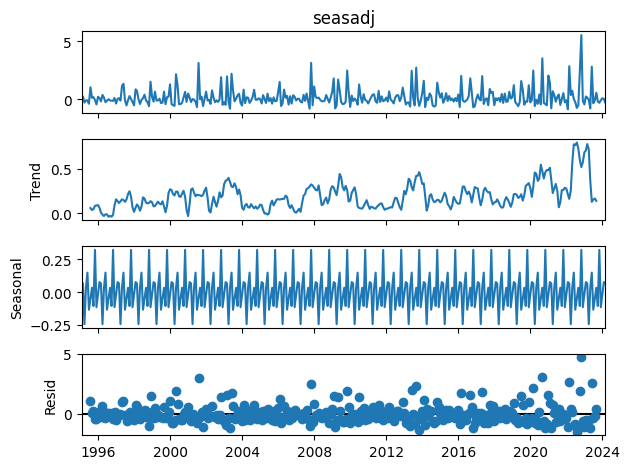


Plotting Residuals for Homoscedasticity Check...


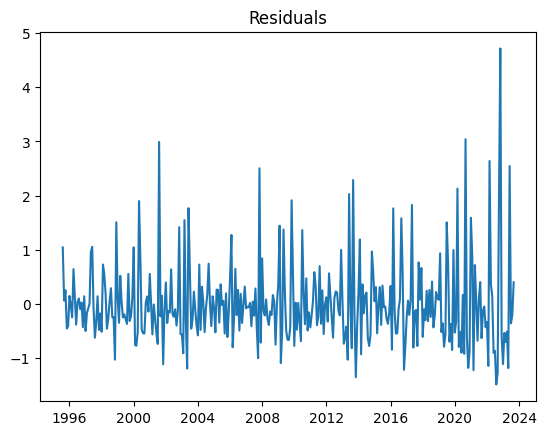

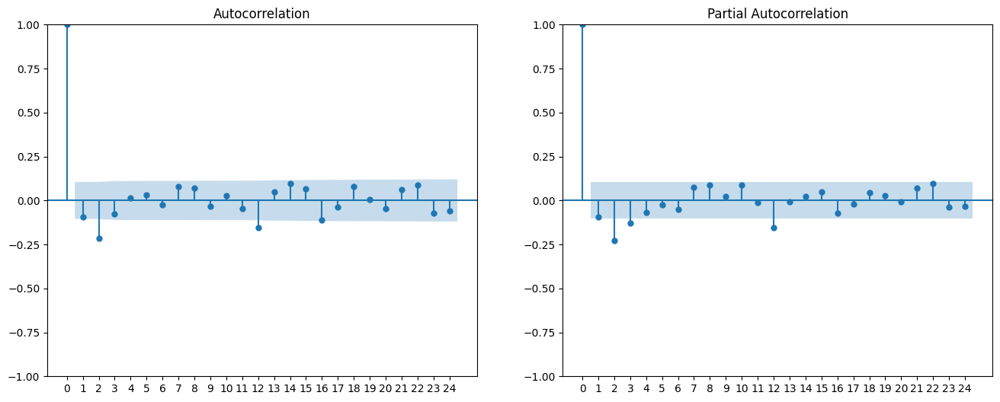


Time series assumptions are not met. Further investigation needed.


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Data of Actual vs Forecasted values with error metrics:'

Durian,actual,forecast,error,abs_error,squared_error,abs_percentage_error
2010-02-01,0.332411,-0.361639,0.694050,0.694050,0.481706,2.087926
2010-03-01,-0.143789,0.157522,-0.301311,0.301311,0.090788,2.095505
2010-04-01,0.069102,0.229410,-0.160309,0.160309,0.025699,2.319892
2010-05-01,-0.078682,0.046134,-0.124816,0.124816,0.015579,1.586333
2010-06-01,-0.458265,0.116006,-0.574271,0.574271,0.329787,1.253141
...,...,...,...,...,...,...
2023-12-01,-0.072090,0.630673,-0.702763,0.702763,0.493875,9.748452
2024-01-01,0.099303,0.479382,-0.380079,0.380079,0.144460,3.827463
2024-02-01,0.031235,0.560893,-0.529658,0.529658,0.280538,16.957061
2024-03-01,-0.284318,0.379214,-0.663532,0.663532,0.440275,2.333767


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Total Mean Absolute Error (Per Forecast): 0.544266247471325'

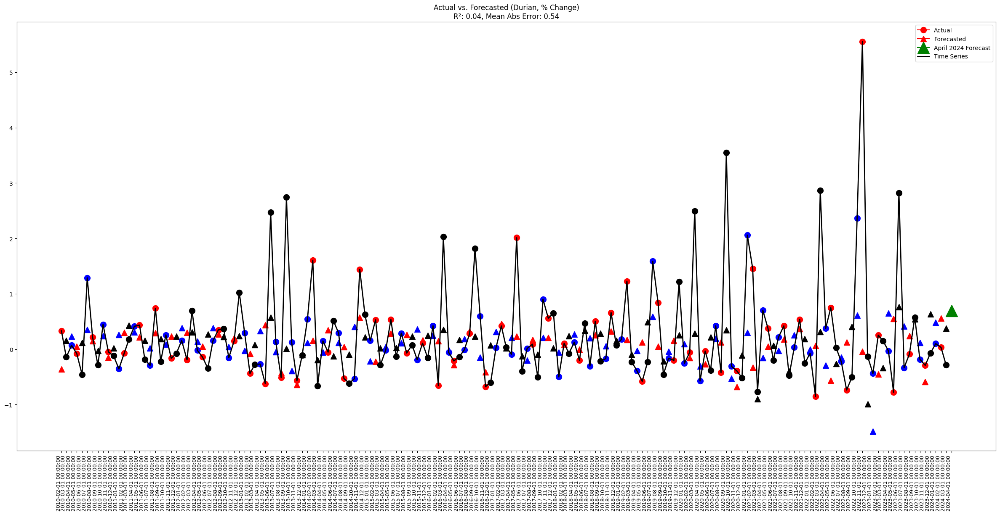

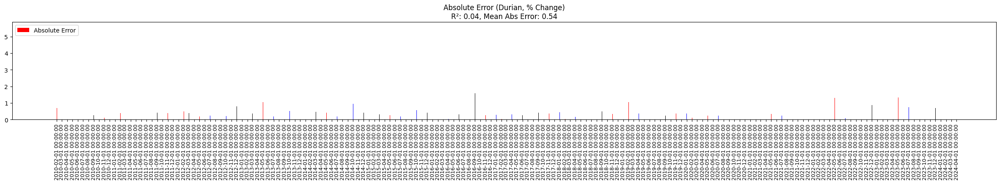

In [18]:
df = df_export_ANALYSIS[[name]]

df.plot(title=f"Export Value ({name})", label=f"{name}")
df.pct_change().plot(title=f"Export Value % Change ({name})", label=f"{name} % Change")
ts = df.pct_change().dropna()
display("Timeseries of component in % form:")
display(ts)
display("-" * 150)

### check if the data timeseries & statistical assumptions validity (stationary, seasonality, autocorrelation)
#freq 12 is used since the data is monthly, so the seasonality is 12 months YoY
display("Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):")
display(check_time_series_assumptions(ts, freq=12))
display("-" * 150)

#read the pickle file
with open(f'data/cleaned/deseasonalised_x13/update/dict_deseasonalized_value_{name}.pickle', 'rb') as handle:
    dict_deseasonalized_value = pickle.load(handle)[name]
adj_ts = dict_deseasonalized_value['seasadj'].pct_change().dropna()
display("Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):")
check_time_series_assumptions(adj_ts, freq=12)
display("-" * 150)

df_accuracy = pd.read_pickle(f"data/cleaned/SARIMA_RollWalkForward/combined/updated/accuracy/df_accuracy_{name}.pickle")
df_accuracy.columns.name = name
#Forecast are all Out-Of-Sample on a rolling basis
display("Data of Actual vs Forecasted values with error metrics:")
display(df_accuracy)
display("-" * 150)

#Plot Actual vs Forecasted values with error metrics
average_abs_error = df_accuracy["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_accuracy, name)


## In this event, even with adjustment, SARIMA Time series analysis does not do well, which can be seen due to generally tight forecast except for huge jumps in actual observed values. If the jumps are due to forecast, we can regulate it via percentile alogorithms. However as the shock is external from the historical timeseries, further factors like demand suvey, durian supply ssurvey and news sentiment might serve a better option. I also found that true simpler smoothing prediction models does not out perform SARIMA (which i will check below)

,actual,forecast,error,abs_error,squared_error,abs_percentage_error
2012-02-01,-0.193172,0.084174,-0.277347,0.277347,0.076921,1.435748
2012-03-01,0.693883,0.062275,0.631608,0.631608,0.398929,0.910251
2012-04-01,-0.021601,0.097178,-0.118779,0.118779,0.014108,5.498829
2012-05-01,-0.141372,0.093399,-0.234771,0.234771,0.055117,1.660658
2012-06-01,-0.348385,0.090787,-0.439172,0.439172,0.192872,1.260593
...,...,...,...,...,...,...
2023-11-01,-0.292977,0.484634,-0.777611,0.777611,0.604679,2.654173
2023-12-01,-0.072090,0.449995,-0.522085,0.522085,0.272573,7.242162
2024-01-01,0.099303,0.457572,-0.358269,0.358269,0.128356,3.607827
2024-02-01,0.031235,0.464780,-0.433545,0.433545,0.187961,13.879992


'Total Mean Absolute Error (Per Forecast): 0.6416991421054048'

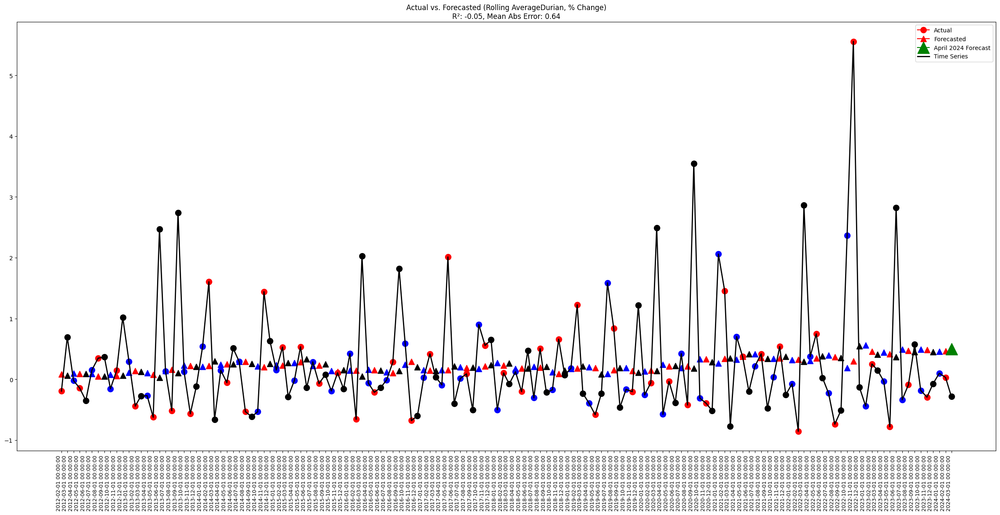

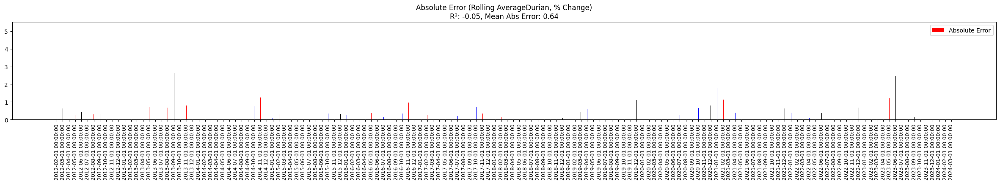

In [19]:
df_smoothing = df_accuracy[["actual", "forecast"]].copy(deep=True)
df_smoothing["forecast"] = df_smoothing["actual"].shift(1).rolling(window=24).mean()
df_smoothing = calculate_accuracy_metrics(df_smoothing["actual"], df_smoothing["forecast"]).dropna()
display(df_smoothing)
#Plot Actual vs Forecasted values with error metrics
average_abs_error = df_smoothing["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_smoothing, f"Rolling Average{name}")


Total Mean Absolute Error (Per Forecast): 0.6356185380573713


/home/wheelfredie/.local/share/virtualenvs/BoT_Exports-7Oxff3EB/lib/python3.10/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency MS will be used.
  self._init_dates(dates, freq)


'Total Mean Absolute Error (Per Forecast): 0.6356185380573713'

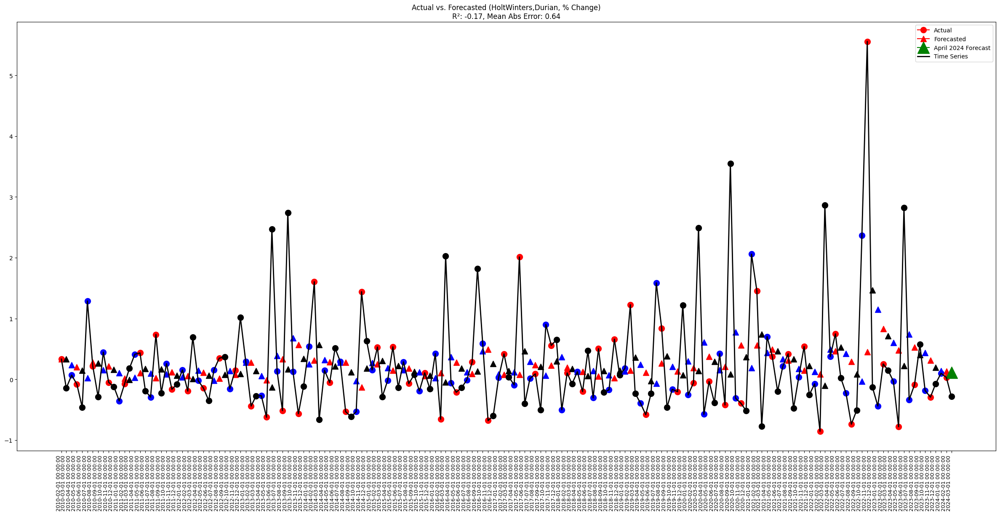

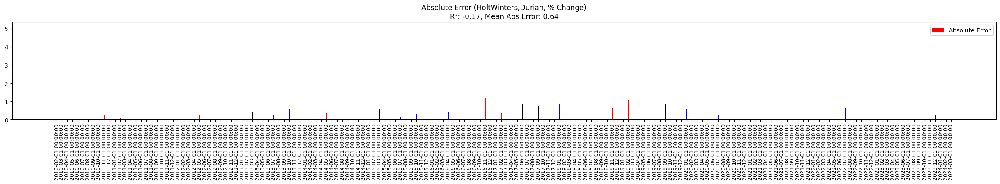

In [20]:
import pandas as pd
from statsmodels.tsa.holtwinters import SimpleExpSmoothing

model = SimpleExpSmoothing(df_accuracy['actual'])
fit_model = model.fit(smoothing_level=0.2, optimized=False)
df_accuracy['forecast'] = fit_model.fittedvalues

# Calculate accuracy metrics
df_smoothing = calculate_accuracy_metrics(df_accuracy['actual'], df_accuracy['forecast']).dropna()

# Plot Actual vs Forecasted values with error metrics
average_abs_error = df_smoothing['abs_error'].mean()
print(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_smoothing, f"HoltWinters,{name}")

Durian seems to lack AR properties and have poor predictability across models, with SARIMA still outperforming

## Other_Fruits

In [21]:
df = df_export_ANALYSIS.copy()
name = df.columns[4]
display(f"Component: {name}")

'Component: Other_Fruits'

'Timeseries of component in % form:'

class,Other_Fruits
1995-02-01,0.319797
1995-03-01,0.588462
1995-04-01,0.549637
1995-05-01,0.934375
1995-06-01,-0.359451
...,...
2023-11-01,-0.235817
2023-12-01,0.099786
2024-01-01,0.141076
2024-02-01,-0.471189


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -3.8686106871899493
p-value: 0.002278391766330927
Critical Value 1%: -3.4499043309021955
Critical Value 5%: -2.870154885338925
Critical Value 10%: -2.5713597190254385
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.3667018257796163
p-value: 0.09150783371568263
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


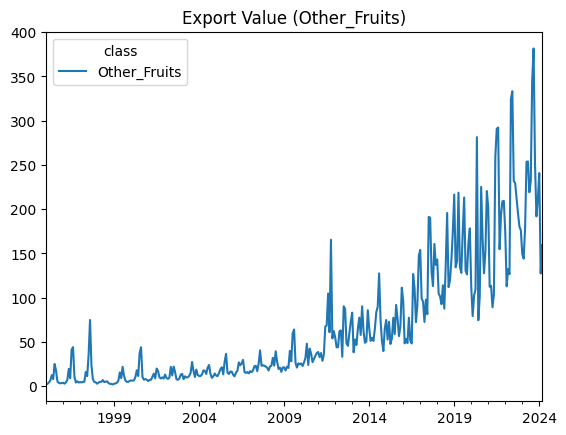

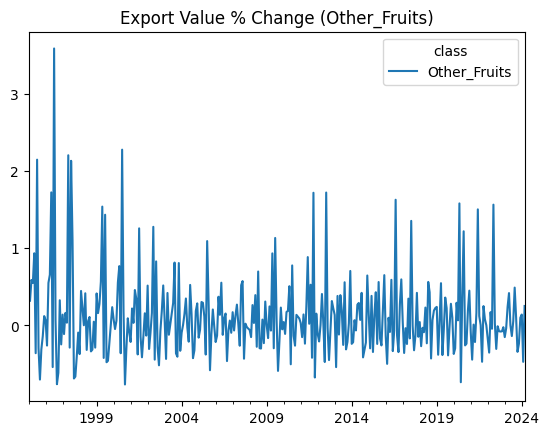

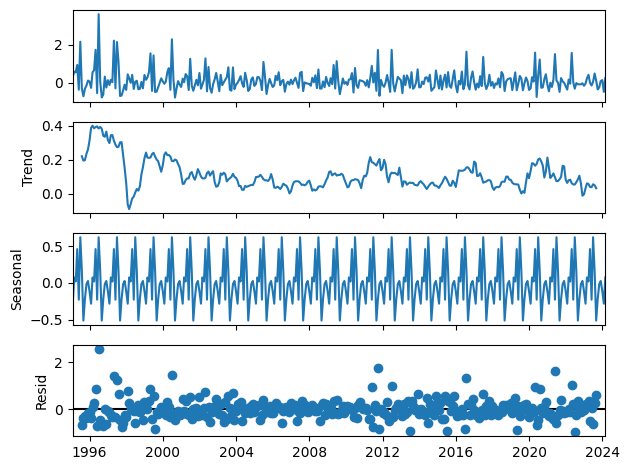


Plotting Residuals for Homoscedasticity Check...


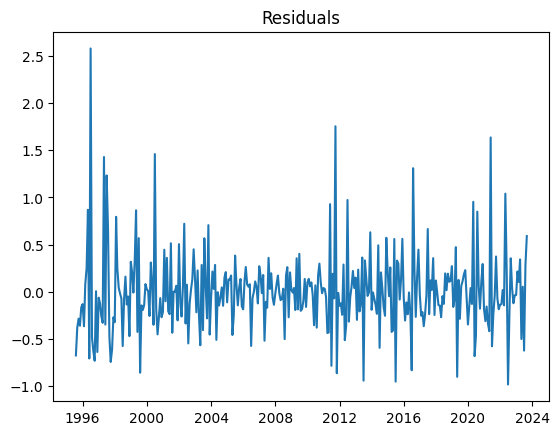

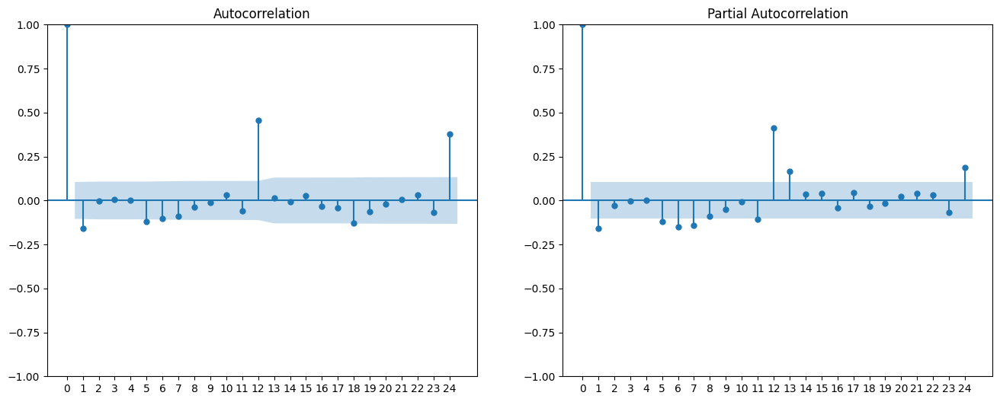


Time series assumptions are met.


True

'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -5.944683573091165
p-value: 2.2185558340651744e-07
Critical Value 1%: -3.4499043309021955
Critical Value 5%: -2.870154885338925
Critical Value 10%: -2.5713597190254385
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.050524861457597346
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


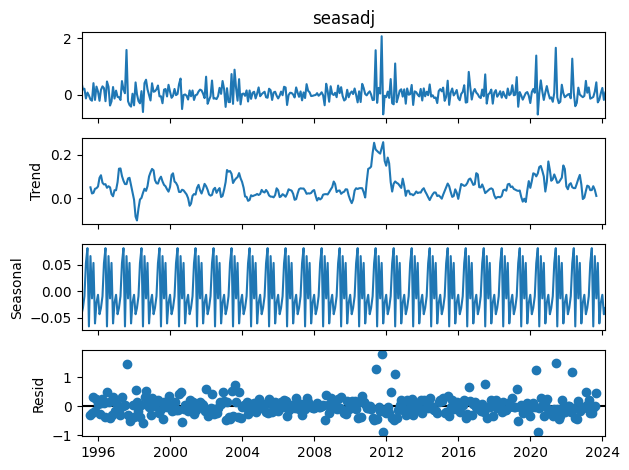


Plotting Residuals for Homoscedasticity Check...


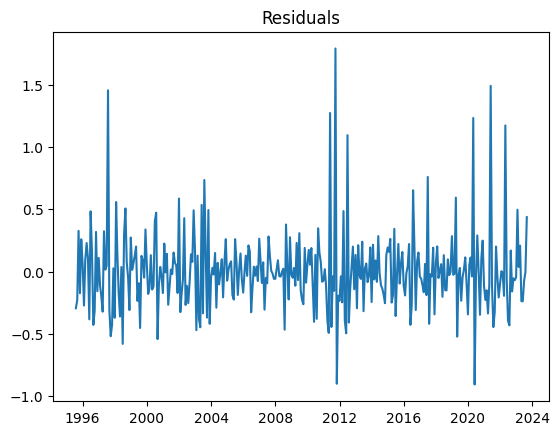

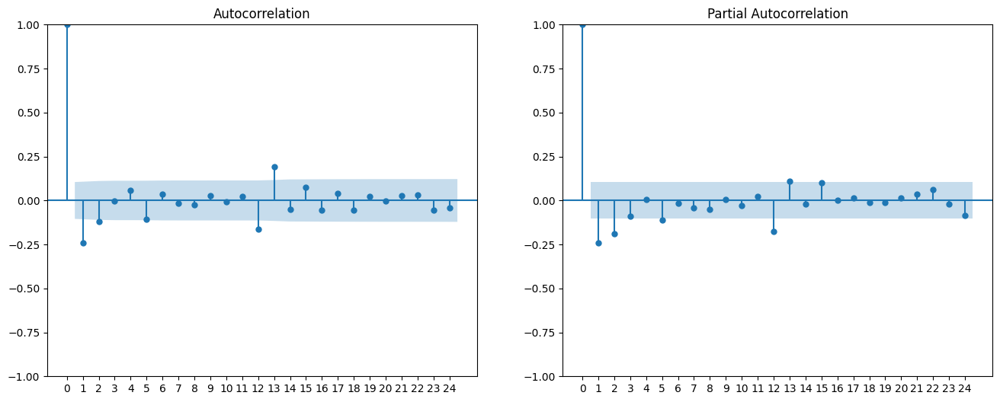


Time series assumptions are met.


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Data of Actual vs Forecasted values with error metrics:'

Other_Fruits,actual,forecast,error,abs_error,squared_error,abs_percentage_error
2010-02-01,0.108537,0.135683,-0.027146,0.027146,0.000737,0.250106
2010-03-01,0.017583,0.082404,-0.064821,0.064821,0.004202,3.686531
2010-04-01,0.214976,0.083721,0.131255,0.131255,0.017228,0.610557
2010-05-01,-0.011749,-0.067711,0.055963,0.055963,0.003132,4.763390
2010-06-01,-0.278874,0.080185,-0.359059,0.359059,0.128923,1.287533
...,...,...,...,...,...,...
2023-12-01,0.045053,0.190074,-0.145021,0.145021,0.021031,3.218868
2024-01-01,0.235240,0.155411,0.079829,0.079829,0.006373,0.339351
2024-02-01,-0.190265,-0.014585,-0.175679,0.175679,0.030863,0.923343
2024-03-01,0.071442,0.087865,-0.016423,0.016423,0.000270,0.229879


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Total Mean Absolute Error (Per Forecast): 0.2153698095069689'

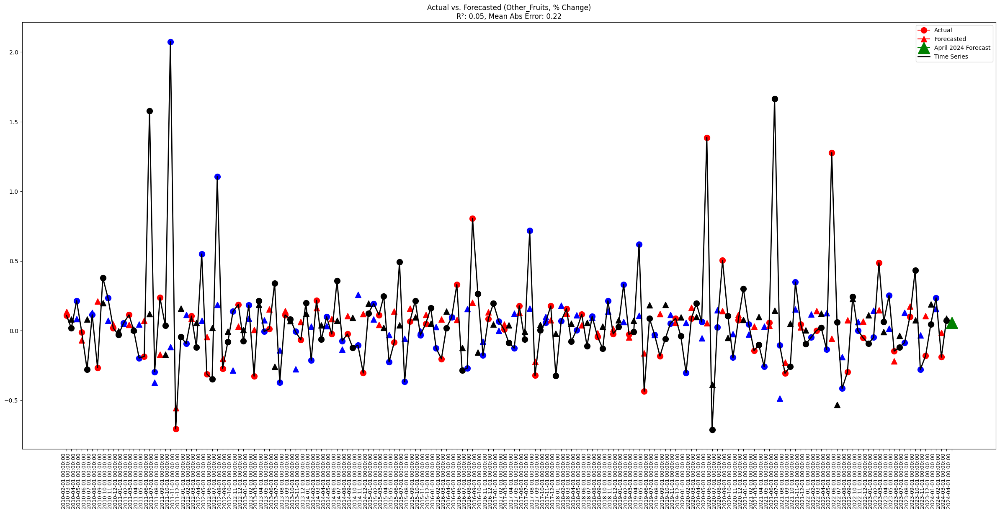

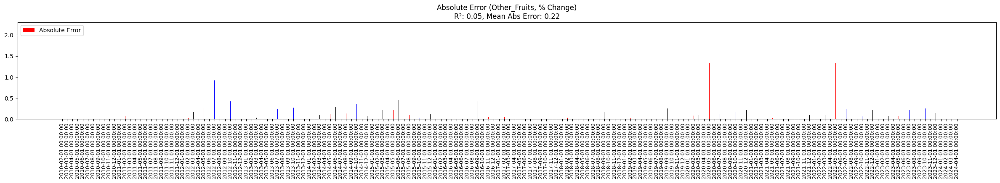

In [22]:
df = df_export_ANALYSIS[[name]]

df.plot(title=f"Export Value ({name})", label=f"{name}")
df.pct_change().plot(title=f"Export Value % Change ({name})", label=f"{name} % Change")
ts = df.pct_change().dropna()
display("Timeseries of component in % form:")
display(ts)
display("-" * 150)

### check if the data timeseries & statistical assumptions validity (stationary, seasonality, autocorrelation)
#freq 12 is used since the data is monthly, so the seasonality is 12 months YoY
display("Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):")
display(check_time_series_assumptions(ts, freq=12))
display("-" * 150)

#read the pickle file
with open(f'data/cleaned/deseasonalised_x13/update/dict_deseasonalized_value_{name}.pickle', 'rb') as handle:
    dict_deseasonalized_value = pickle.load(handle)[name]
adj_ts = dict_deseasonalized_value['seasadj'].pct_change().dropna()
display("Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):")
check_time_series_assumptions(adj_ts, freq=12)
display("-" * 150)

df_accuracy = pd.read_pickle(f"data/cleaned/SARIMA_RollWalkForward/combined/updated/accuracy/df_accuracy_{name}.pickle")
df_accuracy.columns.name = name
#Forecast are all Out-Of-Sample on a rolling basis
display("Data of Actual vs Forecasted values with error metrics:")
display(df_accuracy)
display("-" * 150)

#Plot Actual vs Forecasted values with error metrics
average_abs_error = df_accuracy["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_accuracy, name)


## Horticultural_products,_n.i.e.

In [23]:
df = df_export_ANALYSIS.copy()
name = df.columns[5]
display(f"Component: {name}")

'Component: Horticultural_products,_n.i.e.'

'Timeseries of component in % form:'

class,"Horticultural_products,_n.i.e."
1995-02-01,-0.102428
1995-03-01,0.264265
1995-04-01,-0.214243
1995-05-01,0.034635
1995-06-01,-0.273945
...,...
2023-11-01,-0.160582
2023-12-01,-0.188916
2024-01-01,0.263406
2024-02-01,0.036381


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -6.594816686859109
p-value: 6.968154769514926e-09
Critical Value 1%: -3.449846029628477
Critical Value 5%: -2.870129281376164
Critical Value 10%: -2.5713460670144603
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.08675134072371464
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


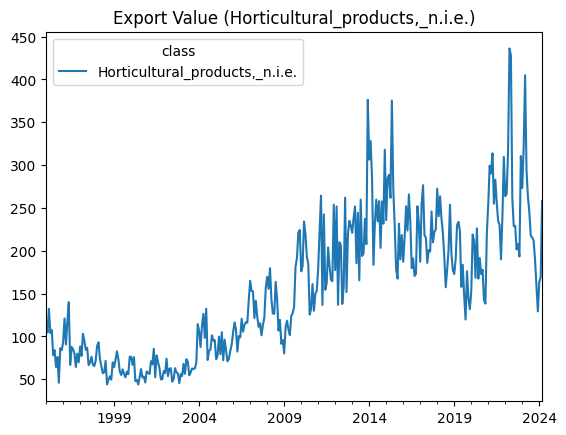

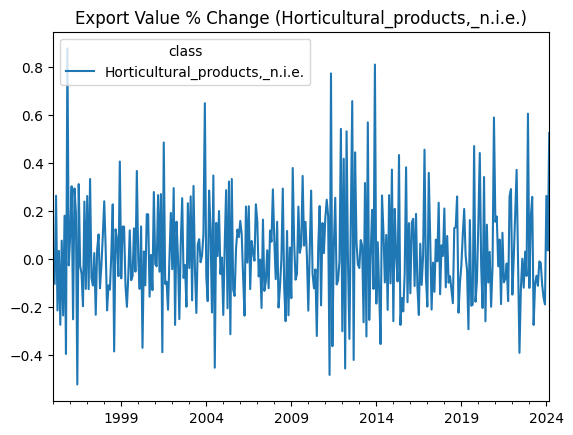

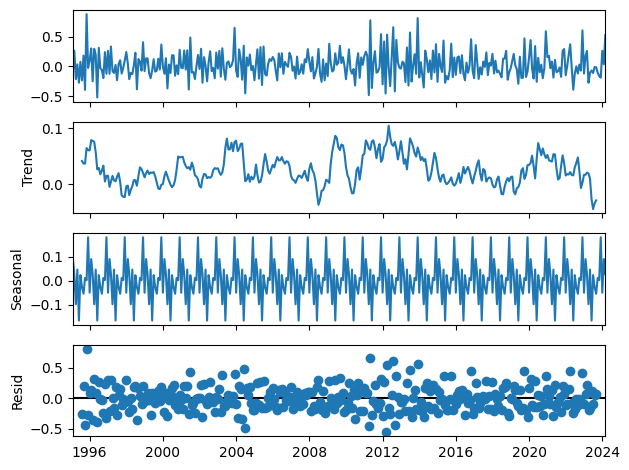


Plotting Residuals for Homoscedasticity Check...


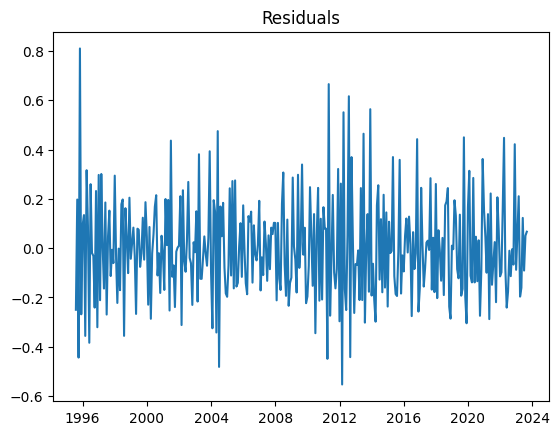

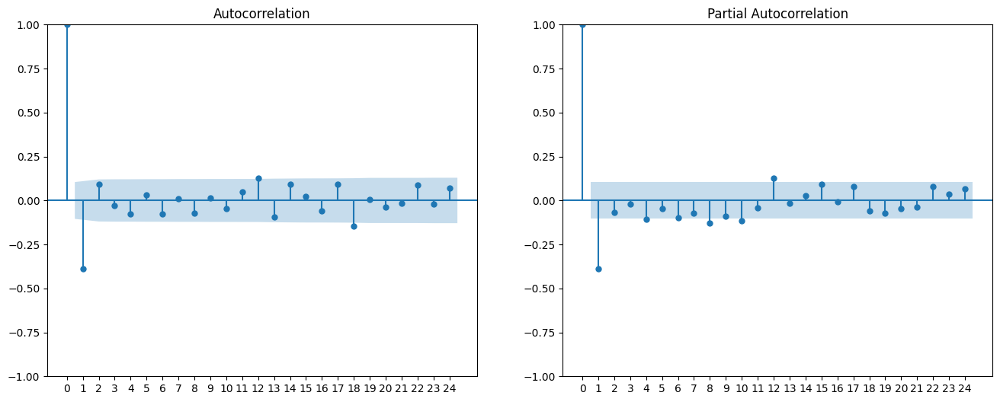


Time series assumptions are met.


True

'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -6.161736964862462
p-value: 7.146728327311864e-08
Critical Value 1%: -3.4499043309021955
Critical Value 5%: -2.870154885338925
Critical Value 10%: -2.5713597190254385
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.08945383324051917
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


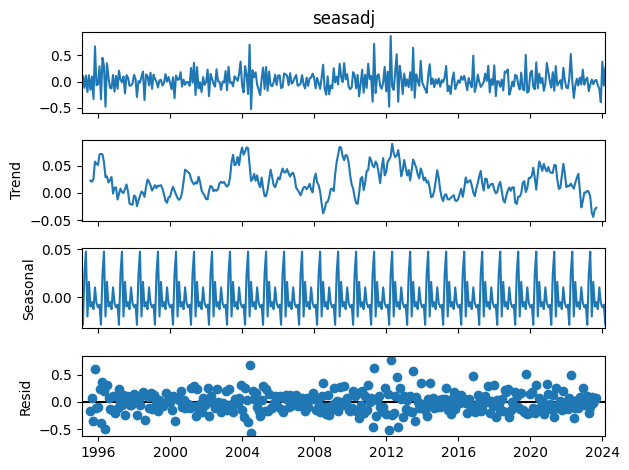


Plotting Residuals for Homoscedasticity Check...


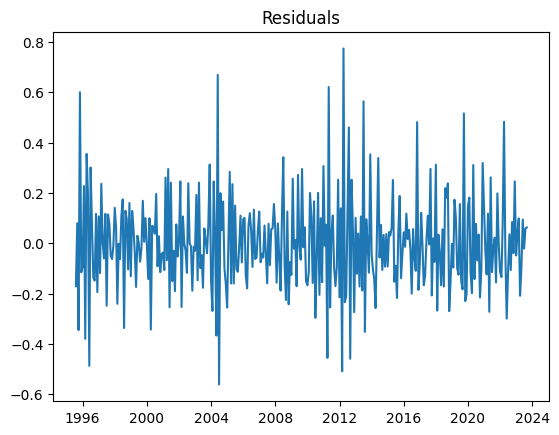

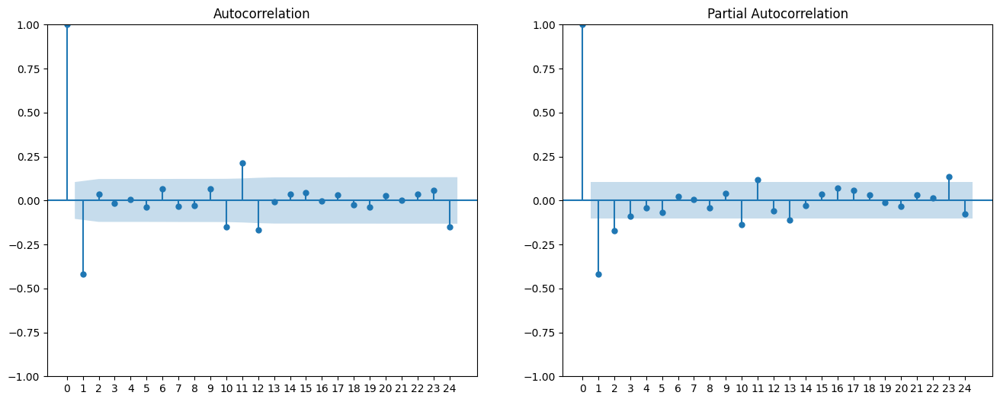


Time series assumptions are met.


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Data of Actual vs Forecasted values with error metrics:'

"Horticultural_products,_n.i.e.",actual,forecast,error,abs_error,squared_error,abs_percentage_error
2010-02-01,-0.106685,0.115713,-0.222398,0.222398,0.049461,2.084621
2010-03-01,0.179750,0.096391,0.083360,0.083360,0.006949,0.463753
2010-04-01,0.124127,-0.026217,0.150344,0.150344,0.022603,1.211208
2010-05-01,-0.128591,-0.008212,-0.120379,0.120379,0.014491,0.936140
2010-06-01,0.127080,-0.037109,0.164189,0.164189,0.026958,1.292011
...,...,...,...,...,...,...
2023-12-01,-0.391910,0.050209,-0.442119,0.442119,0.195469,1.128114
2024-01-01,0.377036,0.239059,0.137977,0.137977,0.019038,0.365951
2024-02-01,-0.074509,-0.008147,-0.066362,0.066362,0.004404,0.890659
2024-03-01,0.259410,0.051454,0.207956,0.207956,0.043246,0.801650


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Total Mean Absolute Error (Per Forecast): 0.139862317896603'

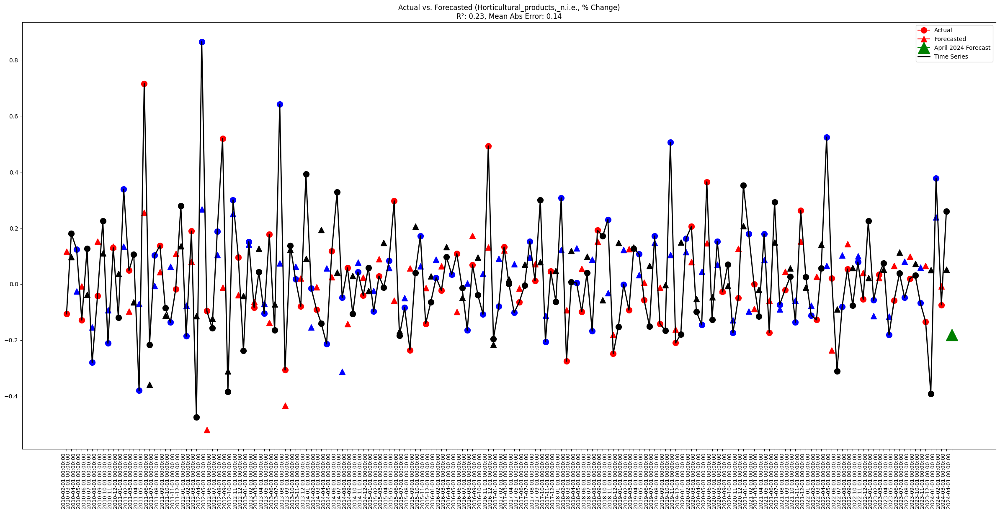

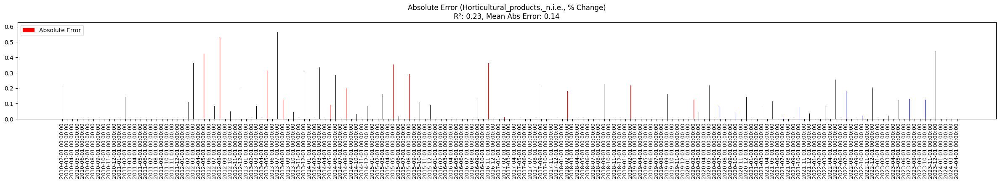

In [24]:
df = df_export_ANALYSIS[[name]]

df.plot(title=f"Export Value ({name})", label=f"{name}")
df.pct_change().plot(title=f"Export Value % Change ({name})", label=f"{name} % Change")
ts = df.pct_change().dropna()
display("Timeseries of component in % form:")
display(ts)
display("-" * 150)

### check if the data timeseries & statistical assumptions validity (stationary, seasonality, autocorrelation)
#freq 12 is used since the data is monthly, so the seasonality is 12 months YoY
display("Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):")
display(check_time_series_assumptions(ts, freq=12))
display("-" * 150)

#read the pickle file
with open(f'data/cleaned/deseasonalised_x13/update/dict_deseasonalized_value_{name}.pickle', 'rb') as handle:
    dict_deseasonalized_value = pickle.load(handle)[name]
adj_ts = dict_deseasonalized_value['seasadj'].pct_change().dropna()
display("Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):")
check_time_series_assumptions(adj_ts, freq=12)
display("-" * 150)

df_accuracy = pd.read_pickle(f"data/cleaned/SARIMA_RollWalkForward/combined/updated/accuracy/df_accuracy_{name}.pickle")
df_accuracy.columns.name = name
#Forecast are all Out-Of-Sample on a rolling basis
display("Data of Actual vs Forecasted values with error metrics:")
display(df_accuracy)
display("-" * 150)

#Plot Actual vs Forecasted values with error metrics
average_abs_error = df_accuracy["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_accuracy, name)

## Animal_products

In [25]:
df = df_export_ANALYSIS.copy()
name = df.columns[6]
display(f"Component: {name}")

'Component: Animal_products'

In [26]:
df_accuracy["forecast"] = cap_extreme_values(df_accuracy[["forecast"]])["forecast"]

'Timeseries of component in % form:'

class,Animal_products
1995-02-01,0.030157
1995-03-01,0.276753
1995-04-01,-0.182274
1995-05-01,0.042884
1995-06-01,-0.021916
...,...
2023-11-01,-0.027080
2023-12-01,-0.106263
2024-01-01,0.126101
2024-02-01,0.014086


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -5.564124089868082
p-value: 1.5183085125402818e-06
Critical Value 1%: -3.4499043309021955
Critical Value 5%: -2.870154885338925
Critical Value 10%: -2.5713597190254385
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.12278439897121088
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


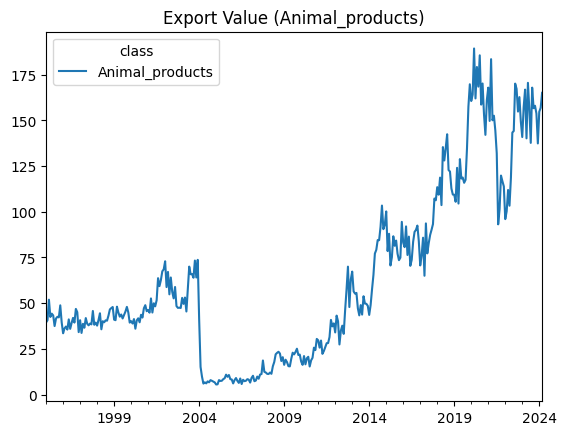

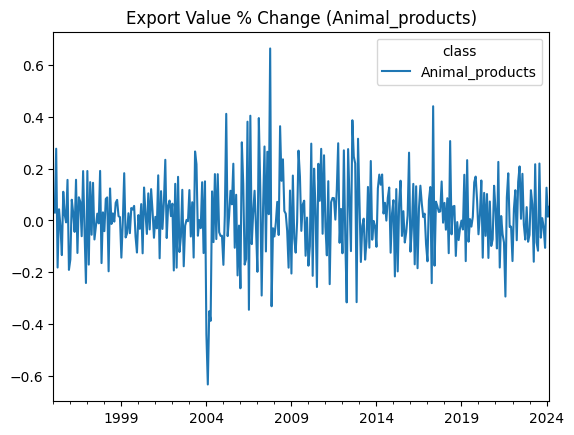

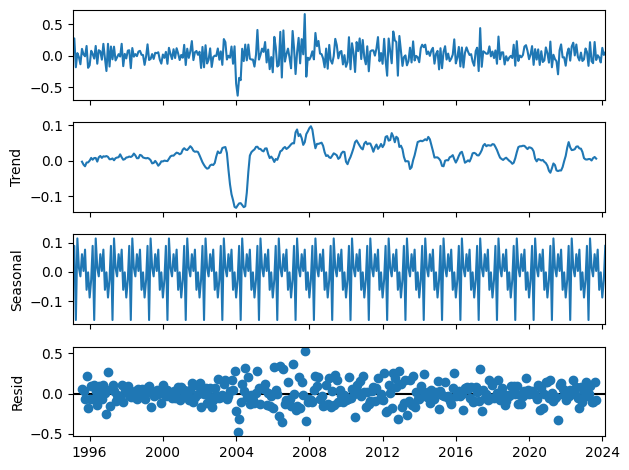


Plotting Residuals for Homoscedasticity Check...


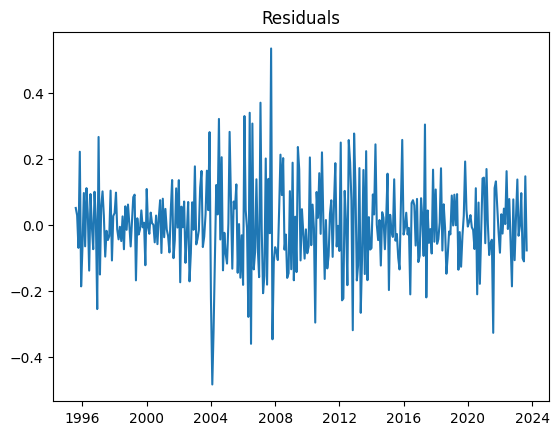

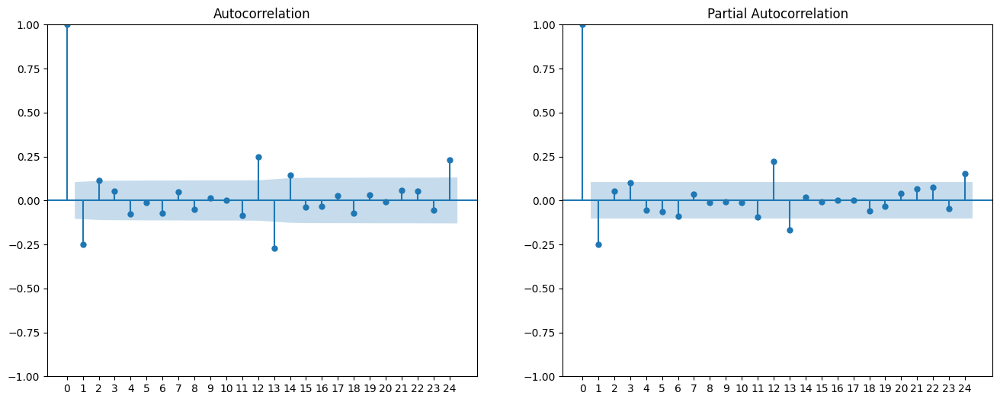


Time series assumptions are met.


True

'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -5.607227641769313
p-value: 1.2263618183651165e-06
Critical Value 1%: -3.449962981927952
Critical Value 5%: -2.870180642420163
Critical Value 10%: -2.5713734527352607
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.15598890721132364
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


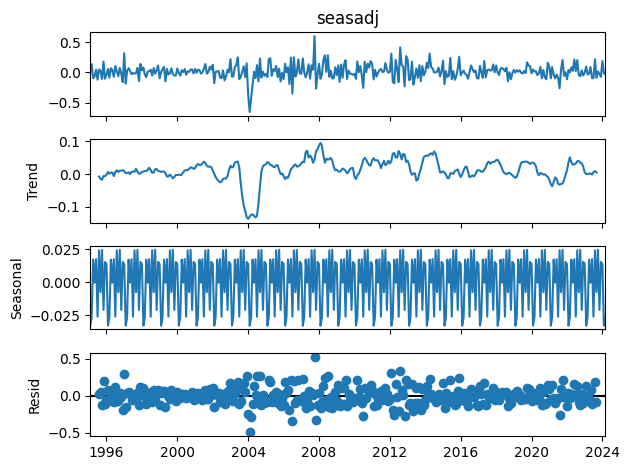


Plotting Residuals for Homoscedasticity Check...


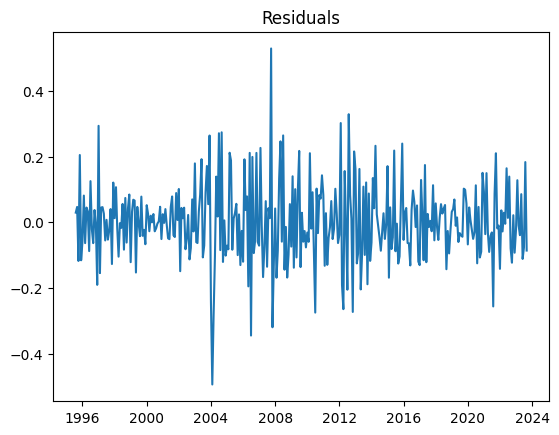

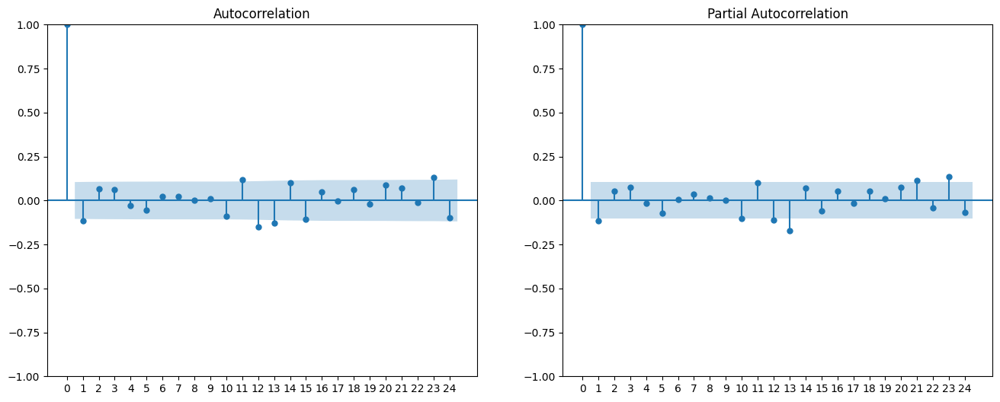


Time series assumptions are met.


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Data of Actual vs Forecasted values with error metrics:'

Animal_products,actual,forecast,error,abs_error,squared_error,abs_percentage_error
2010-02-01,-0.107153,0.000000,-0.107153,0.107153,1.148166e-02,1.000000
2010-03-01,0.179511,0.000000,0.179511,0.179511,3.222412e-02,1.000000
2010-04-01,-0.000333,0.000000,-0.000333,0.000333,1.111411e-07,1.000000
2010-05-01,0.103868,0.000000,0.103868,0.103868,1.078866e-02,1.000000
2010-06-01,-0.045780,0.000000,-0.045780,0.045780,2.095834e-03,1.000000
...,...,...,...,...,...,...
2023-12-01,-0.075139,0.005908,-0.081046,0.081046,6.568517e-03,1.078626
2024-01-01,0.187127,0.017227,0.169900,0.169900,2.886585e-02,0.907938
2024-02-01,-0.014415,-0.017653,0.003239,0.003239,1.048883e-05,0.224675
2024-03-01,-0.033308,0.044488,-0.077797,0.077797,6.052299e-03,2.335662


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Total Mean Absolute Error (Per Forecast): 0.08294493473108006'

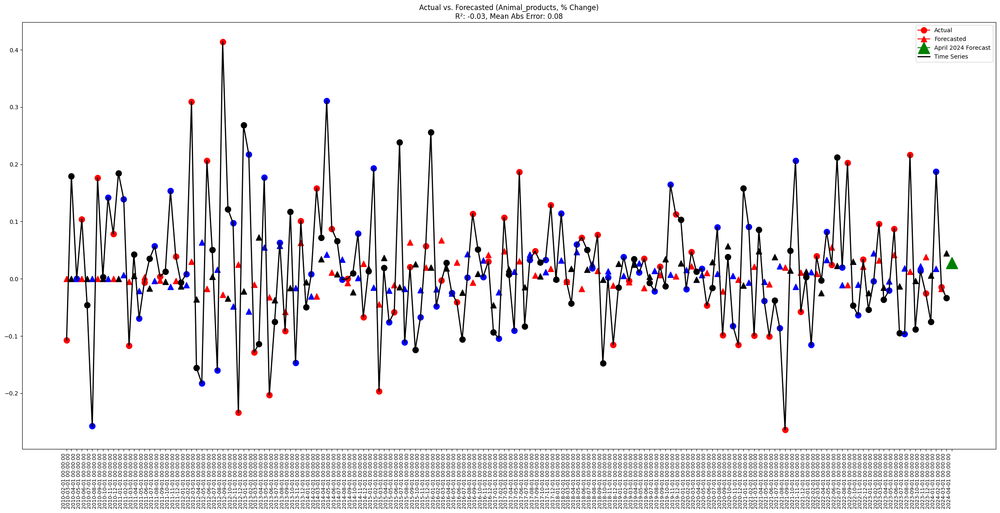

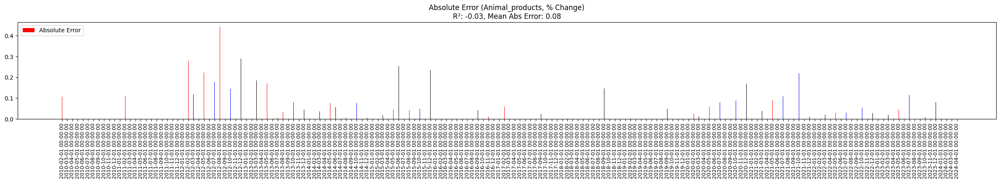

In [27]:
df = df_export_ANALYSIS[[name]]

df.plot(title=f"Export Value ({name})", label=f"{name}")
df.pct_change().plot(title=f"Export Value % Change ({name})", label=f"{name} % Change")
ts = df.pct_change().dropna()
display("Timeseries of component in % form:")
display(ts)
display("-" * 150)

### check if the data timeseries & statistical assumptions validity (stationary, seasonality, autocorrelation)
#freq 12 is used since the data is monthly, so the seasonality is 12 months YoY
display("Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):")
display(check_time_series_assumptions(ts, freq=12))
display("-" * 150)

#read the pickle file
with open(f'data/cleaned/deseasonalised_x13/update/dict_deseasonalized_value_{name}.pickle', 'rb') as handle:
    dict_deseasonalized_value = pickle.load(handle)[name]
adj_ts = dict_deseasonalized_value['seasadj'].pct_change().dropna()
display("Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):")
check_time_series_assumptions(adj_ts, freq=12)
display("-" * 150)

df_accuracy = pd.read_pickle(f"data/cleaned/SARIMA_RollWalkForward/combined/updated/accuracy/df_accuracy_{name}.pickle")
df_accuracy["forecast"] = cap_extreme_values(df_accuracy[["forecast"]])["forecast"]
df_accuracy.columns.name = name
#Forecast are all Out-Of-Sample on a rolling basis
display("Data of Actual vs Forecasted values with error metrics:")
display(df_accuracy)
display("-" * 150)

#Plot Actual vs Forecasted values with error metrics
average_abs_error = df_accuracy["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_accuracy, name)

# **Fishery**

In [28]:
df = df_export_ANALYSIS.copy()
name = df.columns[7]
display(f"Component: {name}")

'Component: Fishery'

'Timeseries of component in % form:'

class,Fishery
1995-02-01,-0.157801
1995-03-01,0.387814
1995-04-01,-0.177340
1995-05-01,0.182081
1995-06-01,0.081511
...,...
2023-11-01,-0.065282
2023-12-01,-0.074635
2024-01-01,0.065773
2024-02-01,-0.058474


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -4.159090391460465
p-value: 0.0007722157810662703
Critical Value 1%: -3.450141065277327
Critical Value 5%: -2.870258846235788
Critical Value 10%: -2.571415151457764
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.02731389579931995
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


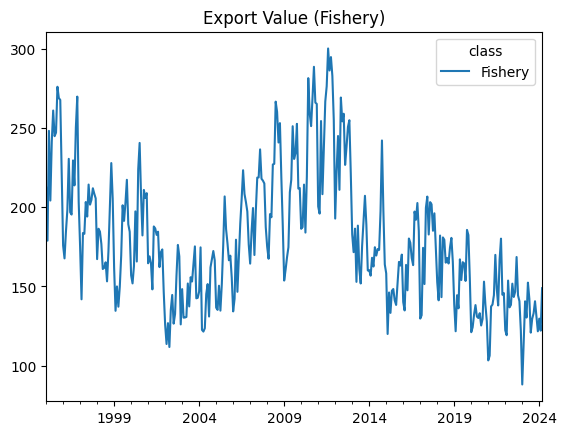

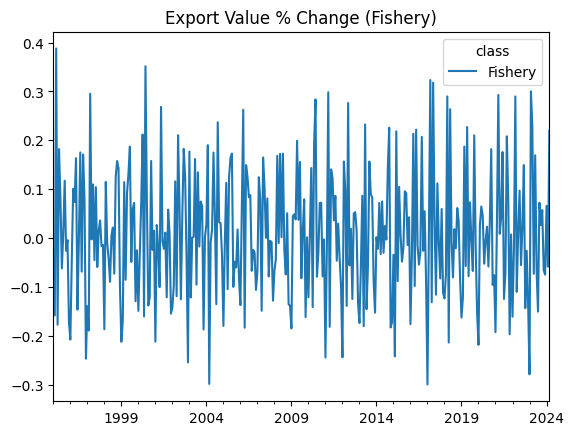

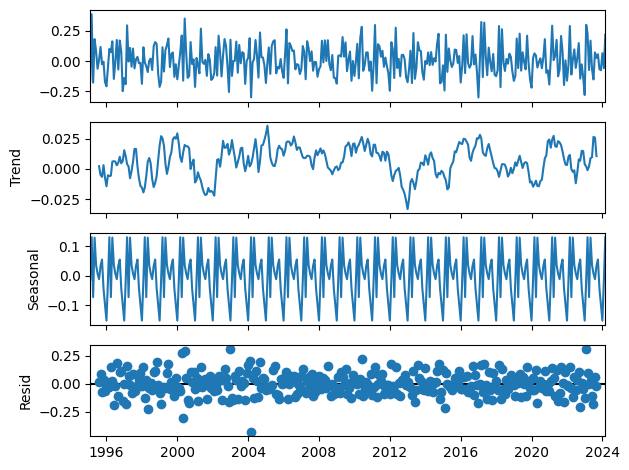


Plotting Residuals for Homoscedasticity Check...


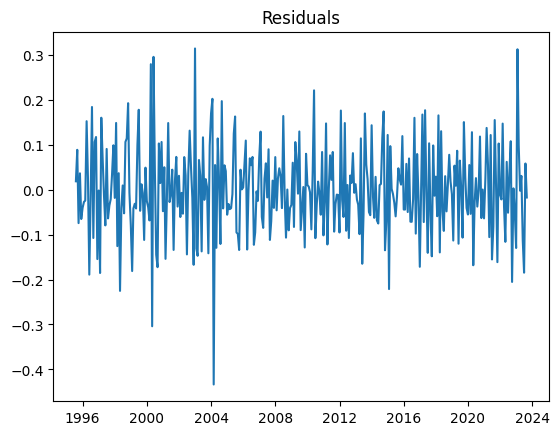

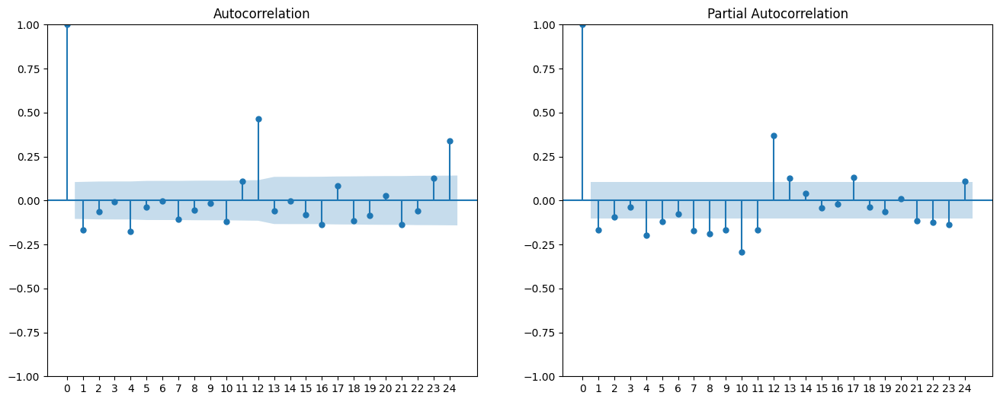


Time series assumptions are met.


True

'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -5.31546244079531
p-value: 5.085947329960103e-06
Critical Value 1%: -3.4497880749874628
Critical Value 5%: -2.870103829170425
Critical Value 10%: -2.571332495975496
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.03573653741963814
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


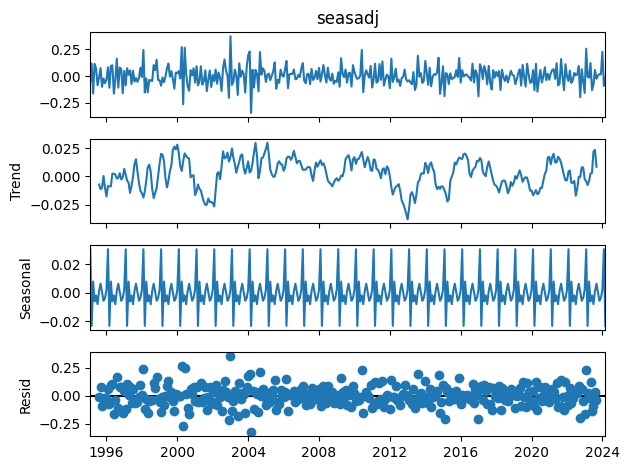


Plotting Residuals for Homoscedasticity Check...


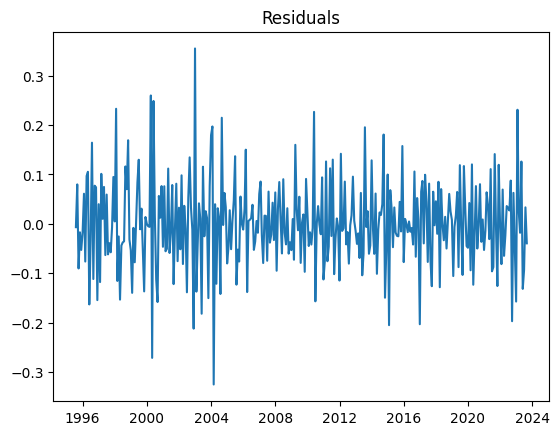

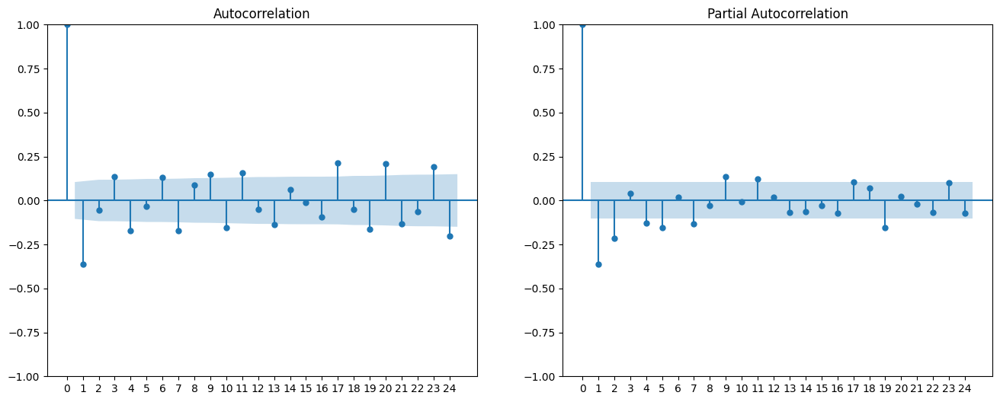


Time series assumptions are met.


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Data of Actual vs Forecasted values with error metrics:'

Fishery,actual,forecast,error,abs_error,squared_error,abs_percentage_error
2010-02-01,-0.003224,-0.018818,0.015594,0.015594,2.431753e-04,4.837173
2010-03-01,-0.025396,-0.003122,-0.022274,0.022274,4.961116e-04,0.877055
2010-04-01,-0.018523,-0.018748,0.000225,0.000225,5.048127e-08,0.012130
2010-05-01,0.003802,0.003036,0.000767,0.000767,5.879383e-07,0.201651
2010-06-01,0.246505,0.014925,0.231579,0.231579,5.362899e-02,0.939452
...,...,...,...,...,...,...
2023-12-01,0.016574,-0.020221,0.036795,0.036795,1.353868e-03,2.220071
2024-01-01,0.227966,0.001427,0.226539,0.226539,5.131977e-02,0.993740
2024-02-01,-0.091556,-0.091262,-0.000294,0.000294,8.632802e-08,0.003209
2024-03-01,-0.014015,-0.029349,0.015334,0.015334,2.351302e-04,1.094119


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Total Mean Absolute Error (Per Forecast): 0.054531900622780065'

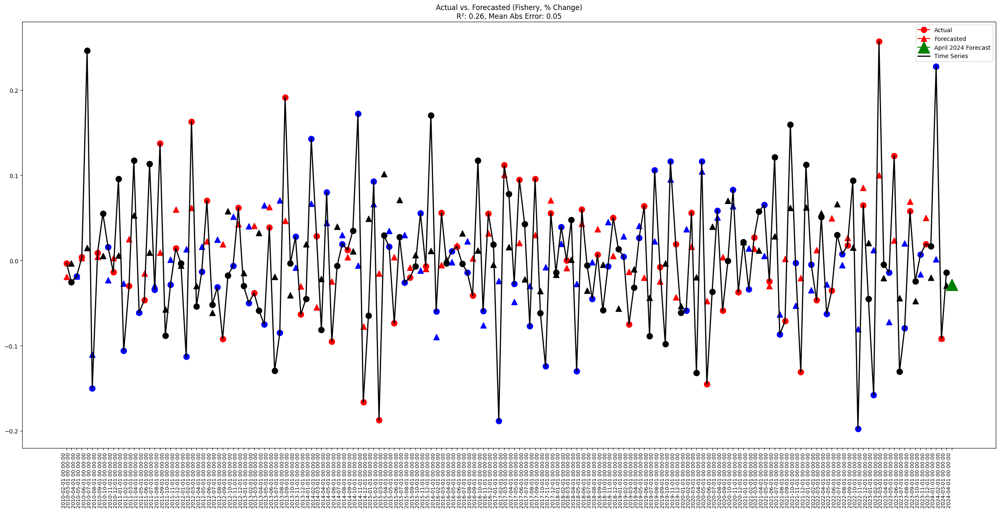

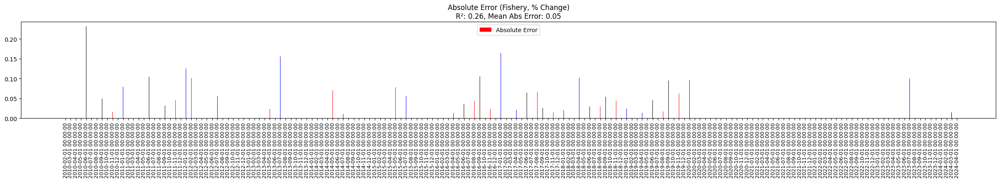

In [29]:
df = df_export_ANALYSIS[[name]]

df.plot(title=f"Export Value ({name})", label=f"{name}")
df.pct_change().plot(title=f"Export Value % Change ({name})", label=f"{name} % Change")
ts = df.pct_change().dropna()
display("Timeseries of component in % form:")
display(ts)
display("-" * 150)

### check if the data timeseries & statistical assumptions validity (stationary, seasonality, autocorrelation)
#freq 12 is used since the data is monthly, so the seasonality is 12 months YoY
display("Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):")
display(check_time_series_assumptions(ts, freq=12))
display("-" * 150)

#read the pickle file
with open(f'data/cleaned/deseasonalised_x13/update/dict_deseasonalized_value_{name}.pickle', 'rb') as handle:
    dict_deseasonalized_value = pickle.load(handle)[name]
adj_ts = dict_deseasonalized_value['seasadj'].pct_change().dropna()
display("Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):")
check_time_series_assumptions(adj_ts, freq=12)
display("-" * 150)

df_accuracy = pd.read_pickle(f"data/cleaned/SARIMA_RollWalkForward/combined/updated/accuracy/df_accuracy_{name}.pickle")
df_accuracy.columns.name = name
#Forecast are all Out-Of-Sample on a rolling basis
display("Data of Actual vs Forecasted values with error metrics:")
display(df_accuracy)
display("-" * 150)

#Plot Actual vs Forecasted values with error metrics
average_abs_error = df_accuracy["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_accuracy, name)


## Crustaceans

In [30]:
df = df_export_ANALYSIS.copy()
name = df.columns[8]
display(f"Component: {name}")

'Component: Crustaceans'

'Timeseries of component in % form:'

class,Crustaceans
1995-02-01,-0.205979
1995-03-01,0.456434
1995-04-01,-0.166809
1995-05-01,0.211183
1995-06-01,0.085745
...,...
2023-11-01,-0.011983
2023-12-01,-0.075728
2024-01-01,-0.078253
2024-02-01,0.011806


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -6.3549565542307835
p-value: 2.5562651150969746e-08
Critical Value 1%: -3.449846029628477
Critical Value 5%: -2.870129281376164
Critical Value 10%: -2.5713460670144603
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.013817370147071744
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


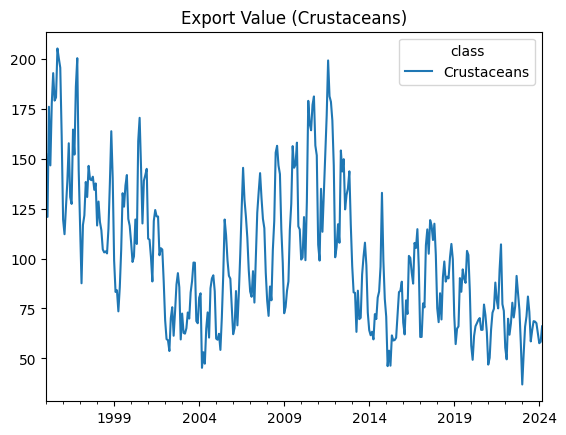

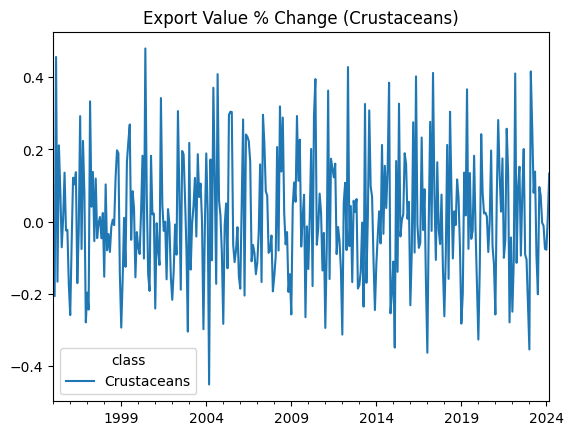

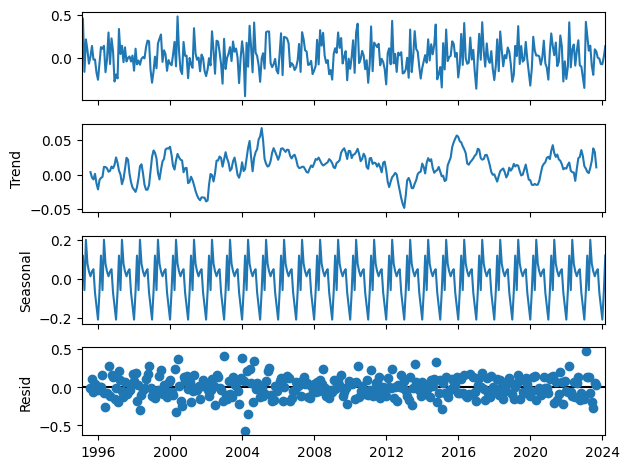


Plotting Residuals for Homoscedasticity Check...


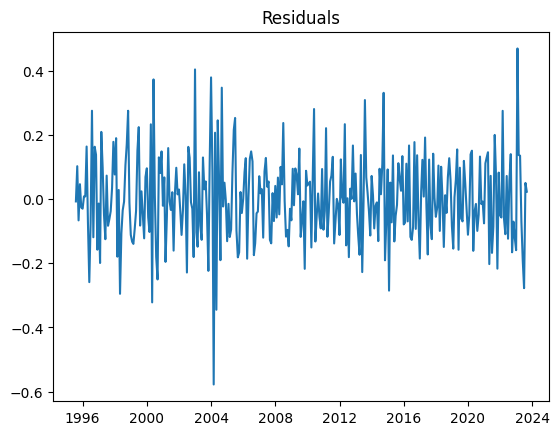

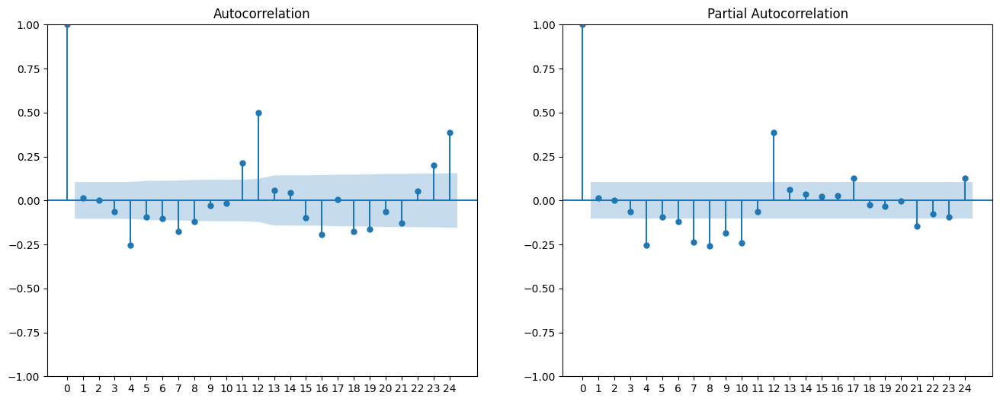


Time series assumptions are met.


True

'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -3.9499841054732285
p-value: 0.0016962841594932894
Critical Value 1%: -3.4502011472639724
Critical Value 5%: -2.8702852297358983
Critical Value 10%: -2.5714292194077513
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.06159304469300719
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


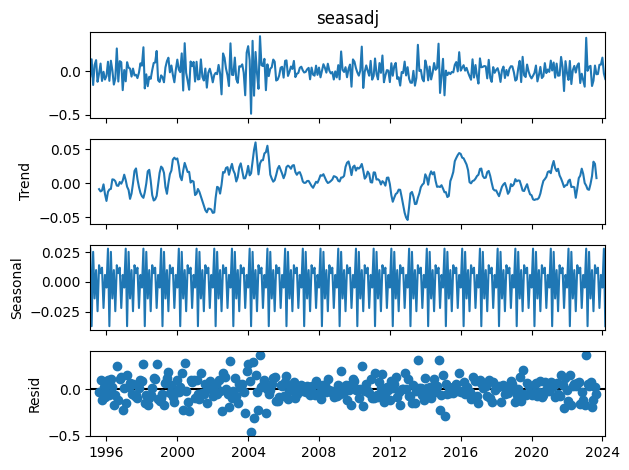


Plotting Residuals for Homoscedasticity Check...


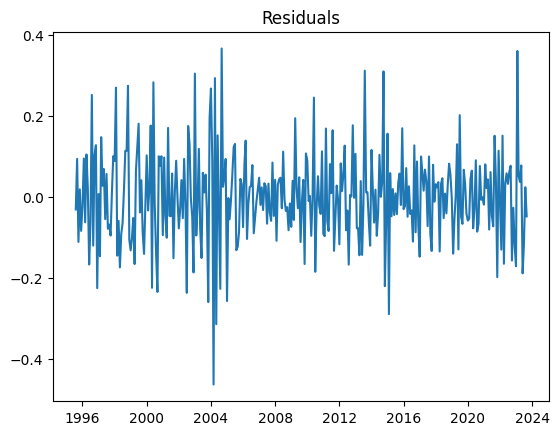

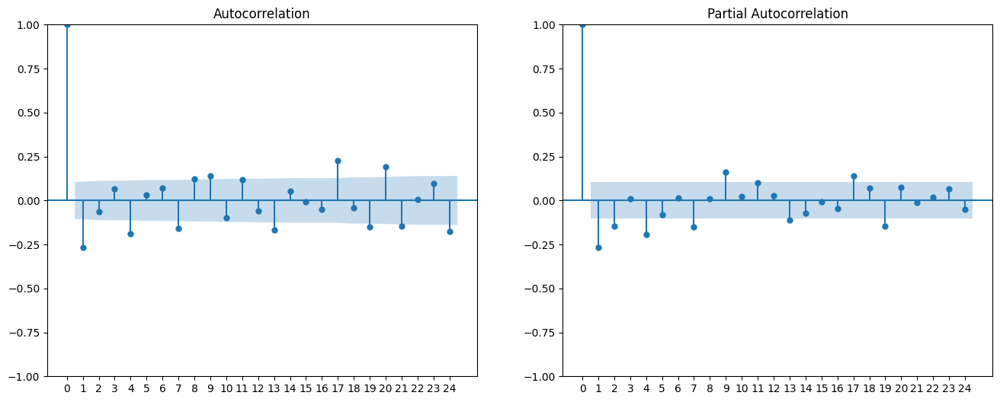


Time series assumptions are met.


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Data of Actual vs Forecasted values with error metrics:'

Crustaceans,actual,forecast,error,abs_error,squared_error,abs_percentage_error
2010-02-01,0.036319,-0.025456,0.061774,0.061774,0.003816,1.700894
2010-03-01,-0.011641,-0.022825,0.011184,0.011184,0.000125,0.960703
2010-04-01,-0.049256,-0.041387,-0.007869,0.007869,0.000062,0.159758
2010-05-01,0.008634,-0.001356,0.009991,0.009991,0.000100,1.157069
2010-06-01,0.284011,0.006947,0.277064,0.277064,0.076764,0.975540
...,...,...,...,...,...,...
2023-12-01,0.076918,-0.050477,0.127395,0.127395,0.016229,1.656247
2024-01-01,0.157422,-0.013545,0.170967,0.170967,0.029230,1.086044
2024-02-01,-0.024704,-0.081260,0.056556,0.056556,0.003199,2.289357
2024-03-01,-0.087605,-0.079293,-0.008312,0.008312,0.000069,0.094878


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Total Mean Absolute Error (Per Forecast): 0.07425169236576332'

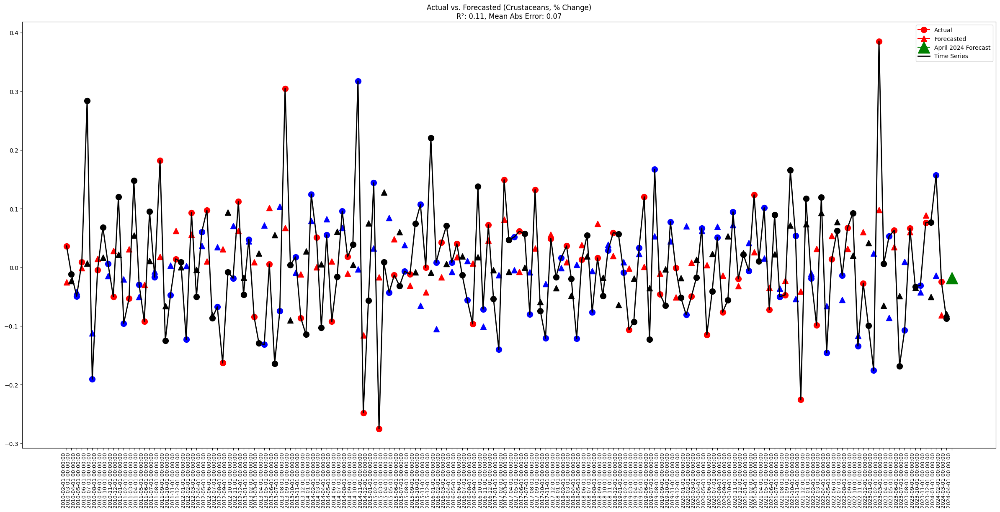

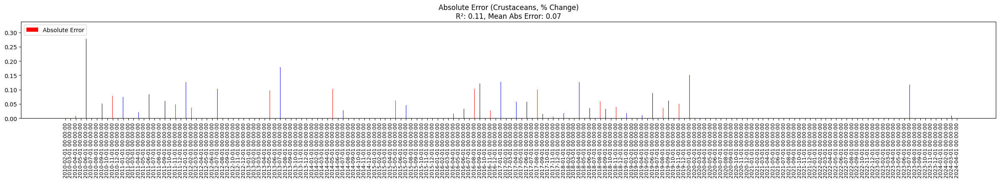

In [31]:
df = df_export_ANALYSIS[[name]]

df.plot(title=f"Export Value ({name})", label=f"{name}")
df.pct_change().plot(title=f"Export Value % Change ({name})", label=f"{name} % Change")
ts = df.pct_change().dropna()
display("Timeseries of component in % form:")
display(ts)
display("-" * 150)

### check if the data timeseries & statistical assumptions validity (stationary, seasonality, autocorrelation)
#freq 12 is used since the data is monthly, so the seasonality is 12 months YoY
display("Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):")
display(check_time_series_assumptions(ts, freq=12))
display("-" * 150)

#read the pickle file
with open(f'data/cleaned/deseasonalised_x13/update/dict_deseasonalized_value_{name}.pickle', 'rb') as handle:
    dict_deseasonalized_value = pickle.load(handle)[name]
adj_ts = dict_deseasonalized_value['seasadj'].pct_change().dropna()
display("Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):")
check_time_series_assumptions(adj_ts, freq=12)
display("-" * 150)

df_accuracy = pd.read_pickle(f"data/cleaned/SARIMA_RollWalkForward/combined/updated/accuracy/df_accuracy_{name}.pickle")
df_accuracy.columns.name = name
#Forecast are all Out-Of-Sample on a rolling basis
display("Data of Actual vs Forecasted values with error metrics:")
display(df_accuracy)
display("-" * 150)

#Plot Actual vs Forecasted values with error metrics
average_abs_error = df_accuracy["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_accuracy, name)


## Fish

In [32]:
df = df_export_ANALYSIS.copy()
name = df.columns[9]
display(f"Component: {name}")

'Component: Fish'

'Timeseries of component in % form:'

class,Fish
1995-02-01,-0.090772
1995-03-01,0.238017
1995-04-01,-0.173832
1995-05-01,0.135100
1995-06-01,0.085137
...,...
2023-11-01,-0.050933
2023-12-01,-0.112646
2024-01-01,0.211377
2024-02-01,-0.163618


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -7.390305578435781
p-value: 8.033406251233797e-11
Critical Value 1%: -3.449846029628477
Critical Value 5%: -2.870129281376164
Critical Value 10%: -2.5713460670144603
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.06789997195499971
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


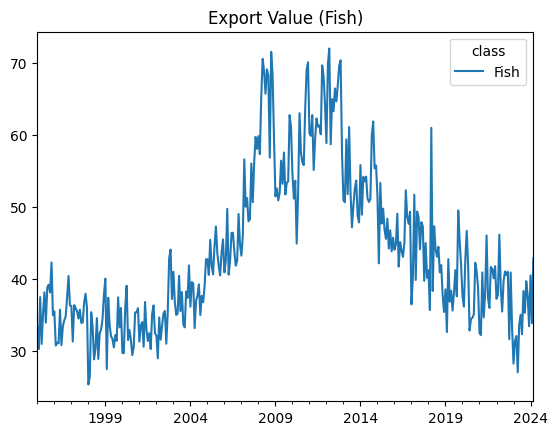

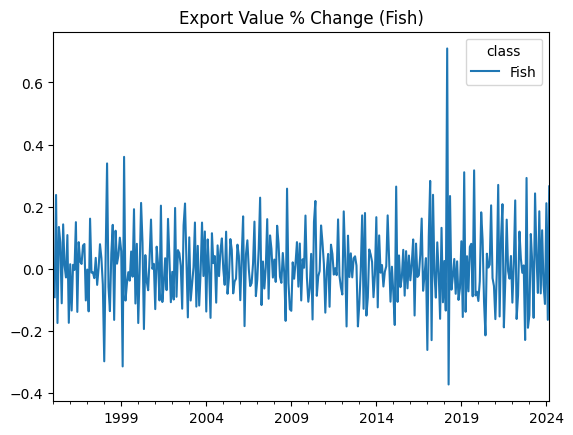

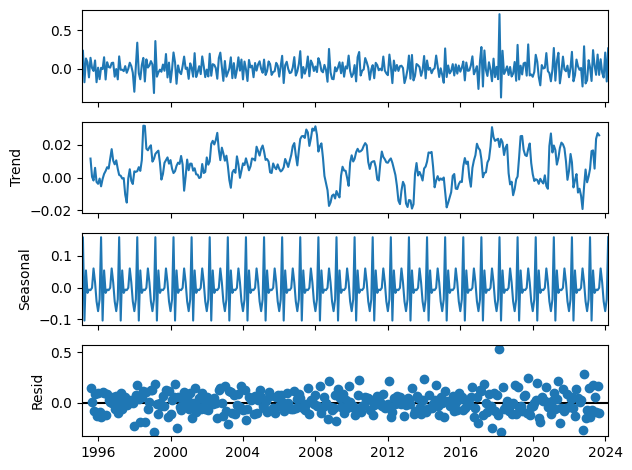


Plotting Residuals for Homoscedasticity Check...


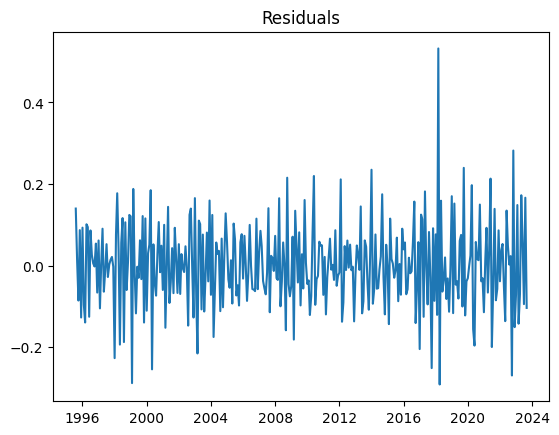

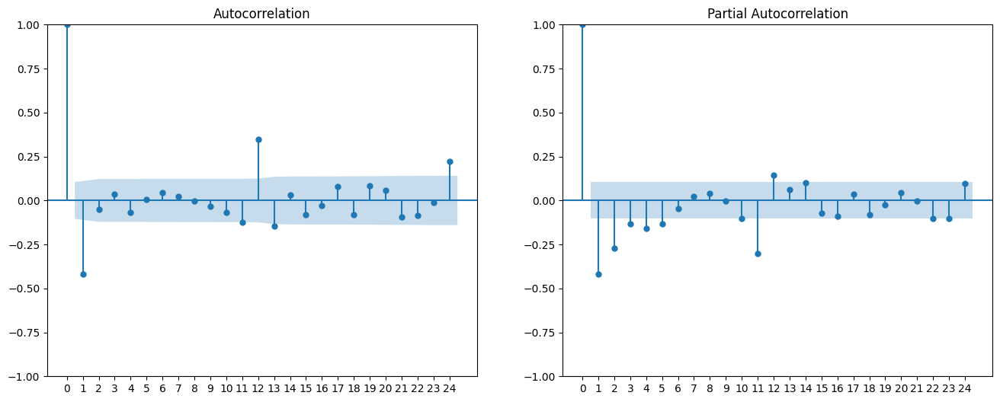


Time series assumptions are met.


True

'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -11.544920615708573
p-value: 3.560280465495256e-21
Critical Value 1%: -3.4494474563375737
Critical Value 5%: -2.8699542285903887
Critical Value 10%: -2.5712527305187987
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.05077578987352299
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


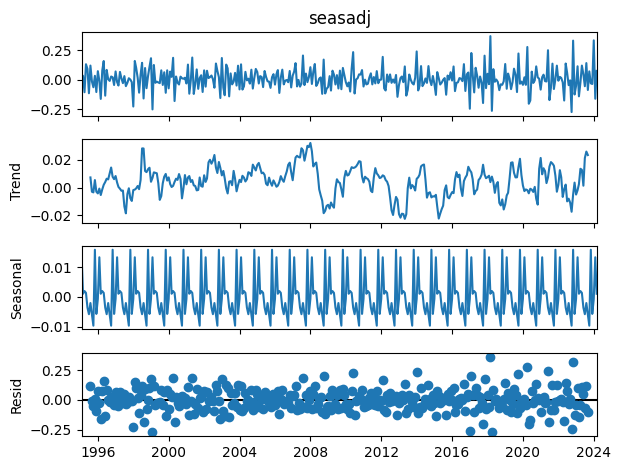


Plotting Residuals for Homoscedasticity Check...


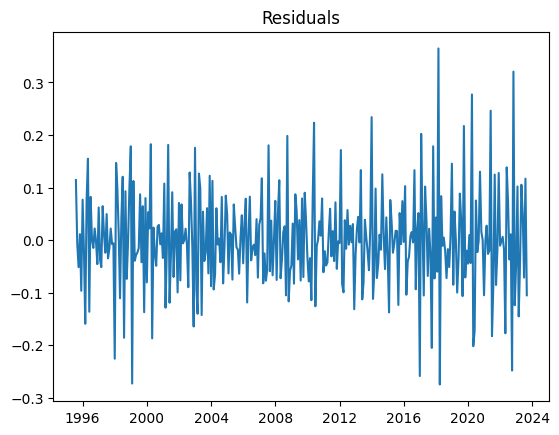

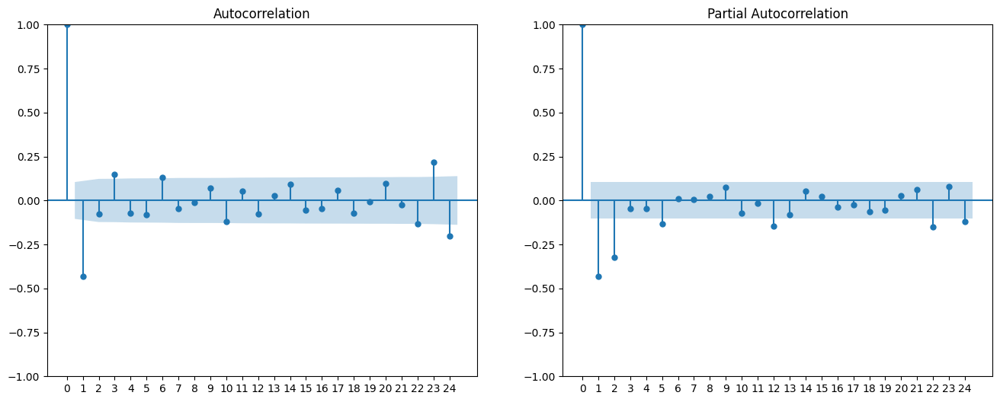


Time series assumptions are met.


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Data of Actual vs Forecasted values with error metrics:'

Fish,actual,forecast,error,abs_error,squared_error,abs_percentage_error
2010-02-01,-0.056565,-0.007311,-0.049254,0.049254,0.002426,0.870752
2010-03-01,-0.024109,0.028270,-0.052378,0.052378,0.002744,2.172606
2010-04-01,-0.100628,0.006566,-0.107194,0.107194,0.011491,1.065250
2010-05-01,0.092736,0.059416,0.033320,0.033320,0.001110,0.359300
2010-06-01,0.233805,0.020257,0.213549,0.213549,0.045603,0.913361
...,...,...,...,...,...,...
2023-12-01,-0.036721,-0.021330,-0.015391,0.015391,0.000237,0.419126
2024-01-01,0.333739,0.045307,0.288432,0.288432,0.083193,0.864243
2024-02-01,-0.162100,-0.167584,0.005484,0.005484,0.000030,0.033833
2024-03-01,0.074502,-0.021913,0.096416,0.096416,0.009296,1.294126


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Total Mean Absolute Error (Per Forecast): 0.0636859130739132'

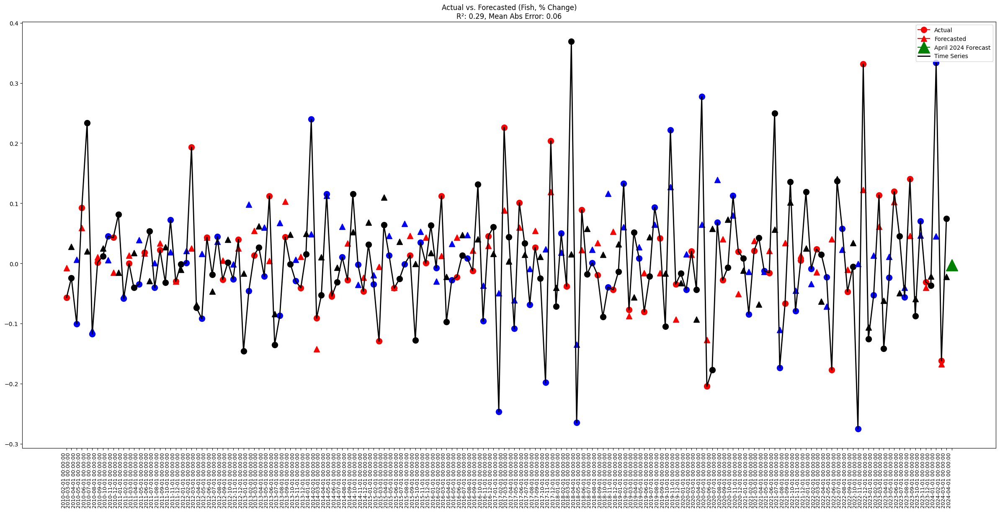

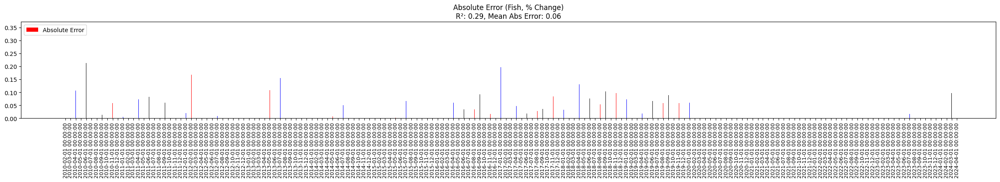

In [33]:
df = df_export_ANALYSIS[[name]]

df.plot(title=f"Export Value ({name})", label=f"{name}")
df.pct_change().plot(title=f"Export Value % Change ({name})", label=f"{name} % Change")
ts = df.pct_change().dropna()
display("Timeseries of component in % form:")
display(ts)
display("-" * 150)

### check if the data timeseries & statistical assumptions validity (stationary, seasonality, autocorrelation)
#freq 12 is used since the data is monthly, so the seasonality is 12 months YoY
display("Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):")
display(check_time_series_assumptions(ts, freq=12))
display("-" * 150)

#read the pickle file
with open(f'data/cleaned/deseasonalised_x13/update/dict_deseasonalized_value_{name}.pickle', 'rb') as handle:
    dict_deseasonalized_value = pickle.load(handle)[name]
adj_ts = dict_deseasonalized_value['seasadj'].pct_change().dropna()
display("Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):")
check_time_series_assumptions(adj_ts, freq=12)
display("-" * 150)

df_accuracy = pd.read_pickle(f"data/cleaned/SARIMA_RollWalkForward/combined/updated/accuracy/df_accuracy_{name}.pickle")
df_accuracy.columns.name = name
#Forecast are all Out-Of-Sample on a rolling basis
display("Data of Actual vs Forecasted values with error metrics:")
display(df_accuracy)
display("-" * 150)

#Plot Actual vs Forecasted values with error metrics
average_abs_error = df_accuracy["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_accuracy, name)


## Cuttlefish,_squid,_octopus

In [34]:
df = df_export_ANALYSIS.copy()
name = df.columns[10]
display(f"Component: {name}")

'Component: Cuttlefish,_squid,_octopus'

'Timeseries of component in % form:'

class,"Cuttlefish,_squid,_octopus"
1995-02-01,0.037419
1995-03-01,0.245854
1995-04-01,-0.270882
1995-05-01,0.138749
1995-06-01,0.063727
...,...
2023-11-01,-0.295102
2023-12-01,0.027215
2024-01-01,0.360203
2024-02-01,-0.041442


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -4.795747973245559
p-value: 5.5413745255965345e-05
Critical Value 1%: -3.450141065277327
Critical Value 5%: -2.870258846235788
Critical Value 10%: -2.571415151457764
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.06761997750486669
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


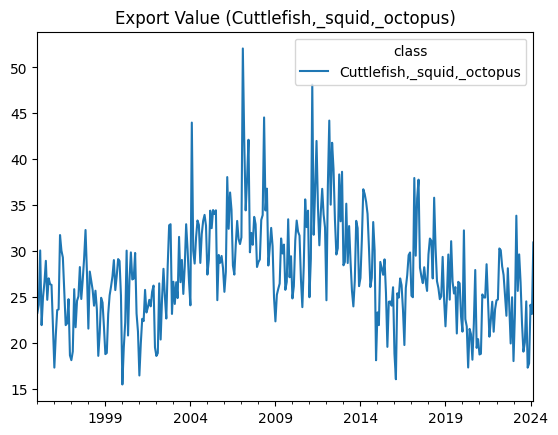

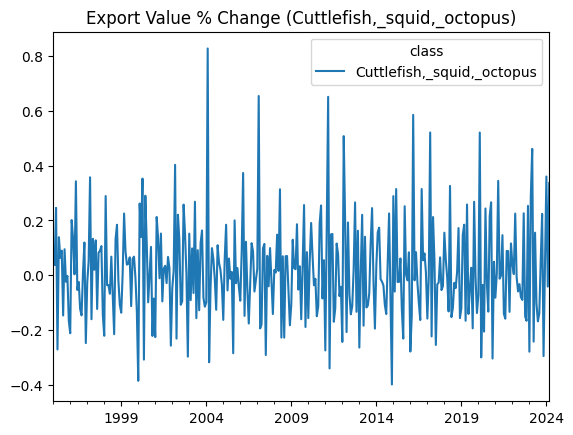

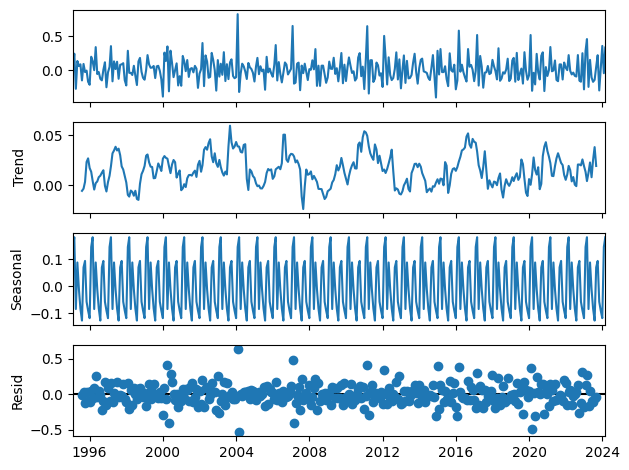


Plotting Residuals for Homoscedasticity Check...


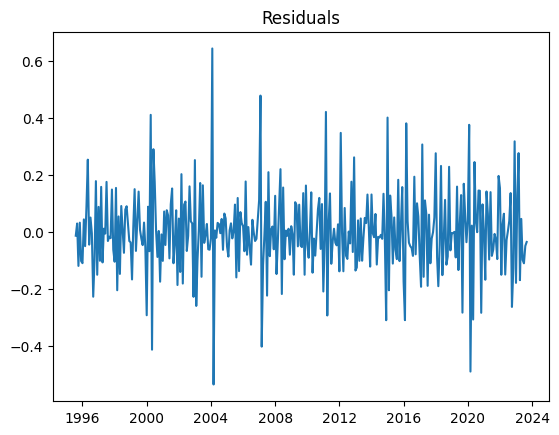

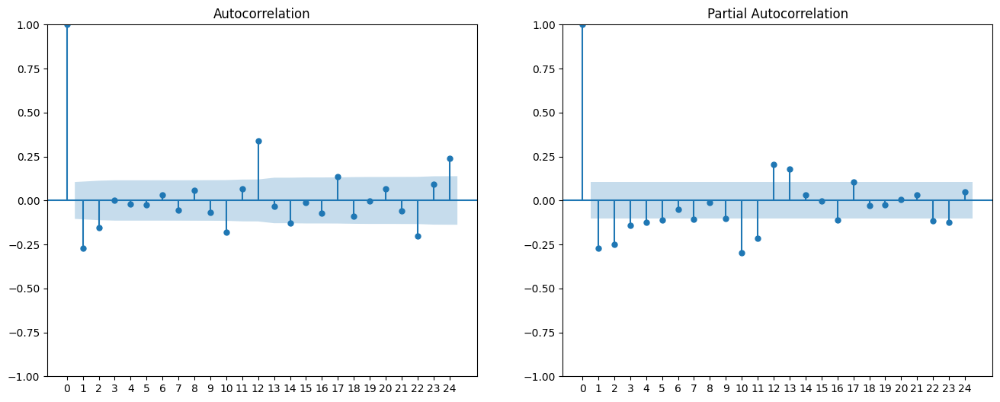


Time series assumptions are met.


True

'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -9.735153440499973
p-value: 8.790327711817594e-17
Critical Value 1%: -3.449559661646851
Critical Value 5%: -2.8700035112469626
Critical Value 10%: -2.5712790073013796
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.05256766076894533
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


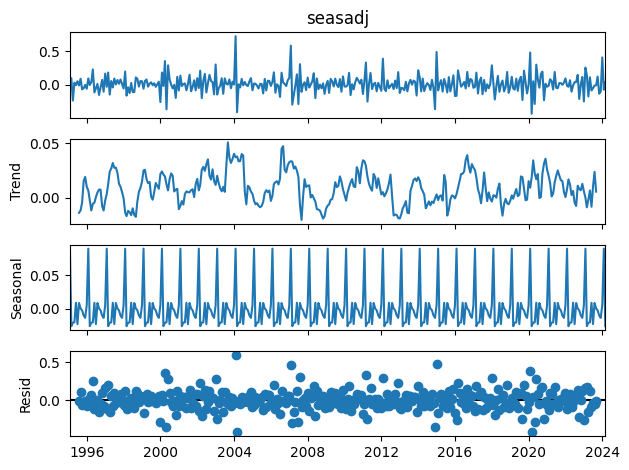


Plotting Residuals for Homoscedasticity Check...


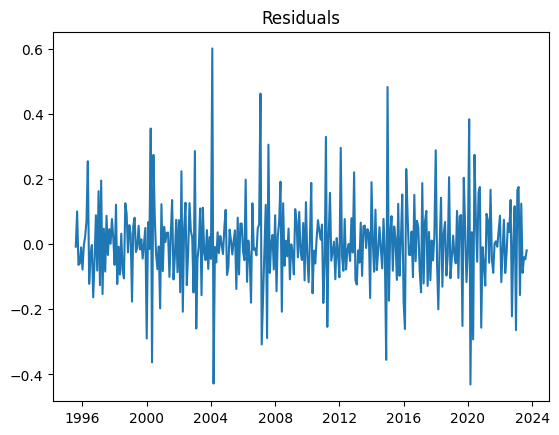

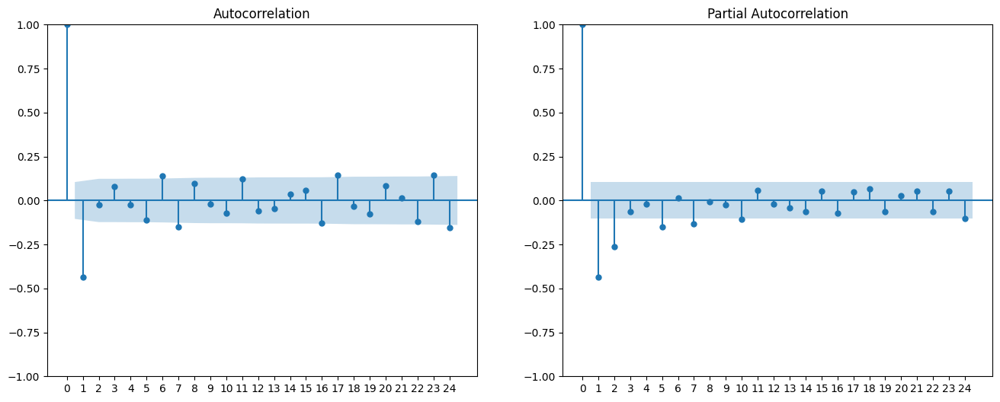


Time series assumptions are met.


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Data of Actual vs Forecasted values with error metrics:'

"Cuttlefish,_squid,_octopus",actual,forecast,error,abs_error,squared_error,abs_percentage_error
2010-02-01,-0.029857,0.009036,-0.038892,0.038892,0.001513,1.302641
2010-03-01,-0.009797,0.028602,-0.038399,0.038399,0.001475,3.919494
2010-04-01,0.177119,0.028230,0.148889,0.148889,0.022168,0.840618
2010-05-01,-0.156944,-0.067557,-0.089387,0.089387,0.007990,0.569545
2010-06-01,0.006408,0.054832,-0.048424,0.048424,0.002345,7.557089
...,...,...,...,...,...,...
2023-12-01,-0.104408,0.068434,-0.172842,0.172842,0.029874,1.655447
2024-01-01,0.408740,0.109219,0.299521,0.299521,0.089713,0.732791
2024-02-01,-0.075920,-0.181801,0.105881,0.105881,0.011211,1.394634
2024-03-01,0.035896,-0.047229,0.083125,0.083125,0.006910,2.315719


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Total Mean Absolute Error (Per Forecast): 0.08908194881866648'

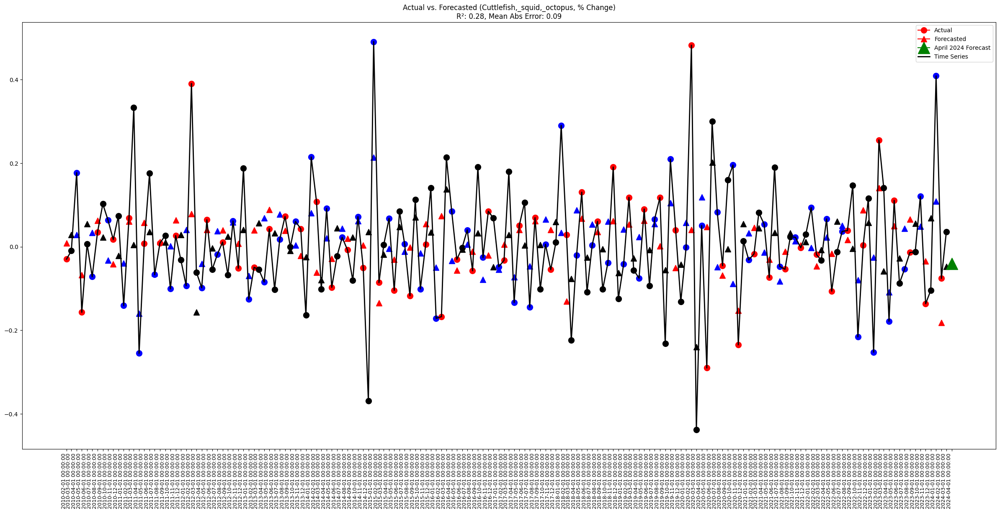

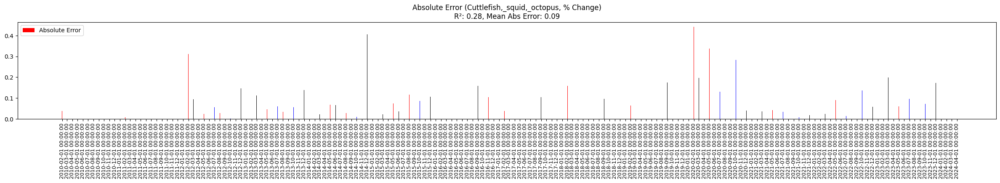

In [35]:
df = df_export_ANALYSIS[[name]]

df.plot(title=f"Export Value ({name})", label=f"{name}")
df.pct_change().plot(title=f"Export Value % Change ({name})", label=f"{name} % Change")
ts = df.pct_change().dropna()
display("Timeseries of component in % form:")
display(ts)
display("-" * 150)

### check if the data timeseries & statistical assumptions validity (stationary, seasonality, autocorrelation)
#freq 12 is used since the data is monthly, so the seasonality is 12 months YoY
display("Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):")
display(check_time_series_assumptions(ts, freq=12))
display("-" * 150)

#read the pickle file
with open(f'data/cleaned/deseasonalised_x13/update/dict_deseasonalized_value_{name}.pickle', 'rb') as handle:
    dict_deseasonalized_value = pickle.load(handle)[name]
adj_ts = dict_deseasonalized_value['seasadj'].pct_change().dropna()
display("Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):")
check_time_series_assumptions(adj_ts, freq=12)
display("-" * 150)

df_accuracy = pd.read_pickle(f"data/cleaned/SARIMA_RollWalkForward/combined/updated/accuracy/df_accuracy_{name}.pickle")
df_accuracy.columns.name = name
#Forecast are all Out-Of-Sample on a rolling basis
display("Data of Actual vs Forecasted values with error metrics:")
display(df_accuracy)
display("-" * 150)

#Plot Actual vs Forecasted values with error metrics
average_abs_error = df_accuracy["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_accuracy, name)


## Fishery_products,_n.i.e.

In [36]:
df = df_export_ANALYSIS.copy()
name = df.columns[11]
display(f"Component: {name}")

'Component: Fishery_products,_n.i.e.'

'Timeseries of component in % form:'

class,"Fishery_products,_n.i.e."
1995-02-01,-0.005405
1995-03-01,0.293478
1995-04-01,-0.004202
1995-05-01,-0.206751
1995-06-01,-0.034574
...,...
2023-11-01,0.113466
2023-12-01,-0.105263
2024-01-01,-0.068836
2024-02-01,-0.086022


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -9.771406959070204
p-value: 7.119945466444371e-17
Critical Value 1%: -3.4496162602188187
Critical Value 5%: -2.870028369720798
Critical Value 10%: -2.5712922615505627
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.11672428412169358
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


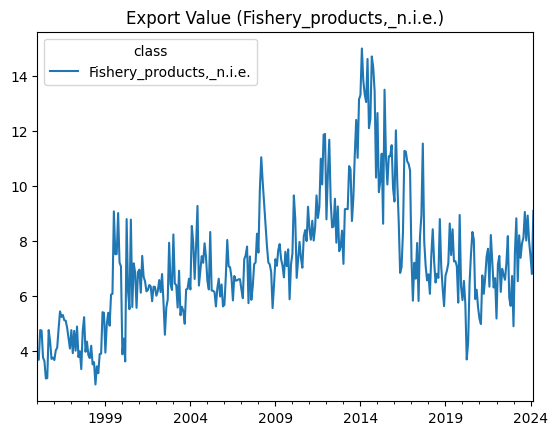

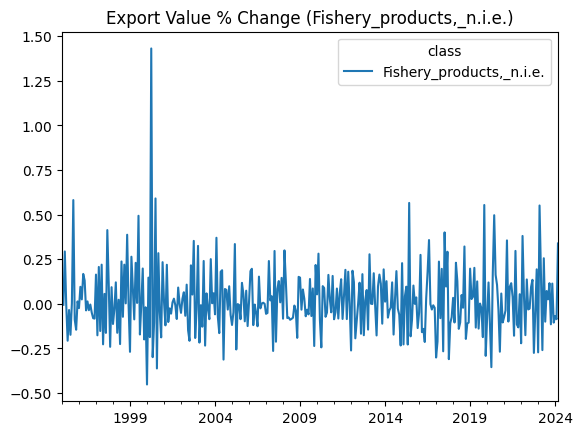

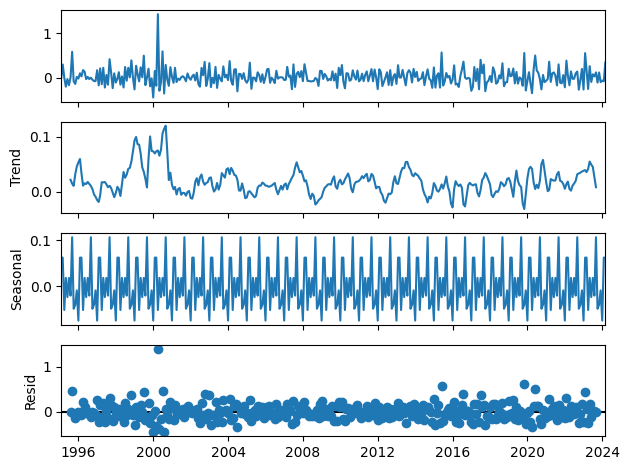


Plotting Residuals for Homoscedasticity Check...


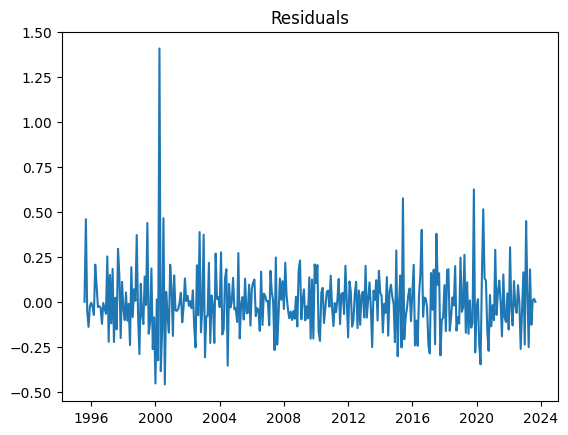

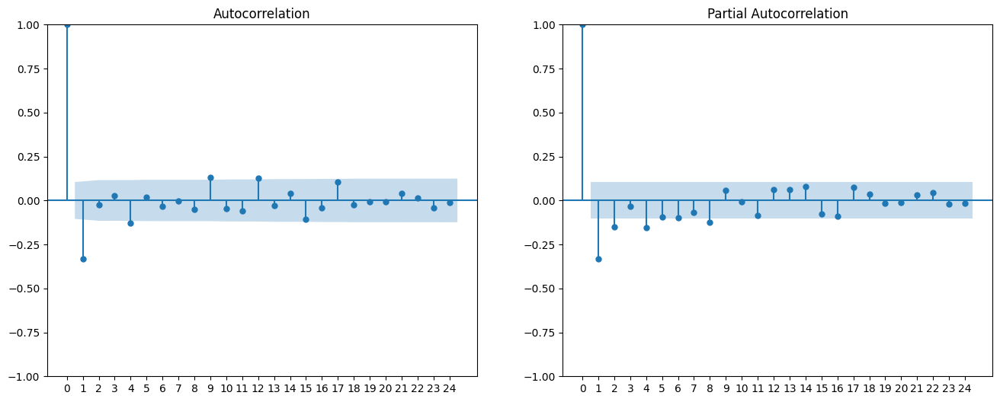


Time series assumptions are met.


True

'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -4.697726154550245
p-value: 8.498436250955315e-05
Critical Value 1%: -3.450141065277327
Critical Value 5%: -2.870258846235788
Critical Value 10%: -2.571415151457764
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.14842654209644202
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


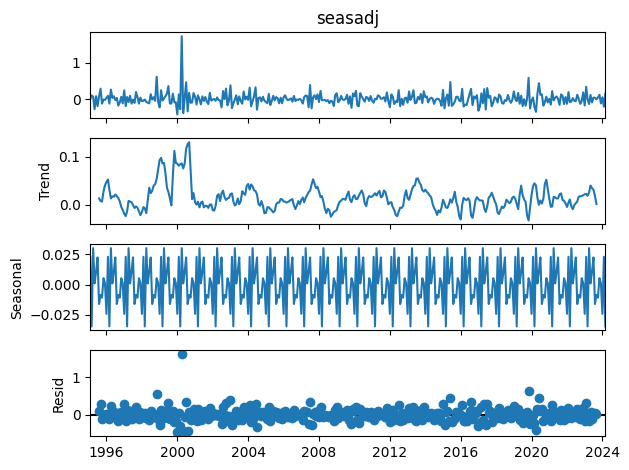


Plotting Residuals for Homoscedasticity Check...


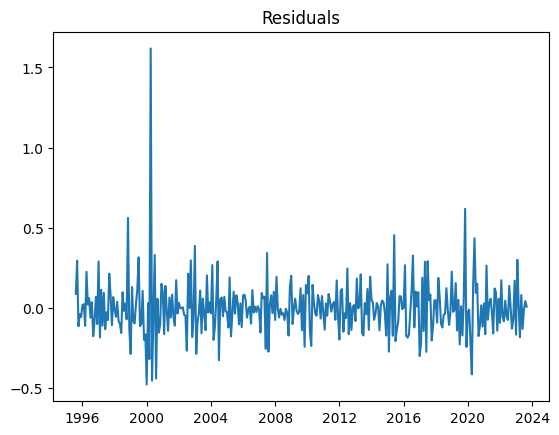

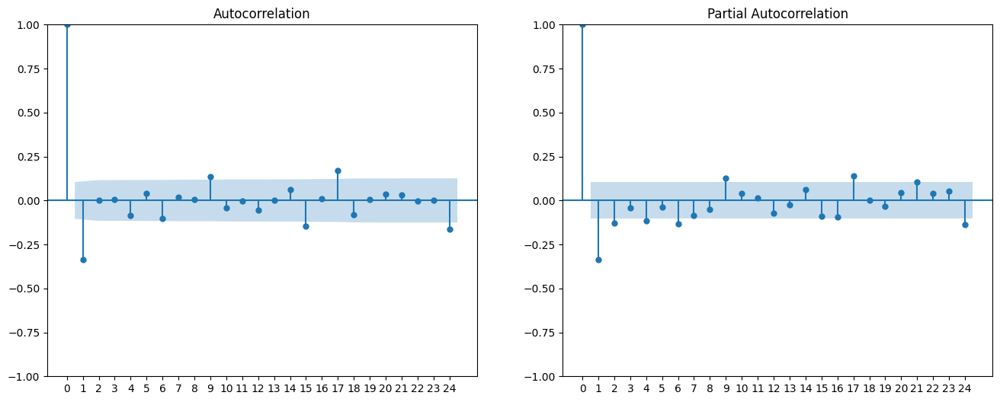


Time series assumptions are met.


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Data of Actual vs Forecasted values with error metrics:'

"Fishery_products,_n.i.e.",actual,forecast,error,abs_error,squared_error,abs_percentage_error
2010-02-01,0.235853,-0.016770,0.252623,0.252623,0.063818,1.071102
2010-03-01,-0.167285,-0.079138,-0.088147,0.088147,0.007770,0.526927
2010-04-01,-0.187089,0.053025,-0.240114,0.240114,0.057655,1.283422
2010-05-01,0.169996,0.112464,0.057533,0.057533,0.003310,0.338436
2010-06-01,0.075012,-0.004381,0.079393,0.079393,0.006303,1.058407
...,...,...,...,...,...,...
2023-12-01,-0.110615,-0.042240,-0.068375,0.068375,0.004675,0.618139
2024-01-01,0.059244,0.087515,-0.028271,0.028271,0.000799,0.477207
2024-02-01,-0.200260,-0.029094,-0.171166,0.171166,0.029298,0.854720
2024-03-01,0.157711,0.094587,0.063124,0.063124,0.003985,0.400249


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Total Mean Absolute Error (Per Forecast): 0.10456169109898415'

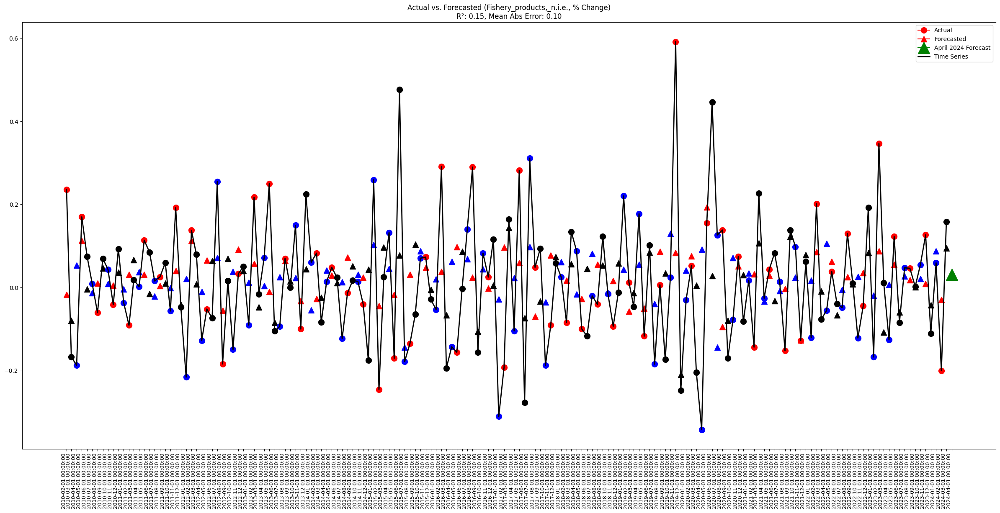

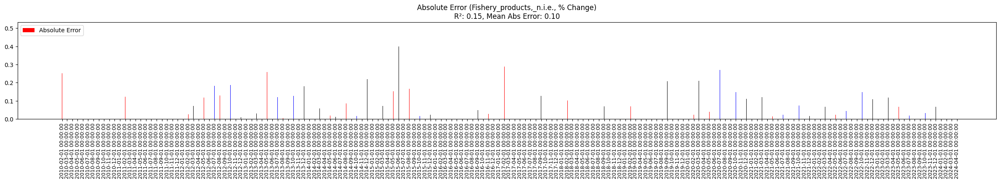

In [37]:
df = df_export_ANALYSIS[[name]]

df.plot(title=f"Export Value ({name})", label=f"{name}")
df.pct_change().plot(title=f"Export Value % Change ({name})", label=f"{name} % Change")
ts = df.pct_change().dropna()
display("Timeseries of component in % form:")
display(ts)
display("-" * 150)

### check if the data timeseries & statistical assumptions validity (stationary, seasonality, autocorrelation)
#freq 12 is used since the data is monthly, so the seasonality is 12 months YoY
display("Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):")
display(check_time_series_assumptions(ts, freq=12))
display("-" * 150)

#read the pickle file
with open(f'data/cleaned/deseasonalised_x13/update/dict_deseasonalized_value_{name}.pickle', 'rb') as handle:
    dict_deseasonalized_value = pickle.load(handle)[name]
adj_ts = dict_deseasonalized_value['seasadj'].pct_change().dropna()
display("Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):")
check_time_series_assumptions(adj_ts, freq=12)
display("-" * 150)

df_accuracy = pd.read_pickle(f"data/cleaned/SARIMA_RollWalkForward/combined/updated/accuracy/df_accuracy_{name}.pickle")
df_accuracy.columns.name = name
#Forecast are all Out-Of-Sample on a rolling basis
display("Data of Actual vs Forecasted values with error metrics:")
display(df_accuracy)
display("-" * 150)

#Plot Actual vs Forecasted values with error metrics
average_abs_error = df_accuracy["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_accuracy, name)


## Forestry

In [38]:
df = df_export_ANALYSIS.copy()
name = df.columns[12]
display(f"Component: {name}")

'Component: Forestry'

'Timeseries of component in % form:'

class,Forestry
1995-02-01,0.052960
1995-03-01,0.352071
1995-04-01,0.075492
1995-05-01,-0.129196
1995-06-01,0.245327
...,...
2023-11-01,-0.246631
2023-12-01,0.098709
2024-01-01,-0.017901
2024-02-01,0.153724


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -4.209446499863254
p-value: 0.0006350553235352651
Critical Value 1%: -3.4499043309021955
Critical Value 5%: -2.870154885338925
Critical Value 10%: -2.5713597190254385
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.35200487953005916
p-value: 0.09784272434049174
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


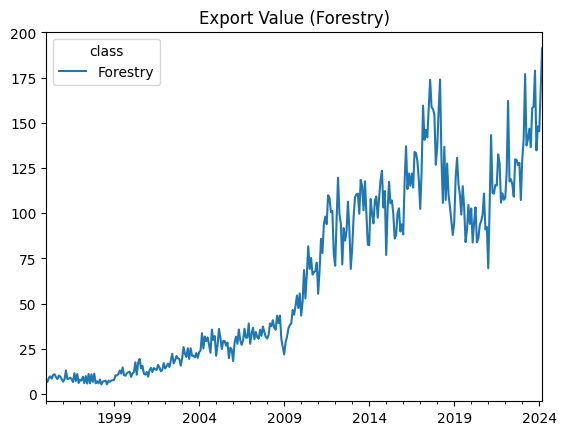

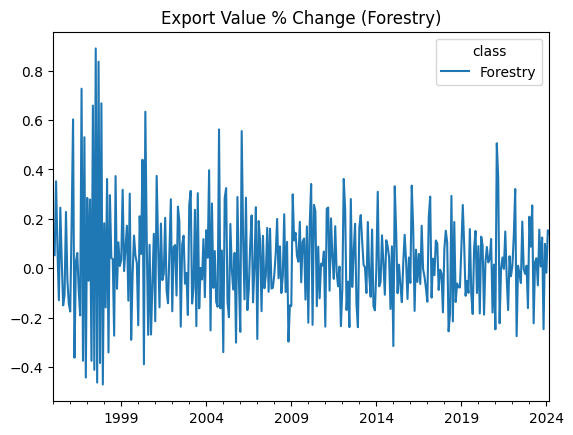

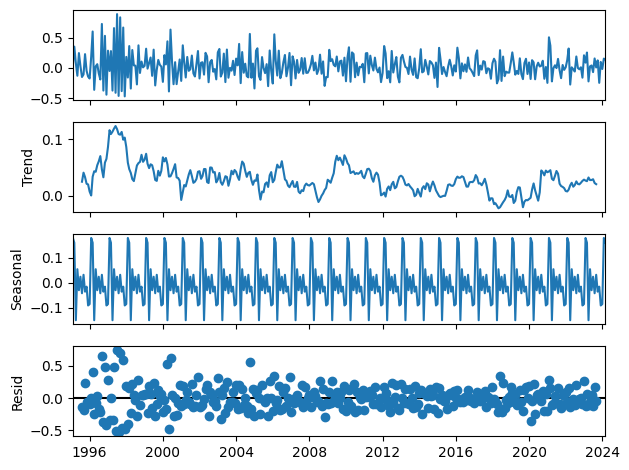


Plotting Residuals for Homoscedasticity Check...


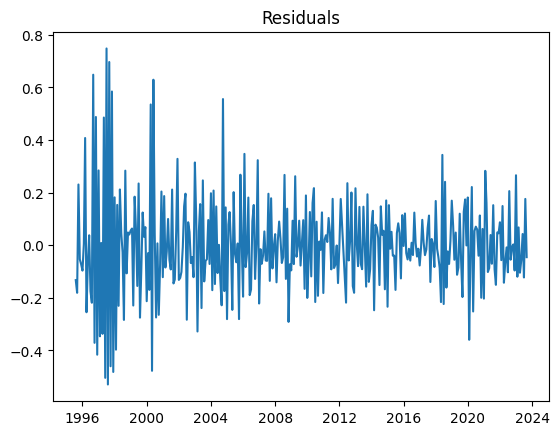

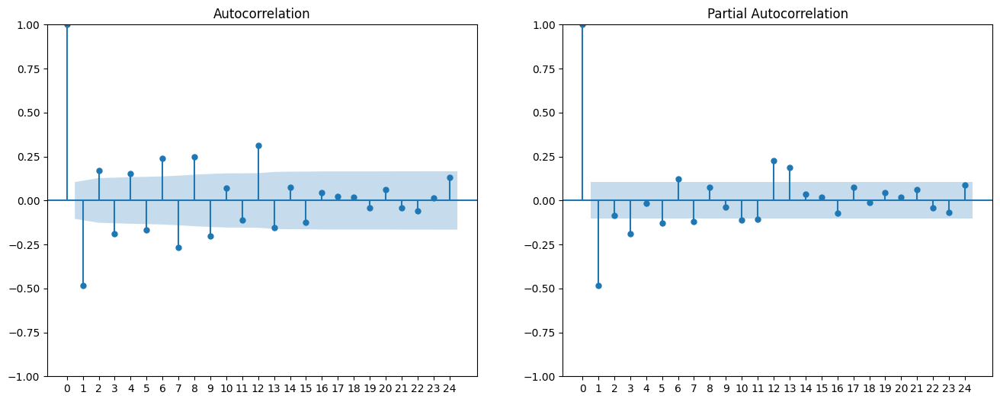


Time series assumptions are met.


True

'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -8.208757144176662
p-value: 6.909461237053829e-13
Critical Value 1%: -3.449559661646851
Critical Value 5%: -2.8700035112469626
Critical Value 10%: -2.5712790073013796
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.6477574798135671
p-value: 0.018294774562402985
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: False

Decomposing the Series...


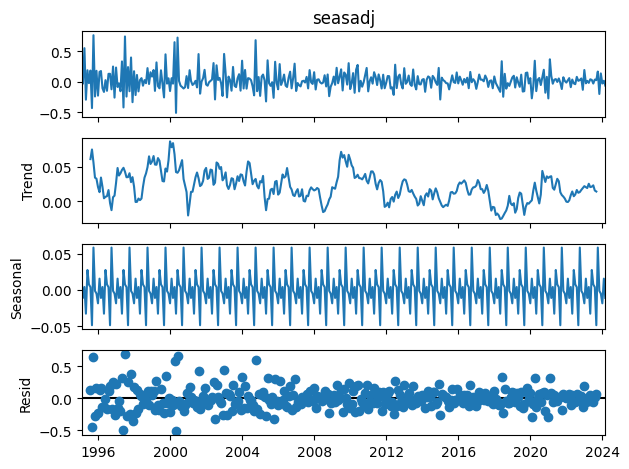


Plotting Residuals for Homoscedasticity Check...


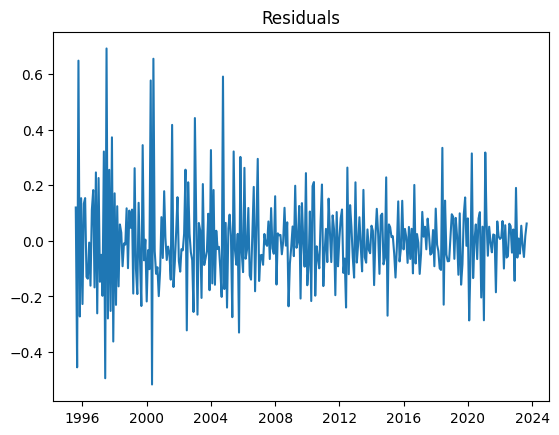

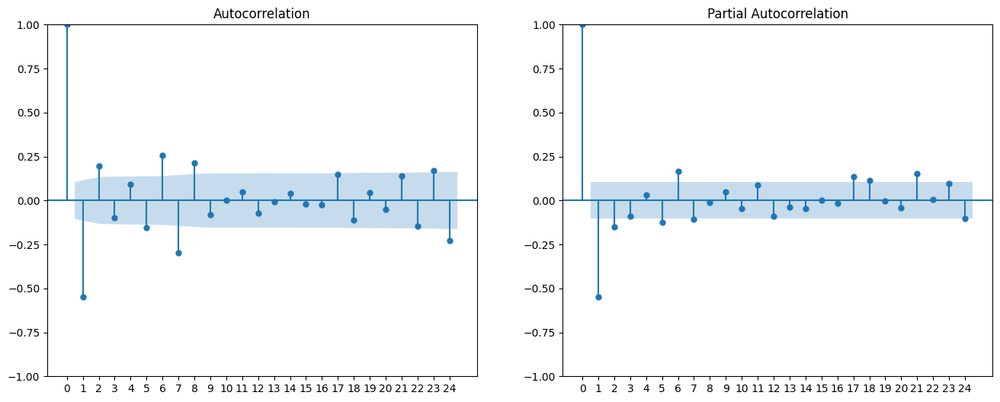


Time series assumptions are not met. Further investigation needed.


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Data of Actual vs Forecasted values with error metrics:'

Forestry,actual,forecast,error,abs_error,squared_error,abs_percentage_error
2010-02-01,-0.016861,0.095440,-0.112300,0.112300,0.012611,6.660509
2010-03-01,0.142911,0.074020,0.068891,0.068891,0.004746,0.482056
2010-04-01,-0.178647,-0.023354,-0.155294,0.155294,0.024116,0.869276
2010-05-01,0.199009,0.141460,0.057549,0.057549,0.003312,0.289177
2010-06-01,0.277159,-0.028081,0.305240,0.305240,0.093171,1.101317
...,...,...,...,...,...,...
2023-12-01,0.137918,0.127293,0.010625,0.010625,0.000113,0.077038
2024-01-01,-0.026927,-0.006634,-0.020293,0.020293,0.000412,0.753614
2024-02-01,0.017832,0.014420,0.003412,0.003412,0.000012,0.191345
2024-03-01,-0.061354,-0.020840,-0.040514,0.040514,0.001641,0.660326


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Total Mean Absolute Error (Per Forecast): 0.07999158350535383'

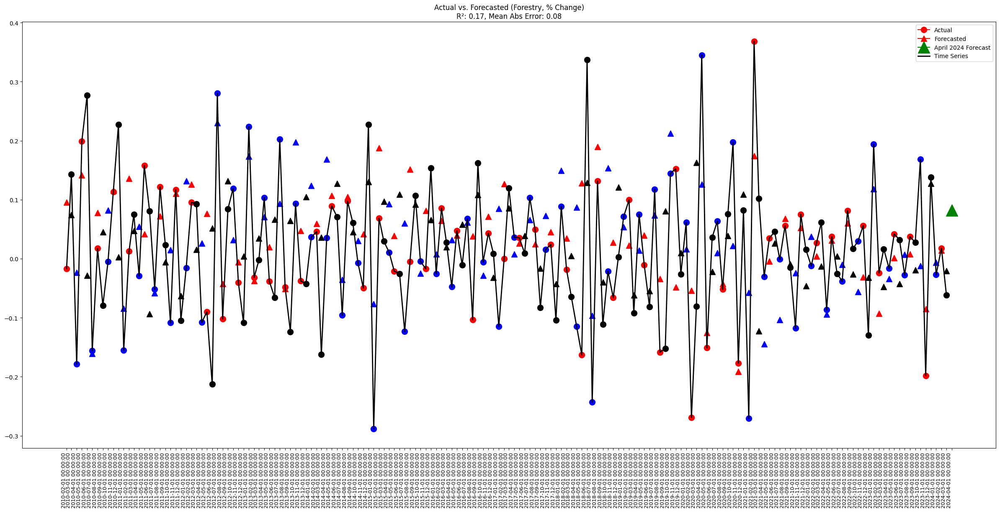

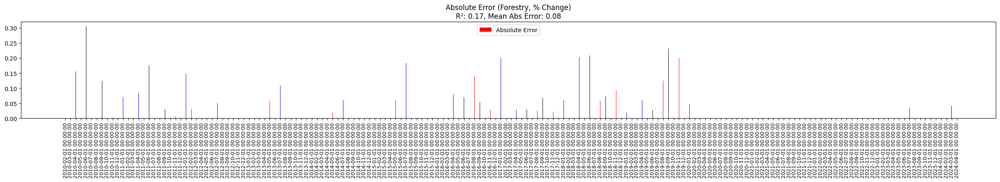

In [39]:
df = df_export_ANALYSIS[[name]]

df.plot(title=f"Export Value ({name})", label=f"{name}")
df.pct_change().plot(title=f"Export Value % Change ({name})", label=f"{name} % Change")
ts = df.pct_change().dropna()
display("Timeseries of component in % form:")
display(ts)
display("-" * 150)

### check if the data timeseries & statistical assumptions validity (stationary, seasonality, autocorrelation)
#freq 12 is used since the data is monthly, so the seasonality is 12 months YoY
display("Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):")
display(check_time_series_assumptions(ts, freq=12))
display("-" * 150)

#read the pickle file
with open(f'data/cleaned/deseasonalised_x13/update/dict_deseasonalized_value_{name}.pickle', 'rb') as handle:
    dict_deseasonalized_value = pickle.load(handle)[name]
adj_ts = dict_deseasonalized_value['seasadj'].pct_change().dropna()
display("Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):")
check_time_series_assumptions(adj_ts, freq=12)
display("-" * 150)

df_accuracy = pd.read_pickle(f"data/cleaned/SARIMA_RollWalkForward/combined/updated/accuracy/df_accuracy_{name}.pickle")
df_accuracy.columns.name = name
#Forecast are all Out-Of-Sample on a rolling basis
display("Data of Actual vs Forecasted values with error metrics:")
display(df_accuracy)
display("-" * 150)

#Plot Actual vs Forecasted values with error metrics
average_abs_error = df_accuracy["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_accuracy, name)

## Mining

In [40]:
df = df_export_ANALYSIS.copy()
name = df.columns[13]
display(f"Component: {name}")

'Component: Mining'

'Timeseries of component in % form:'

class,Mining
1995-02-01,-0.051771
1995-03-01,-0.051724
1995-04-01,0.612626
1995-05-01,-0.292828
1995-06-01,0.211692
...,...
2023-11-01,-0.552960
2023-12-01,0.581095
2024-01-01,-0.020543
2024-02-01,0.523124


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -17.492079900767735
p-value: 4.431356150193511e-30
Critical Value 1%: -3.4492815848836296
Critical Value 5%: -2.8698813715275406
Critical Value 10%: -2.5712138845950587
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.15113338218460284
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


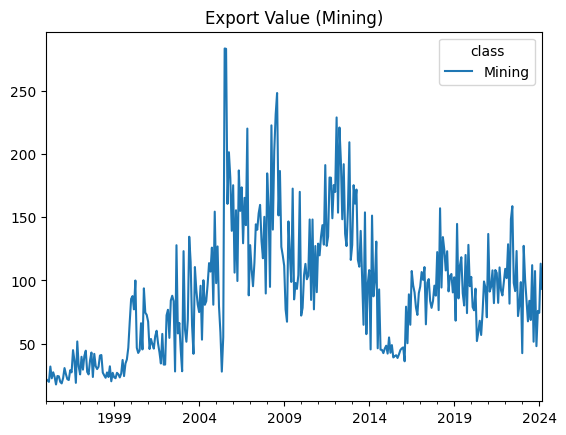

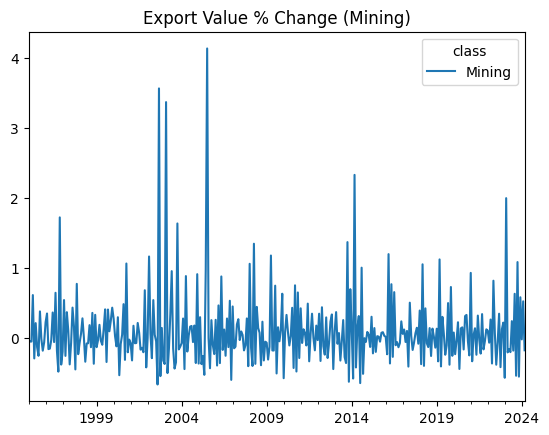

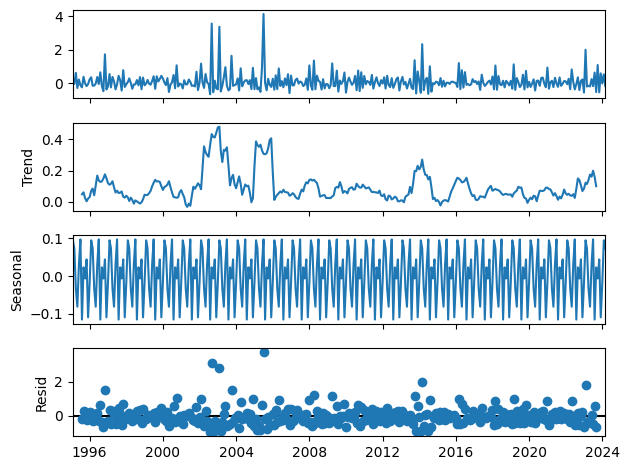


Plotting Residuals for Homoscedasticity Check...


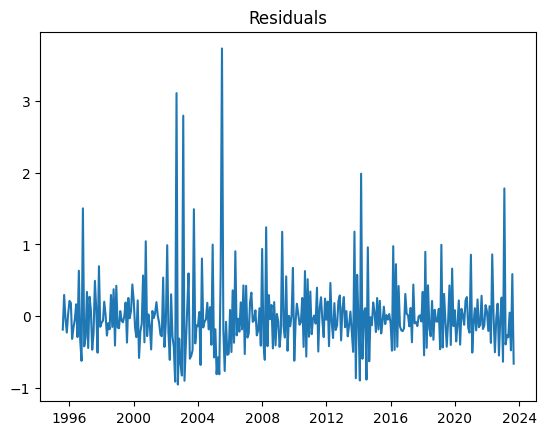

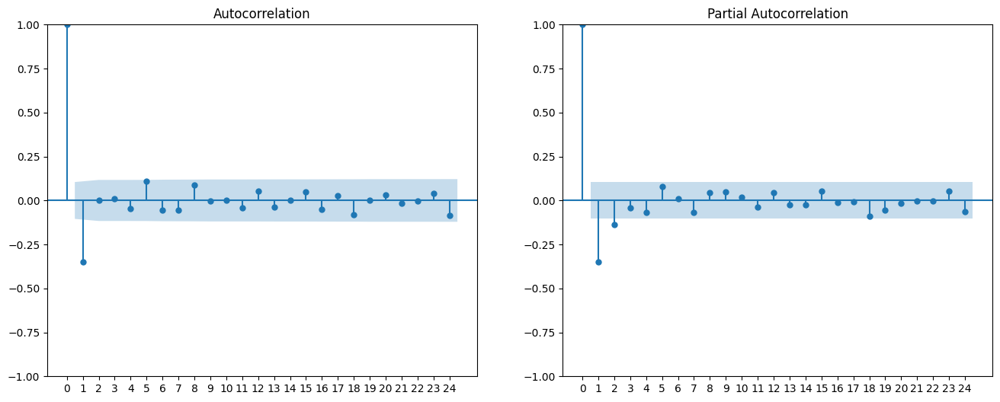


Time series assumptions are met.


True

'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -17.268486023474555
p-value: 5.8810299215281175e-30
Critical Value 1%: -3.4492815848836296
Critical Value 5%: -2.8698813715275406
Critical Value 10%: -2.5712138845950587
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.16488336042213542
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


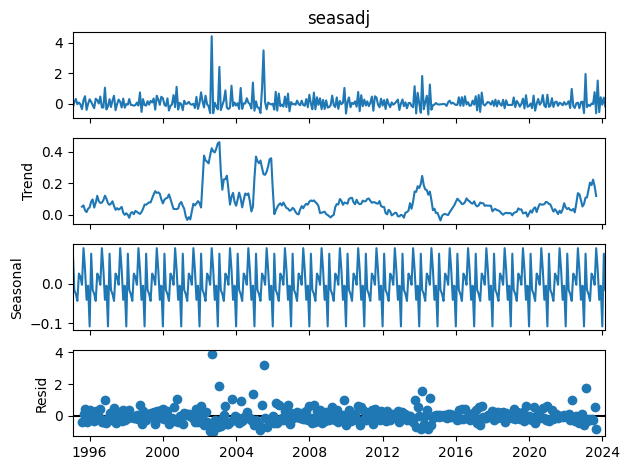


Plotting Residuals for Homoscedasticity Check...


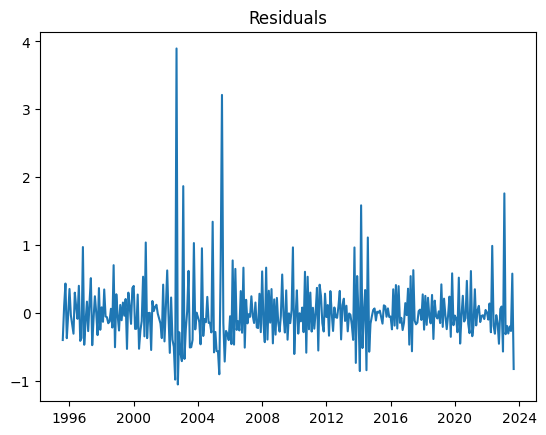

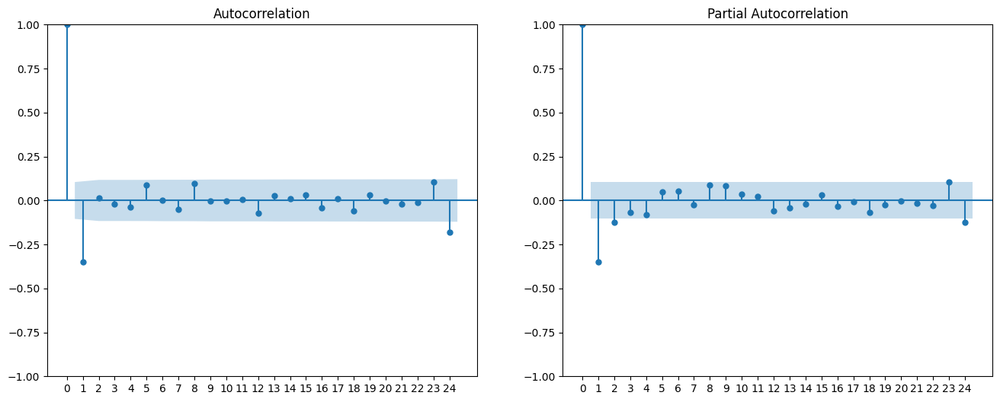


Time series assumptions are met.


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Data of Actual vs Forecasted values with error metrics:'

Mining,actual,forecast,error,abs_error,squared_error,abs_percentage_error
2010-02-01,0.119365,0.273163,-0.153798,0.153798,0.023654,1.288462
2010-03-01,0.415592,0.145709,0.269883,0.269883,0.072837,0.649395
2010-04-01,-0.227107,0.011450,-0.238556,0.238556,0.056909,1.050415
2010-05-01,0.057088,0.182600,-0.125512,0.125512,0.015753,2.198553
2010-06-01,-0.021650,0.140432,-0.162082,0.162082,0.026271,7.486320
...,...,...,...,...,...,...
2023-12-01,0.423529,0.161417,0.262112,0.262112,0.068703,0.618877
2024-01-01,-0.064944,0.068019,-0.132963,0.132963,0.017679,2.047348
2024-02-01,0.401410,-0.041370,0.442780,0.442780,0.196054,1.103062
2024-03-01,-0.179951,-0.049866,-0.130085,0.130085,0.016922,0.722893


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Total Mean Absolute Error (Per Forecast): 0.24867812814218823'

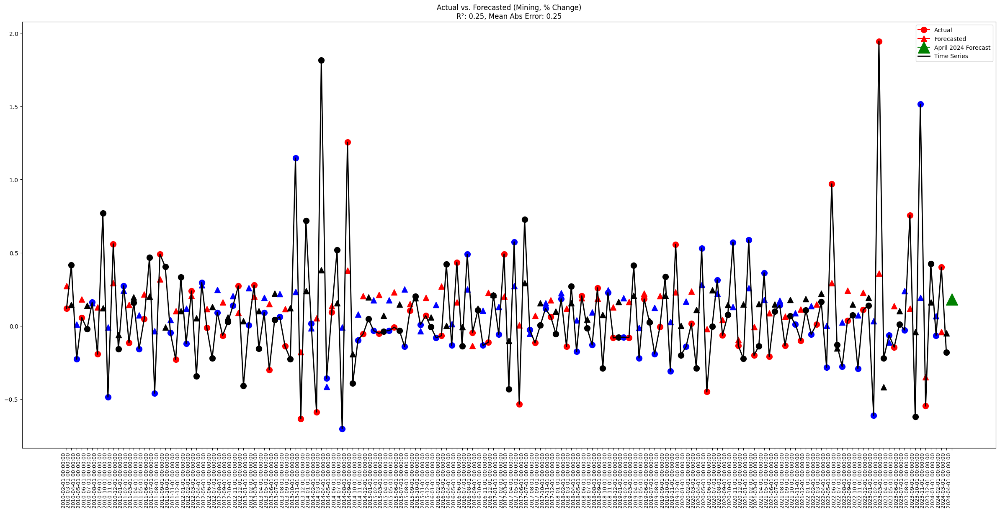

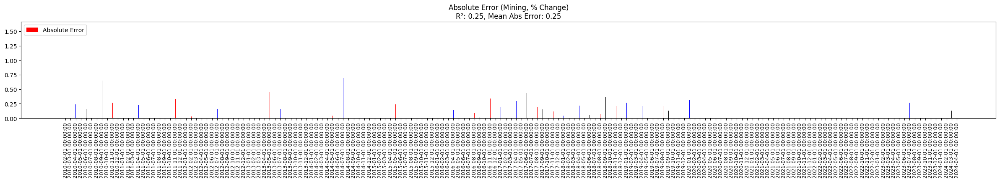

In [41]:
df = df_export_ANALYSIS[[name]]

df.plot(title=f"Export Value ({name})", label=f"{name}")
df.pct_change().plot(title=f"Export Value % Change ({name})", label=f"{name} % Change")
ts = df.pct_change().dropna()
display("Timeseries of component in % form:")
display(ts)
display("-" * 150)

### check if the data timeseries & statistical assumptions validity (stationary, seasonality, autocorrelation)
#freq 12 is used since the data is monthly, so the seasonality is 12 months YoY
display("Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):")
display(check_time_series_assumptions(ts, freq=12))
display("-" * 150)

#read the pickle file
with open(f'data/cleaned/deseasonalised_x13/update/dict_deseasonalized_value_{name}.pickle', 'rb') as handle:
    dict_deseasonalized_value = pickle.load(handle)[name]
adj_ts = dict_deseasonalized_value['seasadj'].pct_change().dropna()
display("Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):")
check_time_series_assumptions(adj_ts, freq=12)
display("-" * 150)

df_accuracy = pd.read_pickle(f"data/cleaned/SARIMA_RollWalkForward/combined/updated/accuracy/df_accuracy_{name}.pickle")
df_accuracy.columns.name = name
#Forecast are all Out-Of-Sample on a rolling basis
display("Data of Actual vs Forecasted values with error metrics:")
display(df_accuracy)
display("-" * 150)

#Plot Actual vs Forecasted values with error metrics
average_abs_error = df_accuracy["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_accuracy, name)


## Crude_oil

In [42]:
df = df_export_ANALYSIS.copy()
name = df.columns[14]
display(f"Component: {name}")

'Component: Crude_oil'

'Timeseries of component in % form:'

class,Crude_oil
1995-02-01,0.000000e+00
1995-03-01,0.000000e+00
1995-04-01,0.000000e+00
1995-05-01,0.000000e+00
1995-06-01,0.000000e+00
...,...
2023-11-01,-1.000000e+00
2023-12-01,2.534000e+11
2024-01-01,-5.564325e-02
2024-02-01,1.104471e+00


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: 0.697860115752949
p-value: 0.9897950676701244
Critical Value 1%: -3.4497304638968043
Critical Value 5%: -2.8700785273763487
Critical Value 10%: -2.571319005190311
is_stationary: False

Running KPSS Test for Stationarity...
KPSS Statistic: 0.6549118355121443
p-value: 0.017644378589805065
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: False

Decomposing the Series...


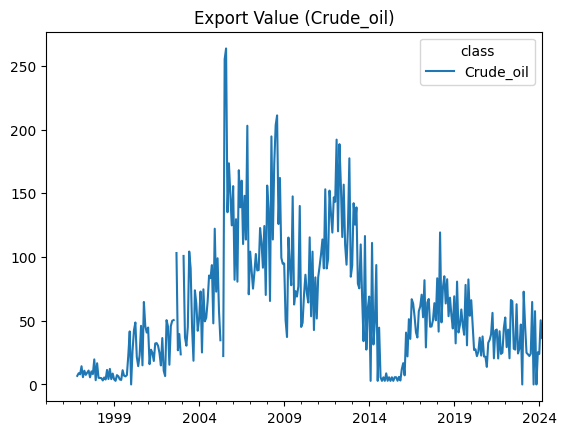

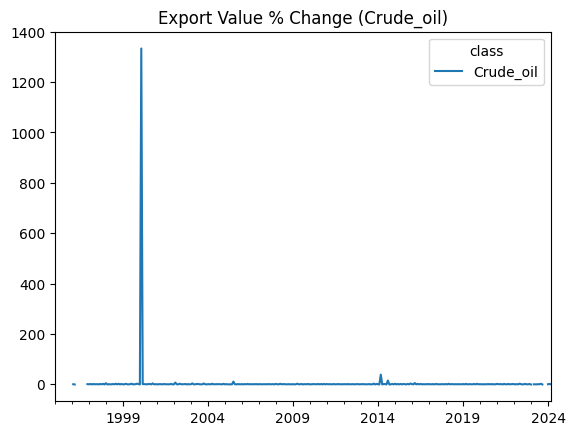

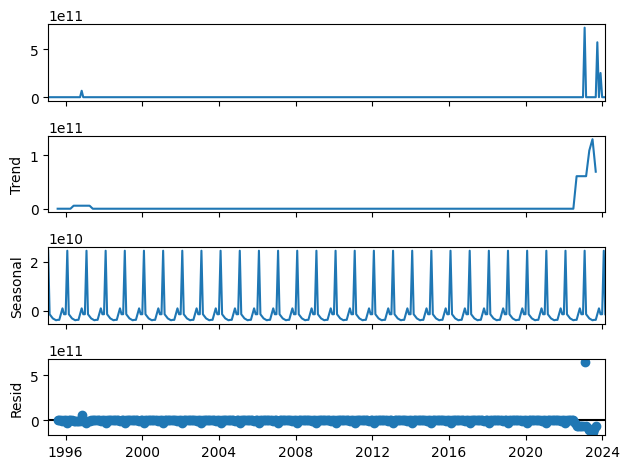


Plotting Residuals for Homoscedasticity Check...


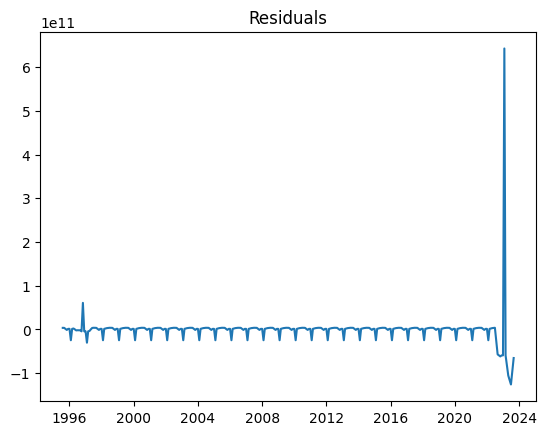

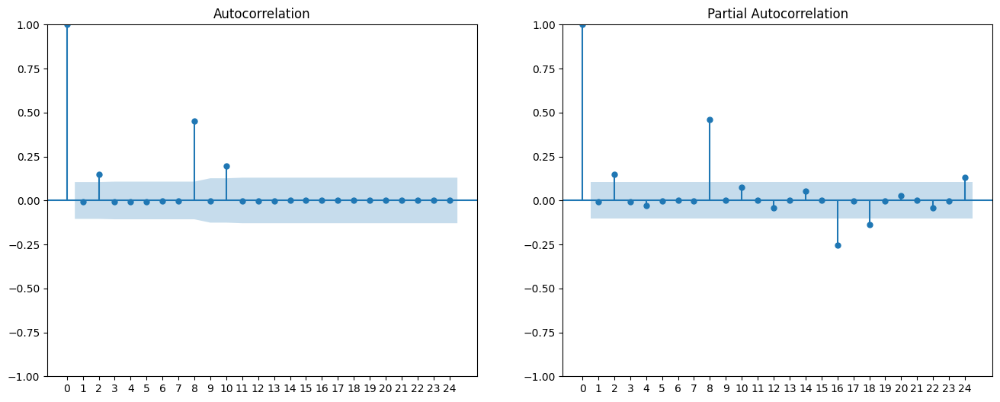


Time series assumptions are not met. Further investigation needed.


False

'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -18.102747669937845
p-value: 2.5507924713519417e-30
Critical Value 1%: -3.45050711373316
Critical Value 5%: -2.8704195794076743
Critical Value 10%: -2.571500856923753
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.22793306398210678
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


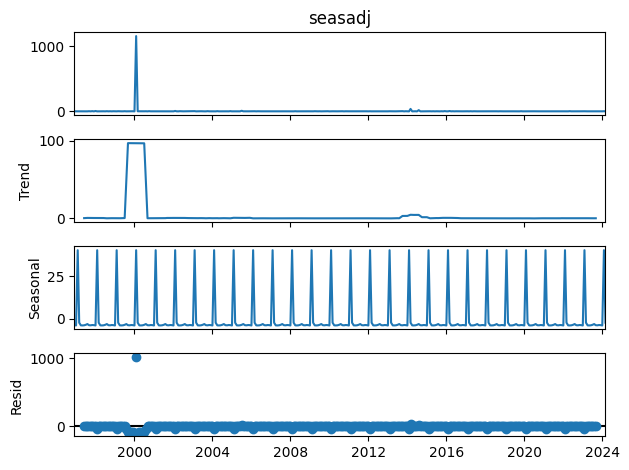


Plotting Residuals for Homoscedasticity Check...


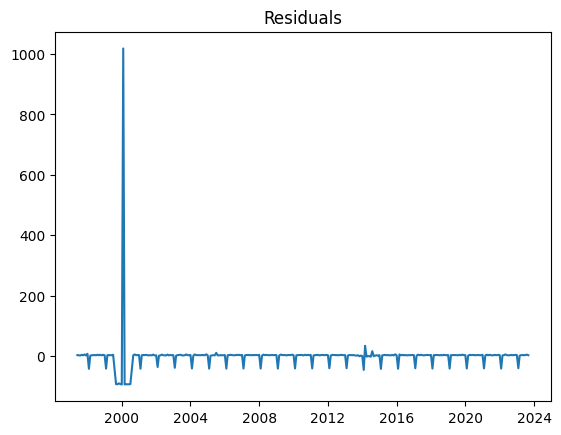

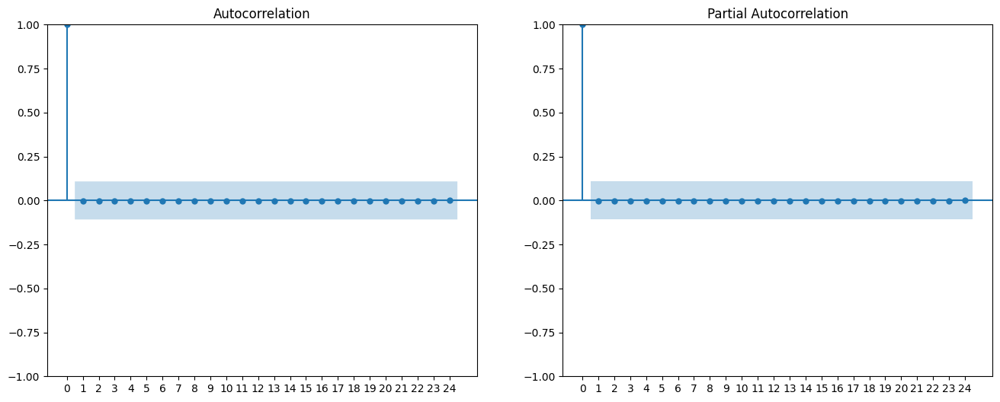


Time series assumptions are met.


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Data of Actual vs Forecasted values with error metrics:'

Crude_oil,actual,forecast,error,abs_error,squared_error,abs_percentage_error
2011-12-01,0.453250,0.0,0.453250,0.453250,0.205435,1.0
2012-01-01,-0.332757,0.0,-0.332757,0.332757,0.110727,1.0
2012-02-01,0.630862,0.0,0.630862,0.630862,0.397987,1.0
2012-03-01,-0.358105,0.0,-0.358105,0.358105,0.128239,1.0
2012-04-01,0.440111,0.0,0.440111,0.440111,0.193698,1.0
...,...,...,...,...,...,...
2023-12-01,-0.569404,0.0,-0.569404,0.569404,0.324221,1.0
2024-01-01,-0.200591,0.0,-0.200591,0.200591,0.040237,1.0
2024-02-01,1.297005,0.0,1.297005,1.297005,1.682223,1.0
2024-03-01,-0.299179,0.0,-0.299179,0.299179,0.089508,1.0


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Total Mean Absolute Error (Per Forecast): 0.8664711038237168'

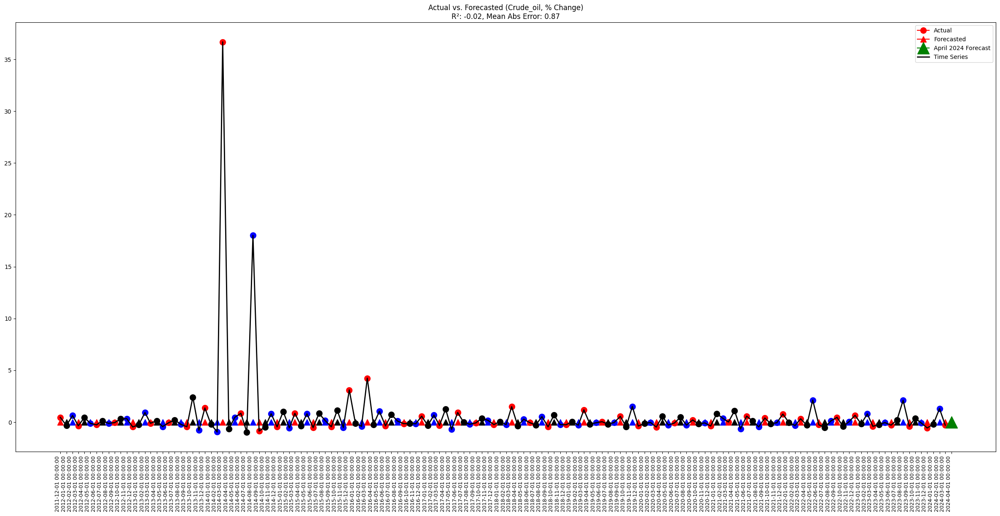

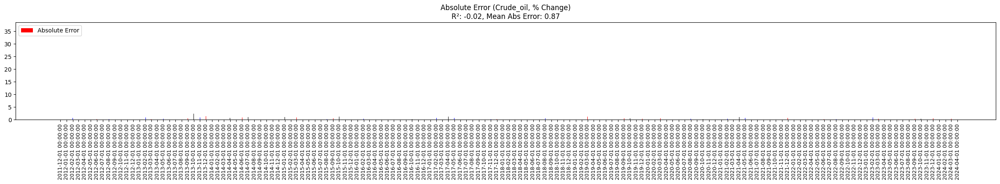

In [43]:
df = df_export_ANALYSIS[[name]]

df.plot(title=f"Export Value ({name})", label=f"{name}")
df.pct_change().plot(title=f"Export Value % Change ({name})", label=f"{name} % Change")
ts = df.replace(0, 1e-10).ffill().bfill().pct_change().dropna()
display("Timeseries of component in % form:")
display(ts)
display("-" * 150)

### check if the data timeseries & statistical assumptions validity (stationary, seasonality, autocorrelation)
#freq 12 is used since the data is monthly, so the seasonality is 12 months YoY
display("Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):")
display(check_time_series_assumptions(ts, freq=12))
display("-" * 150)

#read the pickle file
with open(f'data/cleaned/deseasonalised_x13/update/dict_deseasonalized_value_{name}.pickle', 'rb') as handle:
    dict_deseasonalized_value = pickle.load(handle)[name]
adj_ts = dict_deseasonalized_value['seasadj'].pct_change().dropna()
display("Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):")
check_time_series_assumptions(adj_ts, freq=12)
display("-" * 150)

df_accuracy = pd.read_pickle(f"data/cleaned/SARIMA_RollWalkForward/combined/updated/accuracy/df_accuracy_{name}.pickle")
df_accuracy.columns.name = name
#Forecast are all Out-Of-Sample on a rolling basis
display("Data of Actual vs Forecasted values with error metrics:")
display(df_accuracy)
display("-" * 150)

#Plot Actual vs Forecasted values with error metrics
average_abs_error = df_accuracy["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_accuracy, name)


'Total Mean Absolute Error (Per Forecast): 0.4002184745950944'

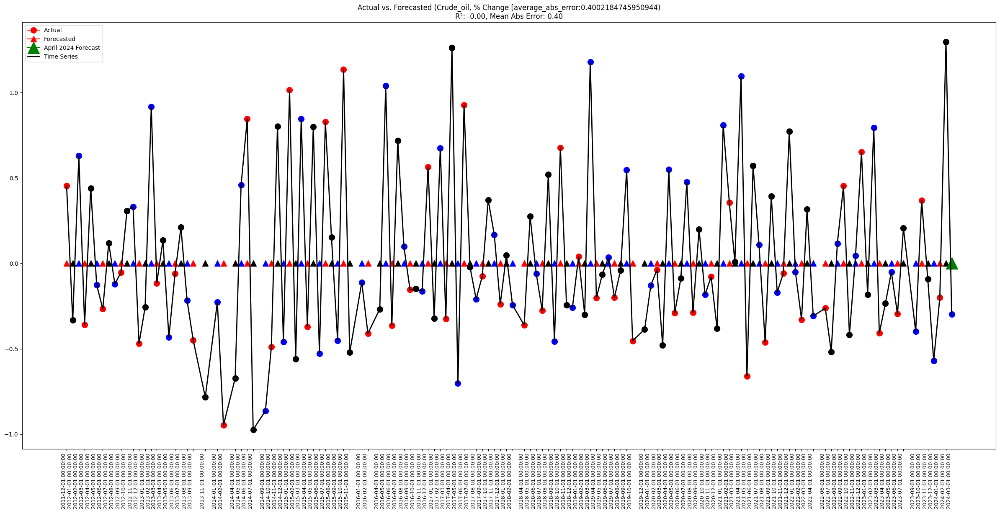

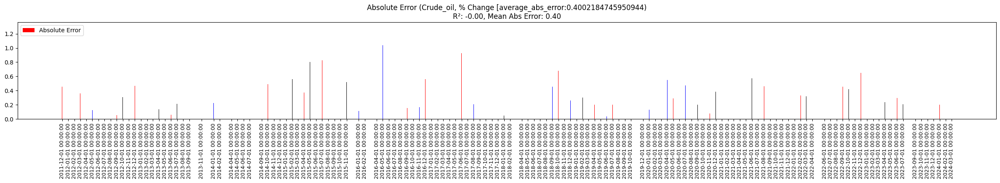

In [44]:
#it seems like the outliers miss are extremely high, which can justify the high error rate (assuming the data provider does not have a gap in logic)
#remove the outliers via IQR on abs error
Q1 = df_accuracy["abs_error"].quantile(0.25)
Q3 = df_accuracy["abs_error"].quantile(0.75)
IQR = Q3 - Q1
df_accuracy = df_accuracy[(df_accuracy["abs_error"] < (Q3 + 1.5 * IQR)) & (df_accuracy["abs_error"] > (Q1 - 1.5 * IQR))]
#Plot Actual vs Forecasted values with error metrics
average_abs_error = df_accuracy["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_accuracy, name, type=f"% Change [average_abs_error:{average_abs_error}")

# nothing can be done for this dataset, as the outlier jumps are shocks instead of non-stochastic trends and is similar to noise(just extreme), it might be possible to model this using non-timeseries analysis like sentiment/news/event-driven market reaction, which is not available publicly. Best course of action is to disregard crude oil and use the mining timeseries which is the parent for this that has a non-stochastic trend that can be modelled, as a single series. Futhermore, Crude oil exports are not frequent or a major weight.

## Mineral_products,_n.i.e.

In [45]:
df = df_export_ANALYSIS.copy()
name = df.columns[15]
display(f"Component: {name}")

'Component: Mineral_products,_n.i.e.'

'Timeseries of component in % form:'

class,"Mineral_products,_n.i.e."
1995-02-01,-0.051771
1995-03-01,-0.051724
1995-04-01,0.612626
1995-05-01,-0.292828
1995-06-01,0.211692
...,...
2023-11-01,-0.038438
2023-12-01,0.053300
2024-01-01,-0.002767
2024-02-01,0.247374


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -19.759938584546642
p-value: 0.0
Critical Value 1%: -3.4492815848836296
Critical Value 5%: -2.8698813715275406
Critical Value 10%: -2.5712138845950587
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.2521266141514137
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


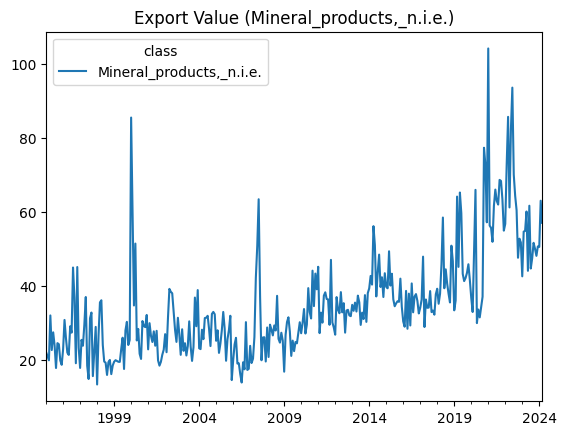

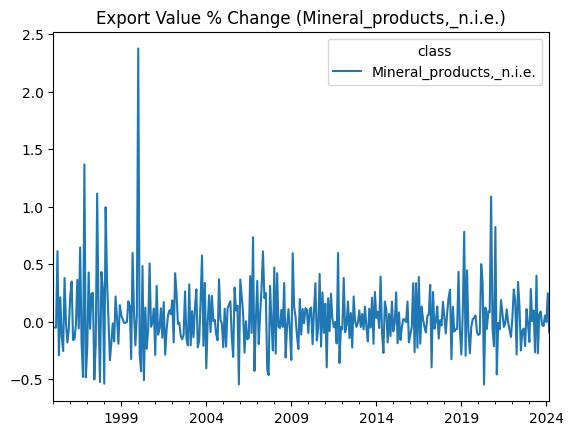

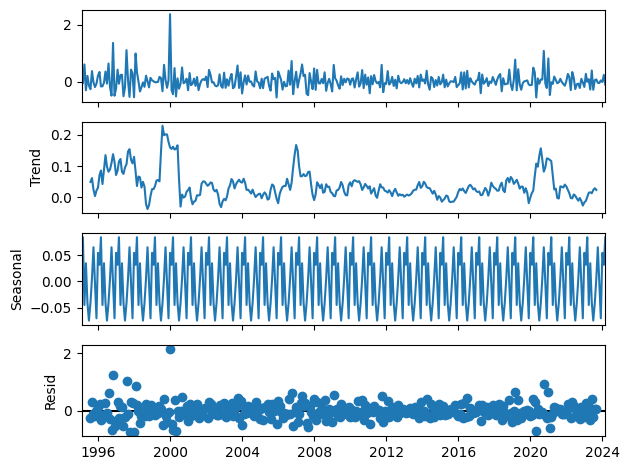


Plotting Residuals for Homoscedasticity Check...


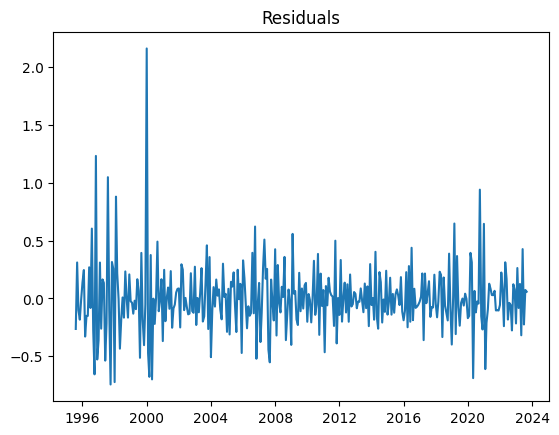

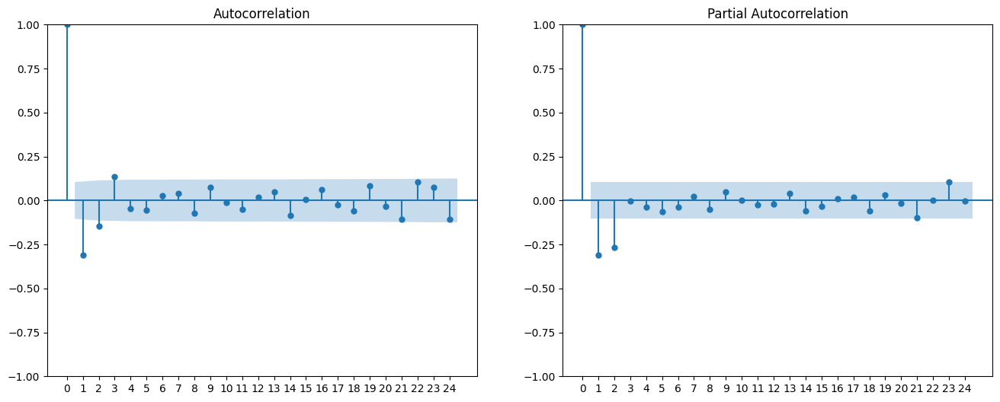


Time series assumptions are met.


True

'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -20.25638353021514
p-value: 0.0
Critical Value 1%: -3.4492815848836296
Critical Value 5%: -2.8698813715275406
Critical Value 10%: -2.5712138845950587
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.15896342612068062
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


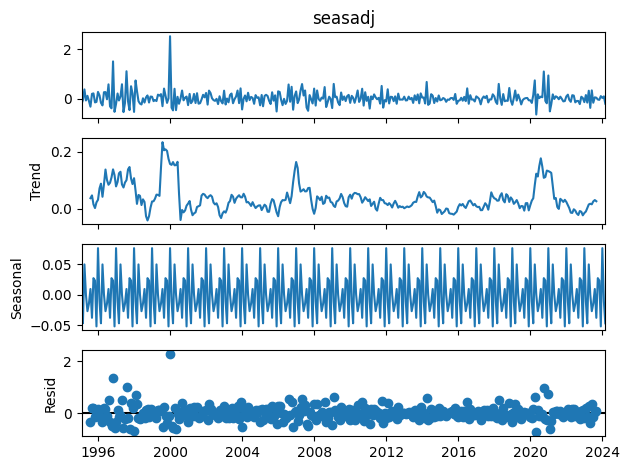


Plotting Residuals for Homoscedasticity Check...


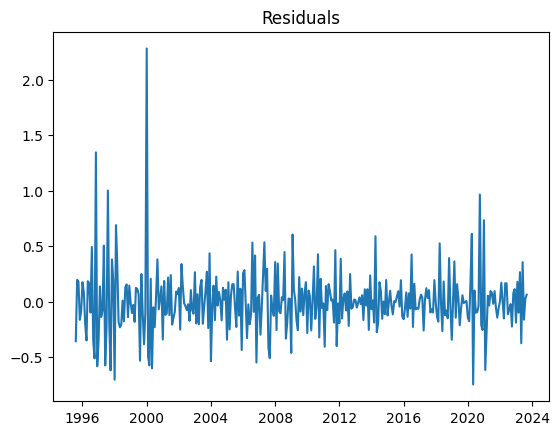

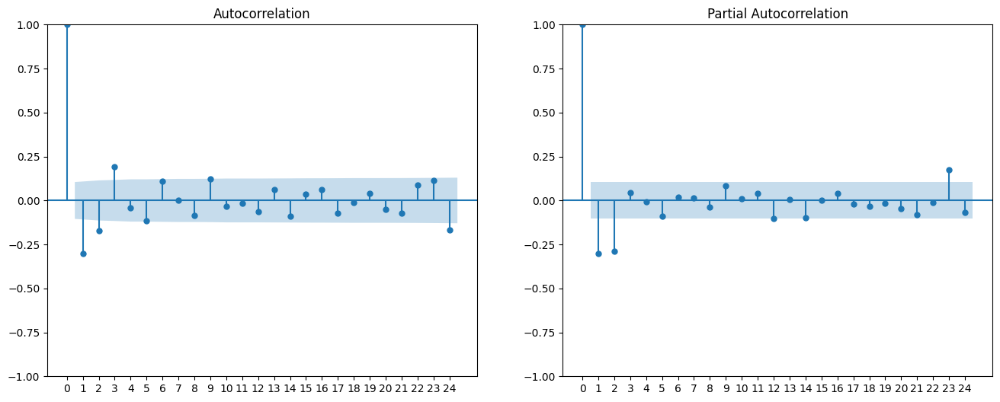


Time series assumptions are met.


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Data of Actual vs Forecasted values with error metrics:'

"Mineral_products,_n.i.e.",actual,forecast,error,abs_error,squared_error,abs_percentage_error
2010-02-01,0.123940,0.029615,0.094326,0.094326,8.897307e-03,0.761055
2010-03-01,0.051701,0.067129,-0.015427,0.015427,2.380017e-04,0.298393
2010-04-01,-0.154533,-0.016077,-0.138456,0.138456,1.917020e-02,0.895965
2010-05-01,0.064468,0.139627,-0.075159,0.075159,5.648805e-03,1.165821
2010-06-01,0.340929,0.155790,0.185139,0.185139,3.427638e-02,0.543042
...,...,...,...,...,...,...
2023-12-01,0.113867,0.113383,0.000484,0.000484,2.338630e-07,0.004247
2024-01-01,0.040300,-0.002162,0.042462,0.042462,1.803016e-03,1.053648
2024-02-01,0.103223,0.001897,0.101326,0.101326,1.026691e-02,0.981618
2024-03-01,-0.190134,0.058474,-0.248608,0.248608,6.180583e-02,1.307543


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Total Mean Absolute Error (Per Forecast): 0.14162961119665243'

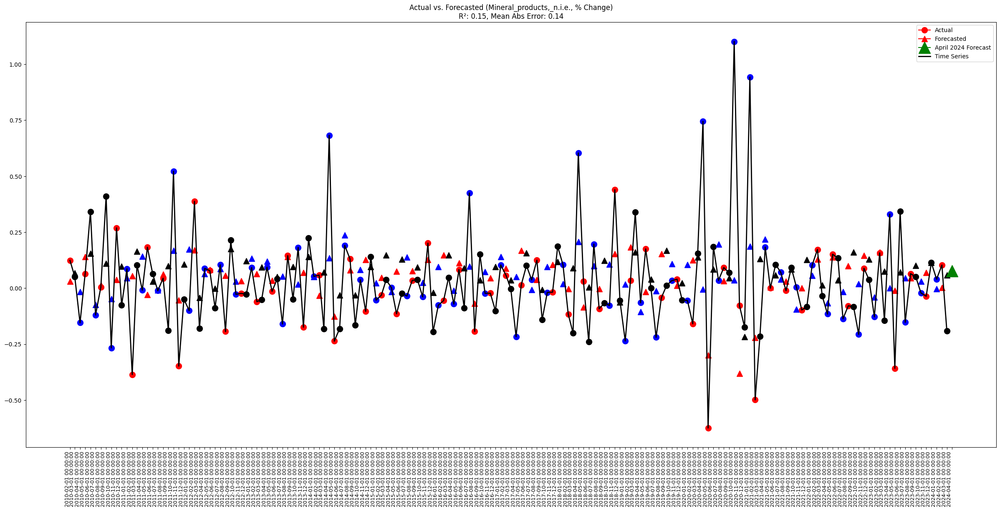

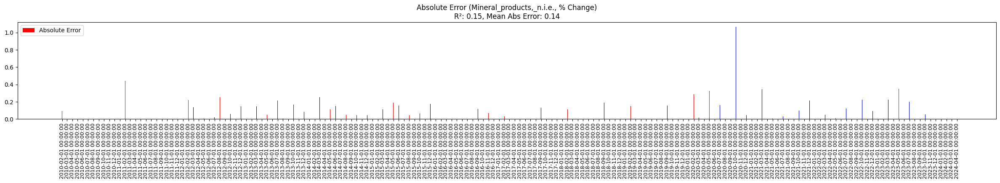

In [46]:
df = df_export_ANALYSIS[[name]]

df.plot(title=f"Export Value ({name})", label=f"{name}")
df.pct_change().plot(title=f"Export Value % Change ({name})", label=f"{name} % Change")
ts = df.pct_change().dropna()
display("Timeseries of component in % form:")
display(ts)
display("-" * 150)

### check if the data timeseries & statistical assumptions validity (stationary, seasonality, autocorrelation)
#freq 12 is used since the data is monthly, so the seasonality is 12 months YoY
display("Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):")
display(check_time_series_assumptions(ts, freq=12))
display("-" * 150)

#read the pickle file
with open(f'data/cleaned/deseasonalised_x13/update/dict_deseasonalized_value_{name}.pickle', 'rb') as handle:
    dict_deseasonalized_value = pickle.load(handle)[name]
adj_ts = dict_deseasonalized_value['seasadj'].pct_change().dropna()
display("Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):")
check_time_series_assumptions(adj_ts, freq=12)
display("-" * 150)

df_accuracy = pd.read_pickle(f"data/cleaned/SARIMA_RollWalkForward/combined/updated/accuracy/df_accuracy_{name}.pickle")
df_accuracy.columns.name = name
#Forecast are all Out-Of-Sample on a rolling basis
display("Data of Actual vs Forecasted values with error metrics:")
display(df_accuracy)
display("-" * 150)

#Plot Actual vs Forecasted values with error metrics
average_abs_error = df_accuracy["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_accuracy, name)

## Manufacturing

In [47]:
df = df_export_ANALYSIS.copy()
name = df.columns[16]
display(f"Component: {name}")

'Component: Manufacturing'

'Timeseries of component in % form:'

class,Manufacturing
1995-02-01,0.026971
1995-03-01,0.326152
1995-04-01,-0.216692
1995-05-01,0.191875
1995-06-01,0.050954
...,...
2023-11-01,0.027194
2023-12-01,-0.034369
2024-01-01,-0.016421
2024-02-01,0.024792


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -5.050837828510198
p-value: 1.7587027887833132e-05
Critical Value 1%: -3.4502011472639724
Critical Value 5%: -2.8702852297358983
Critical Value 10%: -2.5714292194077513
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.08037579806219414
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


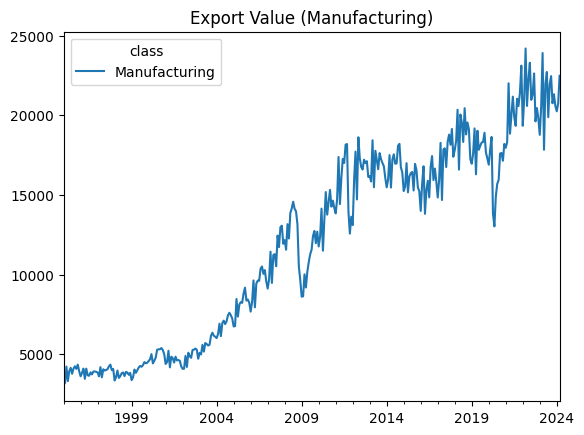

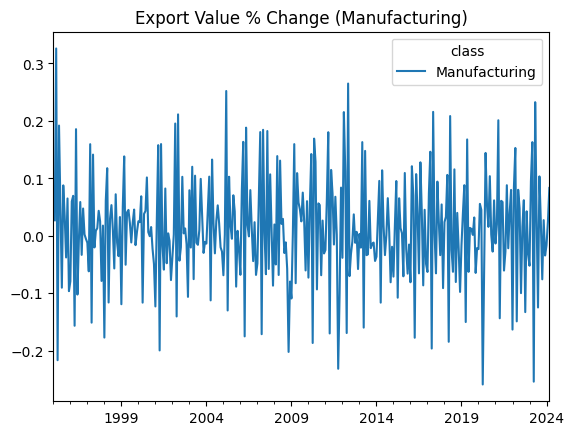

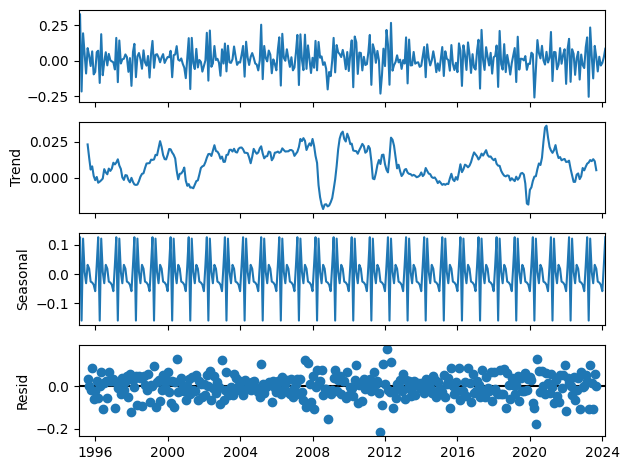


Plotting Residuals for Homoscedasticity Check...


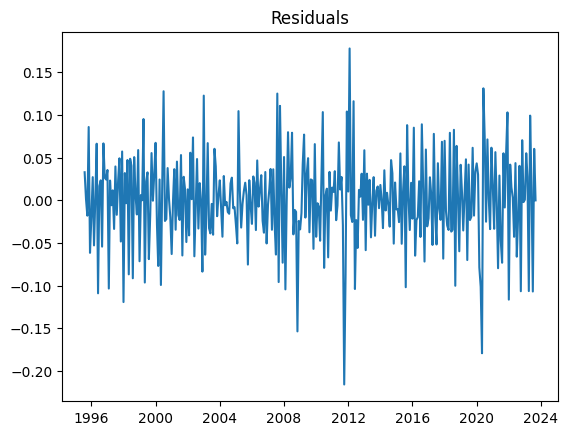

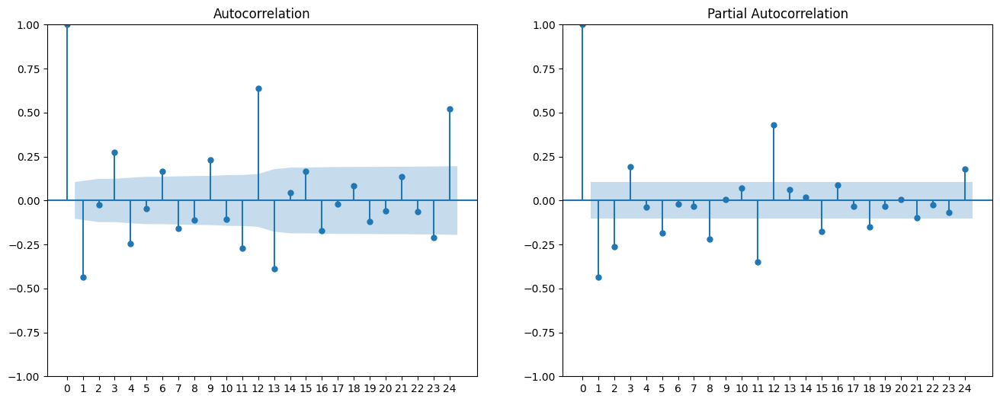


Time series assumptions are met.


True

'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -6.077167552411928
p-value: 1.1144093941294582e-07
Critical Value 1%: -3.449673193310592
Critical Value 5%: -2.8700533746644323
Critical Value 10%: -2.5713055939491403
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.13090623690563918
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


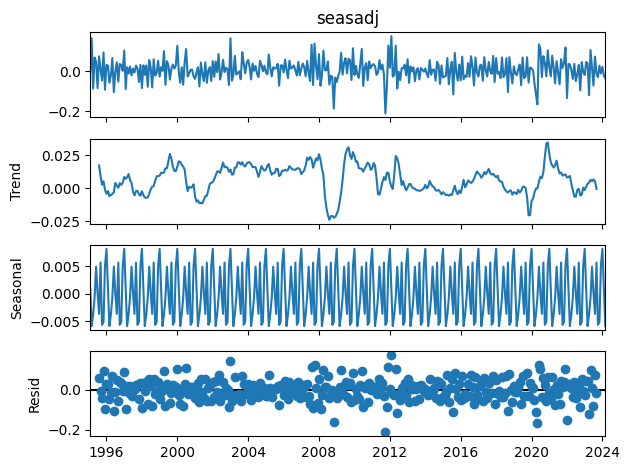


Plotting Residuals for Homoscedasticity Check...


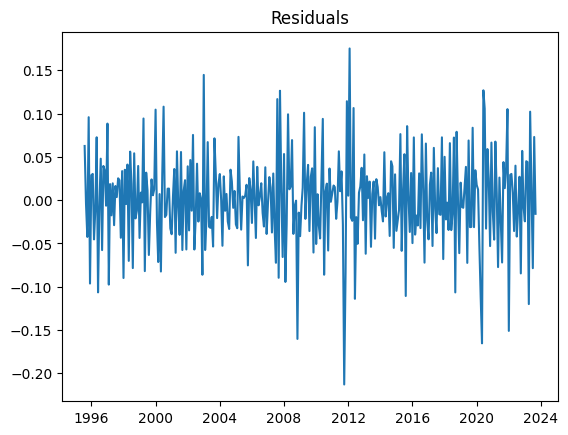

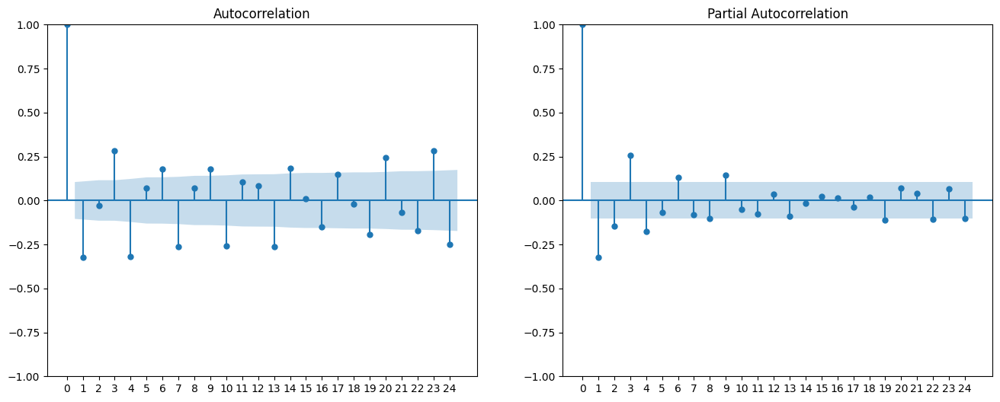


Time series assumptions are met.


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Data of Actual vs Forecasted values with error metrics:'

Manufacturing,actual,forecast,error,abs_error,squared_error,abs_percentage_error
2010-02-01,0.027543,0.006181,0.021362,0.021362,0.000456,0.775589
2010-03-01,-0.014531,0.040611,-0.055142,0.055142,0.003041,3.794682
2010-04-01,-0.032884,-0.015581,-0.017302,0.017302,0.000299,0.526169
2010-05-01,0.038053,-0.011775,0.049827,0.049827,0.002483,1.309428
2010-06-01,0.113312,0.004087,0.109225,0.109225,0.011930,0.963934
...,...,...,...,...,...,...
2023-12-01,-0.010933,-0.050080,0.039147,0.039147,0.001532,3.580637
2024-01-01,0.023044,0.007639,0.015404,0.015404,0.000237,0.668481
2024-02-01,-0.020558,0.053213,-0.073771,0.073771,0.005442,3.588488
2024-03-01,-0.034601,-0.007797,-0.026804,0.026804,0.000718,0.774662


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Total Mean Absolute Error (Per Forecast): 0.037686125192828906'

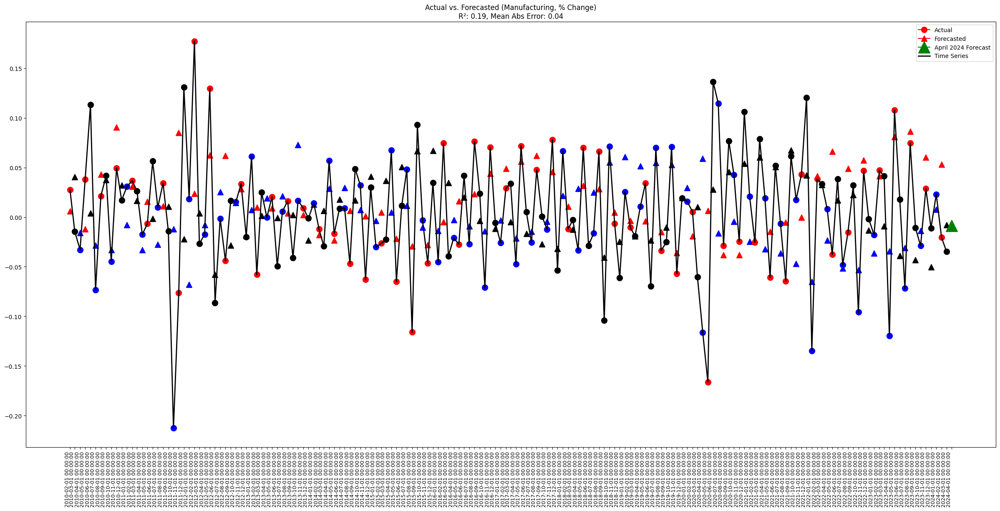

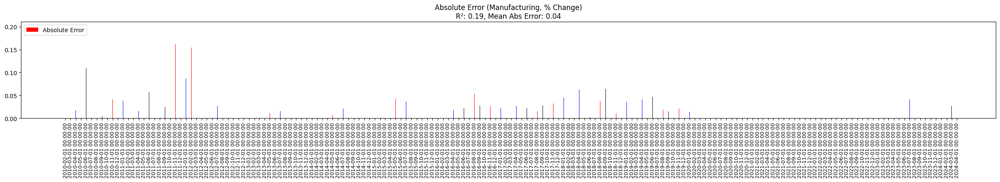

In [48]:
df = df_export_ANALYSIS[[name]]

df.plot(title=f"Export Value ({name})", label=f"{name}")
df.pct_change().plot(title=f"Export Value % Change ({name})", label=f"{name} % Change")
ts = df.pct_change().dropna()
display("Timeseries of component in % form:")
display(ts)
display("-" * 150)

### check if the data timeseries & statistical assumptions validity (stationary, seasonality, autocorrelation)
#freq 12 is used since the data is monthly, so the seasonality is 12 months YoY
display("Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):")
display(check_time_series_assumptions(ts, freq=12))
display("-" * 150)

#read the pickle file
with open(f'data/cleaned/deseasonalised_x13/update/dict_deseasonalized_value_{name}.pickle', 'rb') as handle:
    dict_deseasonalized_value = pickle.load(handle)[name]
adj_ts = dict_deseasonalized_value['seasadj'].pct_change().dropna()
display("Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):")
check_time_series_assumptions(adj_ts, freq=12)
display("-" * 150)

df_accuracy = pd.read_pickle(f"data/cleaned/SARIMA_RollWalkForward/combined/updated/accuracy/df_accuracy_{name}.pickle")
df_accuracy.columns.name = name
#Forecast are all Out-Of-Sample on a rolling basis
display("Data of Actual vs Forecasted values with error metrics:")
display(df_accuracy)
display("-" * 150)

#Plot Actual vs Forecasted values with error metrics
average_abs_error = df_accuracy["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_accuracy, name)


## Agro-manufacturing_Products

In [49]:
df = df_export_ANALYSIS.copy()
name = df.columns[17]
display(f"Component: {name}")

'Component: Agro-manufacturing_Products'

'Timeseries of component in % form:'

class,Agro-manufacturing_Products
1995-02-01,0.077919
1995-03-01,0.546396
1995-04-01,-0.153950
1995-05-01,0.083959
1995-06-01,-0.075488
...,...
2023-11-01,0.005859
2023-12-01,-0.083868
2024-01-01,0.013838
2024-02-01,0.094663


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -4.795625334992418
p-value: 5.544366445417211e-05
Critical Value 1%: -3.449962981927952
Critical Value 5%: -2.870180642420163
Critical Value 10%: -2.5713734527352607
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.12843393488062868
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


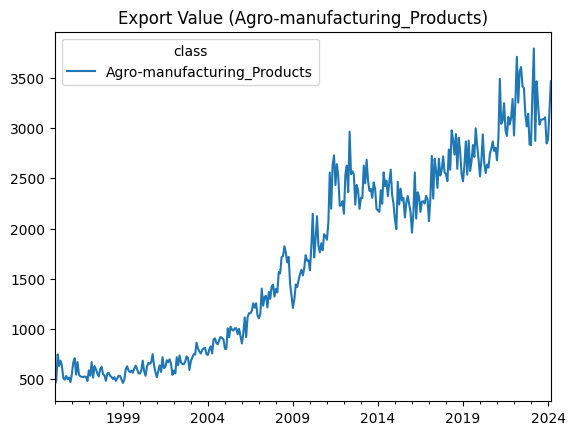

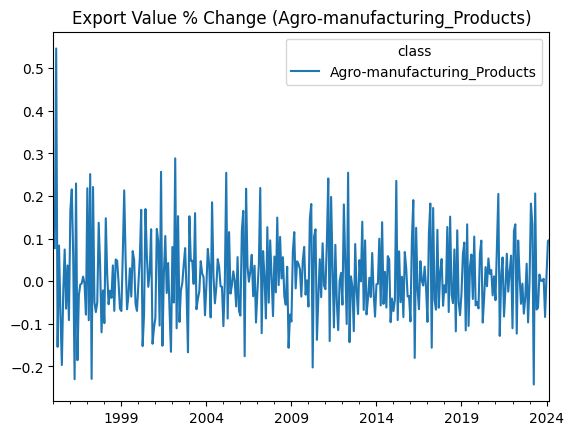

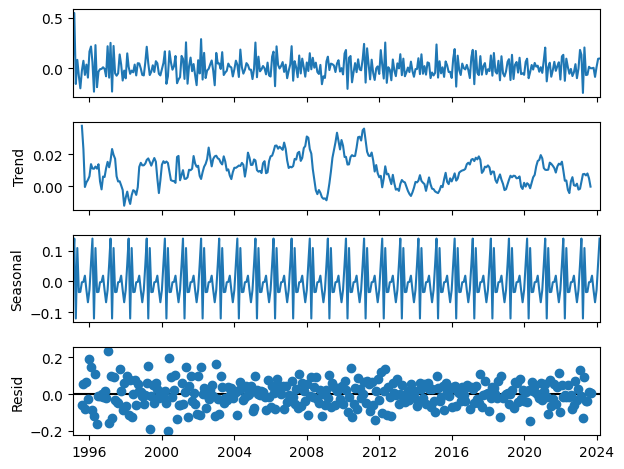


Plotting Residuals for Homoscedasticity Check...


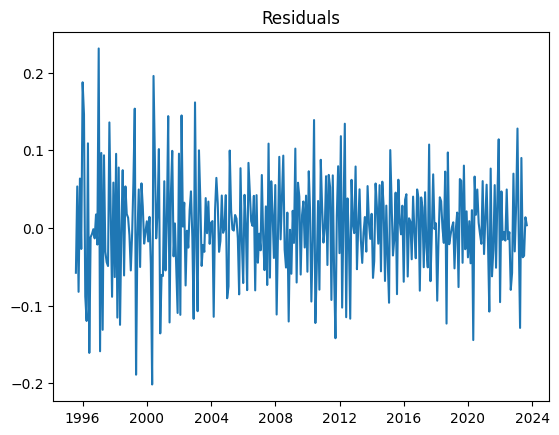

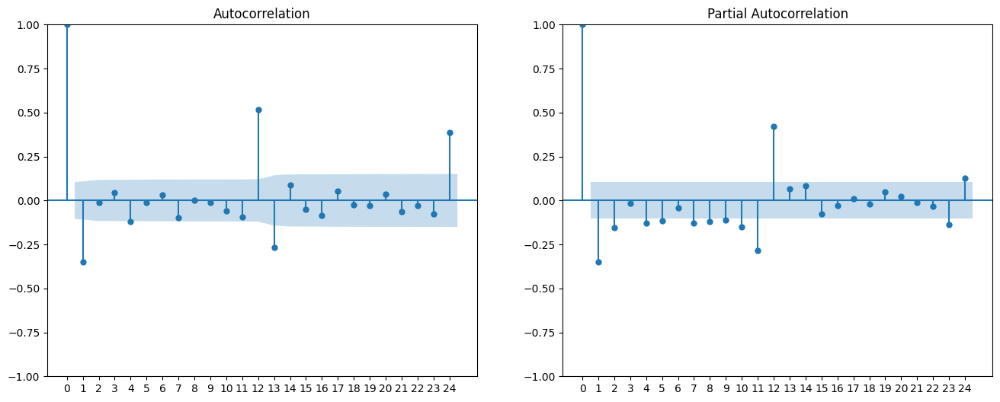


Time series assumptions are met.


True

'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -12.688965967388722
p-value: 1.1431670996247037e-23
Critical Value 1%: -3.449336554273722
Critical Value 5%: -2.8699055166063085
Critical Value 10%: -2.571226758215748
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.11825165935762255
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


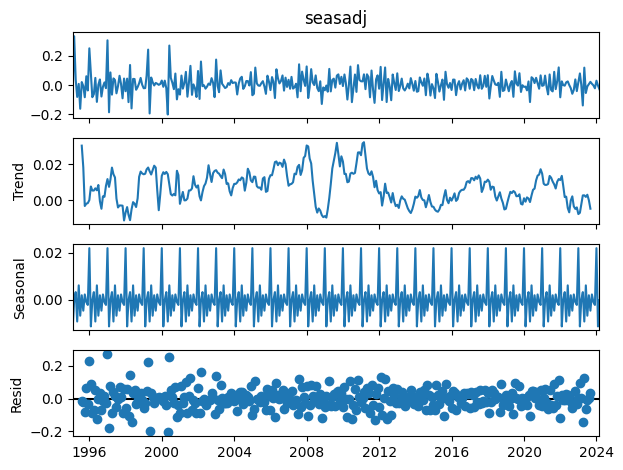


Plotting Residuals for Homoscedasticity Check...


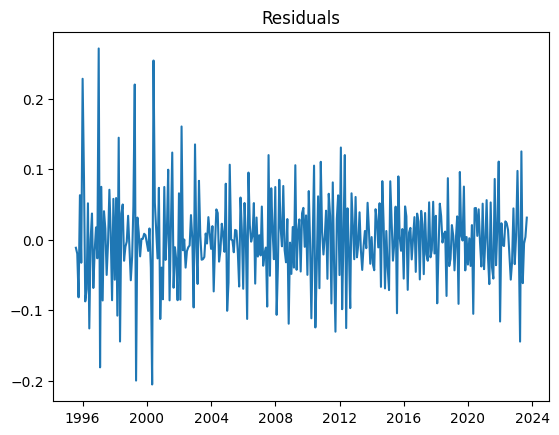

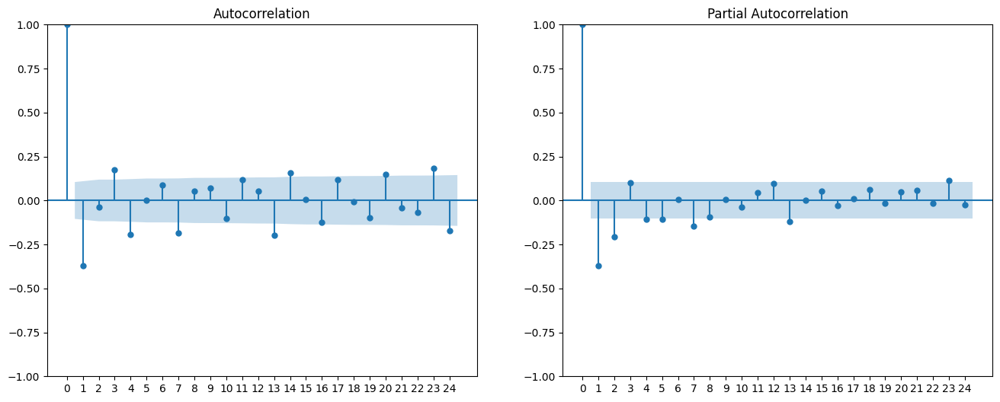


Time series assumptions are met.


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Data of Actual vs Forecasted values with error metrics:'

Agro-manufacturing_Products,actual,forecast,error,abs_error,squared_error,abs_percentage_error
2010-02-01,0.072132,-0.010379,0.082512,0.082512,0.006808,1.143894
2010-03-01,0.014976,-0.035356,0.050333,0.050333,0.002533,3.360828
2010-04-01,-0.098247,-0.024209,-0.074038,0.074038,0.005482,0.753587
2010-05-01,0.000654,0.025574,-0.024920,0.024920,0.000621,38.101206
2010-06-01,0.125882,0.014769,0.111113,0.111113,0.012346,0.882676
...,...,...,...,...,...,...
2023-12-01,-0.021761,-0.018262,-0.003499,0.003499,0.000012,0.160792
2024-01-01,0.029965,0.019750,0.010215,0.010215,0.000104,0.340907
2024-02-01,-0.003369,0.021053,-0.024422,0.024422,0.000596,7.248025
2024-03-01,-0.028102,0.002008,-0.030110,0.030110,0.000907,1.071453


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Total Mean Absolute Error (Per Forecast): 0.039269316077435154'

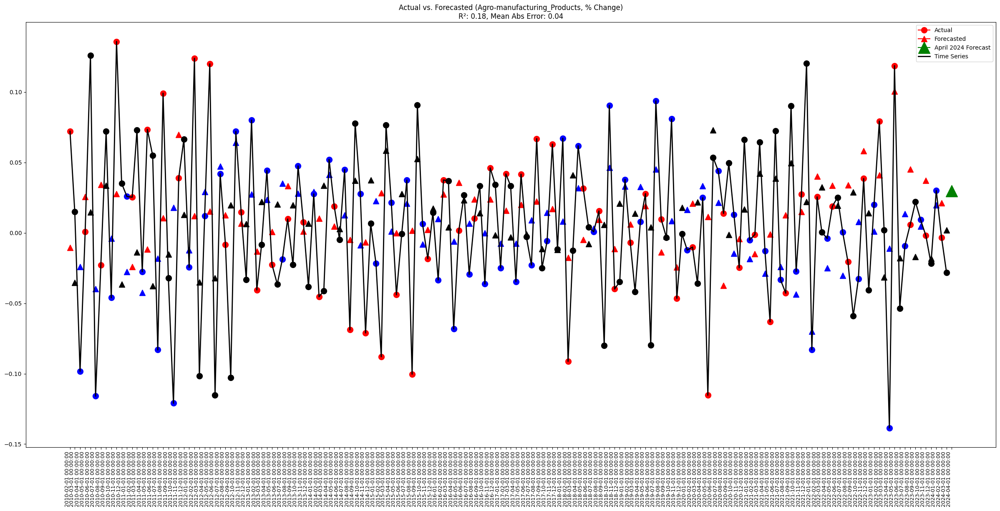

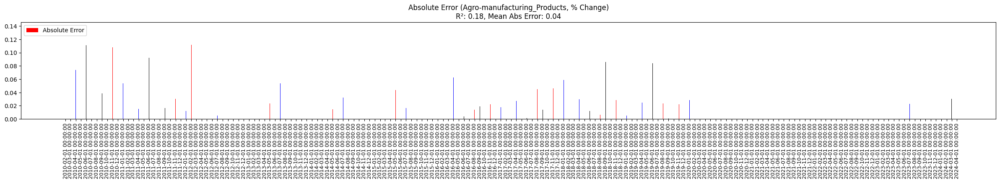

In [50]:
df = df_export_ANALYSIS[[name]]

df.plot(title=f"Export Value ({name})", label=f"{name}")
df.pct_change().plot(title=f"Export Value % Change ({name})", label=f"{name} % Change")
ts = df.pct_change().dropna()
display("Timeseries of component in % form:")
display(ts)
display("-" * 150)

### check if the data timeseries & statistical assumptions validity (stationary, seasonality, autocorrelation)
#freq 12 is used since the data is monthly, so the seasonality is 12 months YoY
display("Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):")
display(check_time_series_assumptions(ts, freq=12))
display("-" * 150)

#read the pickle file
with open(f'data/cleaned/deseasonalised_x13/update/dict_deseasonalized_value_{name}.pickle', 'rb') as handle:
    dict_deseasonalized_value = pickle.load(handle)[name]
adj_ts = dict_deseasonalized_value['seasadj'].pct_change().dropna()
display("Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):")
check_time_series_assumptions(adj_ts, freq=12)
display("-" * 150)

df_accuracy = pd.read_pickle(f"data/cleaned/SARIMA_RollWalkForward/combined/updated/accuracy/df_accuracy_{name}.pickle")
df_accuracy.columns.name = name
#Forecast are all Out-Of-Sample on a rolling basis
display("Data of Actual vs Forecasted values with error metrics:")
display(df_accuracy)
display("-" * 150)

#Plot Actual vs Forecasted values with error metrics
average_abs_error = df_accuracy["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_accuracy, name)


## Apparels_and_Textile_Materials

In [51]:
df = df_export_ANALYSIS.copy()
name = df.columns[18]
display(f"Component: {name}")

'Component: Apparels_and_Textile_Materials'

'Timeseries of component in % form:'

class,Apparels_and_Textile_Materials
1995-02-01,-0.056700
1995-03-01,0.255345
1995-04-01,-0.278537
1995-05-01,0.129097
1995-06-01,0.184119
...,...
2023-11-01,-0.018454
2023-12-01,-0.030931
2024-01-01,-0.000262
2024-02-01,0.049899


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -5.186389785489652
p-value: 9.372376904097357e-06
Critical Value 1%: -3.4502011472639724
Critical Value 5%: -2.8702852297358983
Critical Value 10%: -2.5714292194077513
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.06690658656002833
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


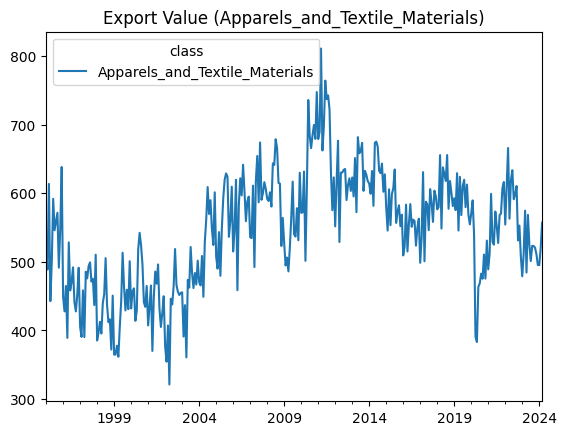

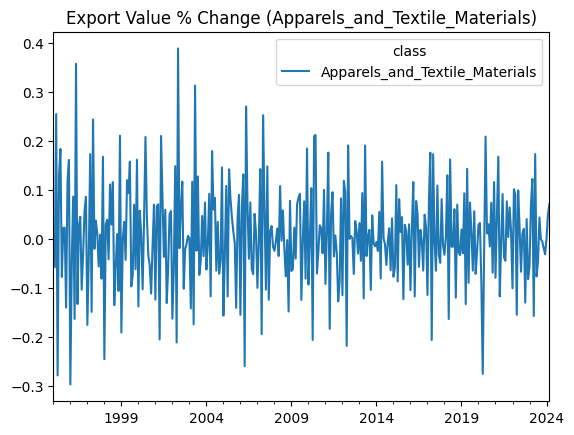

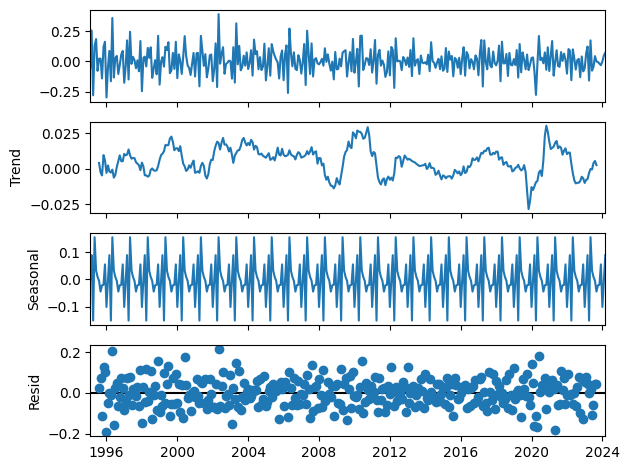


Plotting Residuals for Homoscedasticity Check...


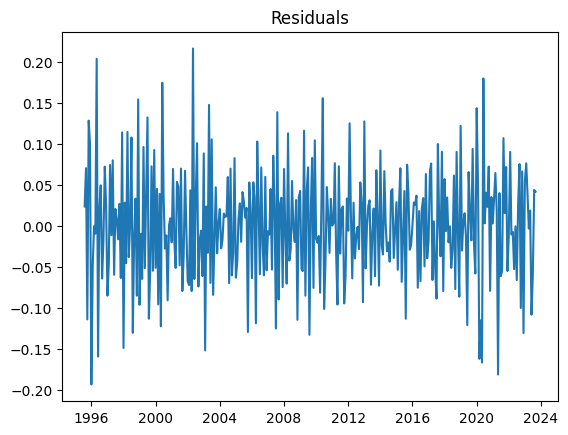

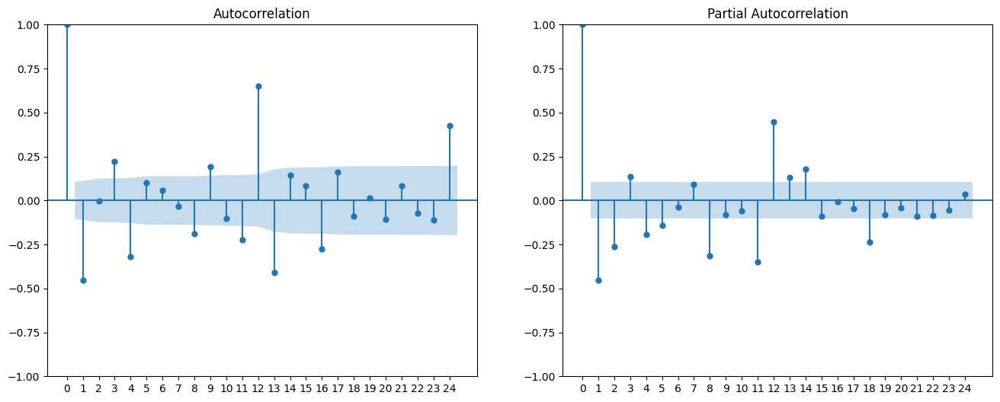


Time series assumptions are met.


True

'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -6.230344885375834
p-value: 4.971084457502175e-08
Critical Value 1%: -3.4499043309021955
Critical Value 5%: -2.870154885338925
Critical Value 10%: -2.5713597190254385
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.06702418059346323
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


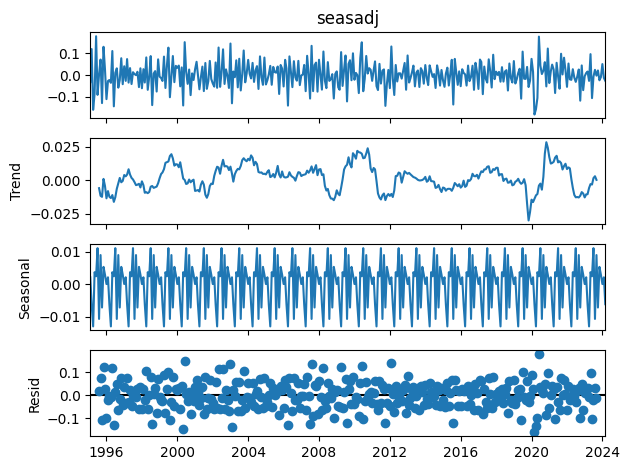


Plotting Residuals for Homoscedasticity Check...


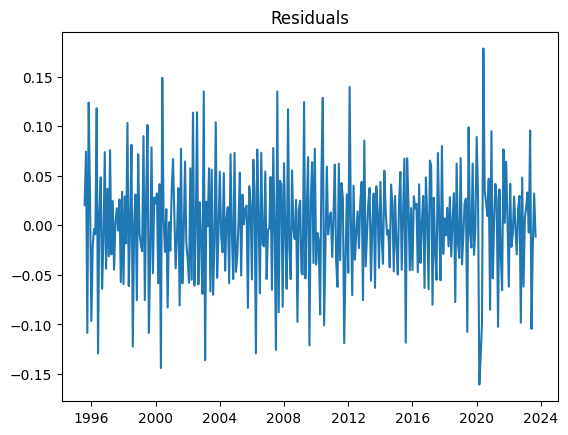

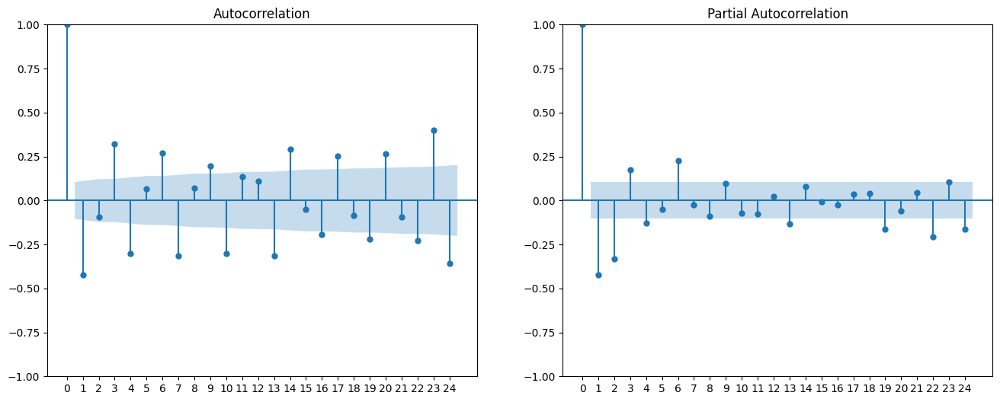


Time series assumptions are met.


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Data of Actual vs Forecasted values with error metrics:'

Apparels_and_Textile_Materials,actual,forecast,error,abs_error,squared_error,abs_percentage_error
2010-02-01,0.010372,-0.011327,0.021699,0.021699,0.000471,2.091998
2010-03-01,0.000502,0.012041,-0.011539,0.011539,0.000133,22.995164
2010-04-01,-0.082054,0.011758,-0.093812,0.093812,0.008801,1.143298
2010-05-01,0.078445,0.024199,0.054245,0.054245,0.002943,0.691513
2010-06-01,0.150796,-0.008146,0.158942,0.158942,0.025263,1.054019
...,...,...,...,...,...,...
2023-12-01,-0.008984,-0.032110,0.023127,0.023127,0.000535,2.574341
2024-01-01,0.050969,0.020371,0.030599,0.030599,0.000936,0.600334
2024-02-01,-0.012636,0.001668,-0.014304,0.014304,0.000205,1.131970
2024-03-01,-0.025613,-0.032469,0.006856,0.006856,0.000047,0.267696


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Total Mean Absolute Error (Per Forecast): 0.033350221141012645'

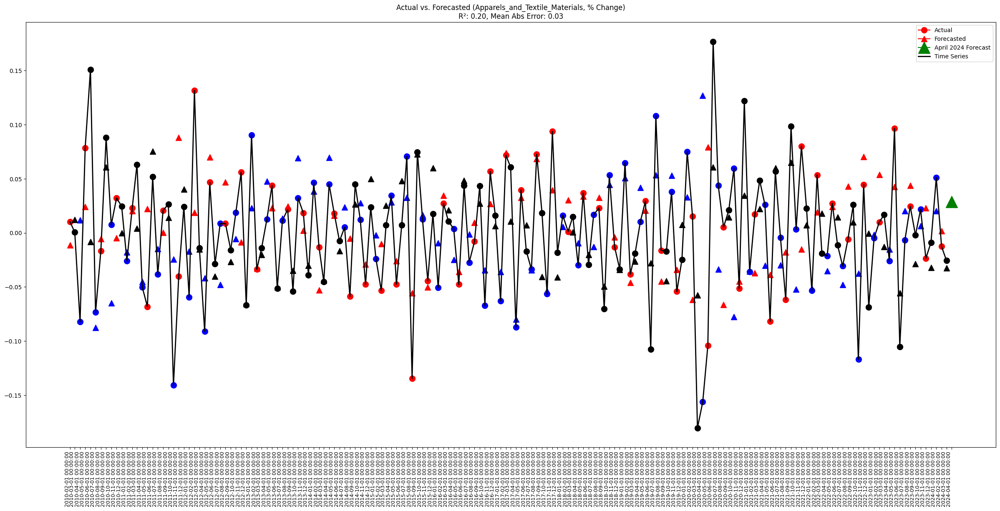

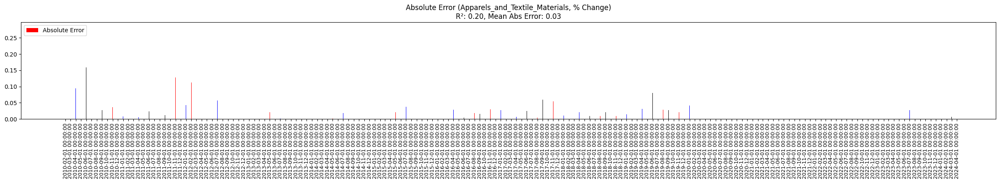

In [52]:
df = df_export_ANALYSIS[[name]]

df.plot(title=f"Export Value ({name})", label=f"{name}")
df.pct_change().plot(title=f"Export Value % Change ({name})", label=f"{name} % Change")
ts = df.pct_change().dropna()
display("Timeseries of component in % form:")
display(ts)
display("-" * 150)

### check if the data timeseries & statistical assumptions validity (stationary, seasonality, autocorrelation)
#freq 12 is used since the data is monthly, so the seasonality is 12 months YoY
display("Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):")
display(check_time_series_assumptions(ts, freq=12))
display("-" * 150)

#read the pickle file
with open(f'data/cleaned/deseasonalised_x13/update/dict_deseasonalized_value_{name}.pickle', 'rb') as handle:
    dict_deseasonalized_value = pickle.load(handle)[name]
adj_ts = dict_deseasonalized_value['seasadj'].pct_change().dropna()
display("Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):")
check_time_series_assumptions(adj_ts, freq=12)
display("-" * 150)

df_accuracy = pd.read_pickle(f"data/cleaned/SARIMA_RollWalkForward/combined/updated/accuracy/df_accuracy_{name}.pickle")
df_accuracy.columns.name = name
#Forecast are all Out-Of-Sample on a rolling basis
display("Data of Actual vs Forecasted values with error metrics:")
display(df_accuracy)
display("-" * 150)

#Plot Actual vs Forecasted values with error metrics
average_abs_error = df_accuracy["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_accuracy, name)


## Footware_and_parts

In [53]:
df = df_export_ANALYSIS.copy()
name = df.columns[19]
display(f"Component: {name}")

'Component: Footware_and_parts'

'Timeseries of component in % form:'

class,Footware_and_parts
1995-02-01,-0.000056
1995-03-01,0.002623
1995-04-01,-0.245686
1995-05-01,0.461924
1995-06-01,0.113668
...,...
2023-11-01,0.118204
2023-12-01,-0.182368
2024-01-01,0.054774
2024-02-01,-0.024561


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -6.764106715119824
p-value: 2.744858927803993e-09
Critical Value 1%: -3.449846029628477
Critical Value 5%: -2.870129281376164
Critical Value 10%: -2.5713460670144603
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.18203851145458144
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


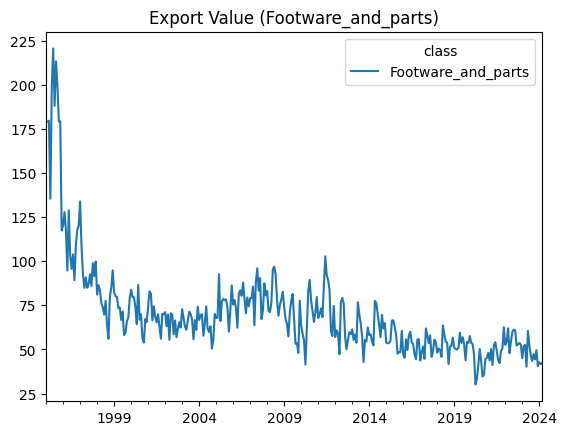

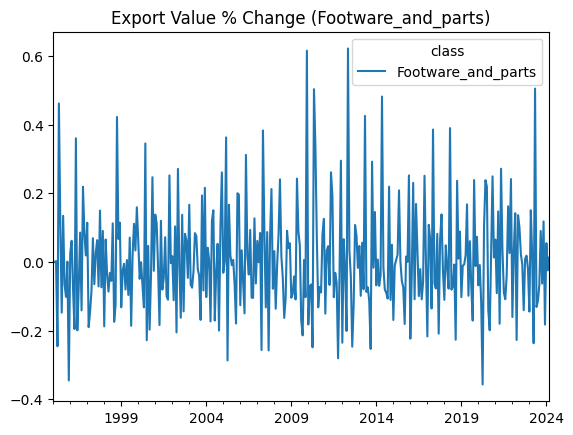

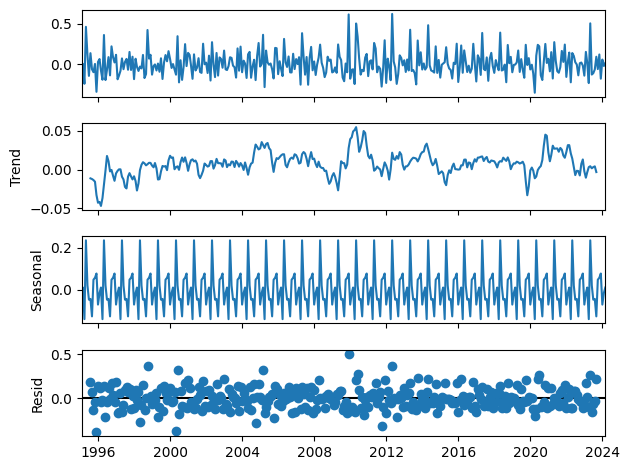


Plotting Residuals for Homoscedasticity Check...


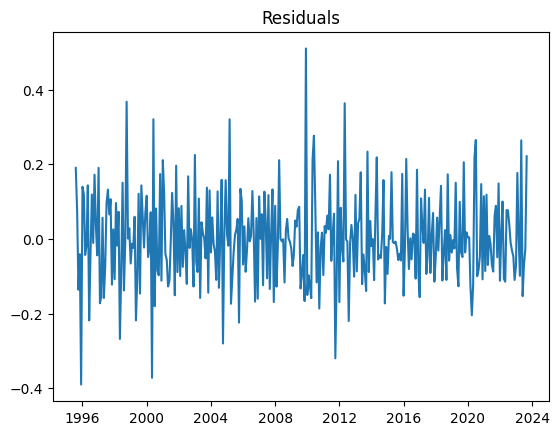

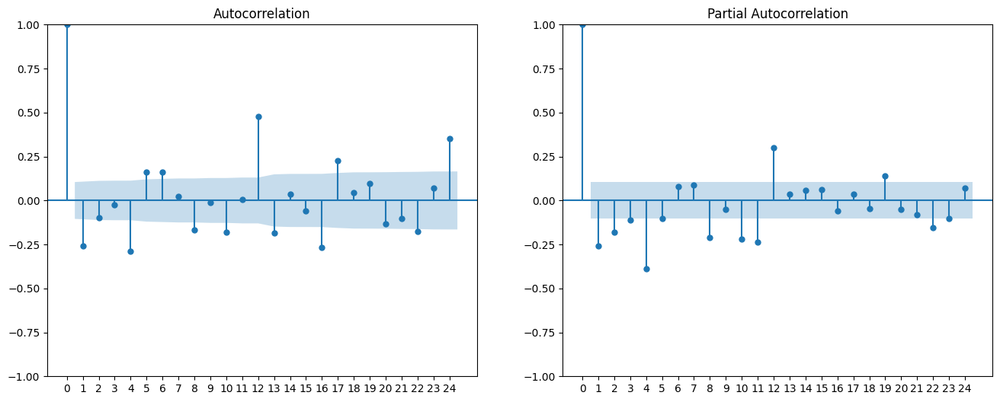


Time series assumptions are met.


True

'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -5.450313610670317
p-value: 2.653430284197973e-06
Critical Value 1%: -3.450081345901191
Critical Value 5%: -2.870232621465807
Critical Value 10%: -2.571401168202517
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.06377310439331033
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


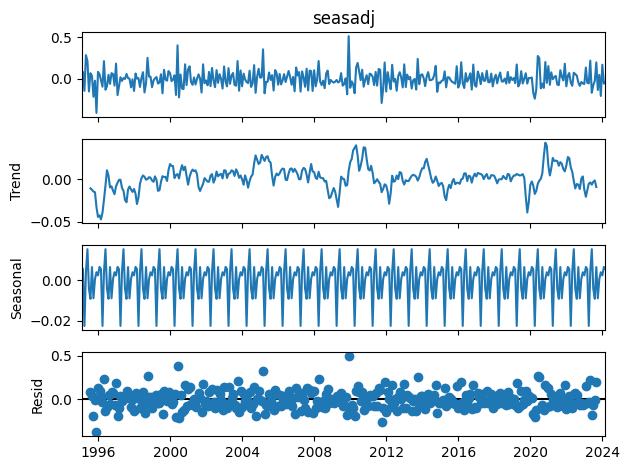


Plotting Residuals for Homoscedasticity Check...


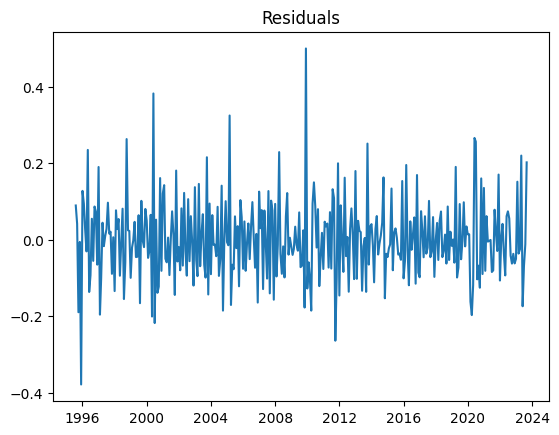

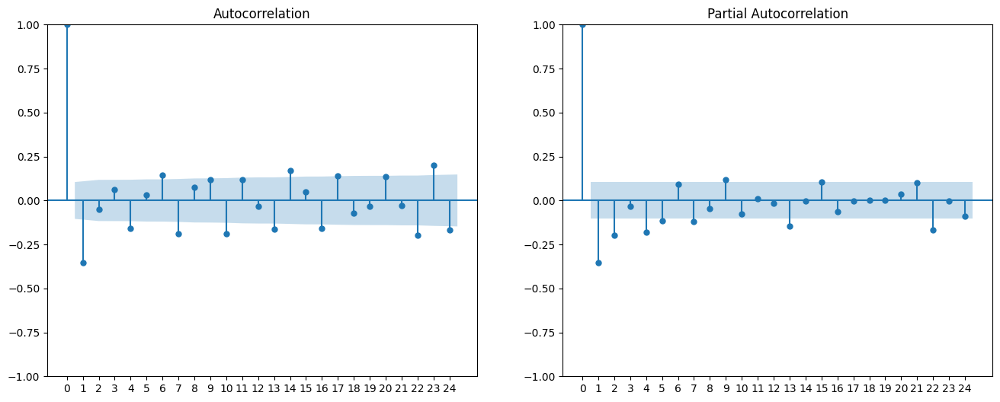


Time series assumptions are met.


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Data of Actual vs Forecasted values with error metrics:'

Footware_and_parts,actual,forecast,error,abs_error,squared_error,abs_percentage_error
2010-02-01,-0.029065,-0.069726,0.040660,0.040660,0.001653,1.398923
2010-03-01,-0.061487,0.058625,-0.120112,0.120112,0.014427,1.953449
2010-04-01,-0.171117,0.016186,-0.187303,0.187303,0.035083,1.094589
2010-05-01,0.137529,0.067008,0.070521,0.070521,0.004973,0.512774
2010-06-01,0.192532,-0.006885,0.199417,0.199417,0.039767,1.035760
...,...,...,...,...,...,...
2023-12-01,-0.203922,-0.031905,-0.172018,0.172018,0.029590,0.843545
2024-01-01,0.170459,0.054649,0.115810,0.115810,0.013412,0.679402
2024-02-01,-0.056073,-0.040847,-0.015227,0.015227,0.000232,0.271548
2024-03-01,-0.036202,-0.026262,-0.009940,0.009940,0.000099,0.274559


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Total Mean Absolute Error (Per Forecast): 0.064386609035526'

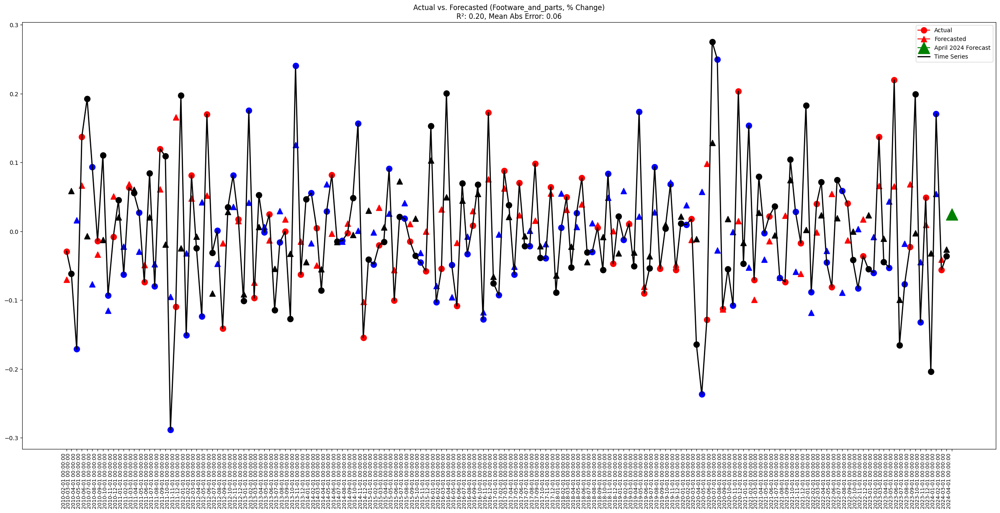

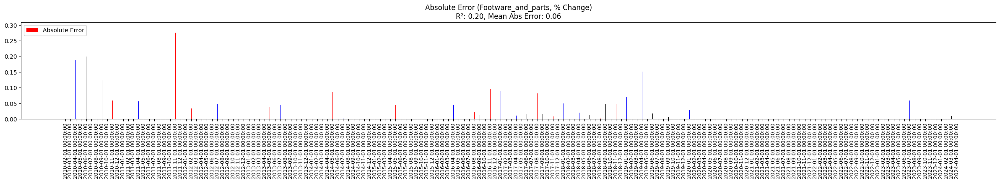

In [54]:
df = df_export_ANALYSIS[[name]]

df.plot(title=f"Export Value ({name})", label=f"{name}")
df.pct_change().plot(title=f"Export Value % Change ({name})", label=f"{name} % Change")
ts = df.pct_change().dropna()
display("Timeseries of component in % form:")
display(ts)
display("-" * 150)

### check if the data timeseries & statistical assumptions validity (stationary, seasonality, autocorrelation)
#freq 12 is used since the data is monthly, so the seasonality is 12 months YoY
display("Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):")
display(check_time_series_assumptions(ts, freq=12))
display("-" * 150)

#read the pickle file
with open(f'data/cleaned/deseasonalised_x13/update/dict_deseasonalized_value_{name}.pickle', 'rb') as handle:
    dict_deseasonalized_value = pickle.load(handle)[name]
adj_ts = dict_deseasonalized_value['seasadj'].pct_change().dropna()
display("Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):")
check_time_series_assumptions(adj_ts, freq=12)
display("-" * 150)

df_accuracy = pd.read_pickle(f"data/cleaned/SARIMA_RollWalkForward/combined/updated/accuracy/df_accuracy_{name}.pickle")
df_accuracy.columns.name = name
#Forecast are all Out-Of-Sample on a rolling basis
display("Data of Actual vs Forecasted values with error metrics:")
display(df_accuracy)
display("-" * 150)

#Plot Actual vs Forecasted values with error metrics
average_abs_error = df_accuracy["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_accuracy, name)


## Electronics

In [55]:
df = df_export_ANALYSIS.copy()
name = df.columns[20]
display(f"Component: {name}")

'Component: Electronics'

'Timeseries of component in % form:'

class,Electronics
1995-02-01,0.035321
1995-03-01,0.271773
1995-04-01,-0.144608
1995-05-01,0.128309
1995-06-01,0.038584
...,...
2023-11-01,0.104044
2023-12-01,0.083406
2024-01-01,-0.138897
2024-02-01,-0.053334


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -5.65763365900667
p-value: 9.53981132439007e-07
Critical Value 1%: -3.449846029628477
Critical Value 5%: -2.870129281376164
Critical Value 10%: -2.5713460670144603
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.09276156749813826
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


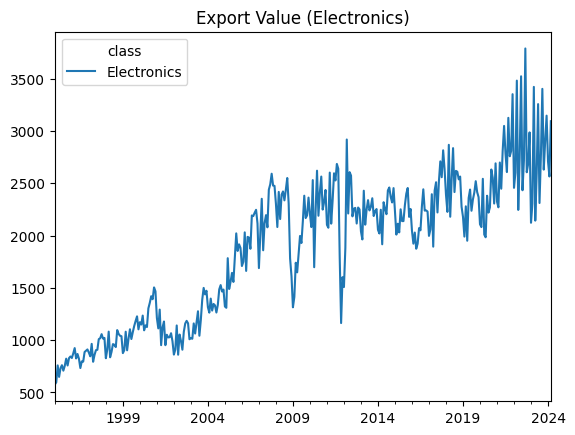

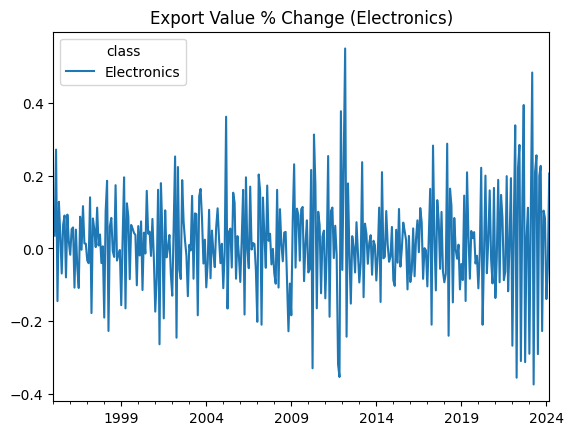

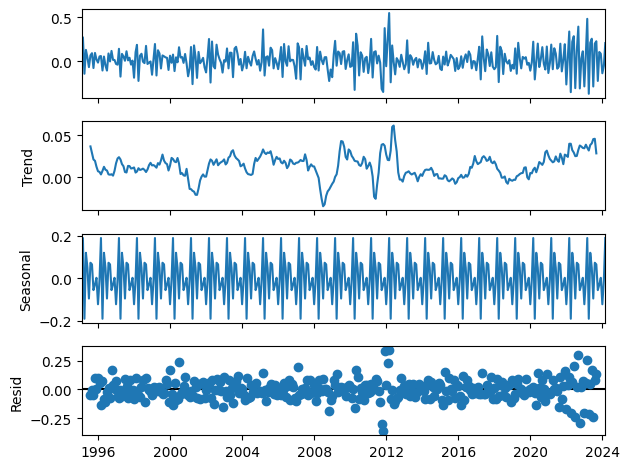


Plotting Residuals for Homoscedasticity Check...


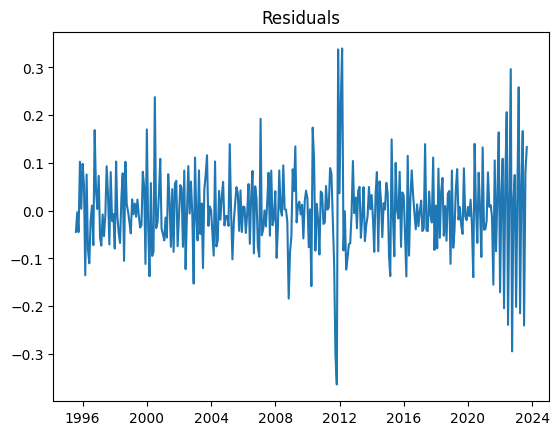

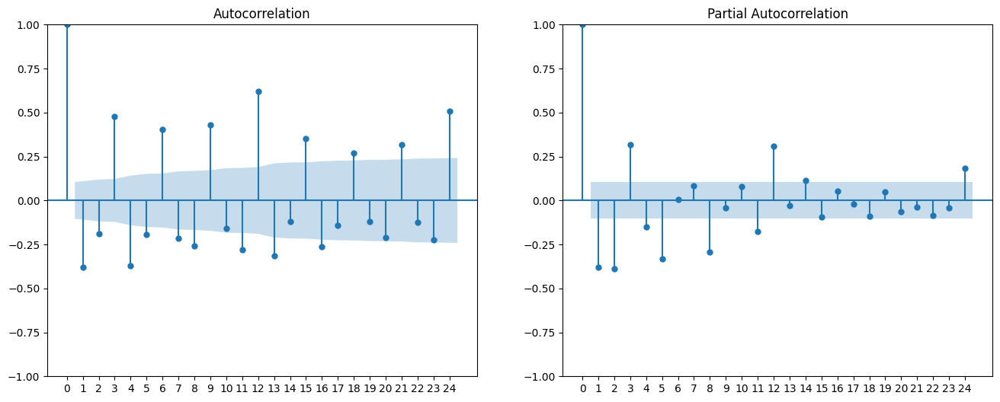


Time series assumptions are met.


True

'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -12.070857112772934
p-value: 2.349674281856762e-22
Critical Value 1%: -3.4494474563375737
Critical Value 5%: -2.8699542285903887
Critical Value 10%: -2.5712527305187987
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.07356333060860401
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


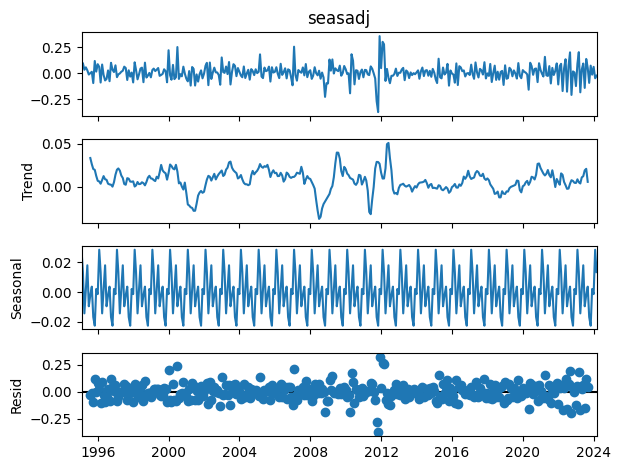


Plotting Residuals for Homoscedasticity Check...


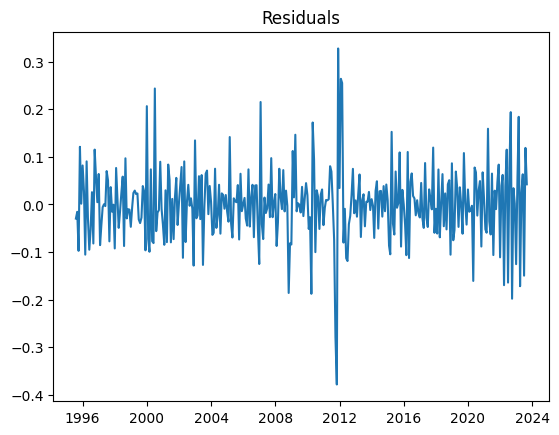

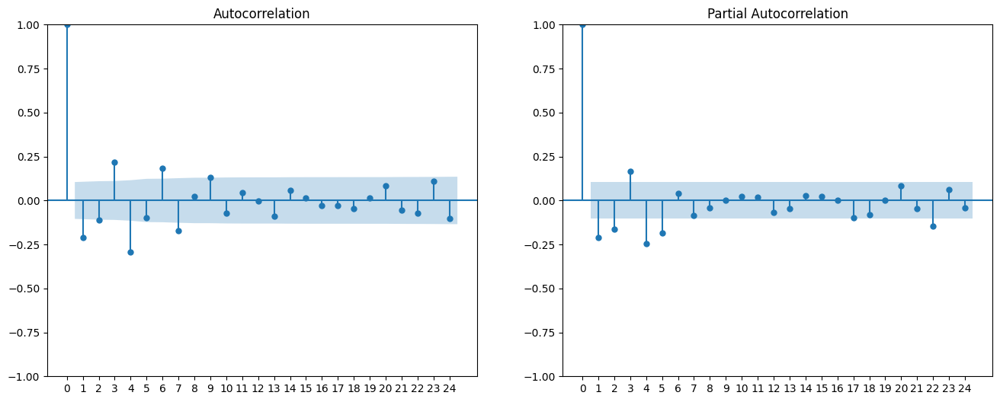


Time series assumptions are met.


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Data of Actual vs Forecasted values with error metrics:'

Electronics,actual,forecast,error,abs_error,squared_error,abs_percentage_error
2010-02-01,-0.008094,-0.022563,0.014469,0.014469,0.000209,1.787653
2010-03-01,-0.000143,0.007742,-0.007886,0.007886,0.000062,55.019527
2010-04-01,-0.192072,-0.014231,-0.177841,0.177841,0.031628,0.925908
2010-05-01,0.182274,0.051326,0.130947,0.130947,0.017147,0.718410
2010-06-01,0.120232,-0.029201,0.149432,0.149432,0.022330,1.242869
...,...,...,...,...,...,...
2023-12-01,-0.013514,0.010029,-0.023544,0.023544,0.000554,1.742105
2024-01-01,0.061625,-0.052334,0.113959,0.113959,0.012987,1.849246
2024-02-01,-0.047850,0.028690,-0.076540,0.076540,0.005858,1.599587
2024-03-01,-0.022643,0.008871,-0.031514,0.031514,0.000993,1.391758


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Total Mean Absolute Error (Per Forecast): 0.057927059759398'

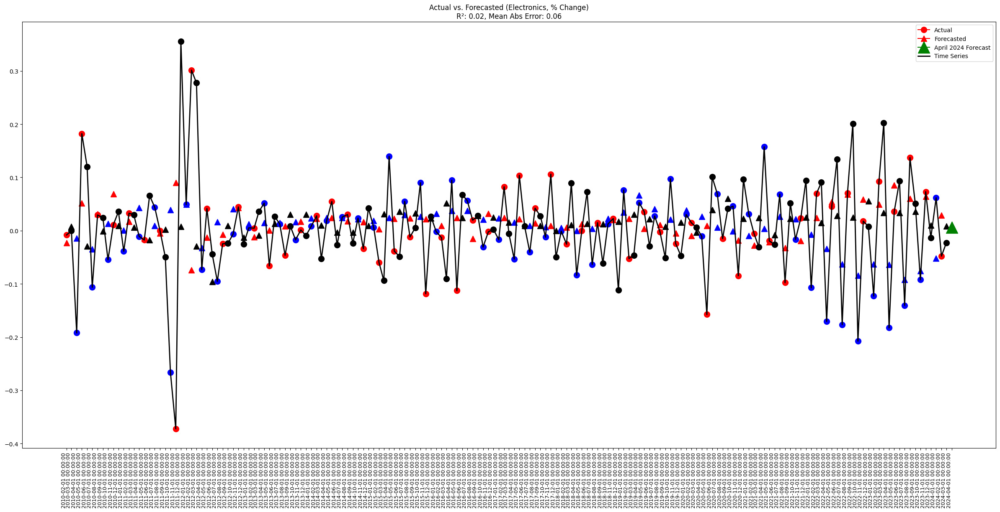

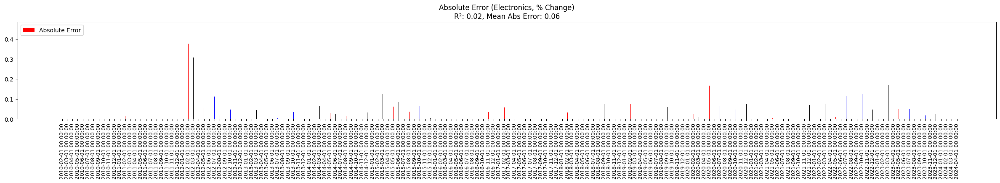

In [56]:
df = df_export_ANALYSIS[[name]]

df.plot(title=f"Export Value ({name})", label=f"{name}")
df.pct_change().plot(title=f"Export Value % Change ({name})", label=f"{name} % Change")
ts = df.pct_change().dropna()
display("Timeseries of component in % form:")
display(ts)
display("-" * 150)

### check if the data timeseries & statistical assumptions validity (stationary, seasonality, autocorrelation)
#freq 12 is used since the data is monthly, so the seasonality is 12 months YoY
display("Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):")
display(check_time_series_assumptions(ts, freq=12))
display("-" * 150)

#read the pickle file
with open(f'data/cleaned/deseasonalised_x13/update/dict_deseasonalized_value_{name}.pickle', 'rb') as handle:
    dict_deseasonalized_value = pickle.load(handle)[name]
adj_ts = dict_deseasonalized_value['seasadj'].pct_change().dropna()
display("Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):")
check_time_series_assumptions(adj_ts, freq=12)
display("-" * 150)

df_accuracy = pd.read_pickle(f"data/cleaned/SARIMA_RollWalkForward/combined/updated/accuracy/df_accuracy_{name}.pickle")
df_accuracy.columns.name = name
#Forecast are all Out-Of-Sample on a rolling basis
display("Data of Actual vs Forecasted values with error metrics:")
display(df_accuracy)
display("-" * 150)

#Plot Actual vs Forecasted values with error metrics
average_abs_error = df_accuracy["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_accuracy, name)


## Electrical_Appliances

In [57]:
df = df_export_ANALYSIS.copy()
name = df.columns[21]
display(f"Component: {name}")

'Component: Electrical_Appliances'

'Timeseries of component in % form:'

class,Electrical_Appliances
1995-02-01,0.126758
1995-03-01,0.267712
1995-04-01,-0.279240
1995-05-01,0.357869
1995-06-01,0.039214
...,...
2023-11-01,0.054412
2023-12-01,-0.045130
2024-01-01,0.032271
2024-02-01,0.082944


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -5.377911805986953
p-value: 3.7684632216805727e-06
Critical Value 1%: -3.4502011472639724
Critical Value 5%: -2.8702852297358983
Critical Value 10%: -2.5714292194077513
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.058172037861919296
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


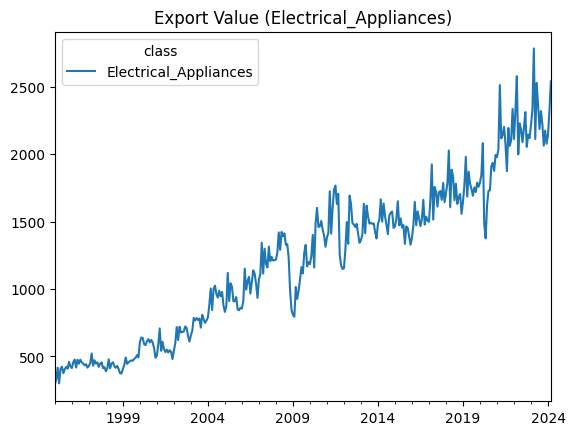

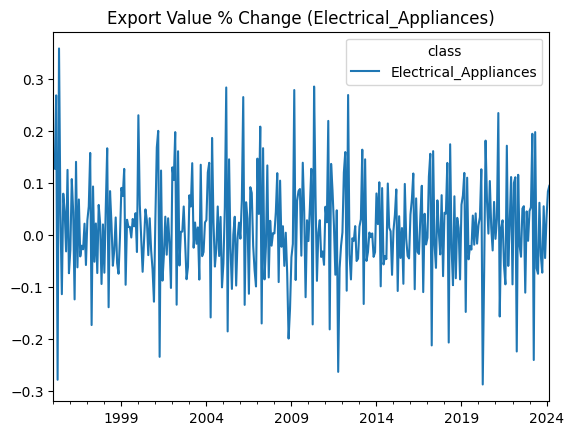

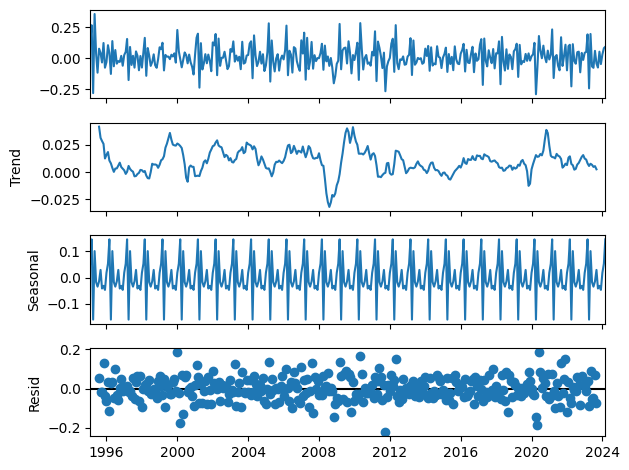


Plotting Residuals for Homoscedasticity Check...


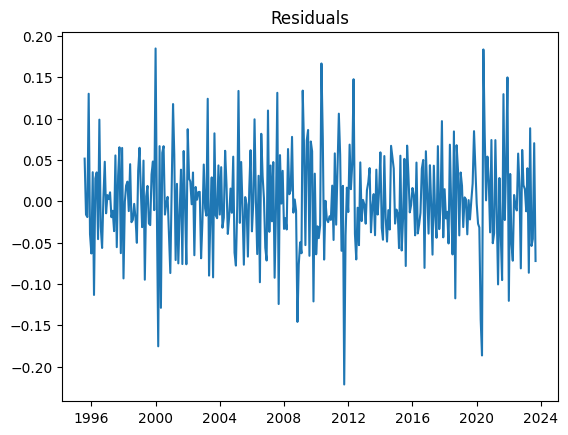

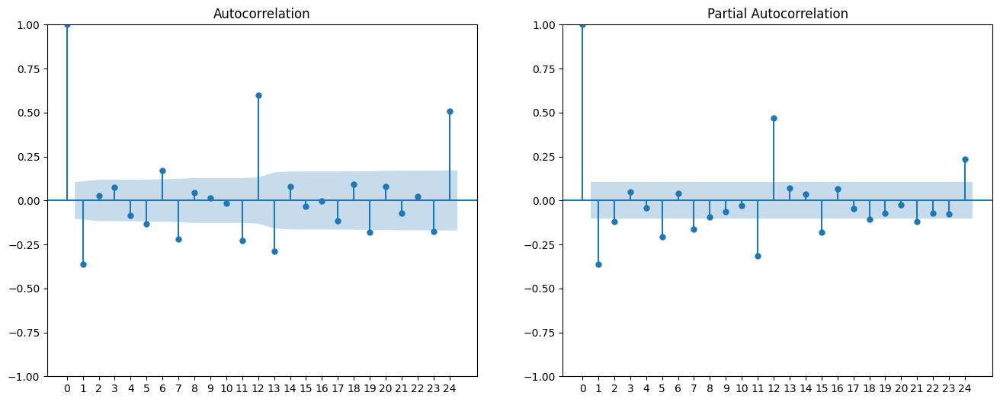


Time series assumptions are met.


True

'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -10.612124449733983
p-value: 5.797742598104735e-19
Critical Value 1%: -3.4493918438232525
Critical Value 5%: -2.8699298018856574
Critical Value 10%: -2.5712397066390458
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.14532158329969574
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


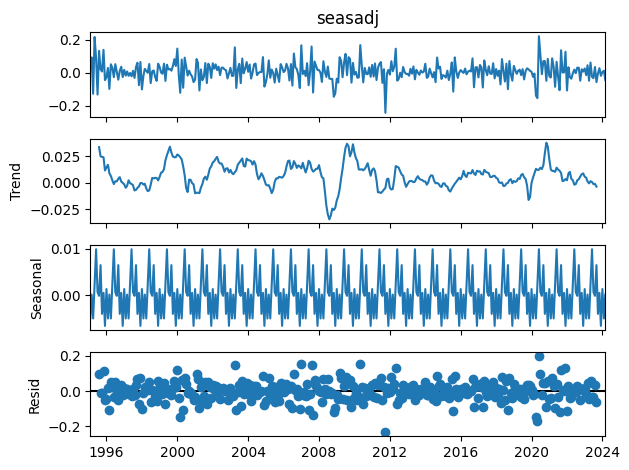


Plotting Residuals for Homoscedasticity Check...


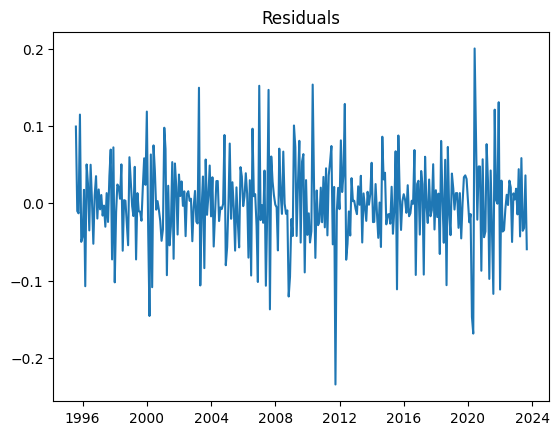

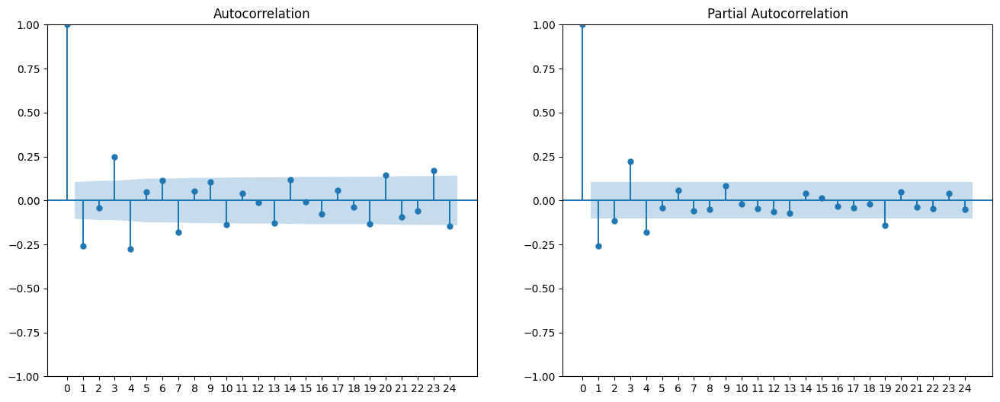


Time series assumptions are met.


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Data of Actual vs Forecasted values with error metrics:'

Electrical_Appliances,actual,forecast,error,abs_error,squared_error,abs_percentage_error
2010-02-01,0.005079,-0.003276,0.008356,0.008356,0.000070,1.645020
2010-03-01,-0.029884,0.024384,-0.054268,0.054268,0.002945,1.815974
2010-04-01,-0.028542,-0.003059,-0.025483,0.025483,0.000649,0.892827
2010-05-01,0.168139,-0.001598,0.169737,0.169737,0.028811,1.009506
2010-06-01,0.044586,-0.025942,0.070527,0.070527,0.004974,1.581841
...,...,...,...,...,...,...
2023-12-01,-0.018678,-0.017168,-0.001511,0.001511,0.000002,0.080888
2024-01-01,0.005029,0.008329,-0.003299,0.003299,0.000011,0.656042
2024-02-01,0.012431,0.027645,-0.015214,0.015214,0.000231,1.223814
2024-03-01,-0.044396,-0.015029,-0.029366,0.029366,0.000862,0.661468


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Total Mean Absolute Error (Per Forecast): 0.0374392010650417'

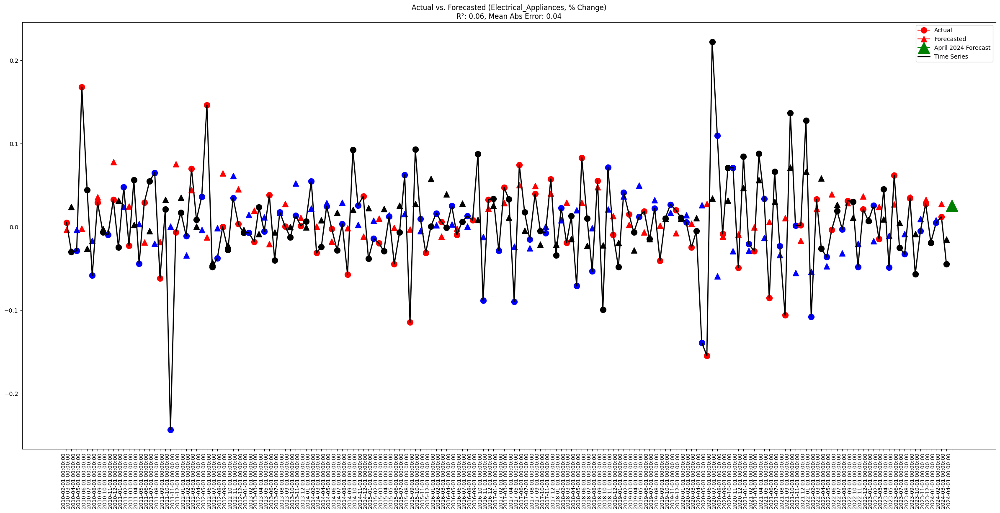

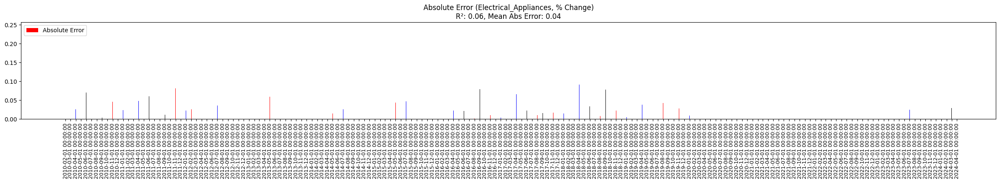

In [58]:
df = df_export_ANALYSIS[[name]]

df.plot(title=f"Export Value ({name})", label=f"{name}")
df.pct_change().plot(title=f"Export Value % Change ({name})", label=f"{name} % Change")
ts = df.pct_change().dropna()
display("Timeseries of component in % form:")
display(ts)
display("-" * 150)

### check if the data timeseries & statistical assumptions validity (stationary, seasonality, autocorrelation)
#freq 12 is used since the data is monthly, so the seasonality is 12 months YoY
display("Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):")
display(check_time_series_assumptions(ts, freq=12))
display("-" * 150)

#read the pickle file
with open(f'data/cleaned/deseasonalised_x13/update/dict_deseasonalized_value_{name}.pickle', 'rb') as handle:
    dict_deseasonalized_value = pickle.load(handle)[name]
adj_ts = dict_deseasonalized_value['seasadj'].pct_change().dropna()
display("Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):")
check_time_series_assumptions(adj_ts, freq=12)
display("-" * 150)

df_accuracy = pd.read_pickle(f"data/cleaned/SARIMA_RollWalkForward/combined/updated/accuracy/df_accuracy_{name}.pickle")
df_accuracy.columns.name = name
#Forecast are all Out-Of-Sample on a rolling basis
display("Data of Actual vs Forecasted values with error metrics:")
display(df_accuracy)
display("-" * 150)

#Plot Actual vs Forecasted values with error metrics
average_abs_error = df_accuracy["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_accuracy, name)


## Metal_&_Steel

In [59]:
df = df_export_ANALYSIS.copy()
name = df.columns[22]
display(f"Component: {name}")

'Component: Metal_&_Steel'

'Timeseries of component in % form:'

class,Metal_&_Steel
1995-02-01,0.064318
1995-03-01,0.459156
1995-04-01,-0.281651
1995-05-01,0.100241
1995-06-01,0.026508
...,...
2023-11-01,0.226618
2023-12-01,-0.070939
2024-01-01,0.328411
2024-02-01,-0.263440


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -5.841636652333678
p-value: 3.7654382132623553e-07
Critical Value 1%: -3.4500219858626227
Critical Value 5%: -2.870206553997666
Critical Value 10%: -2.571387268879483
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.14452553890593434
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


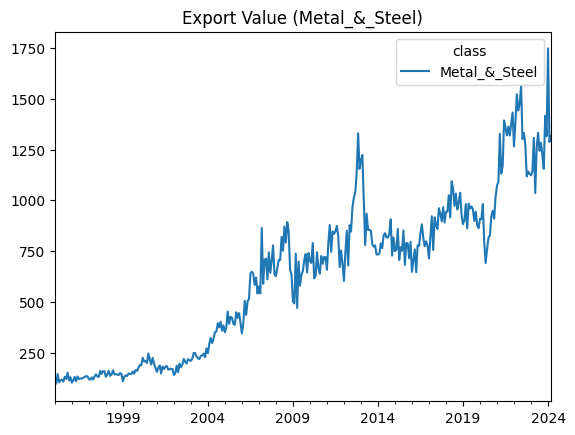

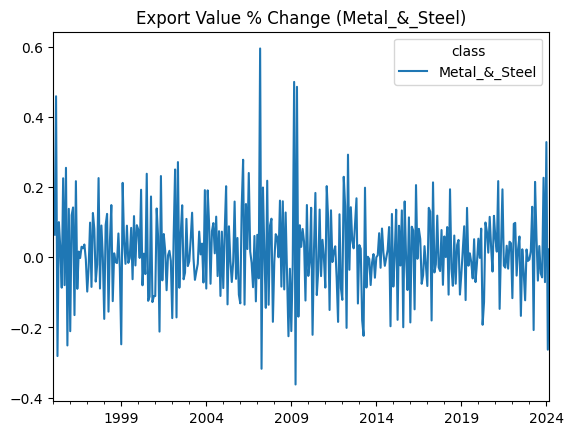

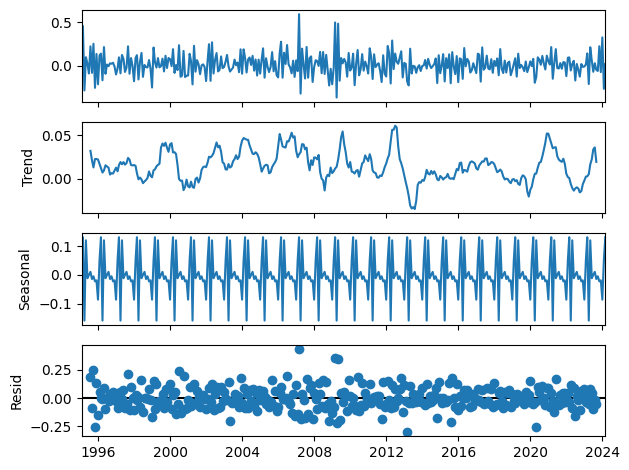


Plotting Residuals for Homoscedasticity Check...


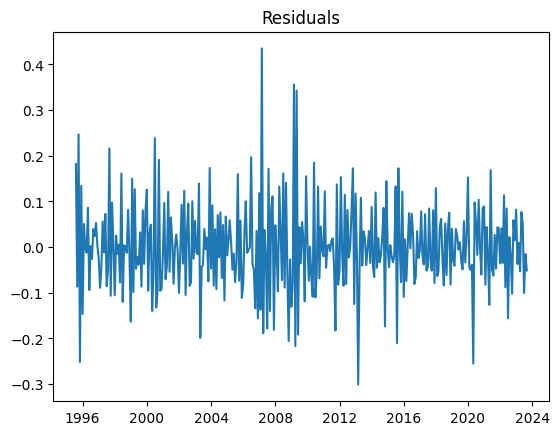

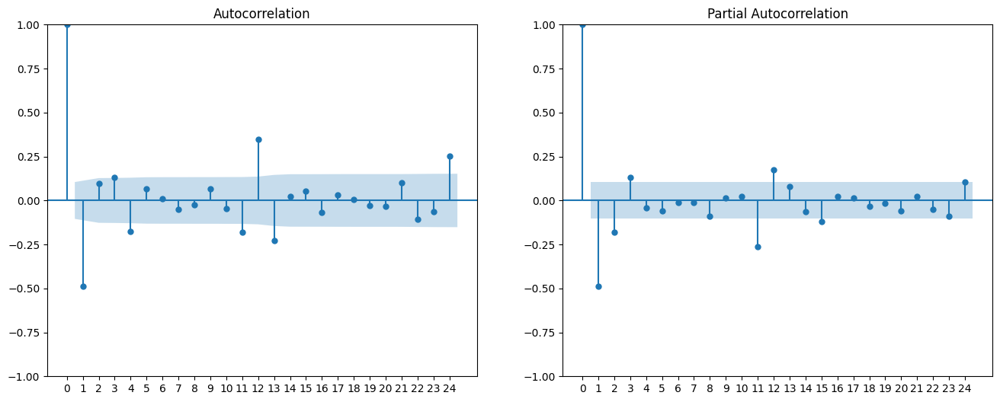


Time series assumptions are met.


True

'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -10.56675547842935
p-value: 7.482510308618111e-19
Critical Value 1%: -3.449336554273722
Critical Value 5%: -2.8699055166063085
Critical Value 10%: -2.571226758215748
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.1350165248570389
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


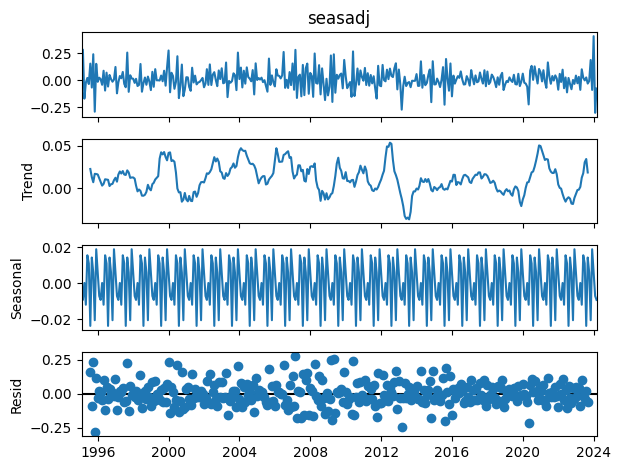


Plotting Residuals for Homoscedasticity Check...


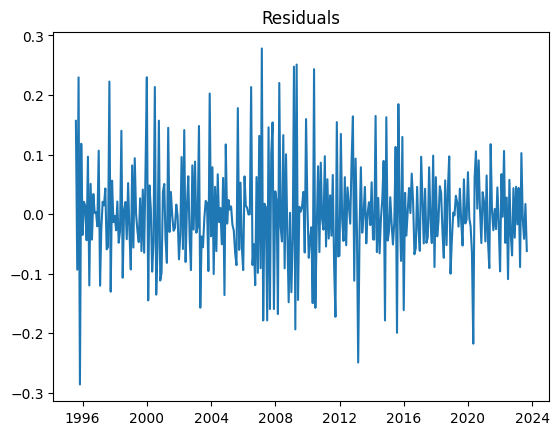

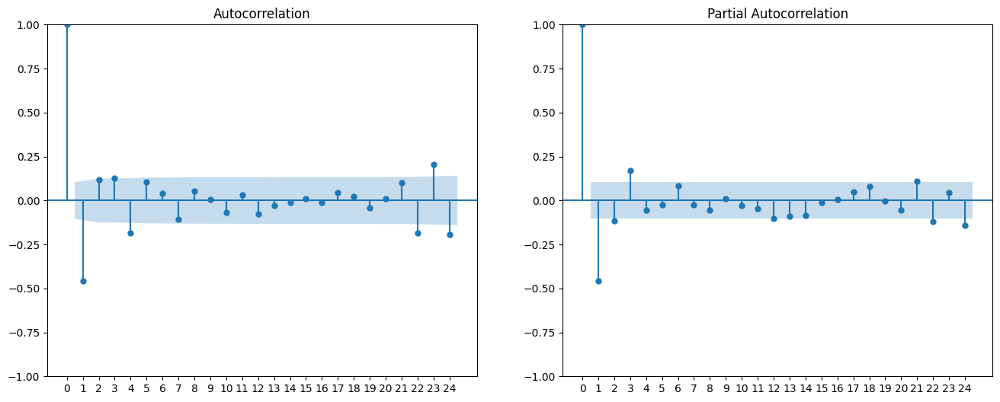


Time series assumptions are met.


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Data of Actual vs Forecasted values with error metrics:'

Metal_&_Steel,actual,forecast,error,abs_error,squared_error,abs_percentage_error
2010-02-01,-0.072190,0.027076,-0.099266,0.099266,0.009854,1.375064
2010-03-01,-0.042031,0.029407,-0.071438,0.071438,0.005103,1.699655
2010-04-01,-0.015213,0.083807,-0.099020,0.099020,0.009805,6.508963
2010-05-01,-0.152263,-0.004068,-0.148195,0.148195,0.021962,0.973284
2010-06-01,0.268607,0.126936,0.141671,0.141671,0.020071,0.527429
...,...,...,...,...,...,...
2023-12-01,-0.088298,-0.070426,-0.017871,0.017871,0.000319,0.202400
2024-01-01,0.409939,0.058856,0.351083,0.351083,0.123259,0.856427
2024-02-01,-0.300484,-0.130008,-0.170476,0.170476,0.029062,0.567337
2024-03-01,-0.075214,0.129002,-0.204215,0.204215,0.041704,2.715136


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Total Mean Absolute Error (Per Forecast): 0.05676617047097028'

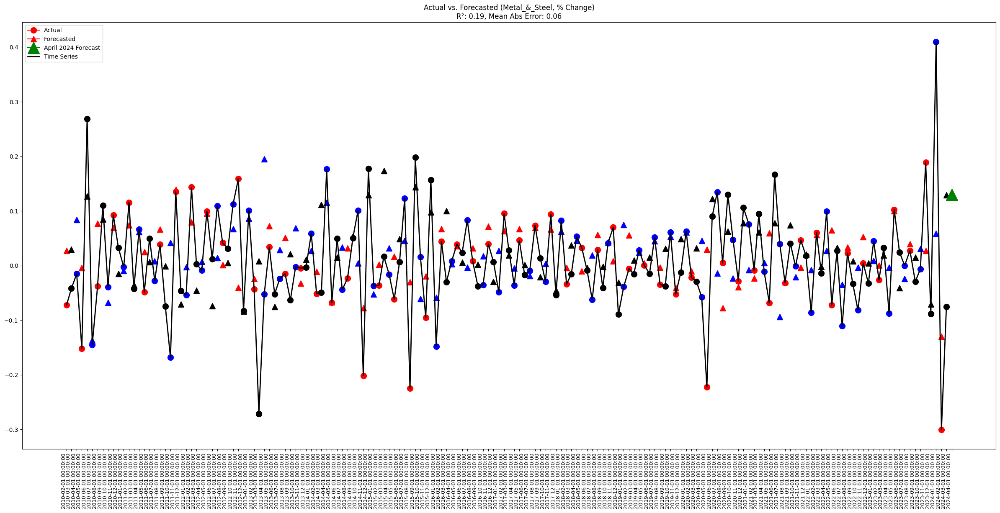

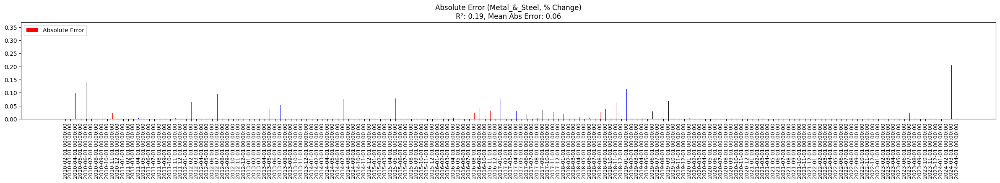

In [60]:
df = df_export_ANALYSIS[[name]]

df.plot(title=f"Export Value ({name})", label=f"{name}")
df.pct_change().plot(title=f"Export Value % Change ({name})", label=f"{name} % Change")
ts = df.pct_change().dropna()
display("Timeseries of component in % form:")
display(ts)
display("-" * 150)

### check if the data timeseries & statistical assumptions validity (stationary, seasonality, autocorrelation)
#freq 12 is used since the data is monthly, so the seasonality is 12 months YoY
display("Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):")
display(check_time_series_assumptions(ts, freq=12))
display("-" * 150)

#read the pickle file
with open(f'data/cleaned/deseasonalised_x13/update/dict_deseasonalized_value_{name}.pickle', 'rb') as handle:
    dict_deseasonalized_value = pickle.load(handle)[name]
adj_ts = dict_deseasonalized_value['seasadj'].pct_change().dropna()
display("Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):")
check_time_series_assumptions(adj_ts, freq=12)
display("-" * 150)

df_accuracy = pd.read_pickle(f"data/cleaned/SARIMA_RollWalkForward/combined/updated/accuracy/df_accuracy_{name}.pickle")
df_accuracy.columns.name = name
#Forecast are all Out-Of-Sample on a rolling basis
display("Data of Actual vs Forecasted values with error metrics:")
display(df_accuracy)
display("-" * 150)

#Plot Actual vs Forecasted values with error metrics
average_abs_error = df_accuracy["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_accuracy, name)


## Automotive

In [61]:
df = df_export_ANALYSIS.copy()
name = df.columns[23]
display(f"Component: {name}")

'Component: Automotive'

'Timeseries of component in % form:'

class,Automotive
1995-02-01,0.256000
1995-03-01,0.358086
1995-04-01,-0.165180
1995-05-01,0.248835
1995-06-01,0.062322
...,...
2023-11-01,-0.032219
2023-12-01,0.017765
2024-01-01,-0.046556
2024-02-01,0.008811


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -6.059763471691257
p-value: 1.220547439364615e-07
Critical Value 1%: -3.449962981927952
Critical Value 5%: -2.870180642420163
Critical Value 10%: -2.5713734527352607
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.2146181502400707
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


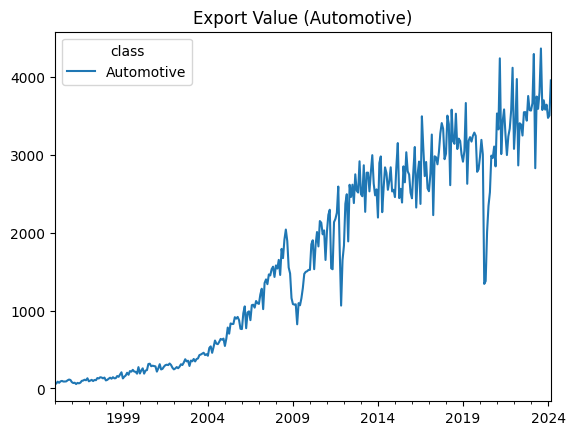

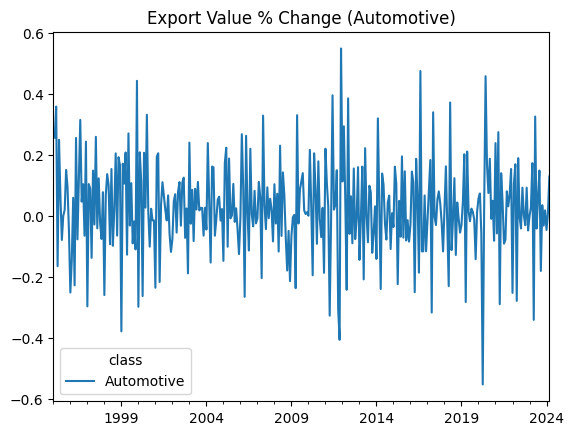

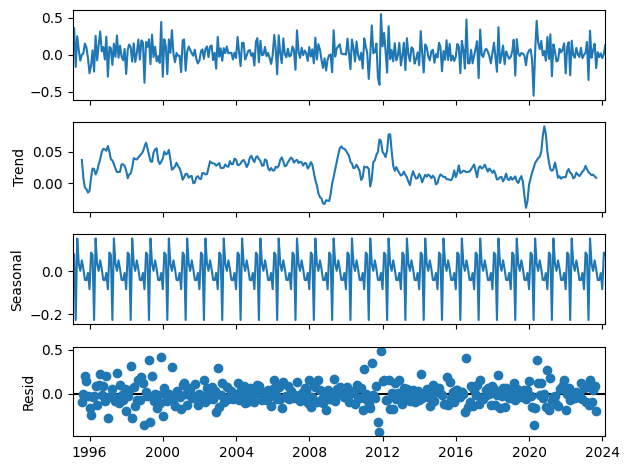


Plotting Residuals for Homoscedasticity Check...


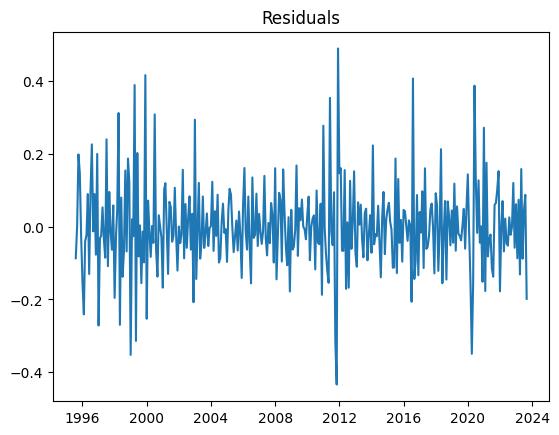

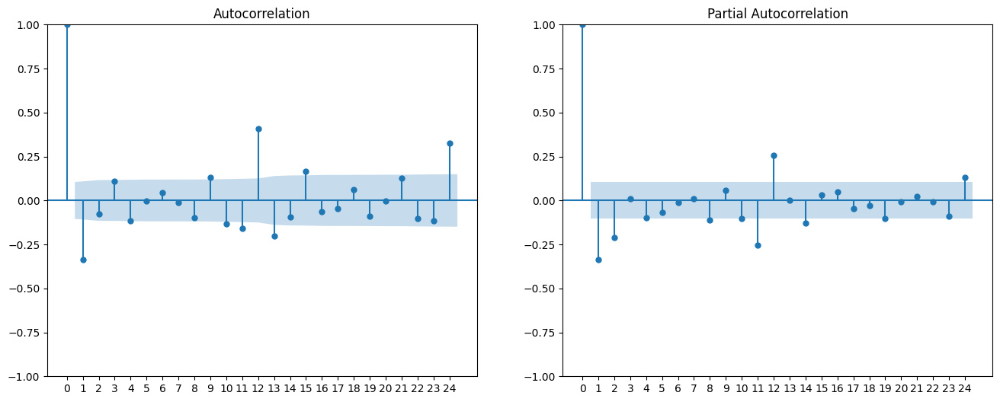


Time series assumptions are met.


True

'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -12.180013160350473
p-value: 1.358334652172505e-22
Critical Value 1%: -3.4493918438232525
Critical Value 5%: -2.8699298018856574
Critical Value 10%: -2.5712397066390458
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.42409283793594005
p-value: 0.06677032847588792
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


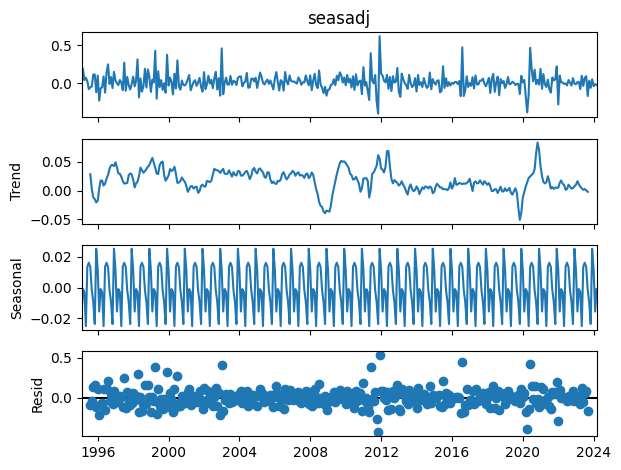


Plotting Residuals for Homoscedasticity Check...


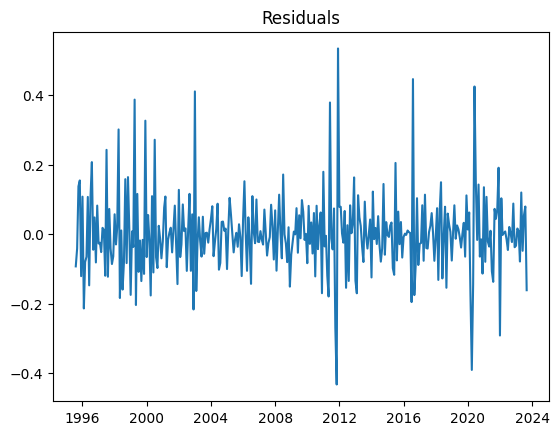

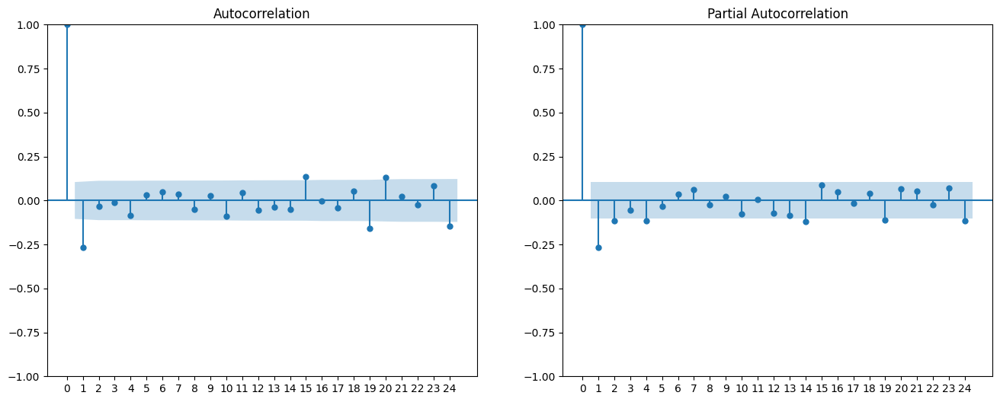


Time series assumptions are met.


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Data of Actual vs Forecasted values with error metrics:'

Automotive,actual,forecast,error,abs_error,squared_error,abs_percentage_error
2010-02-01,0.108920,0.070301,0.038618,0.038618,0.001491,0.354557
2010-03-01,0.010584,0.007928,0.002656,0.002656,0.000007,0.250954
2010-04-01,0.059690,-0.000774,0.060464,0.060464,0.003656,1.012967
2010-05-01,-0.054204,0.014101,-0.068304,0.068304,0.004666,1.260144
2010-06-01,0.093313,0.079012,0.014301,0.014301,0.000205,0.153262
...,...,...,...,...,...,...
2023-12-01,0.053319,0.013982,0.039337,0.039337,0.001547,0.737772
2024-01-01,-0.036869,0.053052,-0.089920,0.089920,0.008086,2.438946
2024-02-01,-0.009765,0.035270,-0.045035,0.045035,0.002028,4.611888
2024-03-01,-0.019514,0.033162,-0.052675,0.052675,0.002775,2.699384


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Total Mean Absolute Error (Per Forecast): 0.08048349149774105'

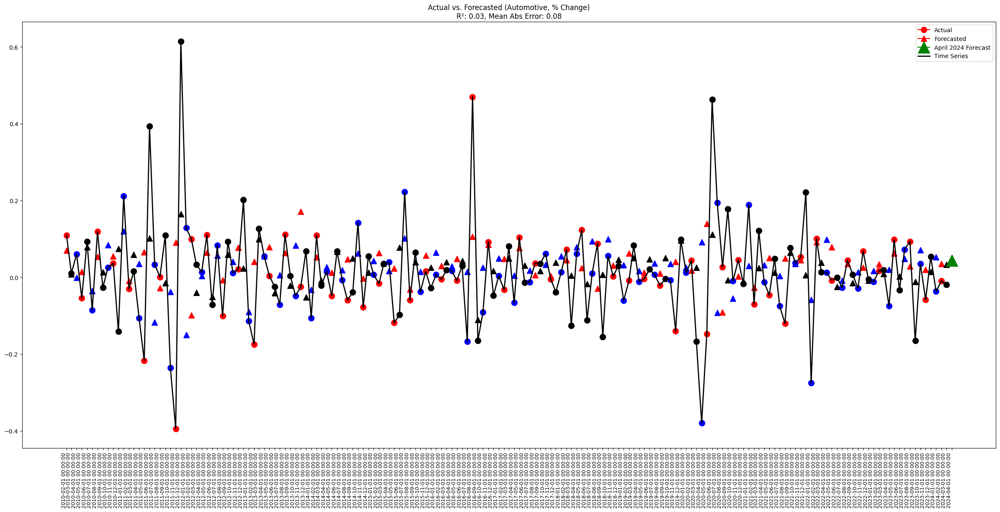

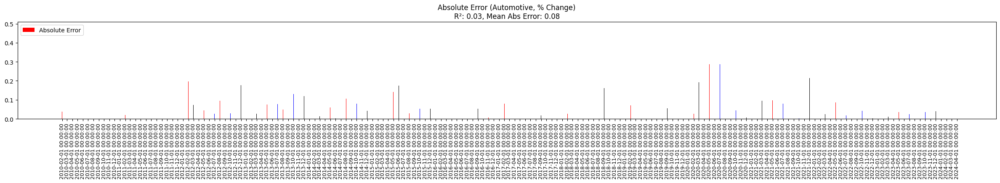

In [62]:
df = df_export_ANALYSIS[[name]]

df.plot(title=f"Export Value ({name})", label=f"{name}")
df.pct_change().plot(title=f"Export Value % Change ({name})", label=f"{name} % Change")
ts = df.pct_change().dropna()
display("Timeseries of component in % form:")
display(ts)
display("-" * 150)

### check if the data timeseries & statistical assumptions validity (stationary, seasonality, autocorrelation)
#freq 12 is used since the data is monthly, so the seasonality is 12 months YoY
display("Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):")
display(check_time_series_assumptions(ts, freq=12))
display("-" * 150)

#read the pickle file
with open(f'data/cleaned/deseasonalised_x13/update/dict_deseasonalized_value_{name}.pickle', 'rb') as handle:
    dict_deseasonalized_value = pickle.load(handle)[name]
adj_ts = dict_deseasonalized_value['seasadj'].pct_change().dropna()
display("Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):")
check_time_series_assumptions(adj_ts, freq=12)
display("-" * 150)

df_accuracy = pd.read_pickle(f"data/cleaned/SARIMA_RollWalkForward/combined/updated/accuracy/df_accuracy_{name}.pickle")
df_accuracy.columns.name = name
#Forecast are all Out-Of-Sample on a rolling basis
display("Data of Actual vs Forecasted values with error metrics:")
display(df_accuracy)
display("-" * 150)

#Plot Actual vs Forecasted values with error metrics
average_abs_error = df_accuracy["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_accuracy, name)


## Aircrafts,_ships,_floating_structures,_and_locomotive

In [63]:
df = df_export_ANALYSIS.copy()
name = df.columns[24]
display(f"Component: {name}")

'Component: Aircrafts,_ships,_floating_structures,_and_locomotive'

'Timeseries of component in % form:'

class,"Aircrafts,_ships,_floating_structures,_and_locomotive"
1995-02-01,0.164388
1995-03-01,1.450172
1995-04-01,-0.561828
1995-05-01,0.367831
1995-06-01,0.643136
...,...
2023-11-01,0.388672
2023-12-01,0.010779
2024-01-01,-0.467876
2024-02-01,0.518252


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -12.332296010858279
p-value: 6.386494076890815e-23
Critical Value 1%: -3.4492815848836296
Critical Value 5%: -2.8698813715275406
Critical Value 10%: -2.5712138845950587
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.20582528392937968
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


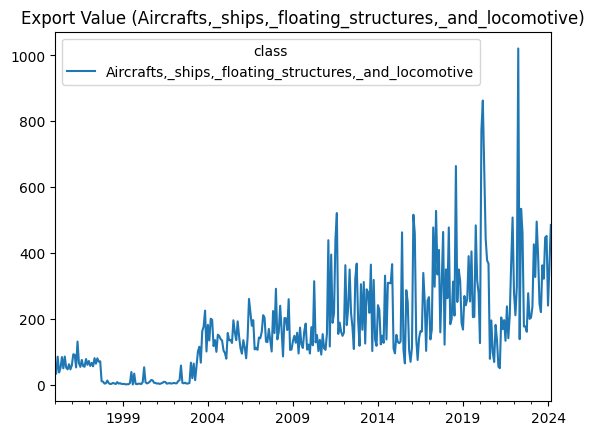

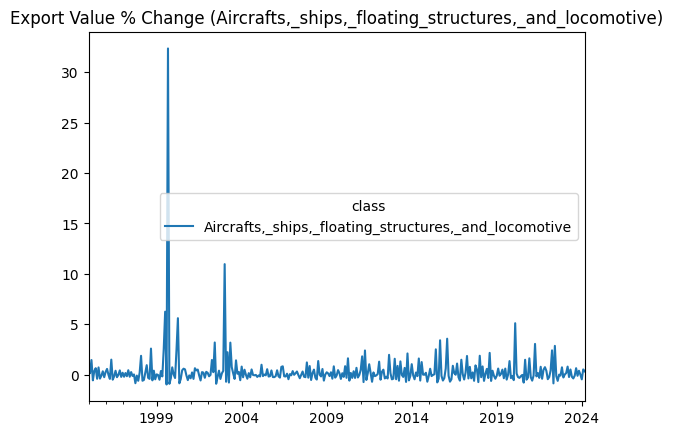

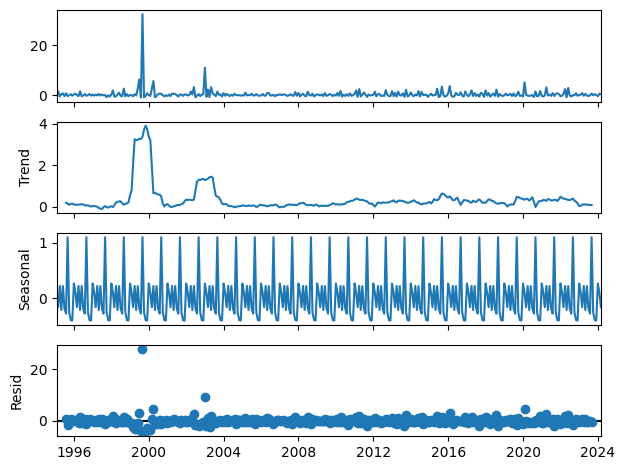


Plotting Residuals for Homoscedasticity Check...


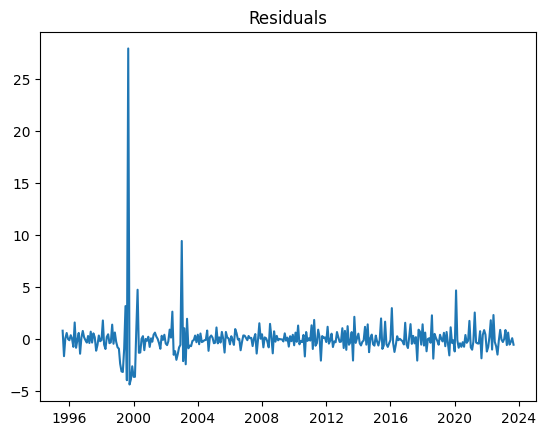

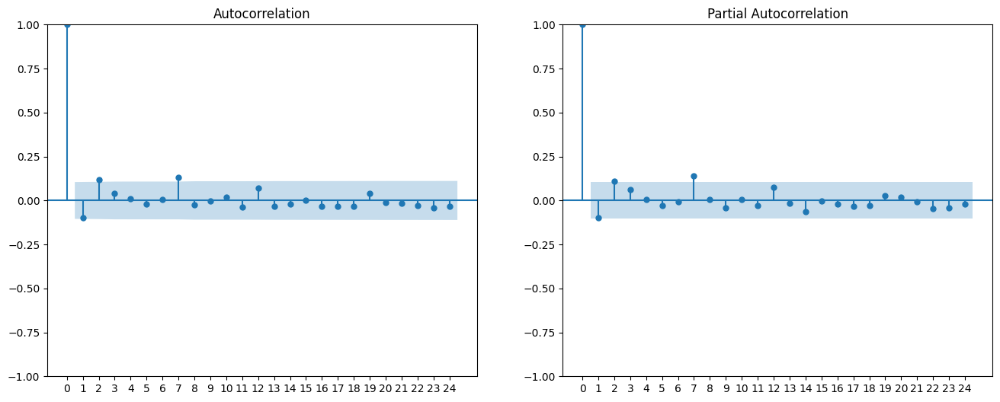


Time series assumptions are met.


True

'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -5.692223490536685
p-value: 8.022373100624624e-07
Critical Value 1%: -3.449559661646851
Critical Value 5%: -2.8700035112469626
Critical Value 10%: -2.5712790073013796
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.19483784078215474
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


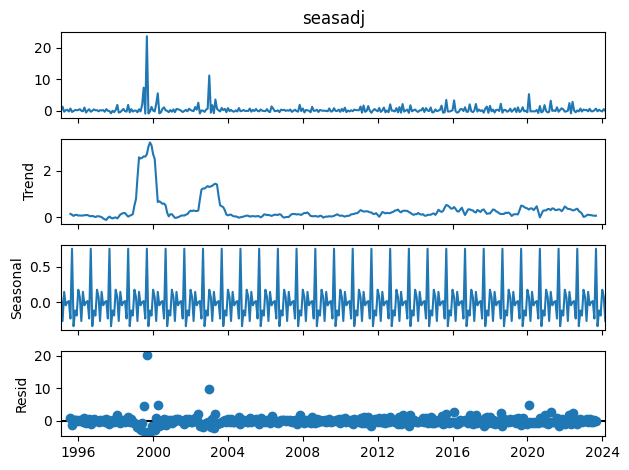


Plotting Residuals for Homoscedasticity Check...


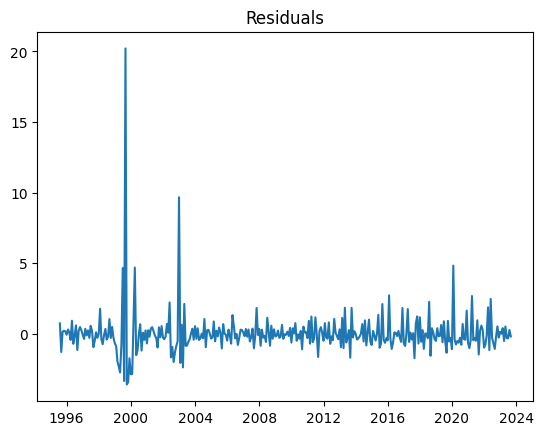

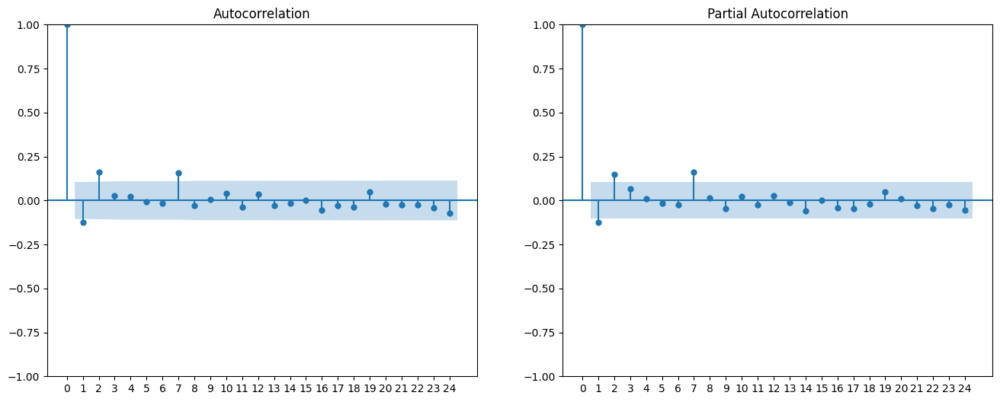


Time series assumptions are met.


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Data of Actual vs Forecasted values with error metrics:'

"Aircrafts,_ships,_floating_structures,_and_locomotive",actual,forecast,error,abs_error,squared_error,abs_percentage_error
2010-02-01,0.540823,0.290951,0.249872,0.249872,0.062436,0.462021
2010-03-01,-0.187896,0.228895,-0.416791,0.416791,0.173715,2.218198
2010-04-01,0.933865,0.474655,0.459210,0.459210,0.210874,0.491731
2010-05-01,-0.476219,0.359026,-0.835245,0.835245,0.697635,1.753910
2010-06-01,0.025214,0.486026,-0.460811,0.460811,0.212347,18.275912
...,...,...,...,...,...,...
2023-12-01,-0.066537,0.255122,-0.321659,0.321659,0.103464,4.834291
2024-01-01,-0.266207,0.320834,-0.587041,0.587041,0.344617,2.205207
2024-02-01,0.492755,0.327727,0.165028,0.165028,0.027234,0.334909
2024-03-01,-0.083545,0.188960,-0.272505,0.272505,0.074259,3.261756


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Total Mean Absolute Error (Per Forecast): 0.6780209587288091'

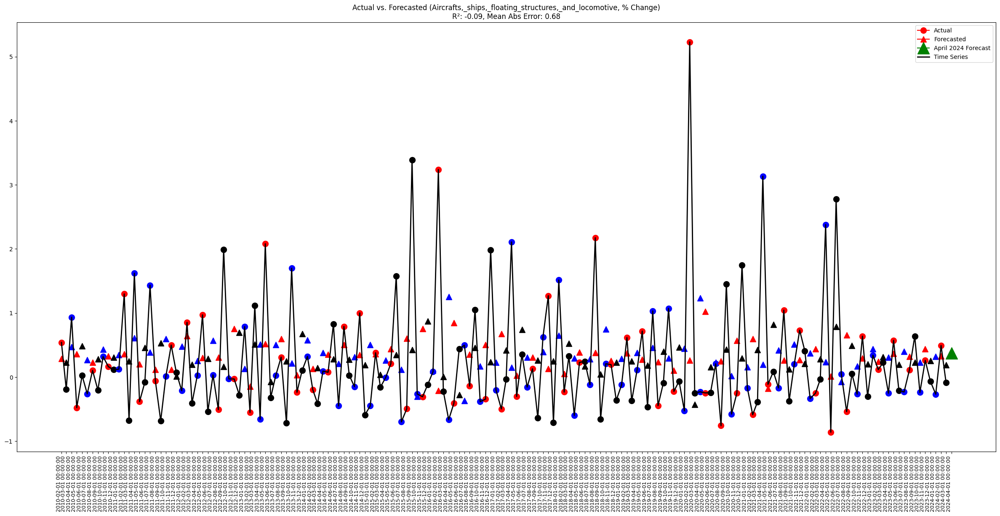

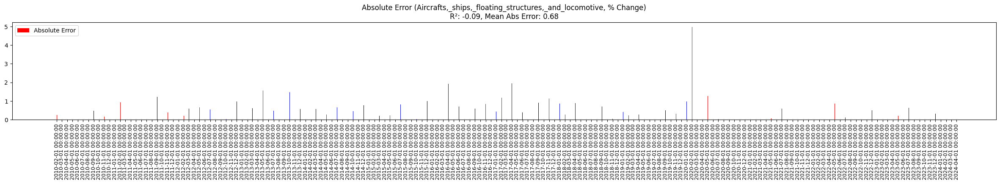

In [64]:
df = df_export_ANALYSIS[[name]]

df.plot(title=f"Export Value ({name})", label=f"{name}")
df.pct_change().plot(title=f"Export Value % Change ({name})", label=f"{name} % Change")
ts = df.pct_change().dropna()
display("Timeseries of component in % form:")
display(ts)
display("-" * 150)

### check if the data timeseries & statistical assumptions validity (stationary, seasonality, autocorrelation)
#freq 12 is used since the data is monthly, so the seasonality is 12 months YoY
display("Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):")
display(check_time_series_assumptions(ts, freq=12))
display("-" * 150)

#read the pickle file
with open(f'data/cleaned/deseasonalised_x13/update/dict_deseasonalized_value_{name}.pickle', 'rb') as handle:
    dict_deseasonalized_value = pickle.load(handle)[name]
adj_ts = dict_deseasonalized_value['seasadj'].pct_change().dropna()
display("Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):")
check_time_series_assumptions(adj_ts, freq=12)
display("-" * 150)

df_accuracy = pd.read_pickle(f"data/cleaned/SARIMA_RollWalkForward/combined/updated/accuracy/df_accuracy_{name}.pickle")
df_accuracy.columns.name = name
#Forecast are all Out-Of-Sample on a rolling basis
display("Data of Actual vs Forecasted values with error metrics:")
display(df_accuracy)
display("-" * 150)

#Plot Actual vs Forecasted values with error metrics
average_abs_error = df_accuracy["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_accuracy, name)


## Machinery_&_Equipment

In [65]:
df = df_export_ANALYSIS.copy()
name = df.columns[25]
display(f"Component: {name}")

'Component: Machinery_&_Equipment'

'Timeseries of component in % form:'

class,Machinery_&_Equipment
1995-02-01,0.007865
1995-03-01,0.200336
1995-04-01,-0.152429
1995-05-01,0.175925
1995-06-01,0.107978
...,...
2023-11-01,0.053624
2023-12-01,-0.090947
2024-01-01,0.004479
2024-02-01,0.082038


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -4.769996604383572
p-value: 6.204812010425586e-05
Critical Value 1%: -3.4499043309021955
Critical Value 5%: -2.870154885338925
Critical Value 10%: -2.5713597190254385
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.07181604777890156
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


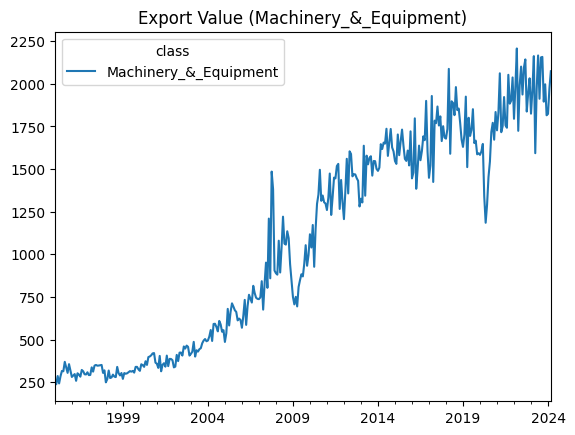

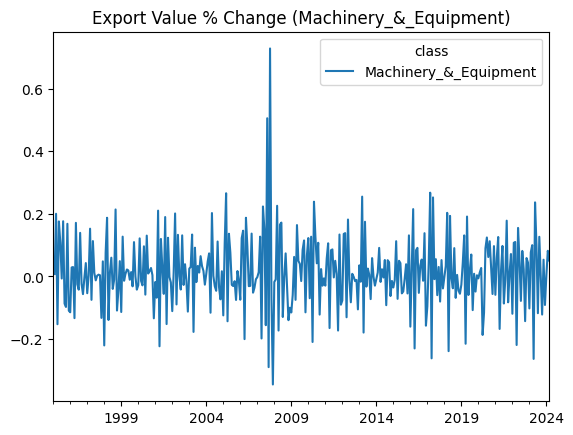

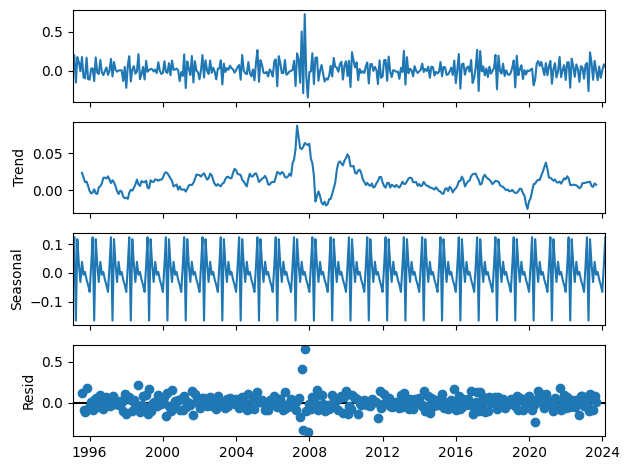


Plotting Residuals for Homoscedasticity Check...


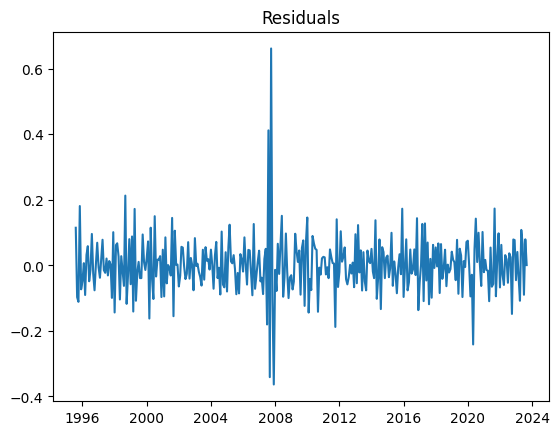

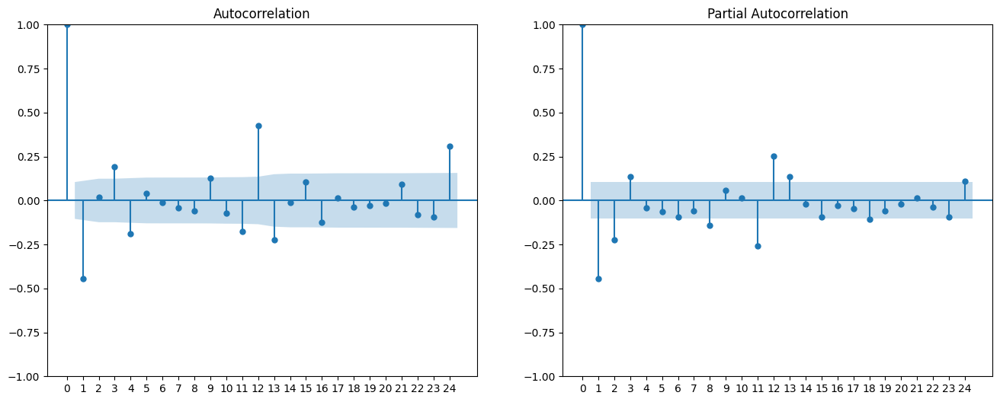


Time series assumptions are met.


True

'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -10.205677184695563
p-value: 5.813164609753272e-18
Critical Value 1%: -3.4493918438232525
Critical Value 5%: -2.8699298018856574
Critical Value 10%: -2.5712397066390458
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.13527414324388737
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


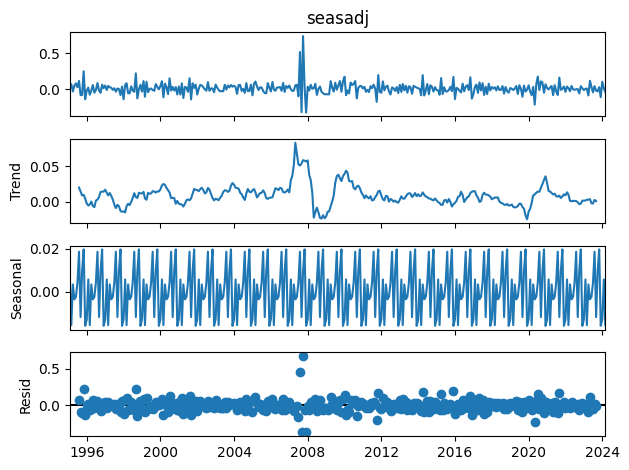


Plotting Residuals for Homoscedasticity Check...


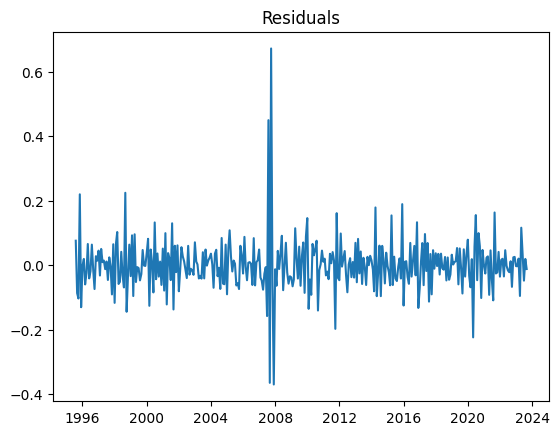

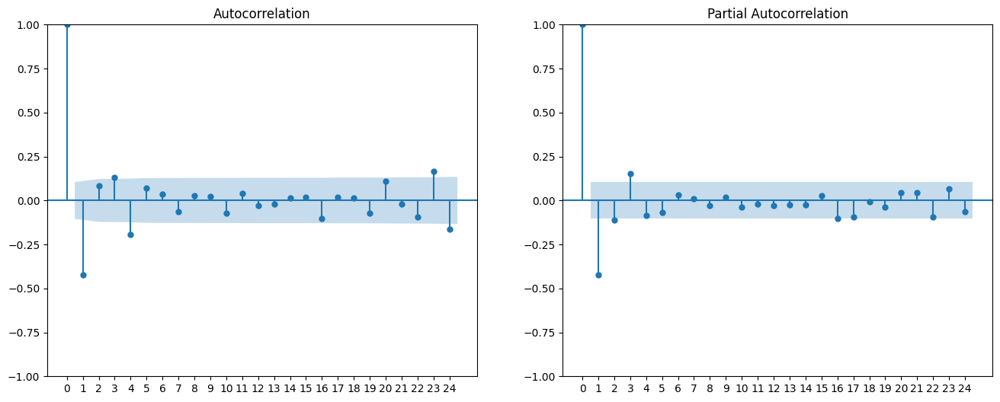


Time series assumptions are met.


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Data of Actual vs Forecasted values with error metrics:'

Machinery_&_Equipment,actual,forecast,error,abs_error,squared_error,abs_percentage_error
2010-02-01,-0.085667,-0.059230,-0.026436,0.026436,0.000699,0.308596
2010-03-01,-0.018548,0.080240,-0.098788,0.098788,0.009759,5.326083
2010-04-01,-0.058910,0.041582,-0.100492,0.100492,0.010099,1.705856
2010-05-01,0.091145,0.008844,0.082301,0.082301,0.006773,0.902965
2010-06-01,0.057591,-0.019682,0.077274,0.077274,0.005971,1.341753
...,...,...,...,...,...,...
2023-12-01,-0.112859,-0.001825,-0.111034,0.111034,0.012329,0.983833
2024-01-01,0.102267,0.056543,0.045724,0.045724,0.002091,0.447100
2024-02-01,0.009883,-0.022210,0.032092,0.032092,0.001030,3.247380
2024-03-01,-0.038750,-0.006105,-0.032645,0.032645,0.001066,0.842456


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Total Mean Absolute Error (Per Forecast): 0.04190734467741312'

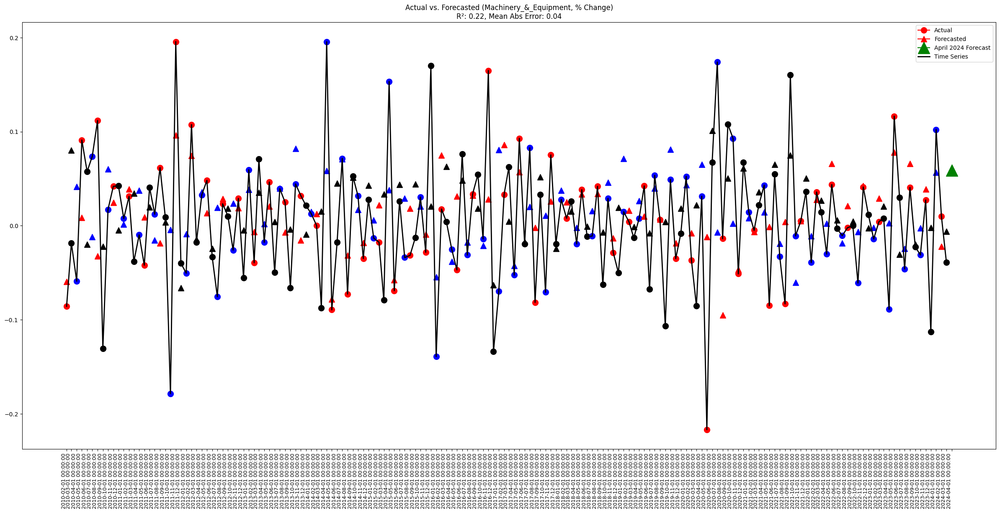

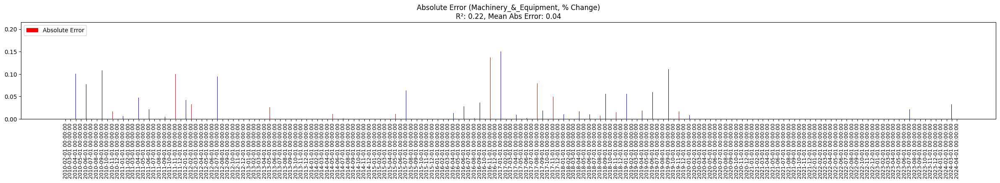

In [66]:
df = df_export_ANALYSIS[[name]]

df.plot(title=f"Export Value ({name})", label=f"{name}")
df.pct_change().plot(title=f"Export Value % Change ({name})", label=f"{name} % Change")
ts = df.pct_change().dropna()
display("Timeseries of component in % form:")
display(ts)
display("-" * 150)

### check if the data timeseries & statistical assumptions validity (stationary, seasonality, autocorrelation)
#freq 12 is used since the data is monthly, so the seasonality is 12 months YoY
display("Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):")
display(check_time_series_assumptions(ts, freq=12))
display("-" * 150)

#read the pickle file
with open(f'data/cleaned/deseasonalised_x13/update/dict_deseasonalized_value_{name}.pickle', 'rb') as handle:
    dict_deseasonalized_value = pickle.load(handle)[name]
adj_ts = dict_deseasonalized_value['seasadj'].pct_change().dropna()
display("Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):")
check_time_series_assumptions(adj_ts, freq=12)
display("-" * 150)

df_accuracy = pd.read_pickle(f"data/cleaned/SARIMA_RollWalkForward/combined/updated/accuracy/df_accuracy_{name}.pickle")
df_accuracy.columns.name = name
#Forecast are all Out-Of-Sample on a rolling basis
display("Data of Actual vs Forecasted values with error metrics:")
display(df_accuracy)
display("-" * 150)

#Plot Actual vs Forecasted values with error metrics
average_abs_error = df_accuracy["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_accuracy, name)


## Jewellery

In [67]:
df = df_export_ANALYSIS.copy()
name = df.columns[26]
display(f"Component: {name}")

'Component: Jewellery'

'Timeseries of component in % form:'

class,Jewellery
1995-02-01,-0.222918
1995-03-01,0.654083
1995-04-01,-0.273469
1995-05-01,0.124966
1995-06-01,0.104088
...,...
2023-11-01,-0.057911
2023-12-01,-0.220355
2024-01-01,0.260761
2024-02-01,0.634558


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -2.511627126403834
p-value: 0.11267088930593122
Critical Value 1%: -3.449962981927952
Critical Value 5%: -2.870180642420163
Critical Value 10%: -2.5713734527352607
is_stationary: False

Running KPSS Test for Stationarity...
KPSS Statistic: 0.35782335776750956
p-value: 0.09533475958297001
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


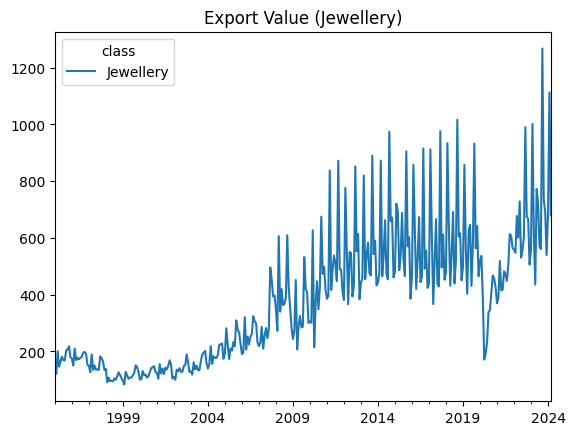

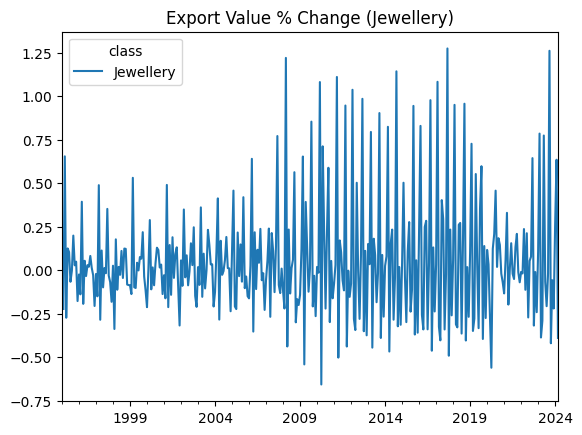

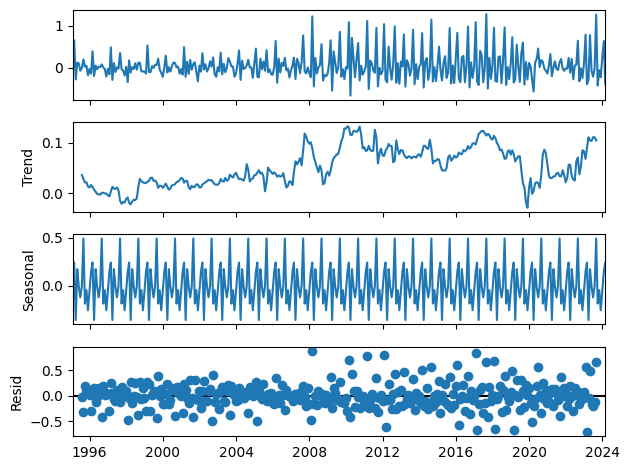


Plotting Residuals for Homoscedasticity Check...


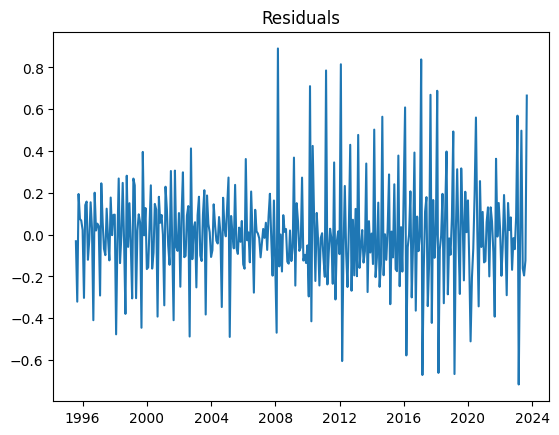

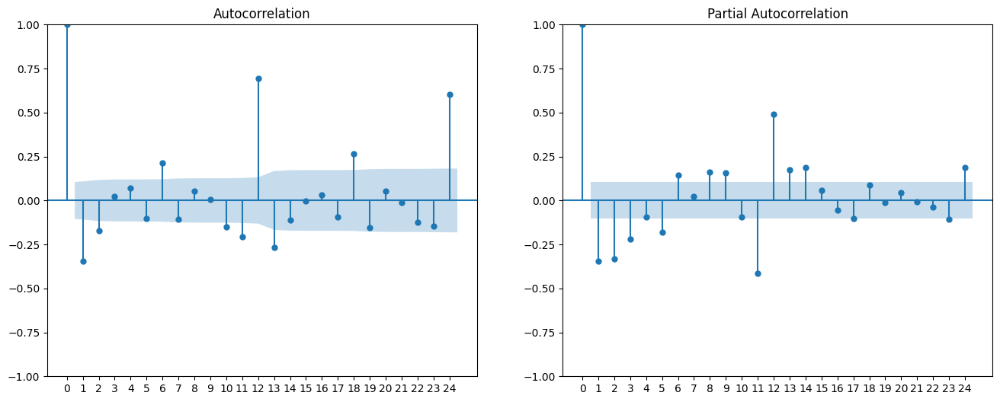


Time series assumptions are not met. Further investigation needed.


False

'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -7.8555683377077115
p-value: 5.454572693881563e-12
Critical Value 1%: -3.4494474563375737
Critical Value 5%: -2.8699542285903887
Critical Value 10%: -2.5712527305187987
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.33889979395690045
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


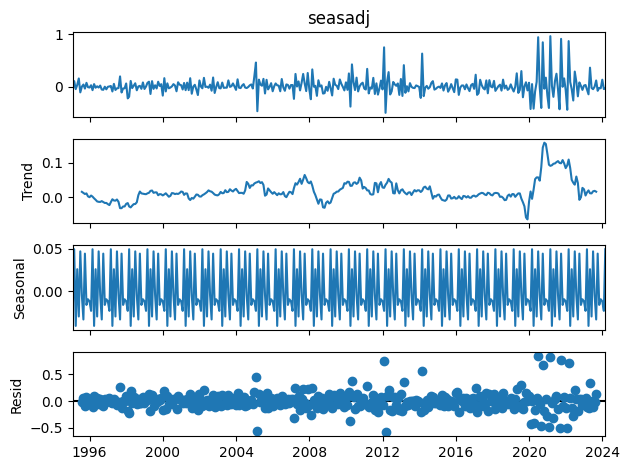


Plotting Residuals for Homoscedasticity Check...


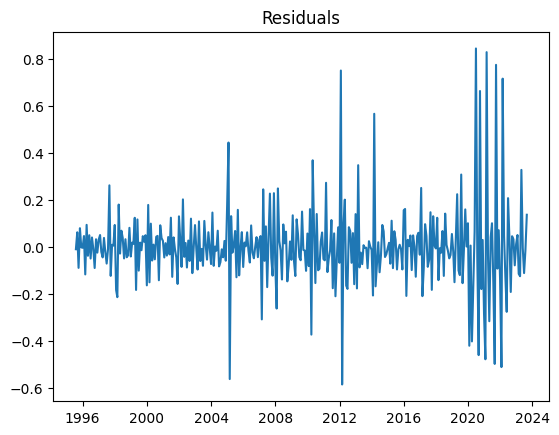

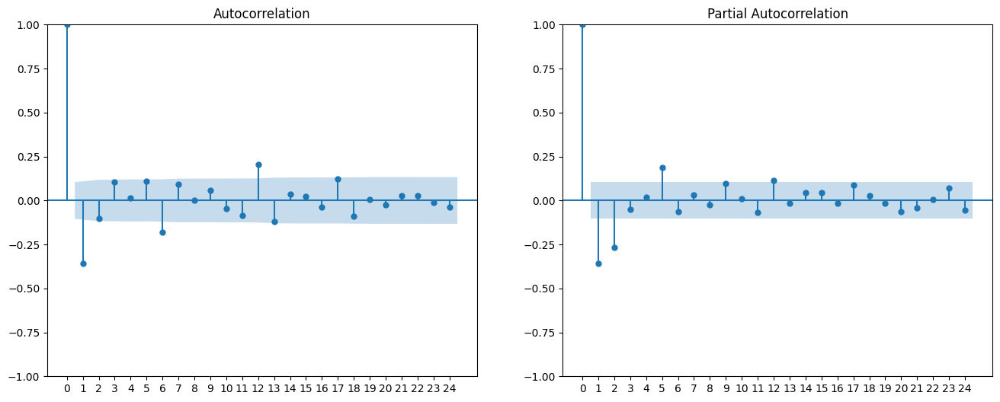


Time series assumptions are met.


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Data of Actual vs Forecasted values with error metrics:'

Jewellery,actual,forecast,error,abs_error,squared_error,abs_percentage_error
2010-02-01,-0.058634,0.001552,-0.060186,0.060186,0.003622,1.026472
2010-03-01,0.255059,0.022881,0.232178,0.232178,0.053907,0.910292
2010-04-01,-0.379065,-0.083780,-0.295285,0.295285,0.087193,0.778982
2010-05-01,0.427789,0.155730,0.272059,0.272059,0.074016,0.635966
2010-06-01,0.087046,-0.171788,0.258834,0.258834,0.066995,2.973538
...,...,...,...,...,...,...
2023-12-01,-0.028825,0.024274,-0.053100,0.053100,0.002820,1.842109
2024-01-01,0.135504,0.035202,0.100301,0.100301,0.010060,0.740210
2024-02-01,-0.044451,-0.003733,-0.040718,0.040718,0.001658,0.916018
2024-03-01,-0.032116,-0.005585,-0.026531,0.026531,0.000704,0.826114


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Total Mean Absolute Error (Per Forecast): 0.13219478579070415'

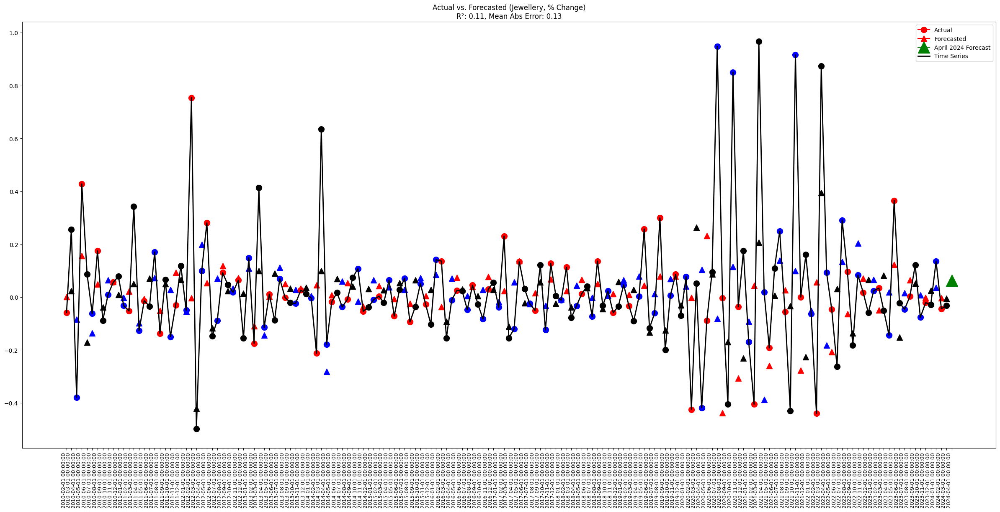

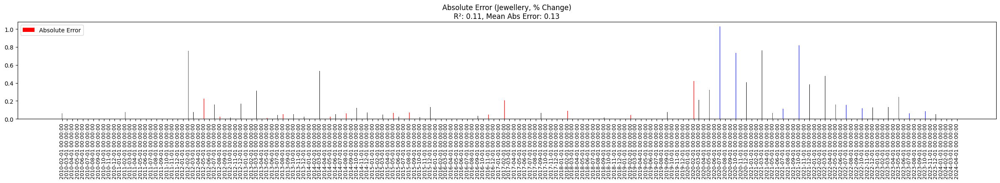

In [68]:
df = df_export_ANALYSIS[[name]]

df.plot(title=f"Export Value ({name})", label=f"{name}")
df.pct_change().plot(title=f"Export Value % Change ({name})", label=f"{name} % Change")
ts = df.pct_change().dropna()
display("Timeseries of component in % form:")
display(ts)
display("-" * 150)

### check if the data timeseries & statistical assumptions validity (stationary, seasonality, autocorrelation)
#freq 12 is used since the data is monthly, so the seasonality is 12 months YoY
display("Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):")
display(check_time_series_assumptions(ts, freq=12))
display("-" * 150)

#read the pickle file
with open(f'data/cleaned/deseasonalised_x13/update/dict_deseasonalized_value_{name}.pickle', 'rb') as handle:
    dict_deseasonalized_value = pickle.load(handle)[name]
adj_ts = dict_deseasonalized_value['seasadj'].pct_change().dropna()
display("Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):")
check_time_series_assumptions(adj_ts, freq=12)
display("-" * 150)

df_accuracy = pd.read_pickle(f"data/cleaned/SARIMA_RollWalkForward/combined/updated/accuracy/df_accuracy_{name}.pickle")
df_accuracy.columns.name = name
#Forecast are all Out-Of-Sample on a rolling basis
display("Data of Actual vs Forecasted values with error metrics:")
display(df_accuracy)
display("-" * 150)

#Plot Actual vs Forecasted values with error metrics
average_abs_error = df_accuracy["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_accuracy, name)


## Chemicals_&_Petro-chemical_Products

In [69]:
df = df_export_ANALYSIS.copy()
name = df.columns[27]
display(f"Component: {name}")

'Component: Chemicals_&_Petro-chemical_Products'

'Timeseries of component in % form:'

class,Chemicals_&_Petro-chemical_Products
1995-02-01,-0.013421
1995-03-01,0.288744
1995-04-01,-0.038704
1995-05-01,0.469981
1995-06-01,-0.195582
...,...
2023-11-01,0.006685
2023-12-01,-0.097435
2024-01-01,0.033378
2024-02-01,-0.007009


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -5.330488619537796
p-value: 4.7330976913727265e-06
Critical Value 1%: -3.450141065277327
Critical Value 5%: -2.870258846235788
Critical Value 10%: -2.571415151457764
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.2888272765743553
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


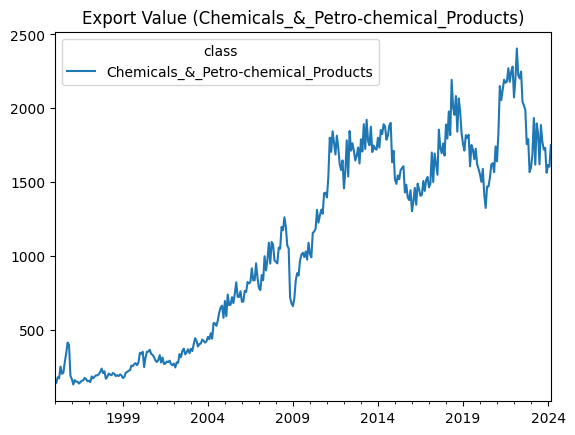

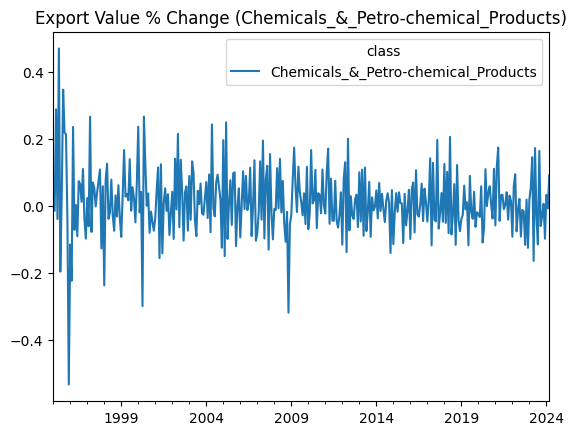

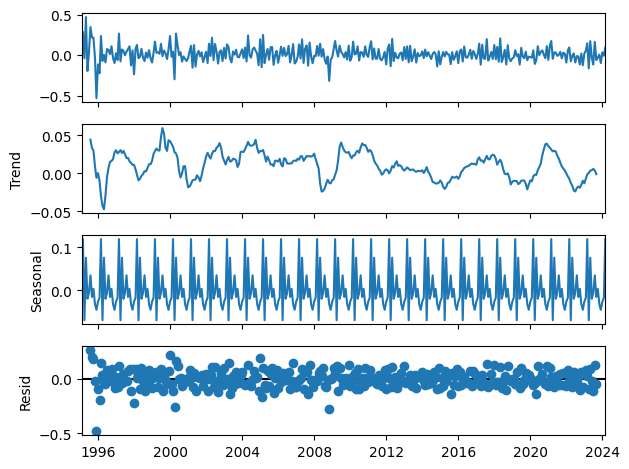


Plotting Residuals for Homoscedasticity Check...


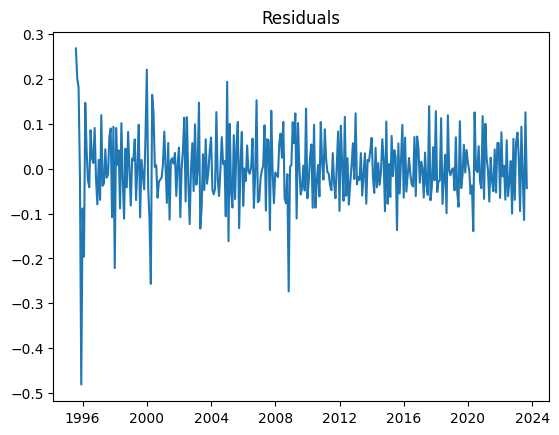

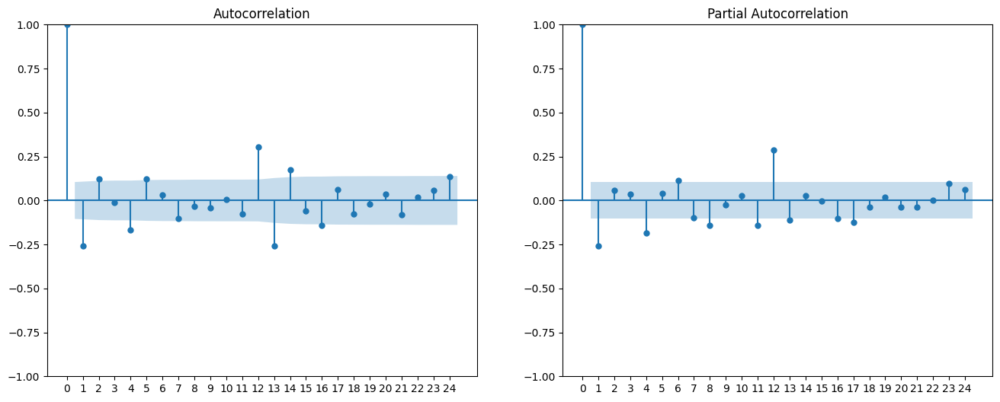


Time series assumptions are met.


True

'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -5.779666305341256
p-value: 5.161042274379734e-07
Critical Value 1%: -3.4499043309021955
Critical Value 5%: -2.870154885338925
Critical Value 10%: -2.5713597190254385
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.3648000618538905
p-value: 0.09232755954573685
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


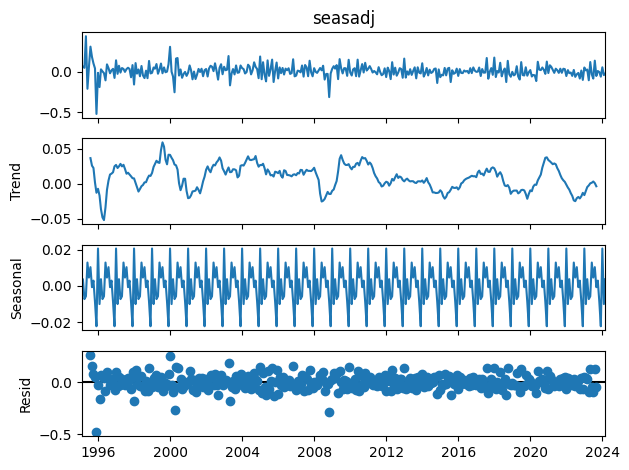


Plotting Residuals for Homoscedasticity Check...


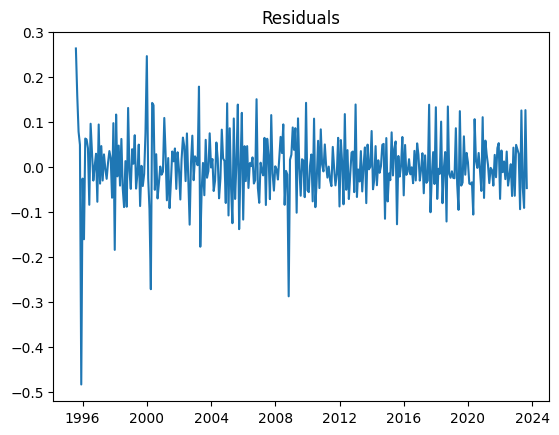

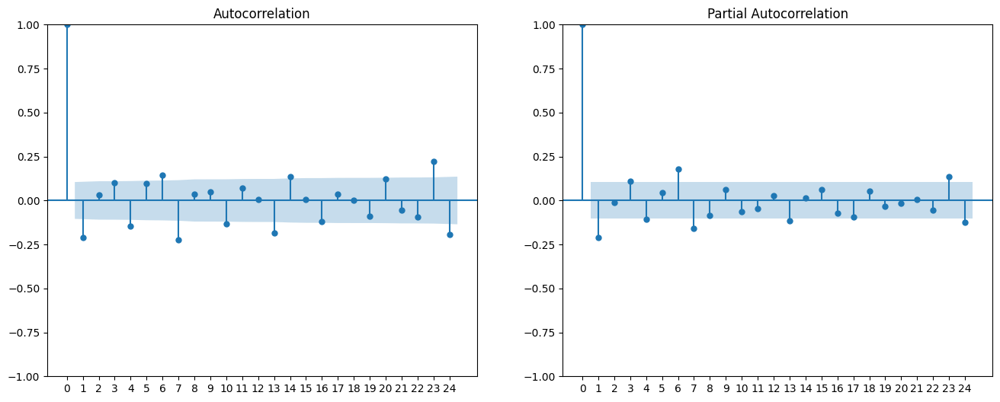


Time series assumptions are met.


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Data of Actual vs Forecasted values with error metrics:'

Chemicals_&_Petro-chemical_Products,actual,forecast,error,abs_error,squared_error,abs_percentage_error
2010-02-01,-0.045251,0.004026,-0.049277,0.049277,0.002428,1.088977
2010-03-01,0.030032,0.076069,-0.046038,0.046038,0.002119,1.532975
2010-04-01,0.044690,-0.024999,0.069690,0.069690,0.004857,1.559386
2010-05-01,-0.053401,0.006717,-0.060118,0.060118,0.003614,1.125783
2010-06-01,0.150295,0.044742,0.105553,0.105553,0.011141,0.702305
...,...,...,...,...,...,...
2023-12-01,-0.059319,-0.032050,-0.027268,0.027268,0.000744,0.459692
2024-01-01,0.056399,0.040303,0.016097,0.016097,0.000259,0.285403
2024-02-01,-0.040201,0.007912,-0.048113,0.048113,0.002315,1.196809
2024-03-01,-0.020327,-0.011144,-0.009184,0.009184,0.000084,0.451800


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Total Mean Absolute Error (Per Forecast): 0.04134805673981834'

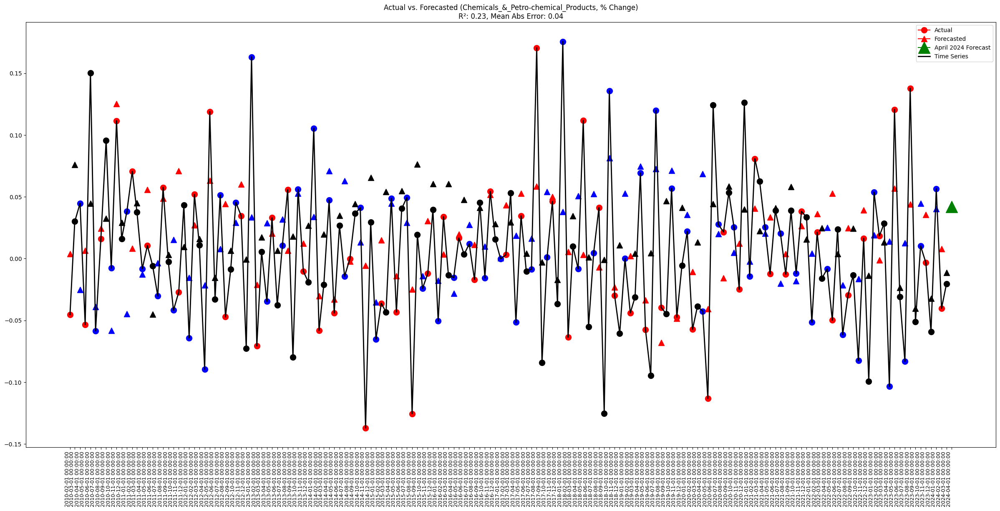

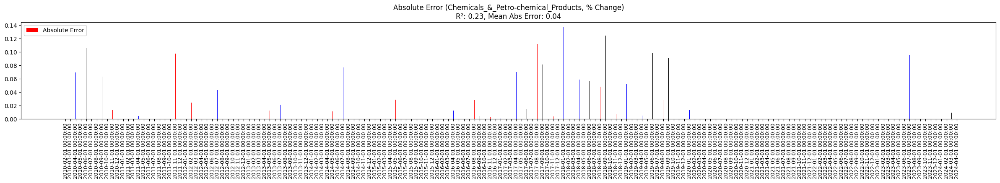

In [70]:
df = df_export_ANALYSIS[[name]]

df.plot(title=f"Export Value ({name})", label=f"{name}")
df.pct_change().plot(title=f"Export Value % Change ({name})", label=f"{name} % Change")
ts = df.pct_change().dropna()
display("Timeseries of component in % form:")
display(ts)
display("-" * 150)

### check if the data timeseries & statistical assumptions validity (stationary, seasonality, autocorrelation)
#freq 12 is used since the data is monthly, so the seasonality is 12 months YoY
display("Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):")
display(check_time_series_assumptions(ts, freq=12))
display("-" * 150)

#read the pickle file
with open(f'data/cleaned/deseasonalised_x13/update/dict_deseasonalized_value_{name}.pickle', 'rb') as handle:
    dict_deseasonalized_value = pickle.load(handle)[name]
adj_ts = dict_deseasonalized_value['seasadj'].pct_change().dropna()
display("Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):")
check_time_series_assumptions(adj_ts, freq=12)
display("-" * 150)

df_accuracy = pd.read_pickle(f"data/cleaned/SARIMA_RollWalkForward/combined/updated/accuracy/df_accuracy_{name}.pickle")
df_accuracy.columns.name = name
#Forecast are all Out-Of-Sample on a rolling basis
display("Data of Actual vs Forecasted values with error metrics:")
display(df_accuracy)
display("-" * 150)

#Plot Actual vs Forecasted values with error metrics
average_abs_error = df_accuracy["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_accuracy, name)


## Petroleum_products

In [71]:
df = df_export_ANALYSIS.copy()
name = df.columns[28]
display(f"Component: {name}")

'Component: Petroleum_products'

'Timeseries of component in % form:'

class,Petroleum_products
1995-02-01,1.739015
1995-03-01,0.096014
1995-04-01,-0.487913
1995-05-01,-0.146384
1995-06-01,0.098935
...,...
2023-11-01,-0.152933
2023-12-01,0.058325
2024-01-01,-0.246006
2024-02-01,-0.171409


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -4.551095018074174
p-value: 0.0001588073220471269
Critical Value 1%: -3.449846029628477
Critical Value 5%: -2.870129281376164
Critical Value 10%: -2.5713460670144603
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.8999848419258791
p-value: 0.01
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: False

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  result = kpss(series, regression='c')


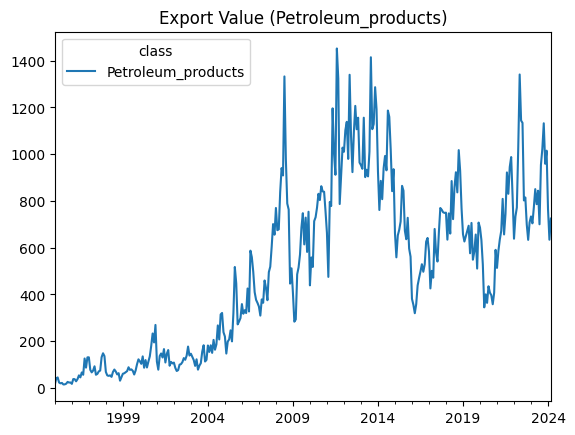

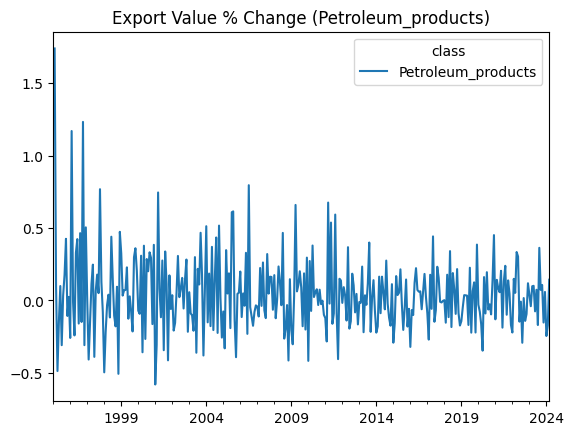

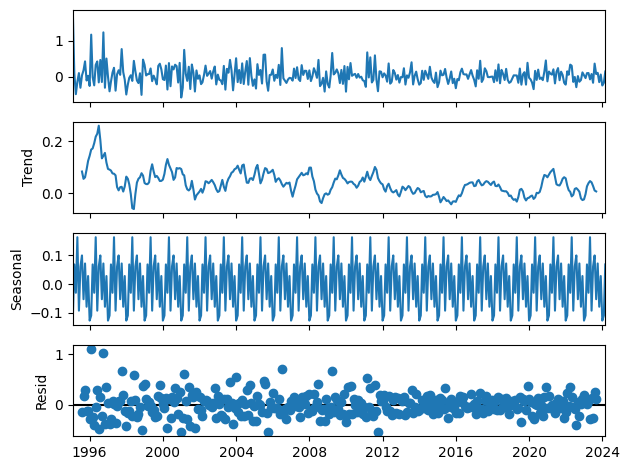


Plotting Residuals for Homoscedasticity Check...


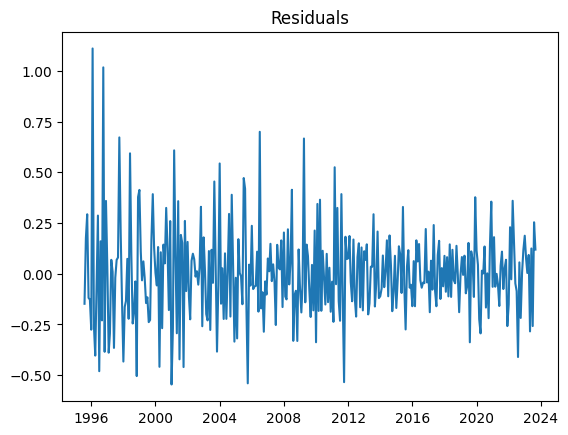

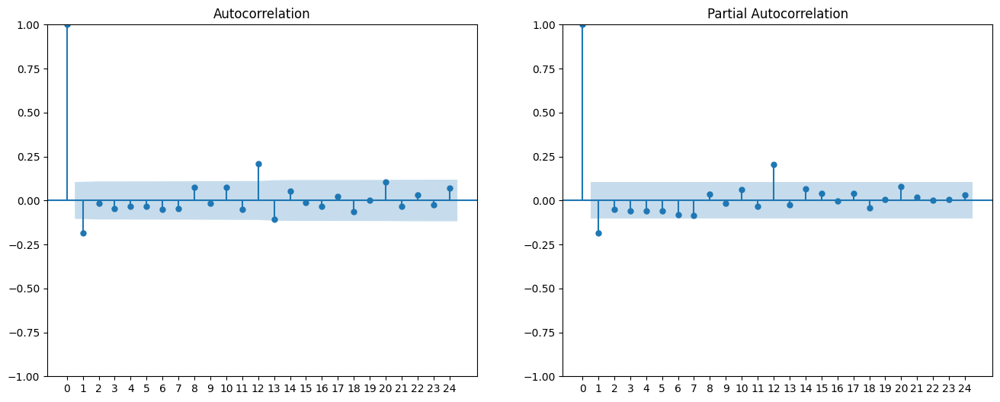


Time series assumptions are not met. Further investigation needed.


False

'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -4.839394025705354
p-value: 4.569455927936921e-05
Critical Value 1%: -3.449846029628477
Critical Value 5%: -2.870129281376164
Critical Value 10%: -2.5713460670144603
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.8389443829970102
p-value: 0.01
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: False

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  result = kpss(series, regression='c')


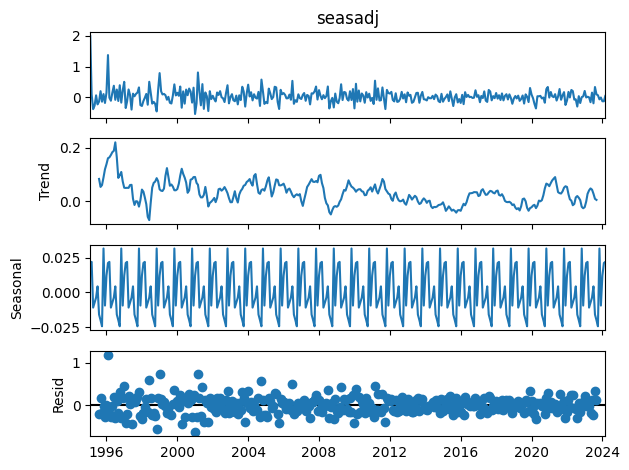


Plotting Residuals for Homoscedasticity Check...


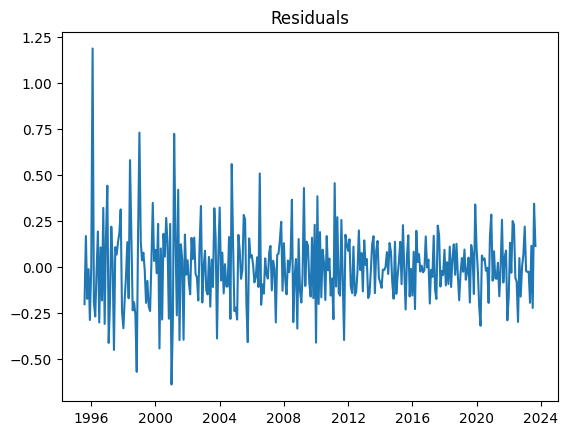

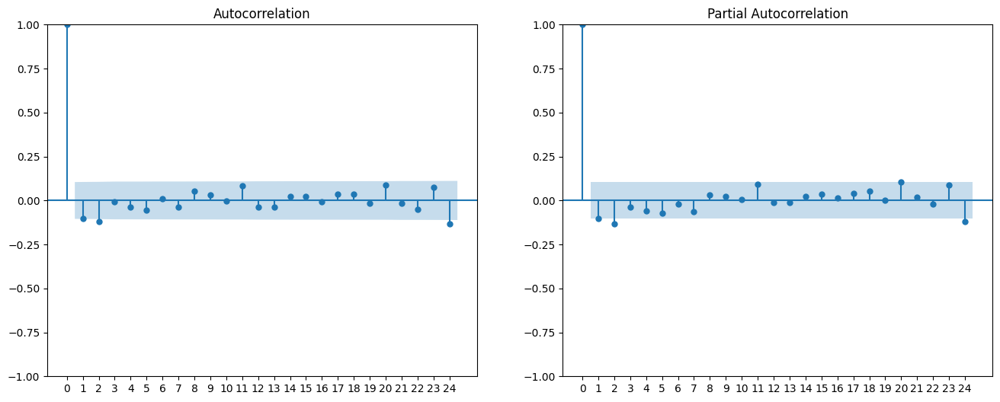


Time series assumptions are not met. Further investigation needed.


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Data of Actual vs Forecasted values with error metrics:'

Petroleum_products,actual,forecast,error,abs_error,squared_error,abs_percentage_error
2010-02-01,0.441760,0.048162,0.393597,0.393597,0.154919,0.890976
2010-03-01,-0.136632,0.095097,-0.231729,0.231729,0.053698,1.696007
2010-04-01,0.224017,-0.010698,0.234715,0.234715,0.055091,1.047754
2010-05-01,-0.126839,0.063360,-0.190200,0.190200,0.036176,1.499530
2010-06-01,0.128215,0.028602,0.099613,0.099613,0.009923,0.776923
...,...,...,...,...,...,...
2023-12-01,-0.002006,0.004542,-0.006548,0.006548,0.000043,3.263832
2024-01-01,-0.123391,-0.009933,-0.113458,0.113458,0.012873,0.919500
2024-02-01,-0.123407,-0.031408,-0.092000,0.092000,0.008464,0.745497
2024-03-01,0.047704,0.037028,0.010677,0.010677,0.000114,0.223809


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Total Mean Absolute Error (Per Forecast): 0.11800951657769845'

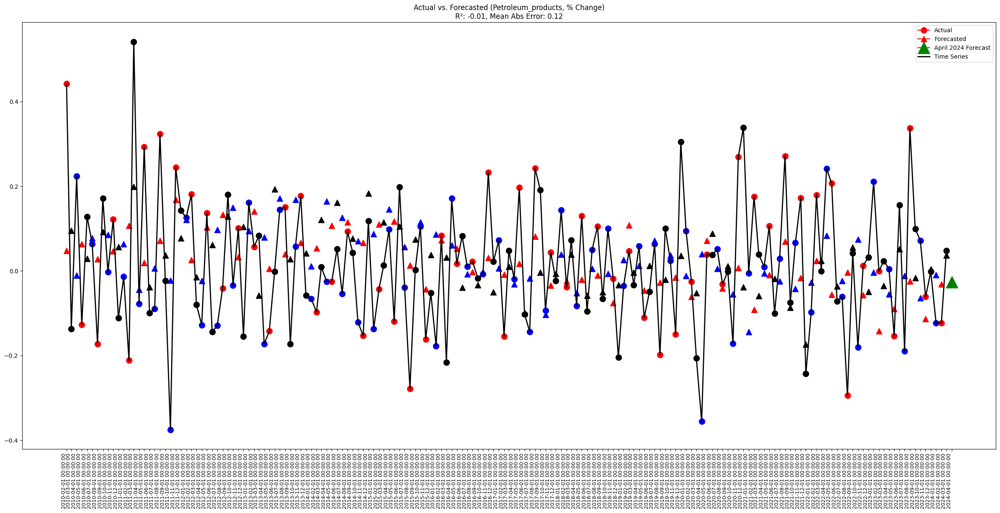

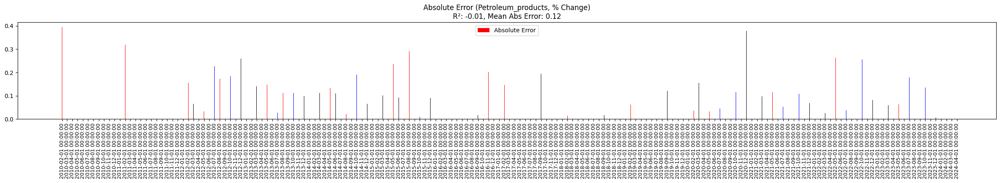

In [72]:
df = df_export_ANALYSIS[[name]]

df.plot(title=f"Export Value ({name})", label=f"{name}")
df.pct_change().plot(title=f"Export Value % Change ({name})", label=f"{name} % Change")
ts = df.pct_change().dropna()
display("Timeseries of component in % form:")
display(ts)
display("-" * 150)

### check if the data timeseries & statistical assumptions validity (stationary, seasonality, autocorrelation)
#freq 12 is used since the data is monthly, so the seasonality is 12 months YoY
display("Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):")
display(check_time_series_assumptions(ts, freq=12))
display("-" * 150)

#read the pickle file
with open(f'data/cleaned/deseasonalised_x13/update/dict_deseasonalized_value_{name}.pickle', 'rb') as handle:
    dict_deseasonalized_value = pickle.load(handle)[name]
adj_ts = dict_deseasonalized_value['seasadj'].pct_change().dropna()
display("Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):")
check_time_series_assumptions(adj_ts, freq=12)
display("-" * 150)

df_accuracy = pd.read_pickle(f"data/cleaned/SARIMA_RollWalkForward/combined/updated/accuracy/df_accuracy_{name}.pickle")
df_accuracy.columns.name = name
#Forecast are all Out-Of-Sample on a rolling basis
display("Data of Actual vs Forecasted values with error metrics:")
display(df_accuracy)
display("-" * 150)

#Plot Actual vs Forecasted values with error metrics
average_abs_error = df_accuracy["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_accuracy, name)


## Photographic_&_cinematographic_instruments_&_supplies

In [73]:
df = df_export_ANALYSIS.copy()
name = df.columns[29]
display(f"Component: {name}")

'Component: Photographic_&_cinematographic_instruments_&_supplies'

'Timeseries of component in % form:'

class,Photographic_&_cinematographic_instruments_&_supplies
1995-02-01,0.373116
1995-03-01,-0.059774
1995-04-01,-0.095037
1995-05-01,-0.015054
1995-06-01,0.092431
...,...
2023-11-01,-0.039328
2023-12-01,-0.184898
2024-01-01,0.075788
2024-02-01,-0.139791


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -9.183476131408236
p-value: 2.2195621030071635e-15
Critical Value 1%: -3.4497304638968043
Critical Value 5%: -2.8700785273763487
Critical Value 10%: -2.571319005190311
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.07129275264917881
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


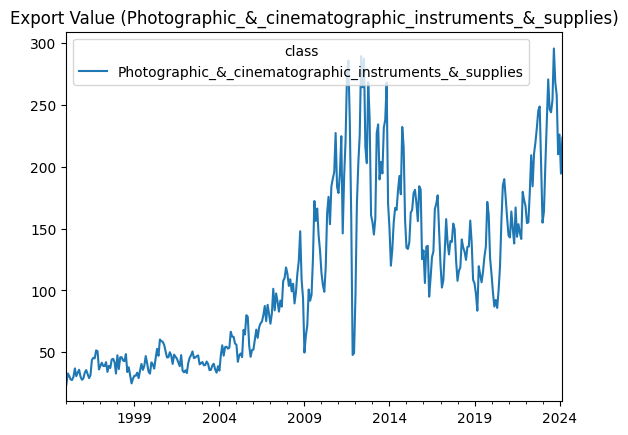

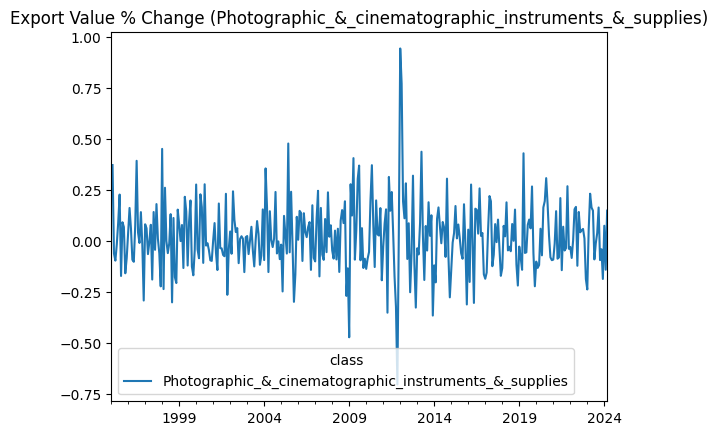

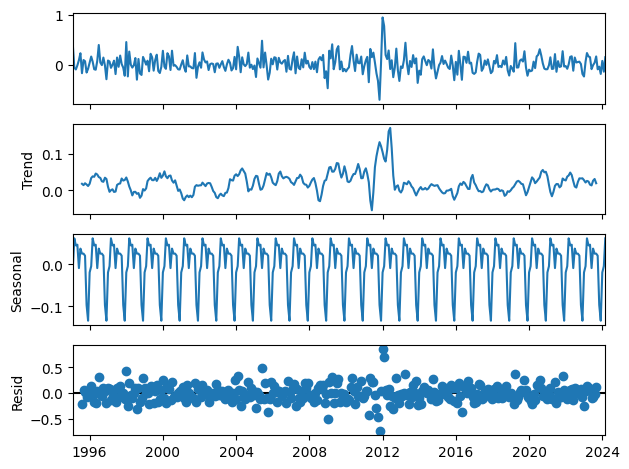


Plotting Residuals for Homoscedasticity Check...


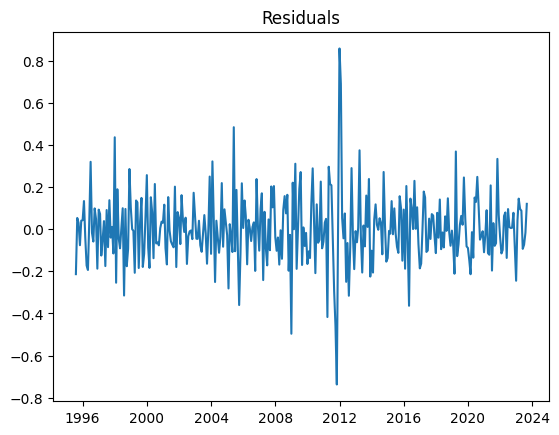

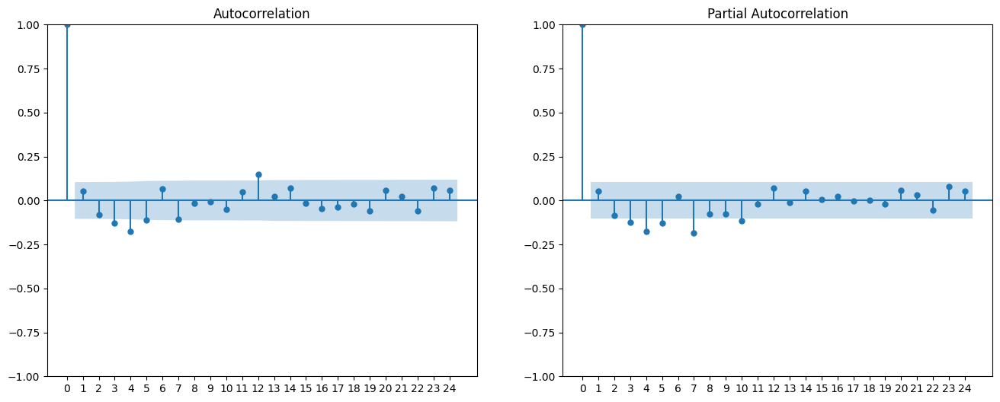


Time series assumptions are met.


True

'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -12.002703748305692
p-value: 3.3179957880425834e-22
Critical Value 1%: -3.450695263332383
Critical Value 5%: -2.87050218926466
Critical Value 10%: -2.5715449066453284
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.10020457897846362
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


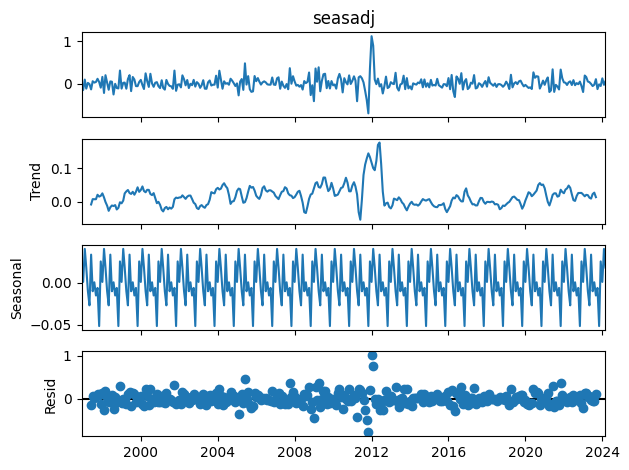


Plotting Residuals for Homoscedasticity Check...


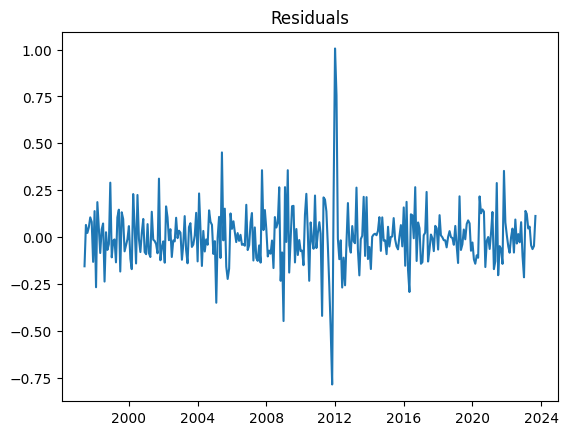

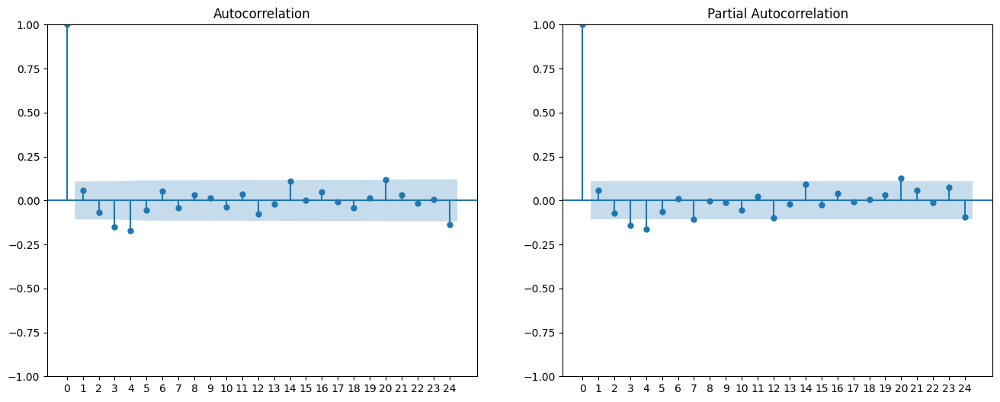


Time series assumptions are met.


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Data of Actual vs Forecasted values with error metrics:'

Photographic_&_cinematographic_instruments_&_supplies,actual,forecast,error,abs_error,squared_error,abs_percentage_error
2011-12-01,0.359001,0.069880,0.289122,0.289122,0.083591,0.805350
2012-01-01,1.123780,-0.054937,1.178717,1.178717,1.389374,1.048886
2012-02-01,0.897644,0.038666,0.858977,0.858977,0.737842,0.956925
2012-03-01,0.103778,-0.114810,0.218588,0.218588,0.047781,2.106296
2012-04-01,-0.006821,-0.592559,0.585738,0.585738,0.343089,85.873403
...,...,...,...,...,...,...
2023-12-01,-0.049701,0.014464,-0.064165,0.064165,0.004117,1.291014
2024-01-01,0.130163,0.035688,0.094475,0.094475,0.008926,0.725819
2024-02-01,-0.022415,0.022100,-0.044515,0.044515,0.001982,1.985931
2024-03-01,0.060068,0.021142,0.038926,0.038926,0.001515,0.648037


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Total Mean Absolute Error (Per Forecast): 0.11566691315482246'

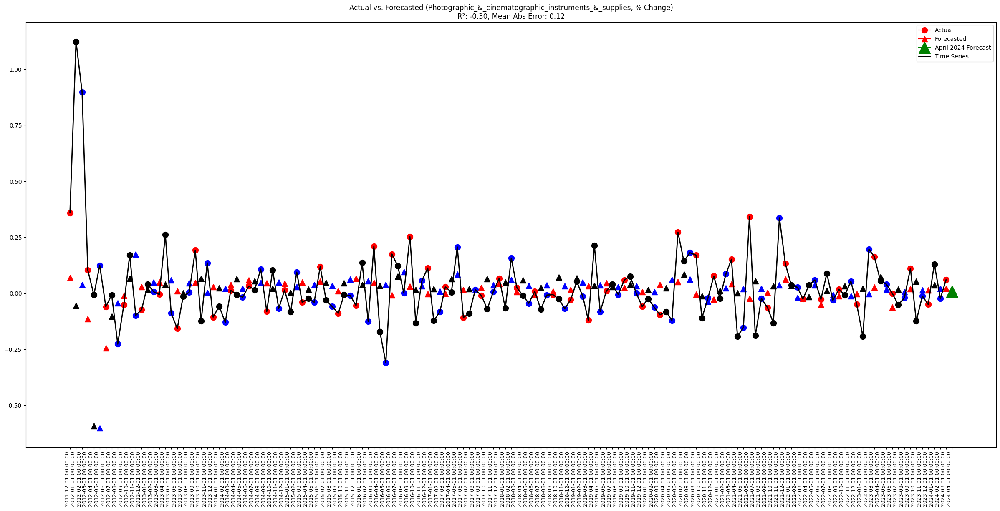

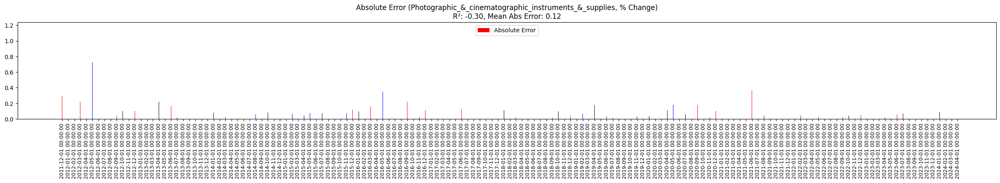

In [74]:
df = df_export_ANALYSIS[[name]]

df.plot(title=f"Export Value ({name})", label=f"{name}")
df.pct_change().plot(title=f"Export Value % Change ({name})", label=f"{name} % Change")
ts = df.pct_change().dropna()
display("Timeseries of component in % form:")
display(ts)
display("-" * 150)

### check if the data timeseries & statistical assumptions validity (stationary, seasonality, autocorrelation)
#freq 12 is used since the data is monthly, so the seasonality is 12 months YoY
display("Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):")
display(check_time_series_assumptions(ts, freq=12))
display("-" * 150)

#read the pickle file
with open(f'data/cleaned/deseasonalised_x13/update/dict_deseasonalized_value_{name}.pickle', 'rb') as handle:
    dict_deseasonalized_value = pickle.load(handle)[name]
adj_ts = dict_deseasonalized_value['seasadj'].pct_change().dropna()
display("Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):")
check_time_series_assumptions(adj_ts, freq=12)
display("-" * 150)

df_accuracy = pd.read_pickle(f"data/cleaned/SARIMA_RollWalkForward/combined/updated/accuracy/df_accuracy_{name}.pickle")
df_accuracy.columns.name = name
#Forecast are all Out-Of-Sample on a rolling basis
display("Data of Actual vs Forecasted values with error metrics:")
display(df_accuracy)
display("-" * 150)

#Plot Actual vs Forecasted values with error metrics
average_abs_error = df_accuracy["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_accuracy, name)


## Medicinal_and_surgical_equipment_and_supplies

In [75]:
df = df_export_ANALYSIS.copy()
name = df.columns[30]
display(f"Component: {name}")

'Component: Medicinal_and_surgical_equipment_and_supplies'

'Timeseries of component in % form:'

class,Medicinal_and_surgical_equipment_and_supplies
1995-02-01,-0.065259
1995-03-01,0.124743
1995-04-01,-0.217252
1995-05-01,0.287464
1995-06-01,0.009058
...,...
2023-11-01,-0.021785
2023-12-01,-0.007343
2024-01-01,0.109326
2024-02-01,-0.051489


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -6.422414374457231
p-value: 1.778066905345242e-08
Critical Value 1%: -3.449846029628477
Critical Value 5%: -2.870129281376164
Critical Value 10%: -2.5713460670144603
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.1650885778322806
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


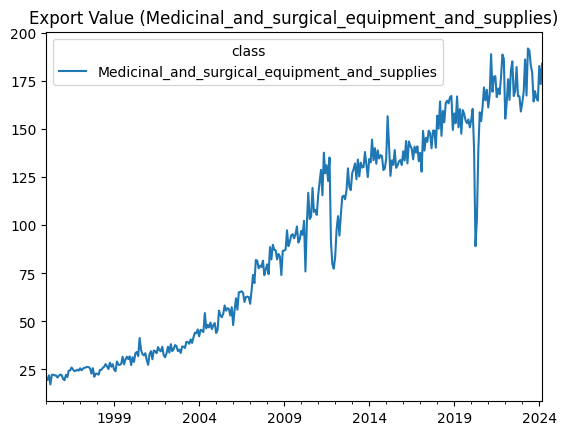

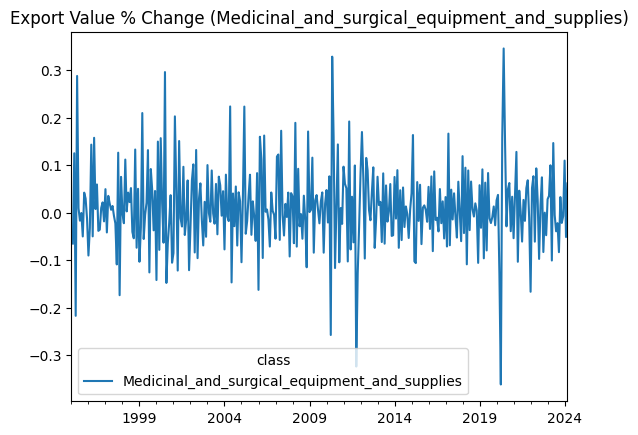

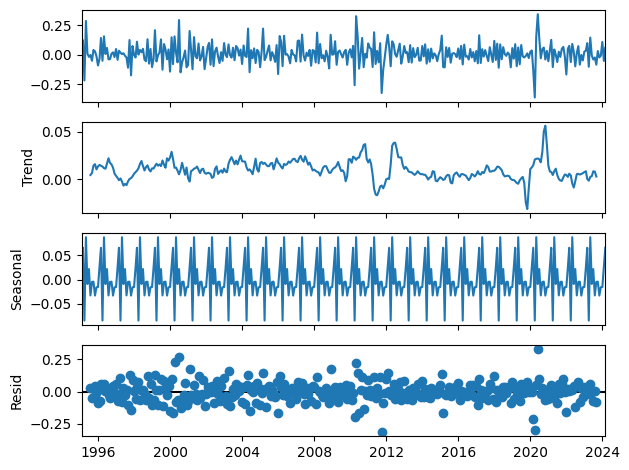


Plotting Residuals for Homoscedasticity Check...


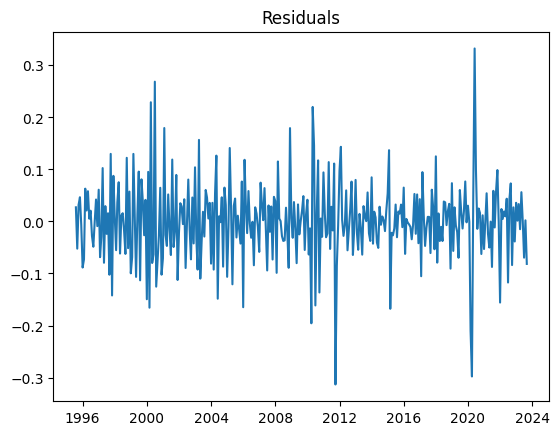

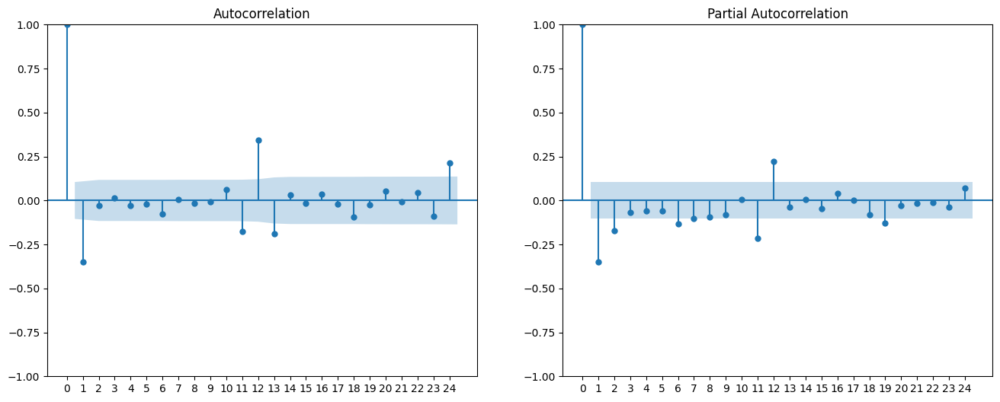


Time series assumptions are met.


True

'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -11.065529070163342
p-value: 4.692168020413442e-20
Critical Value 1%: -3.4494474563375737
Critical Value 5%: -2.8699542285903887
Critical Value 10%: -2.5712527305187987
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.1651244245198311
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


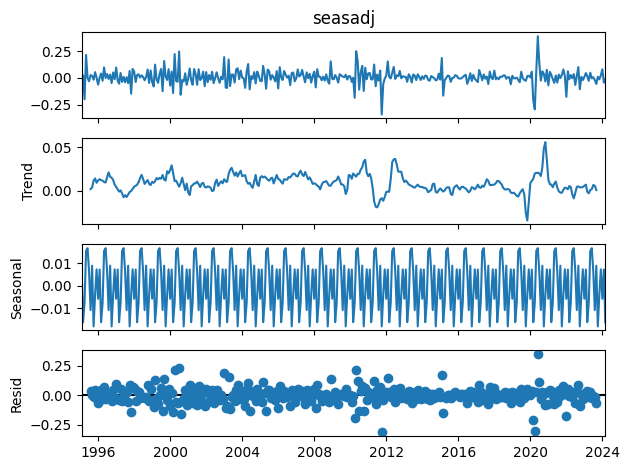


Plotting Residuals for Homoscedasticity Check...


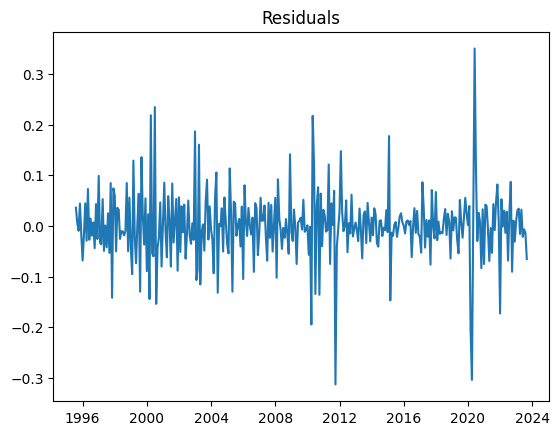

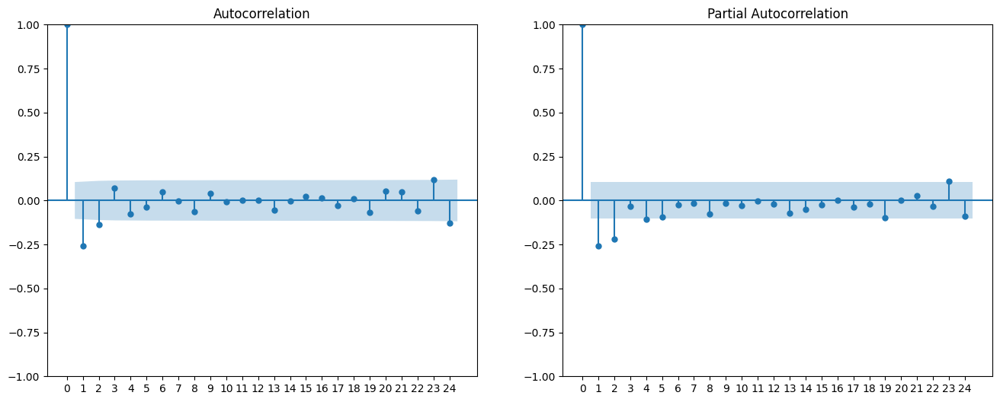


Time series assumptions are met.


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Data of Actual vs Forecasted values with error metrics:'

Medicinal_and_surgical_equipment_and_supplies,actual,forecast,error,abs_error,squared_error,abs_percentage_error
2010-02-01,-0.035700,0.016194,-0.051894,0.051894,0.002693,1.453606
2010-03-01,0.002127,0.037635,-0.035508,0.035508,0.001261,16.693483
2010-04-01,-0.184225,0.032988,-0.217213,0.217213,0.047182,1.179066
2010-05-01,0.249380,0.133704,0.115675,0.115675,0.013381,0.463852
2010-06-01,0.156345,-0.075854,0.232199,0.232199,0.053916,1.485170
...,...,...,...,...,...,...
2023-12-01,0.023525,0.032437,-0.008912,0.008912,0.000079,0.378844
2024-01-01,0.080564,0.021761,0.058803,0.058803,0.003458,0.729892
2024-02-01,-0.043753,-0.005171,-0.038582,0.038582,0.001489,0.881807
2024-03-01,-0.012377,0.015508,-0.027885,0.027885,0.000778,2.253044


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Total Mean Absolute Error (Per Forecast): 0.04694400516737986'

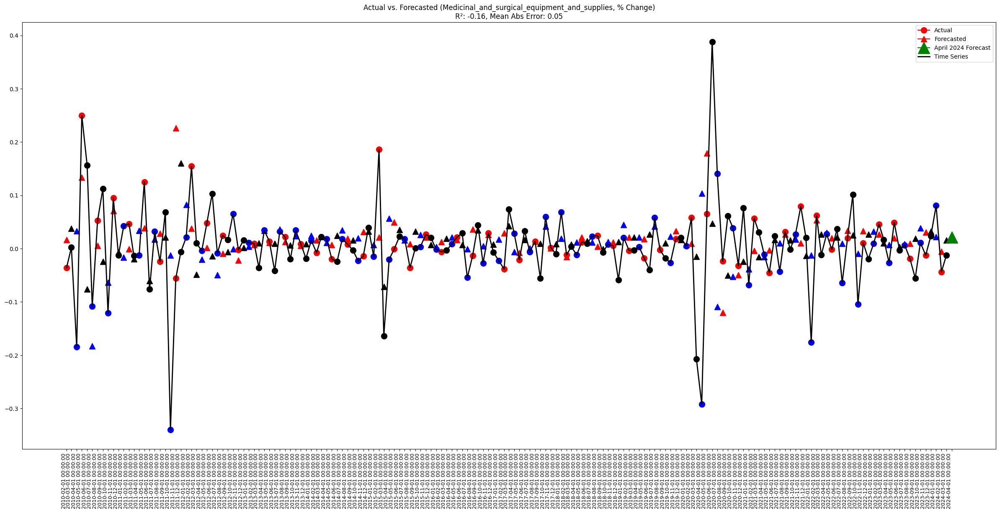

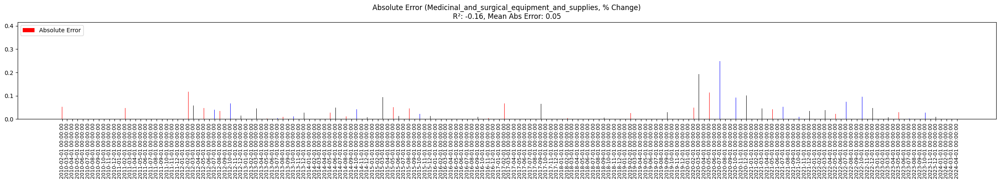

In [76]:
df = df_export_ANALYSIS[[name]]

df.plot(title=f"Export Value ({name})", label=f"{name}")
df.pct_change().plot(title=f"Export Value % Change ({name})", label=f"{name} % Change")
ts = df.pct_change().dropna()
display("Timeseries of component in % form:")
display(ts)
display("-" * 150)

### check if the data timeseries & statistical assumptions validity (stationary, seasonality, autocorrelation)
#freq 12 is used since the data is monthly, so the seasonality is 12 months YoY
display("Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):")
display(check_time_series_assumptions(ts, freq=12))
display("-" * 150)

#read the pickle file
with open(f'data/cleaned/deseasonalised_x13/update/dict_deseasonalized_value_{name}.pickle', 'rb') as handle:
    dict_deseasonalized_value = pickle.load(handle)[name]
adj_ts = dict_deseasonalized_value['seasadj'].pct_change().dropna()
display("Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):")
check_time_series_assumptions(adj_ts, freq=12)
display("-" * 150)

df_accuracy = pd.read_pickle(f"data/cleaned/SARIMA_RollWalkForward/combined/updated/accuracy/df_accuracy_{name}.pickle")
df_accuracy.columns.name = name
#Forecast are all Out-Of-Sample on a rolling basis
display("Data of Actual vs Forecasted values with error metrics:")
display(df_accuracy)
display("-" * 150)

#Plot Actual vs Forecasted values with error metrics
average_abs_error = df_accuracy["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_accuracy, name)


## Toiletries_and_cosmetics

In [77]:
df = df_export_ANALYSIS.copy()
name = df.columns[31]
display(f"Component: {name}")

'Component: Toiletries_and_cosmetics'

'Timeseries of component in % form:'

class,Toiletries_and_cosmetics
1995-02-01,0.067757
1995-03-01,0.571116
1995-04-01,-0.245822
1995-05-01,0.076639
1995-06-01,0.055746
...,...
2023-11-01,0.025501
2023-12-01,-0.011259
2024-01-01,0.017130
2024-02-01,0.036279


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -24.040223456792255
p-value: 0.0
Critical Value 1%: -3.449226932880019
Critical Value 5%: -2.869857365438656
Critical Value 10%: -2.571201085130664
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.14248430654400962
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


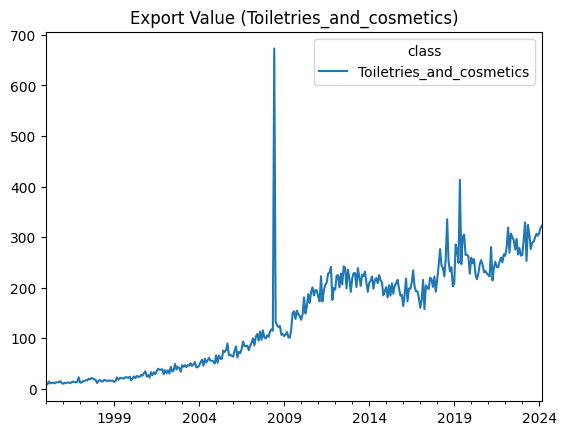

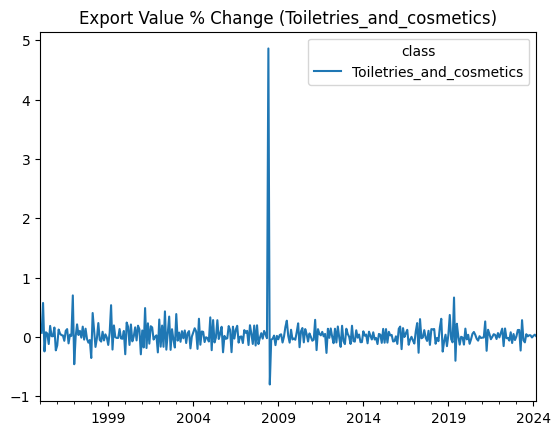

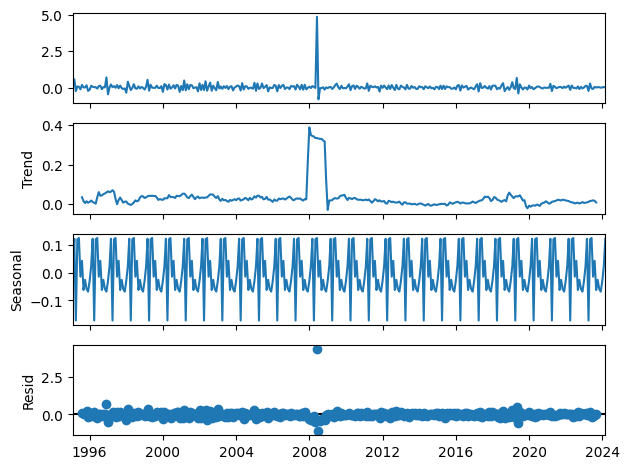


Plotting Residuals for Homoscedasticity Check...


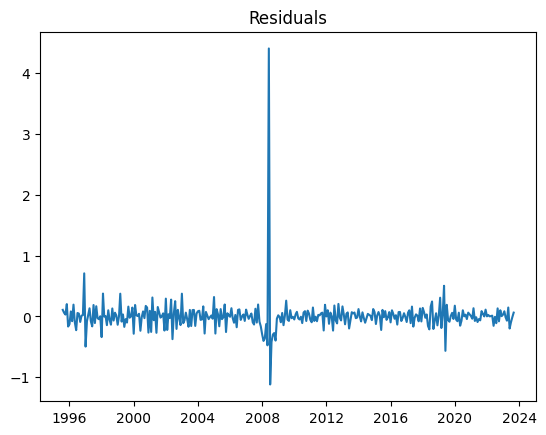

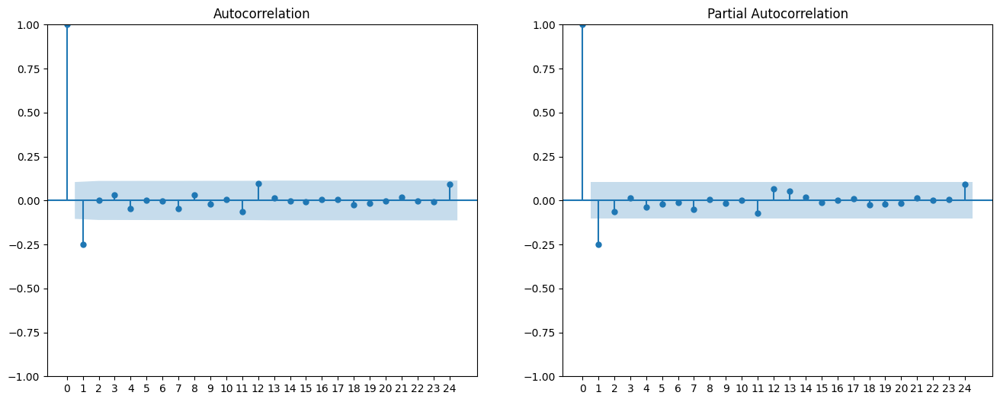


Time series assumptions are met.


True

'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -23.888194878927028
p-value: 0.0
Critical Value 1%: -3.449226932880019
Critical Value 5%: -2.869857365438656
Critical Value 10%: -2.571201085130664
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.14286465702875714
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


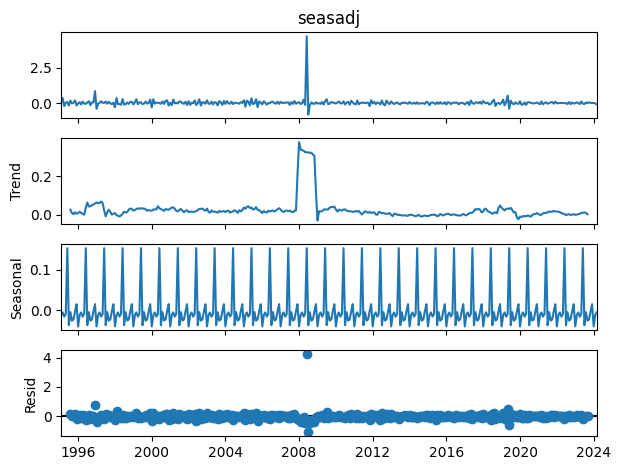


Plotting Residuals for Homoscedasticity Check...


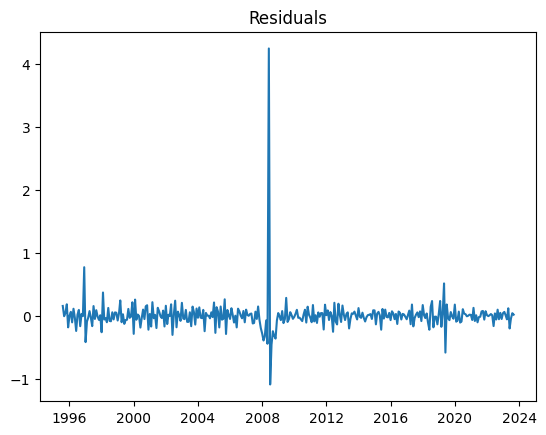

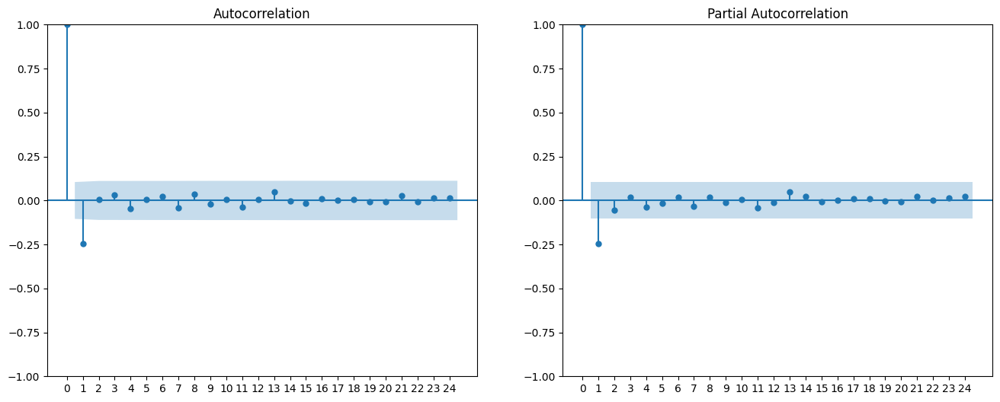


Time series assumptions are met.


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Data of Actual vs Forecasted values with error metrics:'

Toiletries_and_cosmetics,actual,forecast,error,abs_error,squared_error,abs_percentage_error
2010-02-01,0.042508,0.064736,-0.022228,0.022228,0.000494,0.522901
2010-03-01,0.117423,0.050245,0.067178,0.067178,0.004513,0.572105
2010-04-01,-0.021967,0.028634,-0.050602,0.050602,0.002561,2.303502
2010-05-01,-0.016491,0.057271,-0.073762,0.073762,0.005441,4.472953
2010-06-01,0.124996,0.062635,0.062361,0.062361,0.003889,0.498906
...,...,...,...,...,...,...
2023-12-01,0.011681,0.027950,-0.016269,0.016269,0.000265,1.392714
2024-01-01,0.014604,0.031651,-0.017046,0.017046,0.000291,1.167212
2024-02-01,-0.023743,0.031810,-0.055553,0.055553,0.003086,2.339791
2024-03-01,-0.078751,0.041393,-0.120144,0.120144,0.014435,1.525622


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Total Mean Absolute Error (Per Forecast): 0.06687355062851026'

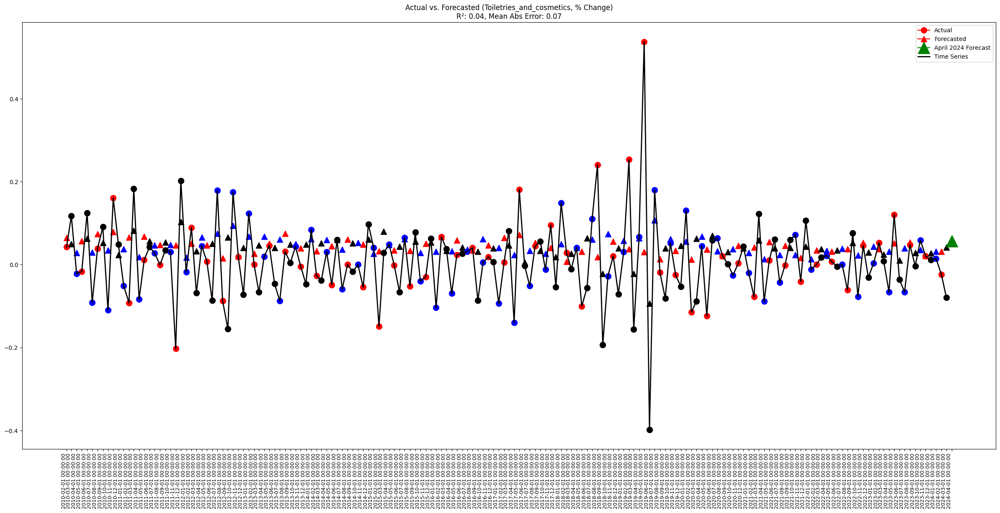

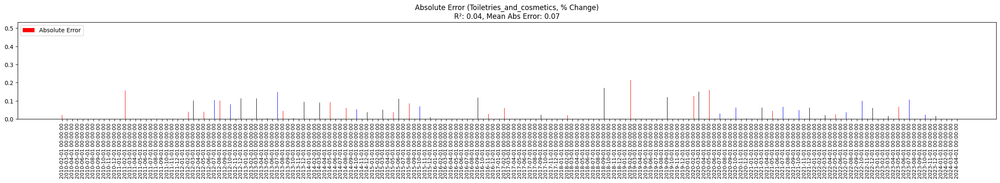

In [78]:
df = df_export_ANALYSIS[[name]]

df.plot(title=f"Export Value ({name})", label=f"{name}")
df.pct_change().plot(title=f"Export Value % Change ({name})", label=f"{name} % Change")
ts = df.pct_change().dropna()
display("Timeseries of component in % form:")
display(ts)
display("-" * 150)

### check if the data timeseries & statistical assumptions validity (stationary, seasonality, autocorrelation)
#freq 12 is used since the data is monthly, so the seasonality is 12 months YoY
display("Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):")
display(check_time_series_assumptions(ts, freq=12))
display("-" * 150)

#read the pickle file
with open(f'data/cleaned/deseasonalised_x13/update/dict_deseasonalized_value_{name}.pickle', 'rb') as handle:
    dict_deseasonalized_value = pickle.load(handle)[name]
adj_ts = dict_deseasonalized_value['seasadj'].pct_change().dropna()
display("Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):")
check_time_series_assumptions(adj_ts, freq=12)
display("-" * 150)

df_accuracy = pd.read_pickle(f"data/cleaned/SARIMA_RollWalkForward/combined/updated/accuracy/df_accuracy_{name}.pickle")
df_accuracy.columns.name = name
#Forecast are all Out-Of-Sample on a rolling basis
display("Data of Actual vs Forecasted values with error metrics:")
display(df_accuracy)
display("-" * 150)

#Plot Actual vs Forecasted values with error metrics
average_abs_error = df_accuracy["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_accuracy, name)


## Furniture_and_parts

In [79]:
df = df_export_ANALYSIS.copy()
name = df.columns[32]
display(f"Component: {name}")

'Component: Furniture_and_parts'

'Timeseries of component in % form:'

class,Furniture_and_parts
1995-02-01,-0.069798
1995-03-01,0.316330
1995-04-01,-0.276418
1995-05-01,0.267410
1995-06-01,0.041534
...,...
2023-11-01,0.073885
2023-12-01,-0.050655
2024-01-01,-0.125461
2024-02-01,0.068776


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -6.212313976989752
p-value: 5.4699252243022124e-08
Critical Value 1%: -3.449846029628477
Critical Value 5%: -2.870129281376164
Critical Value 10%: -2.5713460670144603
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.01954624829859106
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


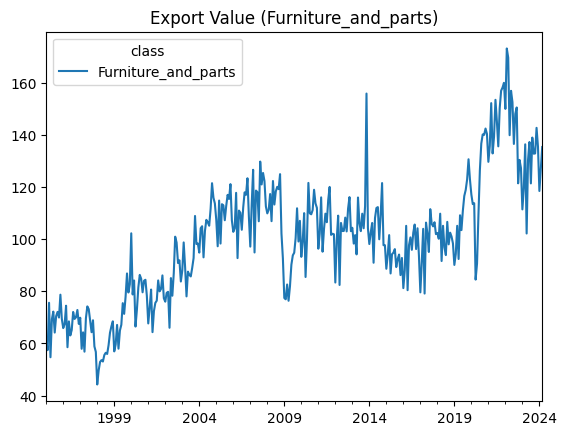

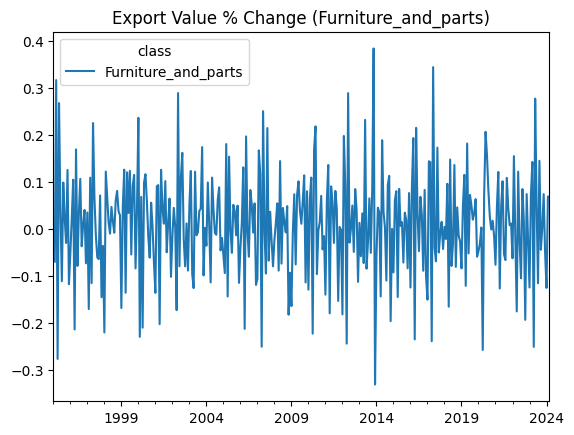

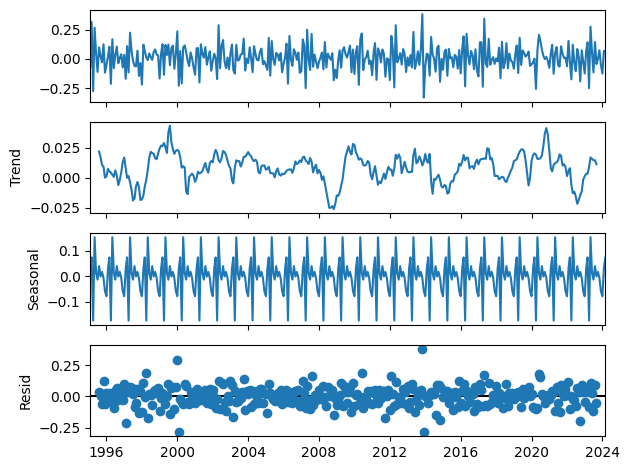


Plotting Residuals for Homoscedasticity Check...


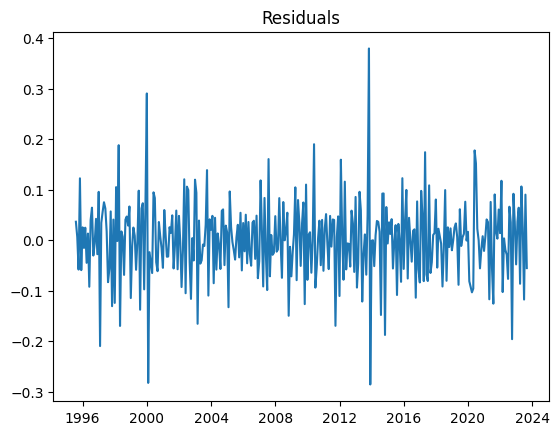

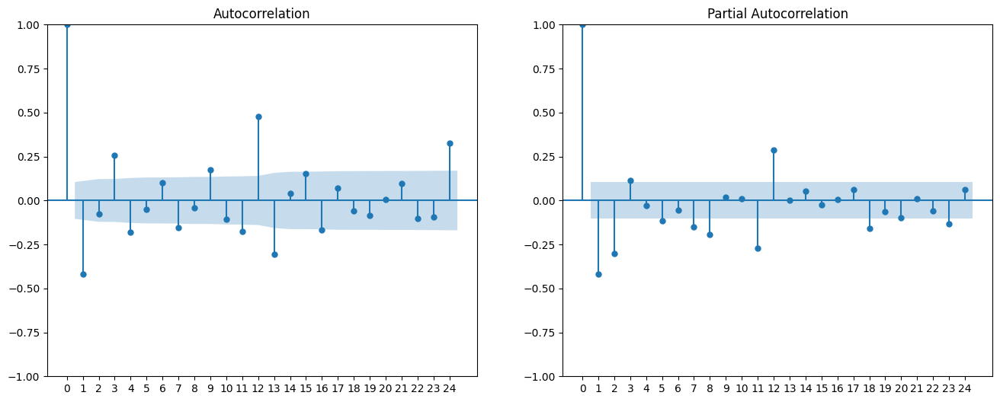


Time series assumptions are met.


True

'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -4.956342948092415
p-value: 2.705908239158204e-05
Critical Value 1%: -3.450141065277327
Critical Value 5%: -2.870258846235788
Critical Value 10%: -2.571415151457764
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.025334961231282756
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


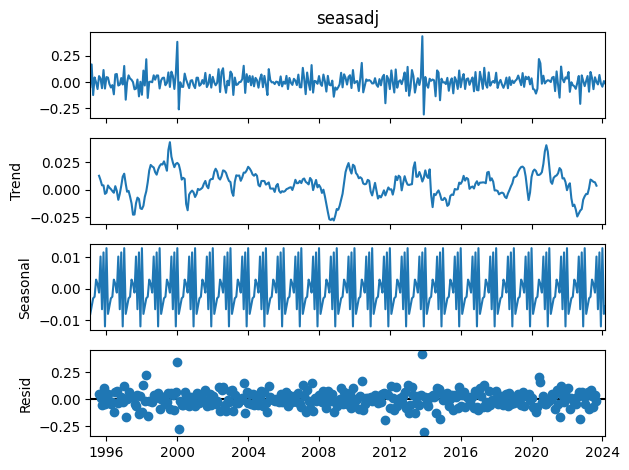


Plotting Residuals for Homoscedasticity Check...


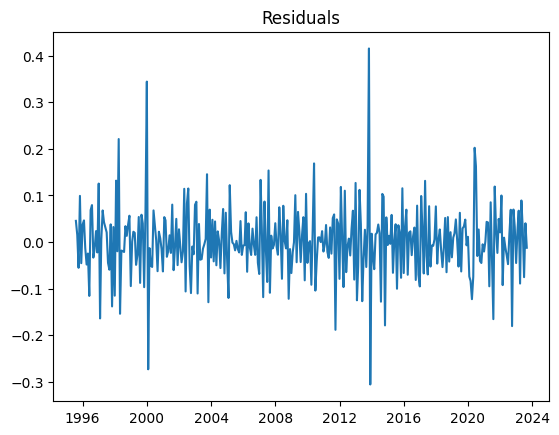

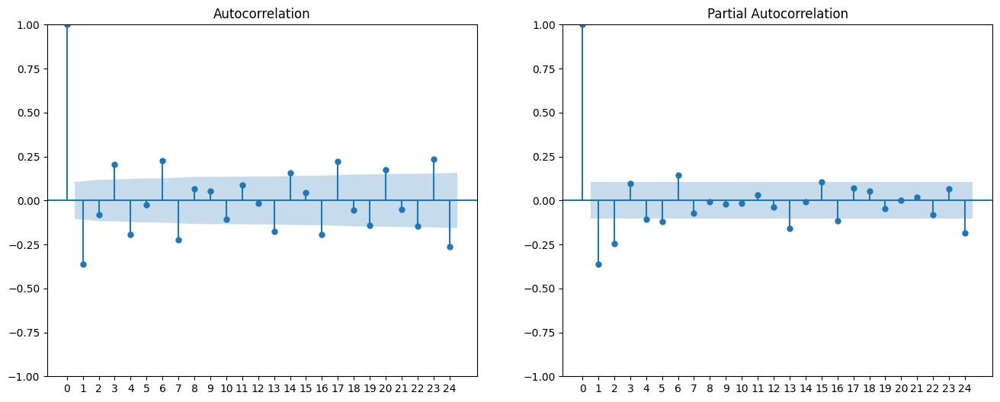


Time series assumptions are met.


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Data of Actual vs Forecasted values with error metrics:'

Furniture_and_parts,actual,forecast,error,abs_error,squared_error,abs_percentage_error
2010-02-01,0.004458,0.006113,-0.001654,0.001654,0.000003,0.371099
2010-03-01,0.009731,0.021423,-0.011692,0.011692,0.000137,1.201523
2010-04-01,-0.084678,-0.018039,-0.066639,0.066639,0.004441,0.786967
2010-05-01,0.035323,0.023379,0.011945,0.011945,0.000143,0.338150
2010-06-01,0.181589,0.027996,0.153593,0.153593,0.023591,0.845829
...,...,...,...,...,...,...
2023-12-01,-0.013130,-0.035898,0.022768,0.022768,0.000518,1.733977
2024-01-01,-0.043846,-0.017129,-0.026717,0.026717,0.000714,0.609330
2024-02-01,0.009530,0.037567,-0.028037,0.028037,0.000786,2.942091
2024-03-01,-0.013875,0.010647,-0.024522,0.024522,0.000601,1.767318


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Total Mean Absolute Error (Per Forecast): 0.048747833904651615'

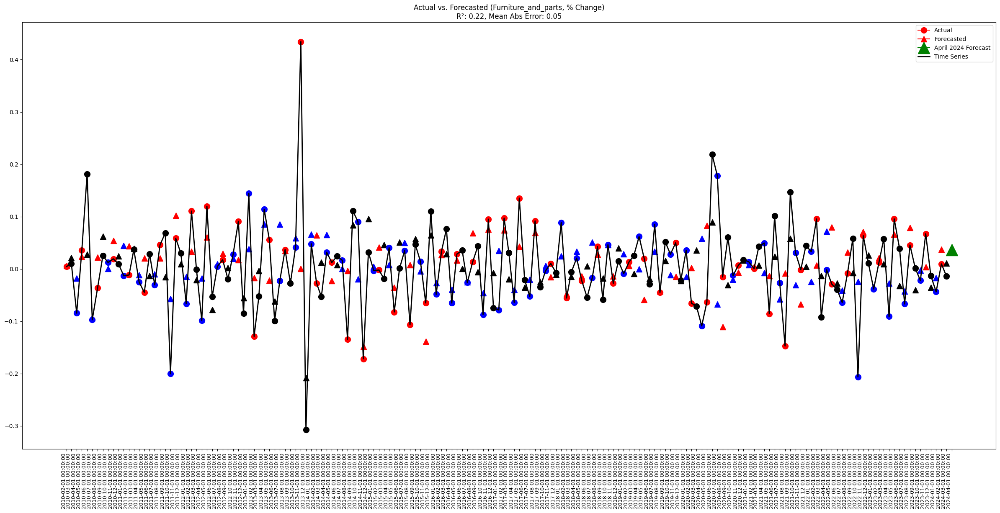

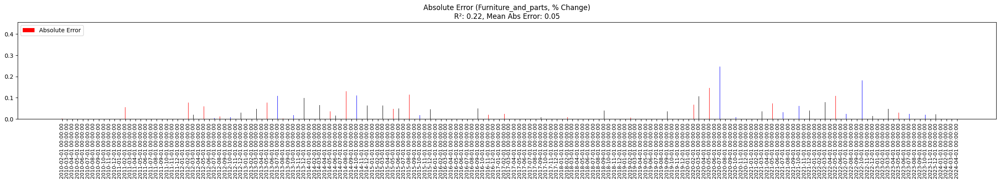

In [80]:
df = df_export_ANALYSIS[[name]]

df.plot(title=f"Export Value ({name})", label=f"{name}")
df.pct_change().plot(title=f"Export Value % Change ({name})", label=f"{name} % Change")
ts = df.pct_change().dropna()
display("Timeseries of component in % form:")
display(ts)
display("-" * 150)

### check if the data timeseries & statistical assumptions validity (stationary, seasonality, autocorrelation)
#freq 12 is used since the data is monthly, so the seasonality is 12 months YoY
display("Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):")
display(check_time_series_assumptions(ts, freq=12))
display("-" * 150)

#read the pickle file
with open(f'data/cleaned/deseasonalised_x13/update/dict_deseasonalized_value_{name}.pickle', 'rb') as handle:
    dict_deseasonalized_value = pickle.load(handle)[name]
adj_ts = dict_deseasonalized_value['seasadj'].pct_change().dropna()
display("Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):")
check_time_series_assumptions(adj_ts, freq=12)
display("-" * 150)

df_accuracy = pd.read_pickle(f"data/cleaned/SARIMA_RollWalkForward/combined/updated/accuracy/df_accuracy_{name}.pickle")
df_accuracy.columns.name = name
#Forecast are all Out-Of-Sample on a rolling basis
display("Data of Actual vs Forecasted values with error metrics:")
display(df_accuracy)
display("-" * 150)

#Plot Actual vs Forecasted values with error metrics
average_abs_error = df_accuracy["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_accuracy, name)


## Other_Manufacturing_products

In [81]:
df = df_export_ANALYSIS.copy()
name = df.columns[33]
display(f"Component: {name}")

'Component: Other_Manufacturing_products'

'Timeseries of component in % form:'

class,Other_Manufacturing_products
1995-02-01,0.007269
1995-03-01,0.336890
1995-04-01,-0.282515
1995-05-01,0.292957
1995-06-01,0.140076
...,...
2023-11-01,-0.004233
2023-12-01,-0.059999
2024-01-01,-0.041570
2024-02-01,0.075350


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -5.907699394769142
p-value: 2.684227855477888e-07
Critical Value 1%: -3.449846029628477
Critical Value 5%: -2.870129281376164
Critical Value 10%: -2.5713460670144603
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.019179652565776997
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


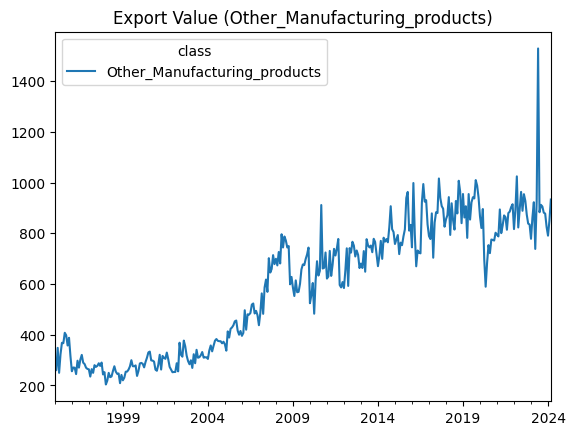

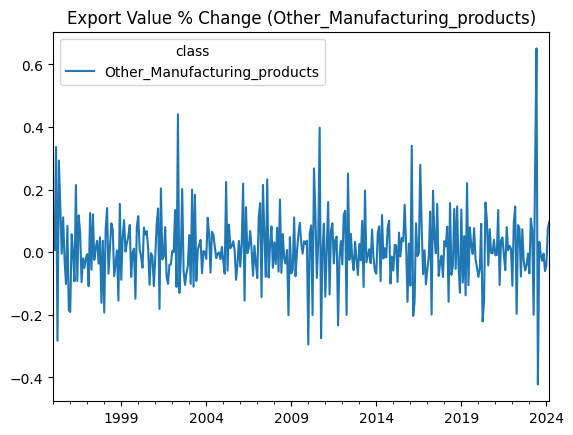

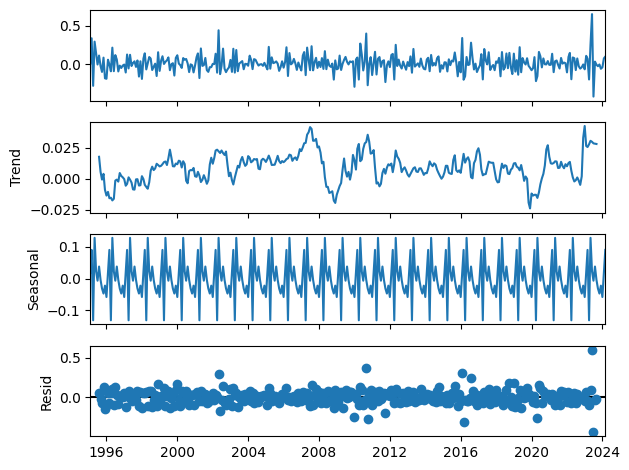


Plotting Residuals for Homoscedasticity Check...


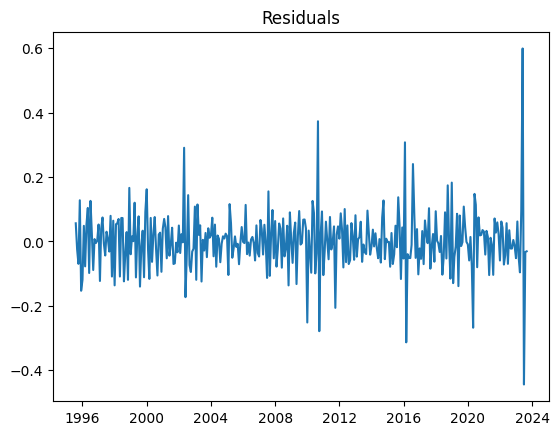

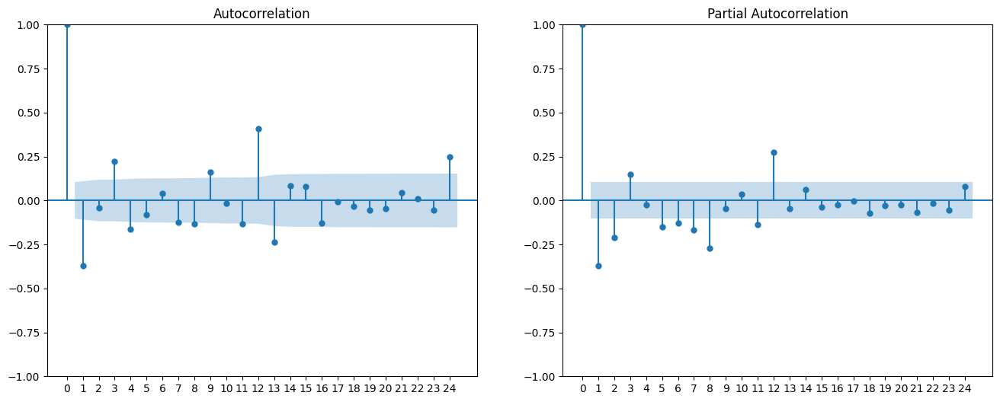


Time series assumptions are met.


True

'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -20.9510003211164
p-value: 0.0
Critical Value 1%: -3.4492815848836296
Critical Value 5%: -2.8698813715275406
Critical Value 10%: -2.5712138845950587
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.024312346586279135
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


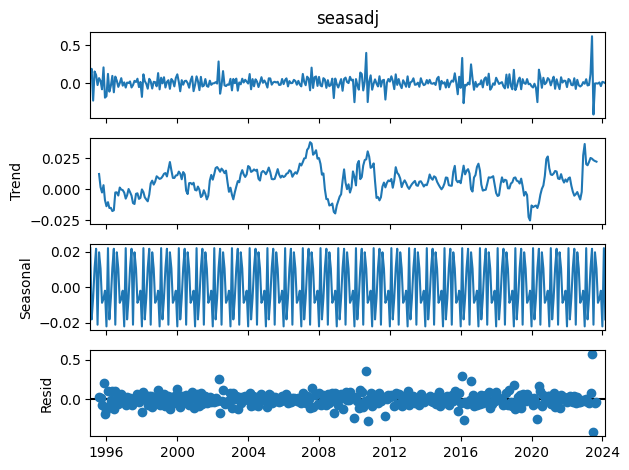


Plotting Residuals for Homoscedasticity Check...


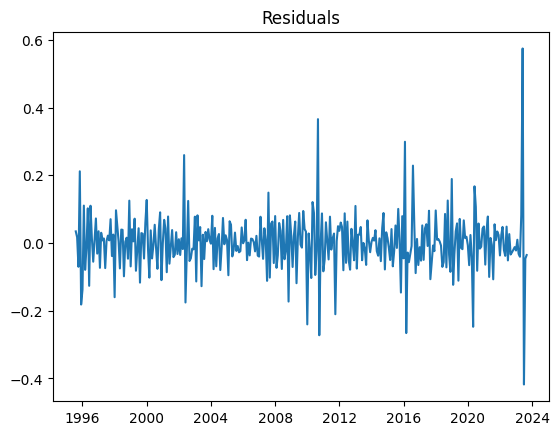

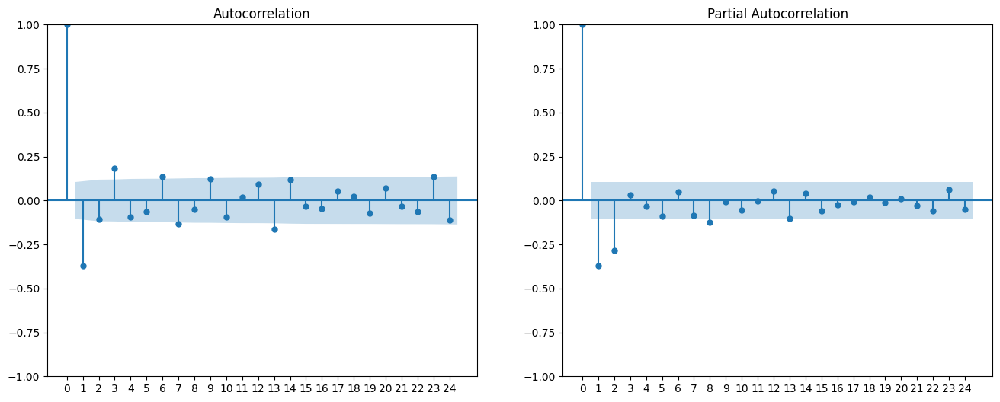


Time series assumptions are met.


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Data of Actual vs Forecasted values with error metrics:'

Other_Manufacturing_products,actual,forecast,error,abs_error,squared_error,abs_percentage_error
2010-02-01,0.053193,0.135239,-0.082046,0.082046,6.731513e-03,1.542406
2010-03-01,-0.022773,0.055580,-0.078353,0.078353,6.139172e-03,3.440591
2010-04-01,-0.086872,-0.020352,-0.066520,0.066520,4.424905e-03,0.765725
2010-05-01,0.139705,0.019072,0.120633,0.120633,1.455242e-02,0.863484
2010-06-01,0.120194,-0.028040,0.148234,0.148234,2.197323e-02,1.233285
...,...,...,...,...,...,...
2023-12-01,-0.039889,0.004855,-0.044744,0.044744,2.001995e-03,1.121703
2024-01-01,0.016909,0.034271,-0.017362,0.017362,3.014247e-04,1.026766
2024-02-01,0.009855,0.015986,-0.006131,0.006131,3.758524e-05,0.622094
2024-03-01,-0.001325,-0.002076,0.000751,0.000751,5.645446e-07,0.567069


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Total Mean Absolute Error (Per Forecast): 0.057222612566236945'

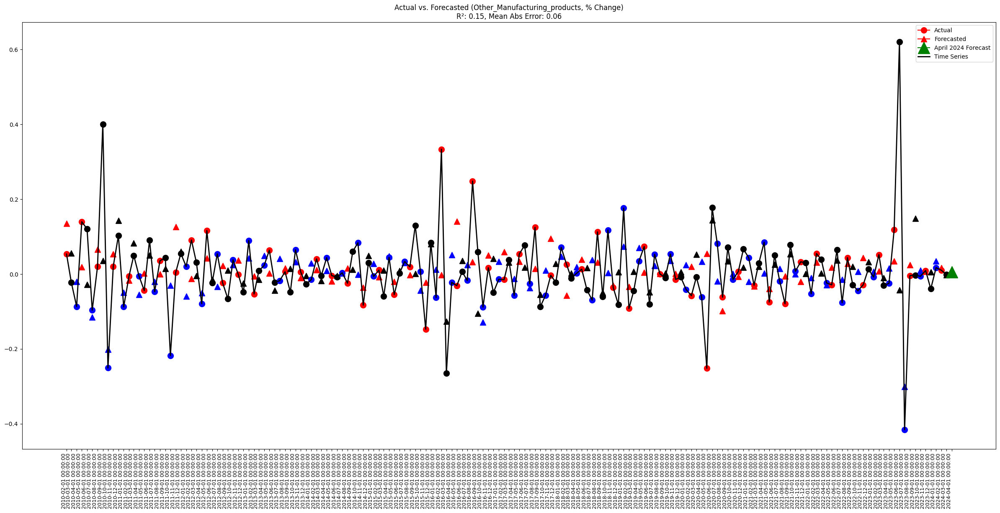

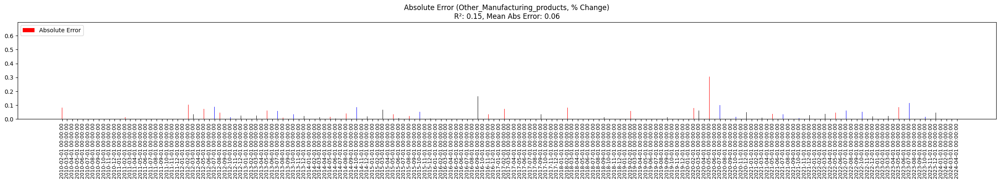

In [82]:
df = df_export_ANALYSIS[[name]]

df.plot(title=f"Export Value ({name})", label=f"{name}")
df.pct_change().plot(title=f"Export Value % Change ({name})", label=f"{name} % Change")
ts = df.pct_change().dropna()
display("Timeseries of component in % form:")
display(ts)
display("-" * 150)

### check if the data timeseries & statistical assumptions validity (stationary, seasonality, autocorrelation)
#freq 12 is used since the data is monthly, so the seasonality is 12 months YoY
display("Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):")
display(check_time_series_assumptions(ts, freq=12))
display("-" * 150)

#read the pickle file
with open(f'data/cleaned/deseasonalised_x13/update/dict_deseasonalized_value_{name}.pickle', 'rb') as handle:
    dict_deseasonalized_value = pickle.load(handle)[name]
adj_ts = dict_deseasonalized_value['seasadj'].pct_change().dropna()
display("Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):")
check_time_series_assumptions(adj_ts, freq=12)
display("-" * 150)

df_accuracy = pd.read_pickle(f"data/cleaned/SARIMA_RollWalkForward/combined/updated/accuracy/df_accuracy_{name}.pickle")
df_accuracy.columns.name = name
#Forecast are all Out-Of-Sample on a rolling basis
display("Data of Actual vs Forecasted values with error metrics:")
display(df_accuracy)
display("-" * 150)

#Plot Actual vs Forecasted values with error metrics
average_abs_error = df_accuracy["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_accuracy, name)


## Other_Exports

In [83]:
df = df_export_ANALYSIS.copy()
name = df.columns[34]
display(f"Component: {name}")

'Component: Other_Exports'

'Timeseries of component in % form:'

class,Other_Exports
1995-02-01,-0.196895
1995-03-01,0.644483
1995-04-01,-0.353816
1995-05-01,0.433571
1995-06-01,-0.200128
...,...
2023-11-01,-0.686372
2023-12-01,0.705487
2024-01-01,0.087158
2024-02-01,0.562042


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -13.401065447200093
p-value: 4.565275274095409e-25
Critical Value 1%: -3.449336554273722
Critical Value 5%: -2.8699055166063085
Critical Value 10%: -2.571226758215748
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.7424604725450522
p-value: 0.01
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: False

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  result = kpss(series, regression='c')


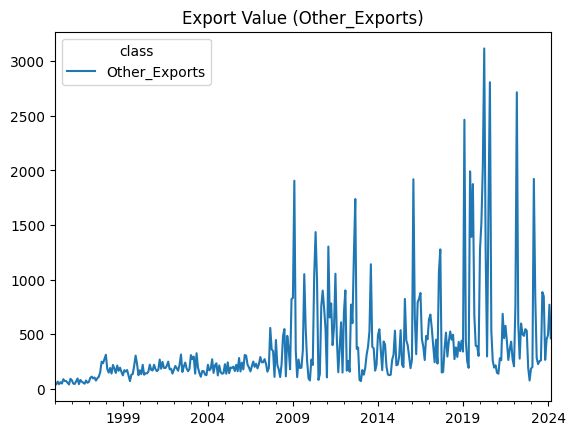

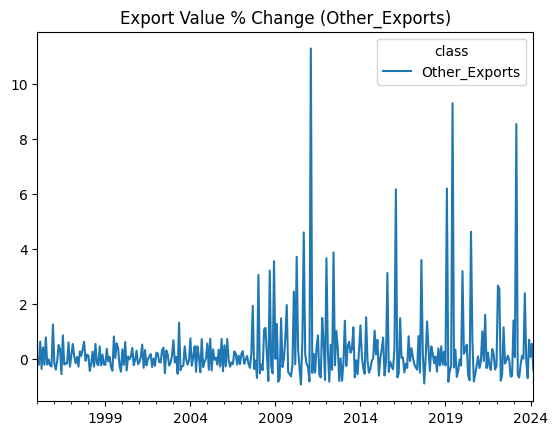

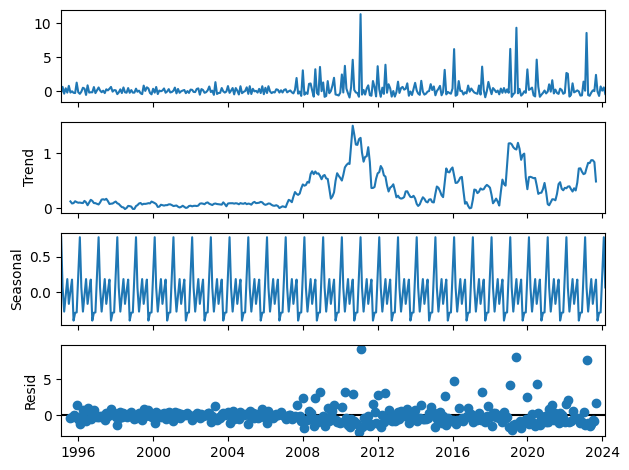


Plotting Residuals for Homoscedasticity Check...


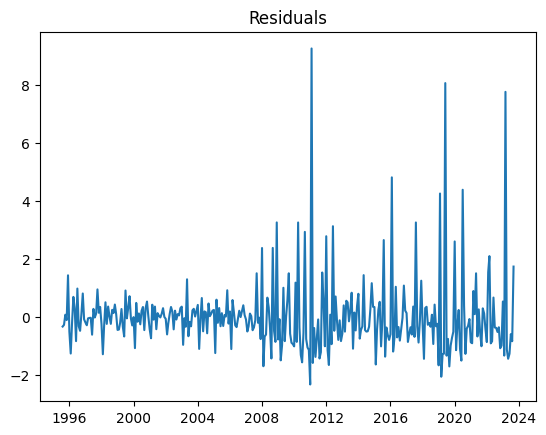

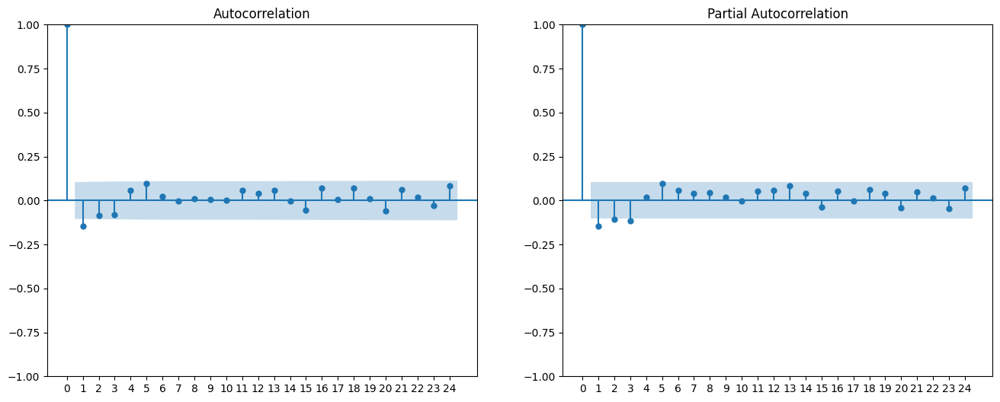


Time series assumptions are not met. Further investigation needed.


False

'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -13.48290223972115
p-value: 3.215333330380634e-25
Critical Value 1%: -3.449336554273722
Critical Value 5%: -2.8699055166063085
Critical Value 10%: -2.571226758215748
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.7371503022645324
p-value: 0.010168154339587966
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: False

Decomposing the Series...


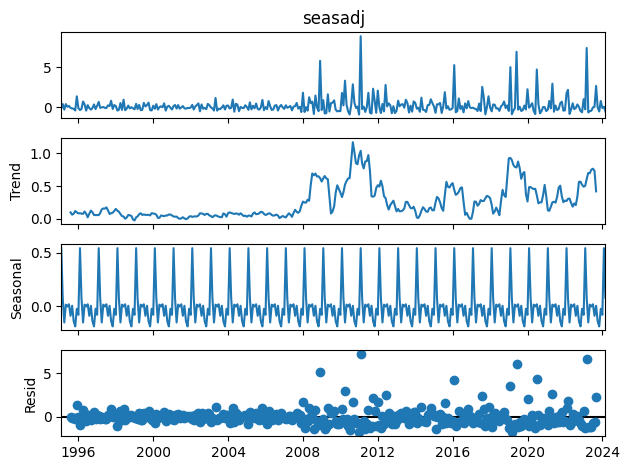


Plotting Residuals for Homoscedasticity Check...


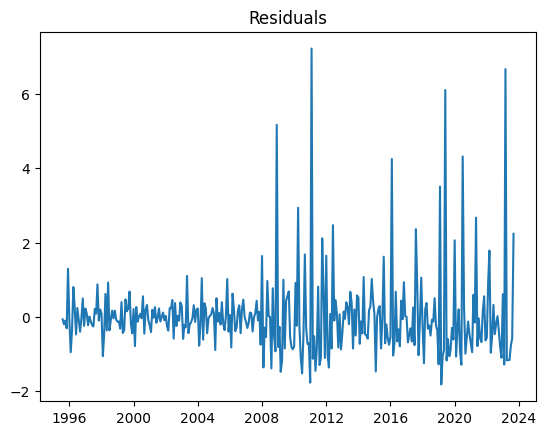

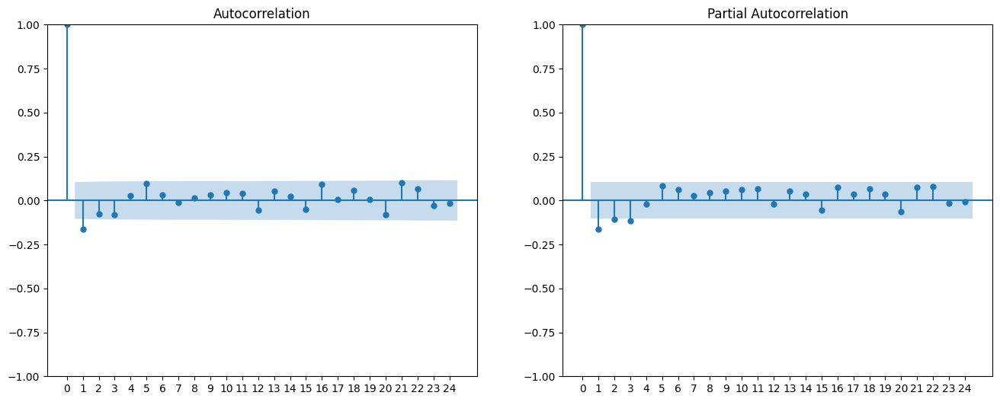


Time series assumptions are not met. Further investigation needed.


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Data of Actual vs Forecasted values with error metrics:'

Other_Exports,actual,forecast,error,abs_error,squared_error,abs_percentage_error
2010-02-01,1.791389,0.240574,1.550814,1.550814,2.405025,0.865705
2010-03-01,0.250659,0.056105,0.194554,0.194554,0.037851,0.776168
2010-04-01,3.309913,0.567173,2.742740,2.742740,7.522622,0.828644
2010-05-01,0.326369,-1.018965,1.345334,1.345334,1.809923,4.122128
2010-06-01,-0.495064,0.552673,-1.047737,1.047737,1.097754,2.116367
...,...,...,...,...,...,...
2023-12-01,0.798963,0.362539,0.436423,0.436423,0.190465,0.546237
2024-01-01,-0.072353,0.590413,-0.662765,0.662765,0.439258,9.160218
2024-02-01,0.077346,0.720935,-0.643589,0.643589,0.414206,8.320876
2024-03-01,-0.478766,0.519218,-0.997984,0.997984,0.995972,2.084493


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Total Mean Absolute Error (Per Forecast): 0.8775860096154431'

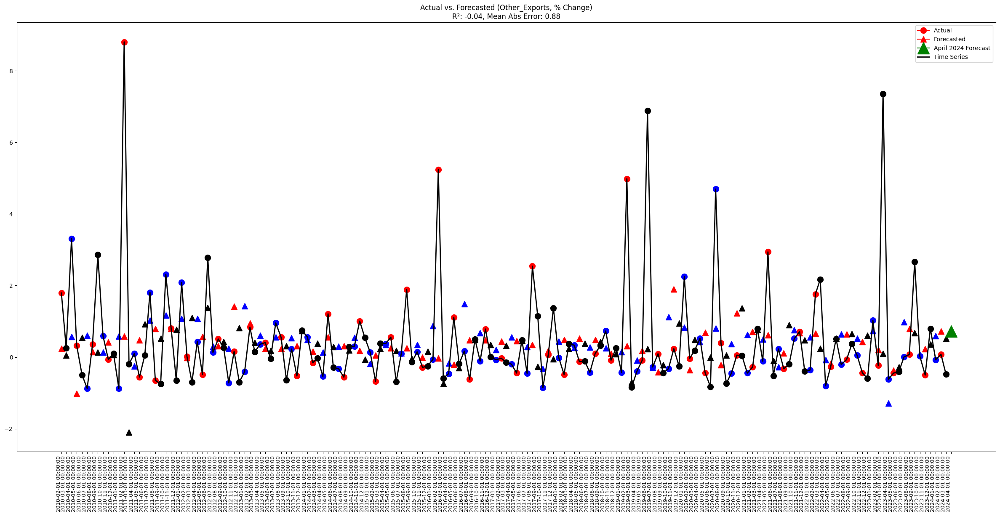

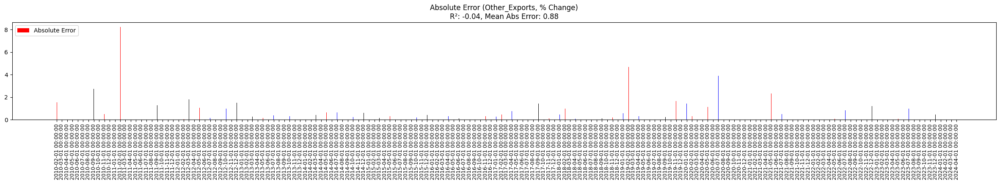

In [84]:
df = df_export_ANALYSIS[[name]]

df.plot(title=f"Export Value ({name})", label=f"{name}")
df.pct_change().plot(title=f"Export Value % Change ({name})", label=f"{name} % Change")
ts = df.pct_change().dropna()
display("Timeseries of component in % form:")
display(ts)
display("-" * 150)

### check if the data timeseries & statistical assumptions validity (stationary, seasonality, autocorrelation)
#freq 12 is used since the data is monthly, so the seasonality is 12 months YoY
display("Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):")
display(check_time_series_assumptions(ts, freq=12))
display("-" * 150)

#read the pickle file
with open(f'data/cleaned/deseasonalised_x13/update/dict_deseasonalized_value_{name}.pickle', 'rb') as handle:
    dict_deseasonalized_value = pickle.load(handle)[name]
adj_ts = dict_deseasonalized_value['seasadj'].pct_change().dropna()
display("Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):")
check_time_series_assumptions(adj_ts, freq=12)
display("-" * 150)

df_accuracy = pd.read_pickle(f"data/cleaned/SARIMA_RollWalkForward/combined/updated/accuracy/df_accuracy_{name}.pickle")
df_accuracy.columns.name = name
#Forecast are all Out-Of-Sample on a rolling basis
display("Data of Actual vs Forecasted values with error metrics:")
display(df_accuracy)
display("-" * 150)

#Plot Actual vs Forecasted values with error metrics
average_abs_error = df_accuracy["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_accuracy, name)


## Re-Exports_1

In [85]:
df = df_export_ANALYSIS.copy()
name = df.columns[35]
display(f"Component: {name}")

'Component: Re-Exports_1'

'Timeseries of component in % form:'

class,Re-Exports_1
1995-02-01,-0.580420
1995-03-01,0.300000
1995-04-01,0.139423
1995-05-01,-0.094233
1995-06-01,0.031056
...,...
2023-11-01,0.692355
2023-12-01,-0.583607
2024-01-01,0.902887
2024-02-01,-0.383908


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -18.68154826795235
p-value: 2.041775341822564e-30
Critical Value 1%: -3.449226932880019
Critical Value 5%: -2.869857365438656
Critical Value 10%: -2.571201085130664
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.10444799720805127
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


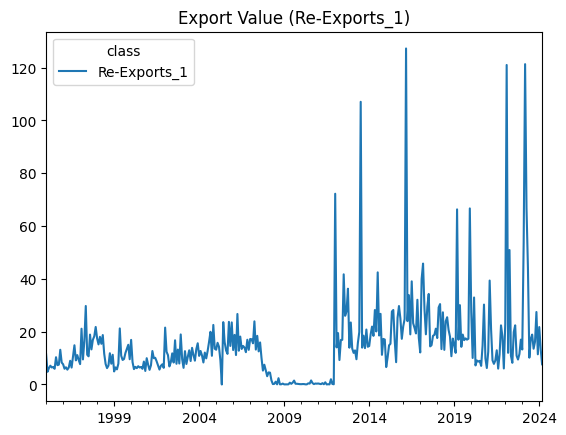

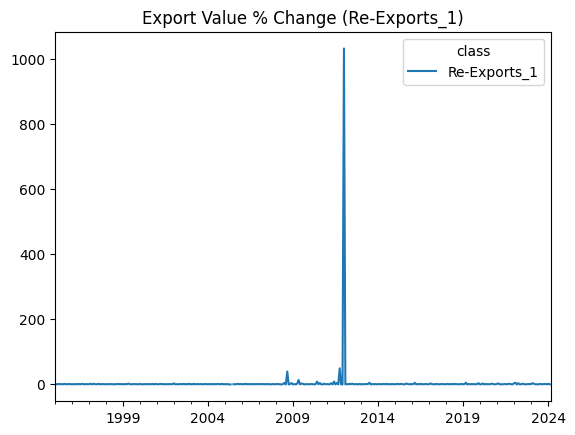

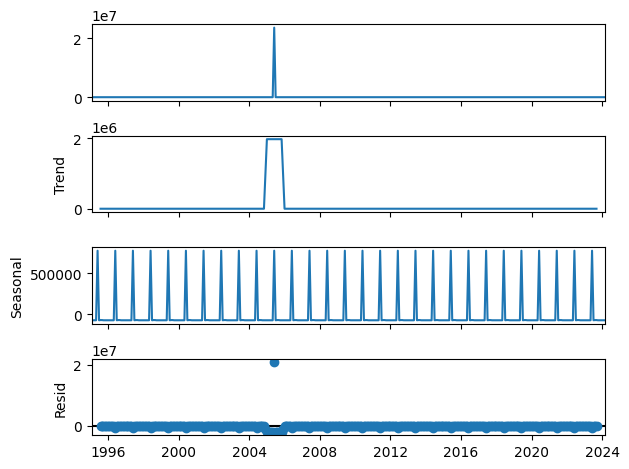


Plotting Residuals for Homoscedasticity Check...


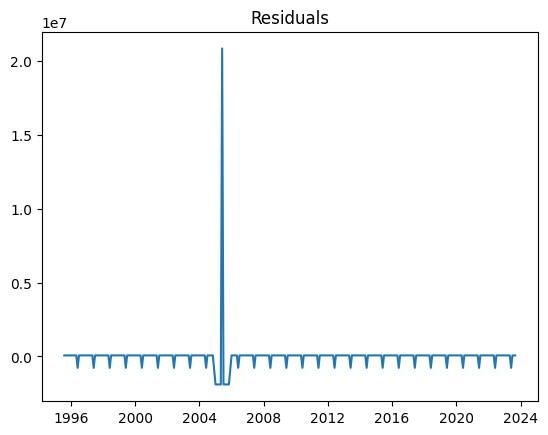

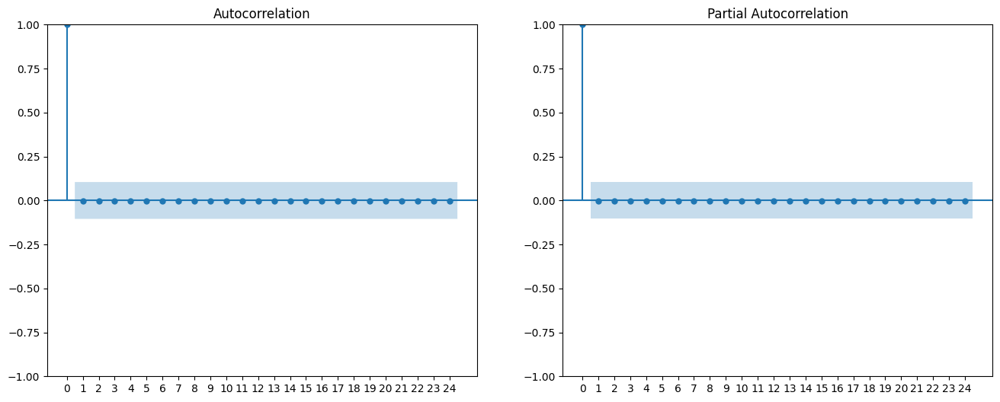


Time series assumptions are met.


True

'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -18.72356949487054
p-value: 2.032193647609522e-30
Critical Value 1%: -3.449226932880019
Critical Value 5%: -2.869857365438656
Critical Value 10%: -2.571201085130664
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.10370071594865692
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


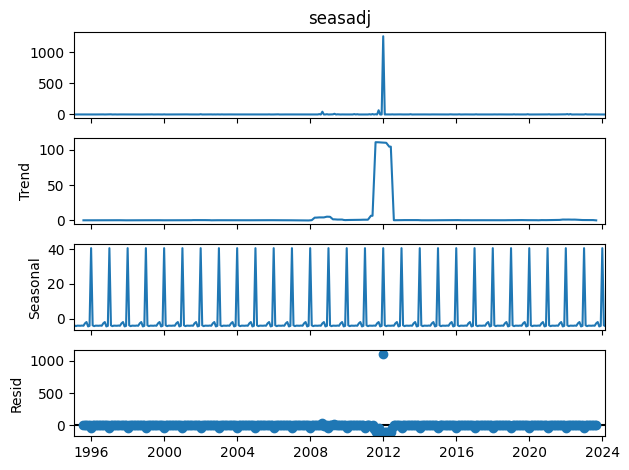


Plotting Residuals for Homoscedasticity Check...


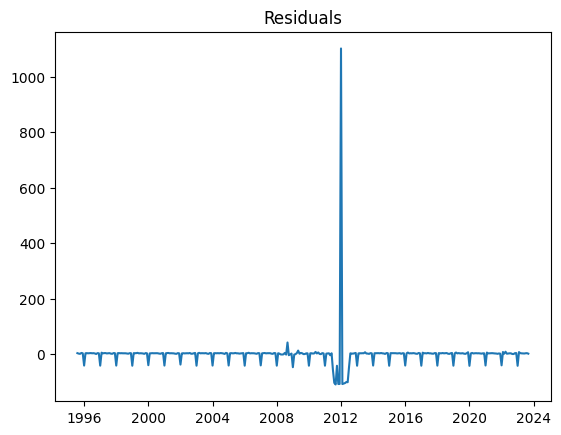

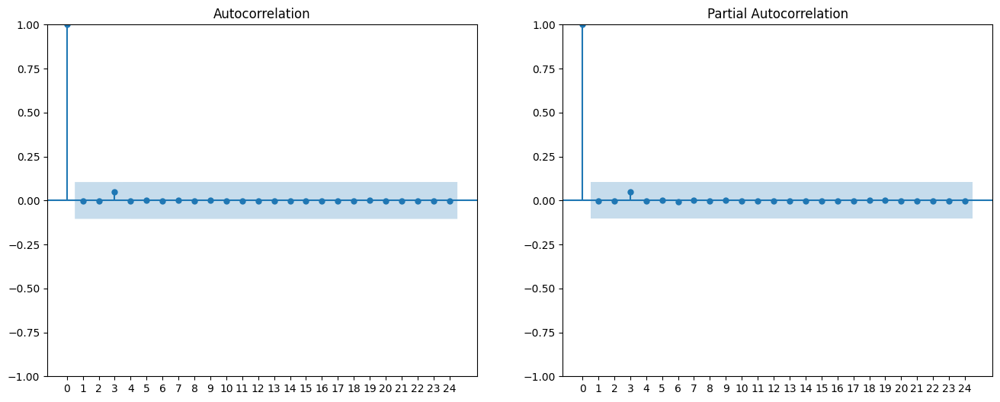


Time series assumptions are met.


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Data of Actual vs Forecasted values with error metrics:'

Re-Exports_1,actual,forecast,error,abs_error,squared_error,abs_percentage_error
2010-02-01,0.366390,0.423256,-0.056866,0.056866,0.003234,0.155206
2010-03-01,0.121134,0.422942,-0.301809,0.301809,0.091088,2.491537
2010-04-01,-0.658208,0.421284,-1.079492,1.079492,1.165302,1.640047
2010-05-01,-0.178775,0.415385,-0.594160,0.594160,0.353026,3.323512
2010-06-01,5.207109,0.412156,4.794954,4.794954,22.991579,0.920847
...,...,...,...,...,...,...
2023-12-01,-0.459824,0.000000,-0.459824,0.459824,0.211438,1.000000
2024-01-01,0.331094,0.000000,0.331094,0.331094,0.109623,1.000000
2024-02-01,-0.149089,0.000000,-0.149089,0.149089,0.022228,1.000000
2024-03-01,-0.615727,0.000000,-0.615727,0.615727,0.379119,1.000000


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Total Mean Absolute Error (Per Forecast): 23.398866459506547'

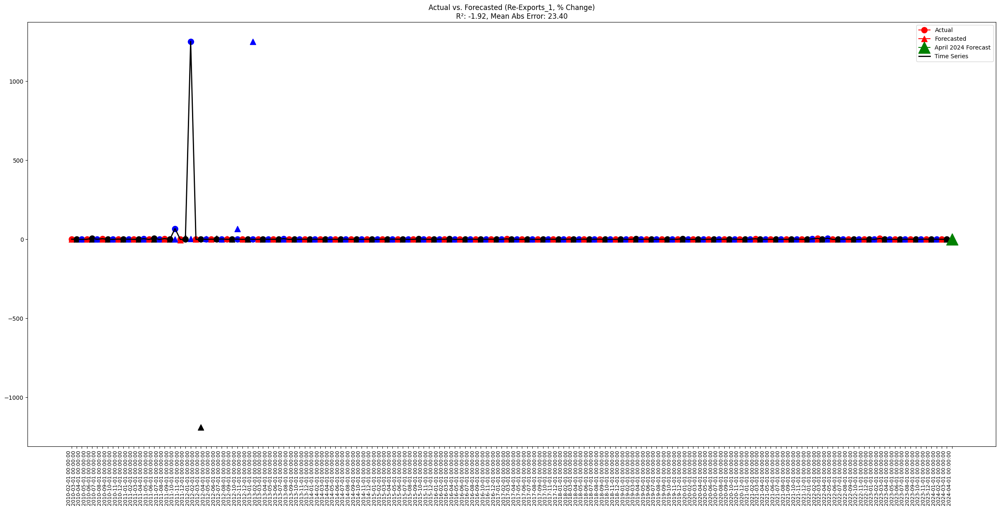

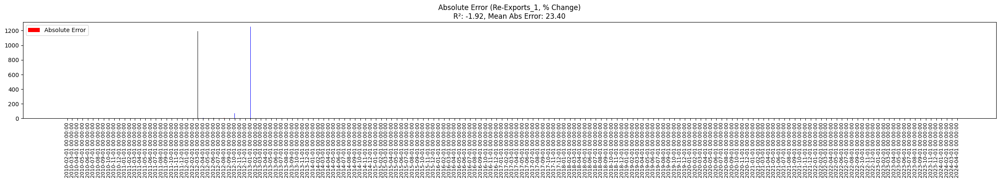

In [86]:
df = df_export_ANALYSIS[[name]]

df.plot(title=f"Export Value ({name})", label=f"{name}")
df.pct_change().plot(title=f"Export Value % Change ({name})", label=f"{name} % Change")
ts = df.replace([np.inf, -np.inf], np.nan).replace(0, 1e-6).ffill().bfill().pct_change().dropna()
display("Timeseries of component in % form:")
display(ts)
display("-" * 150)

### check if the data timeseries & statistical assumptions validity (stationary, seasonality, autocorrelation)
#freq 12 is used since the data is monthly, so the seasonality is 12 months YoY
display("Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):")
display(check_time_series_assumptions(ts, freq=12))
display("-" * 150)

#read the pickle file
with open(f'data/cleaned/deseasonalised_x13/update/dict_deseasonalized_value_{name}.pickle', 'rb') as handle:
    dict_deseasonalized_value = pickle.load(handle)[name]
adj_ts = dict_deseasonalized_value['seasadj'].pct_change().dropna()
display("Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):")
check_time_series_assumptions(adj_ts, freq=12)
display("-" * 150)

df_accuracy = pd.read_pickle(f"data/cleaned/SARIMA_RollWalkForward/combined/updated/accuracy/df_accuracy_{name}.pickle")
df_accuracy.columns.name = name
#Forecast are all Out-Of-Sample on a rolling basis
display("Data of Actual vs Forecasted values with error metrics:")
display(df_accuracy)
display("-" * 150)

#Plot Actual vs Forecasted values with error metrics
average_abs_error = df_accuracy["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_accuracy, name)


## Forecast to actual is quite tightly bound except for some forecast which are extreme outlier, as such, this model will benefit from percentile regualtion of forecast

'Timeseries of component in % form:'

class,Re-Exports_1
1995-02-01,-0.580420
1995-03-01,0.300000
1995-04-01,0.139423
1995-05-01,-0.094233
1995-06-01,0.031056
...,...
2023-11-01,0.692355
2023-12-01,-0.583607
2024-01-01,0.902887
2024-02-01,-0.383908


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -18.68154826795235
p-value: 2.041775341822564e-30
Critical Value 1%: -3.449226932880019
Critical Value 5%: -2.869857365438656
Critical Value 10%: -2.571201085130664
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.10444799720805127
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


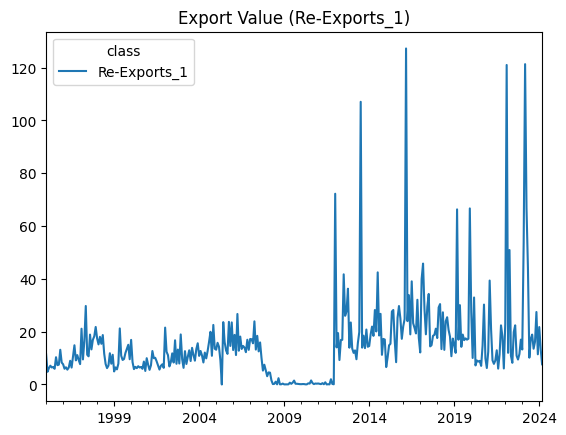

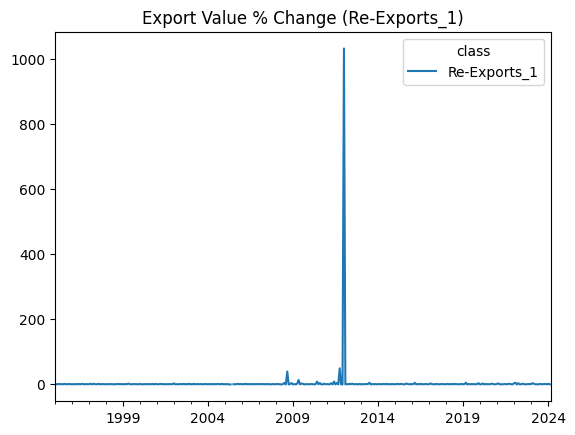

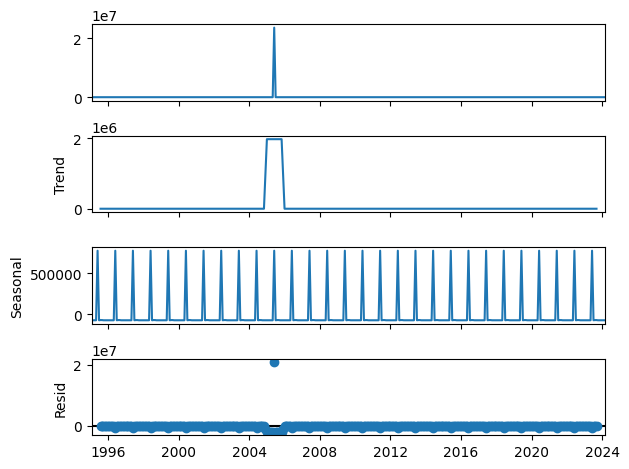


Plotting Residuals for Homoscedasticity Check...


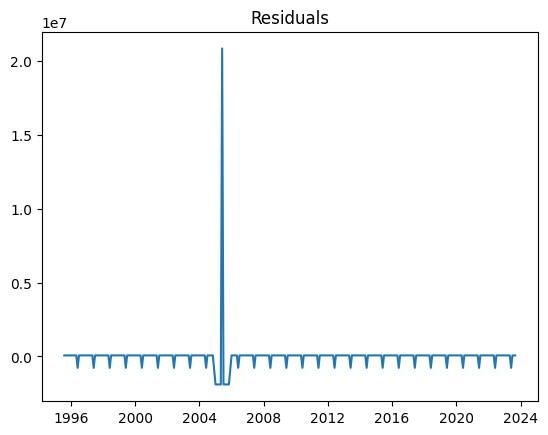

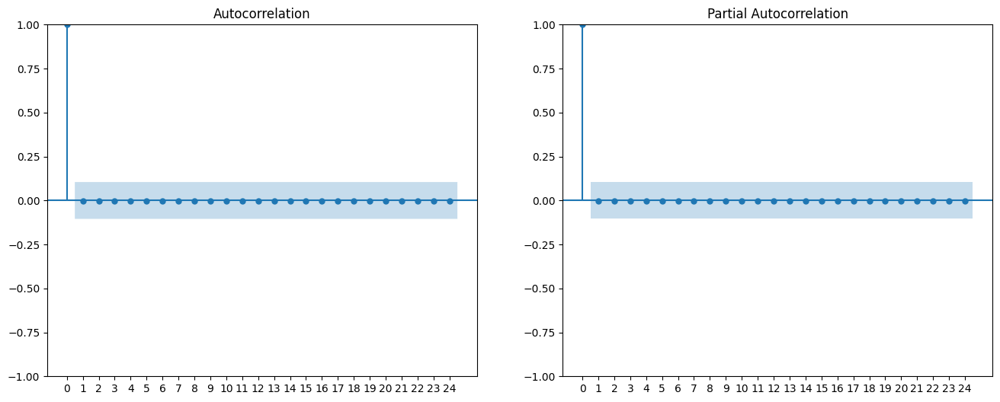


Time series assumptions are met.


True

'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -18.72356949487054
p-value: 2.032193647609522e-30
Critical Value 1%: -3.449226932880019
Critical Value 5%: -2.869857365438656
Critical Value 10%: -2.571201085130664
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.10370071594865692
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


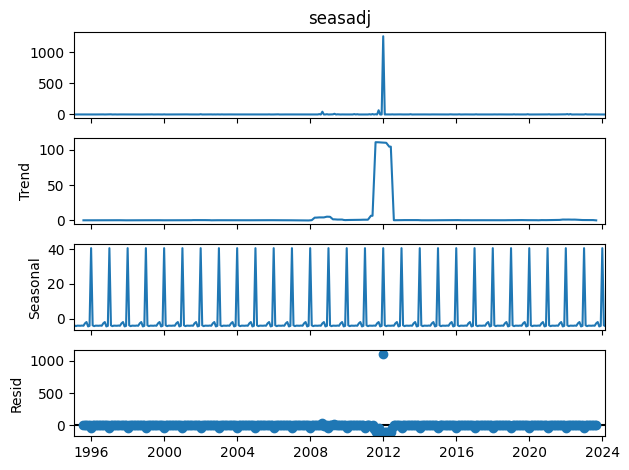


Plotting Residuals for Homoscedasticity Check...


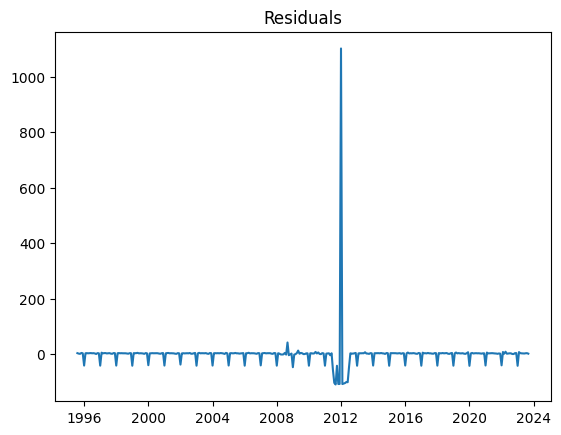

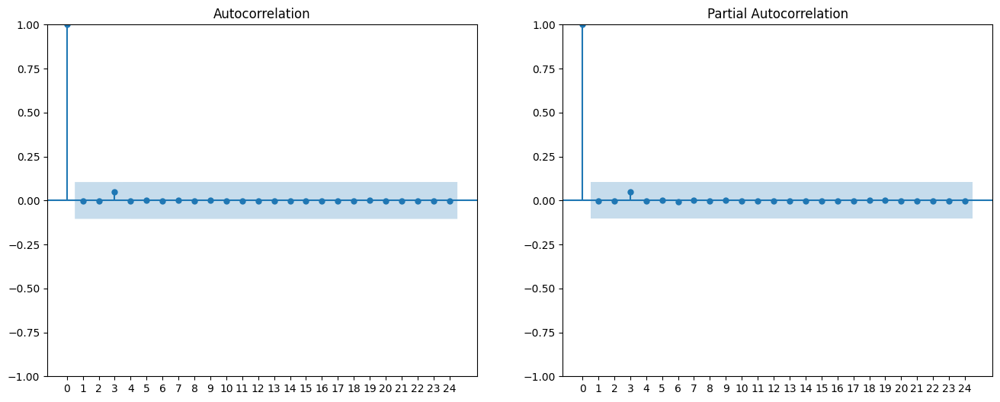


Time series assumptions are met.


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Data of Actual vs Forecasted values with error metrics:'

Re-Exports_1,actual,forecast,error,abs_error,squared_error,abs_percentage_error
2010-02-01,0.366390,0.0,-0.056866,0.056866,0.003234,0.155206
2010-03-01,0.121134,0.0,-0.301809,0.301809,0.091088,2.491537
2010-04-01,-0.658208,0.0,-1.079492,1.079492,1.165302,1.640047
2010-05-01,-0.178775,0.0,-0.594160,0.594160,0.353026,3.323512
2010-06-01,5.207109,0.0,4.794954,4.794954,22.991579,0.920847
...,...,...,...,...,...,...
2023-12-01,-0.459824,0.0,-0.459824,0.459824,0.211438,1.000000
2024-01-01,0.331094,0.0,0.331094,0.331094,0.109623,1.000000
2024-02-01,-0.149089,0.0,-0.149089,0.149089,0.022228,1.000000
2024-03-01,-0.615727,0.0,-0.615727,0.615727,0.379119,1.000000


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Total Mean Absolute Error (Per Forecast): 23.398866459506547'

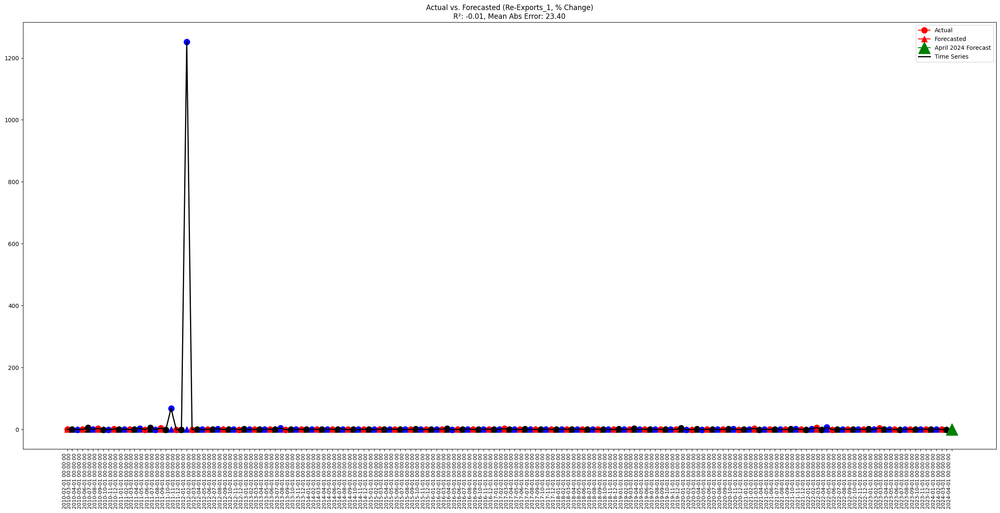

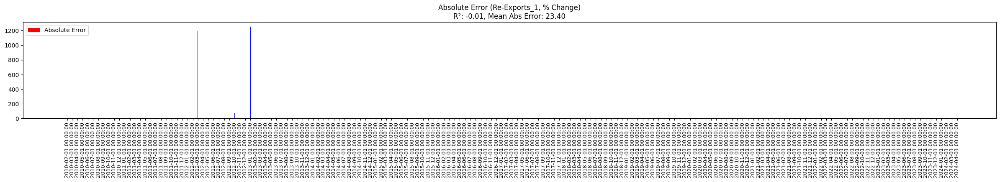

In [87]:
df = df_export_ANALYSIS[[name]]

df.plot(title=f"Export Value ({name})", label=f"{name}")
df.pct_change().plot(title=f"Export Value % Change ({name})", label=f"{name} % Change")
ts = df.replace([np.inf, -np.inf], np.nan).replace(0, 1e-6).ffill().bfill().pct_change().dropna()
display("Timeseries of component in % form:")
display(ts)
display("-" * 150)

### check if the data timeseries & statistical assumptions validity (stationary, seasonality, autocorrelation)
#freq 12 is used since the data is monthly, so the seasonality is 12 months YoY
display("Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):")
display(check_time_series_assumptions(ts, freq=12))
display("-" * 150)

#read the pickle file
with open(f'data/cleaned/deseasonalised_x13/update/dict_deseasonalized_value_{name}.pickle', 'rb') as handle:
    dict_deseasonalized_value = pickle.load(handle)[name]
adj_ts = dict_deseasonalized_value['seasadj'].pct_change().dropna()
display("Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):")
check_time_series_assumptions(adj_ts, freq=12)
display("-" * 150)

df_accuracy = pd.read_pickle(f"data/cleaned/SARIMA_RollWalkForward/combined/updated/accuracy/df_accuracy_{name}.pickle")
df_accuracy.columns.name = name
df_accuracy["forecast"] = cap_extreme_values(df_accuracy[["forecast"]])["forecast"].dropna() ####CAP IS APPLIED HERE####
#Forecast are all Out-Of-Sample on a rolling basis
display("Data of Actual vs Forecasted values with error metrics:")
display(df_accuracy)
display("-" * 150)

#Plot Actual vs Forecasted values with error metrics
average_abs_error = df_accuracy["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_accuracy, name)


## Total_Exports_(Customs_basis)

In [88]:
df = df_export_ANALYSIS.copy()
name = df.columns[36]
display(f"Component: {name}")

'Component: Total_Exports_(Customs_basis)'

'Timeseries of component in % form:'

class,Total_Exports_(Customs_basis)
1995-02-01,-0.000100
1995-03-01,0.298815
1995-04-01,-0.216444
1995-05-01,0.200359
1995-06-01,0.029700
...,...
2023-11-01,-0.004204
2023-12-01,-0.029309
2024-01-01,-0.006216
2024-02-01,0.032450


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -5.462761935574315
p-value: 2.497258809301555e-06
Critical Value 1%: -3.449846029628477
Critical Value 5%: -2.870129281376164
Critical Value 10%: -2.5713460670144603
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.05742973139965504
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


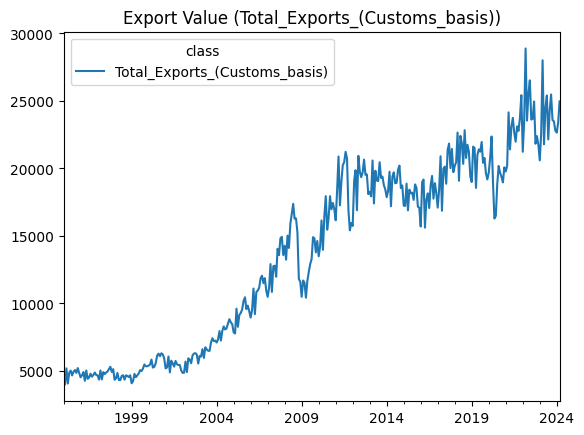

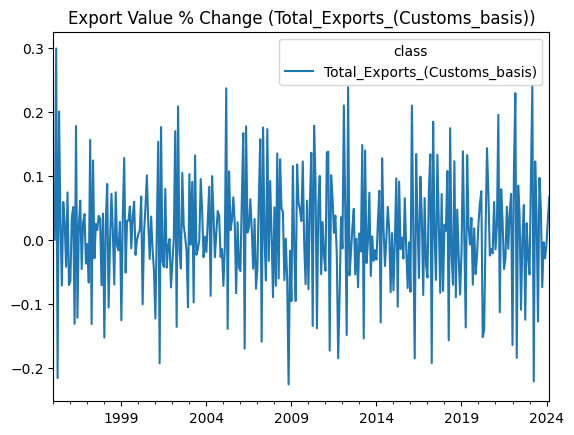

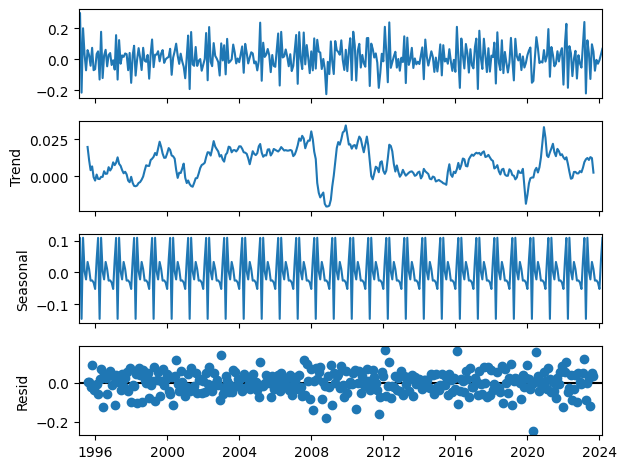


Plotting Residuals for Homoscedasticity Check...


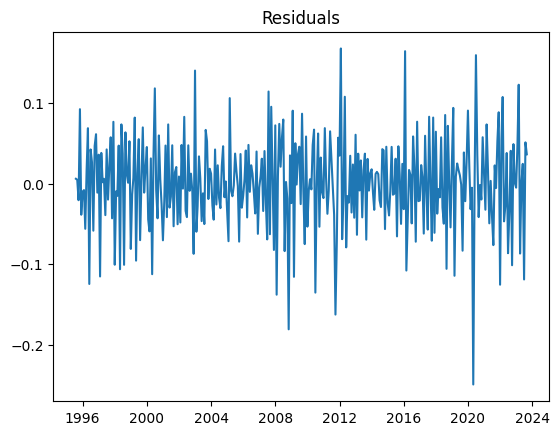

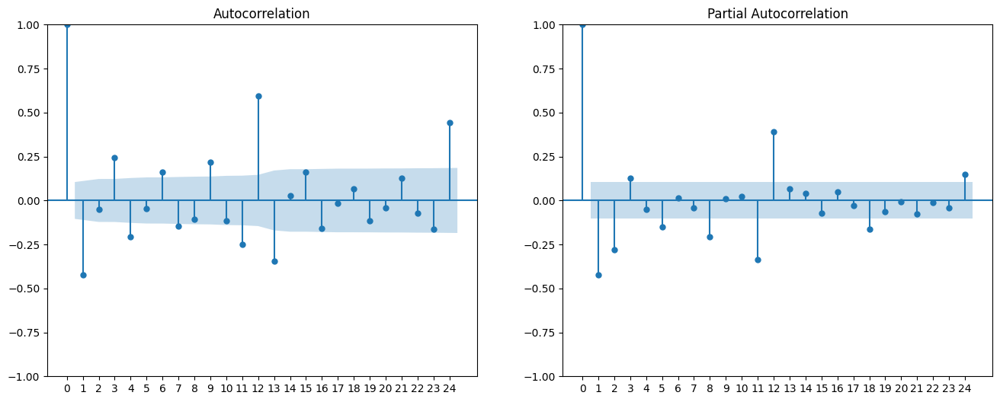


Time series assumptions are met.


True

'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -6.164918773971001
p-value: 7.027775472688554e-08
Critical Value 1%: -3.4497304638968043
Critical Value 5%: -2.8700785273763487
Critical Value 10%: -2.571319005190311
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.12172401106495867
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


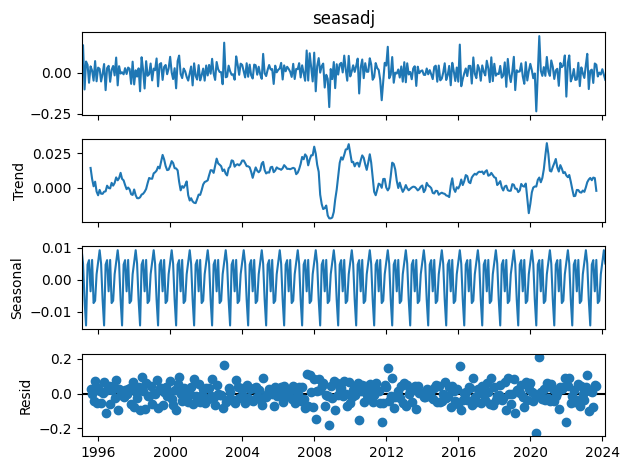


Plotting Residuals for Homoscedasticity Check...


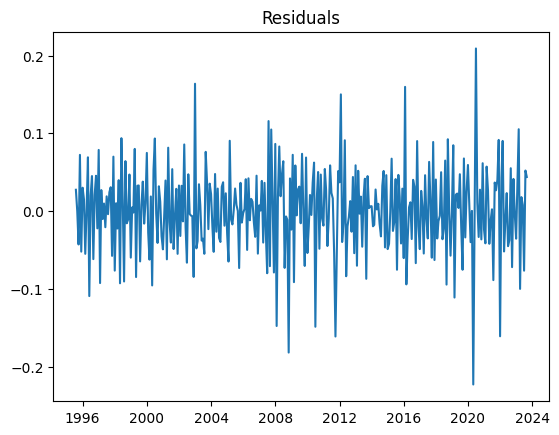

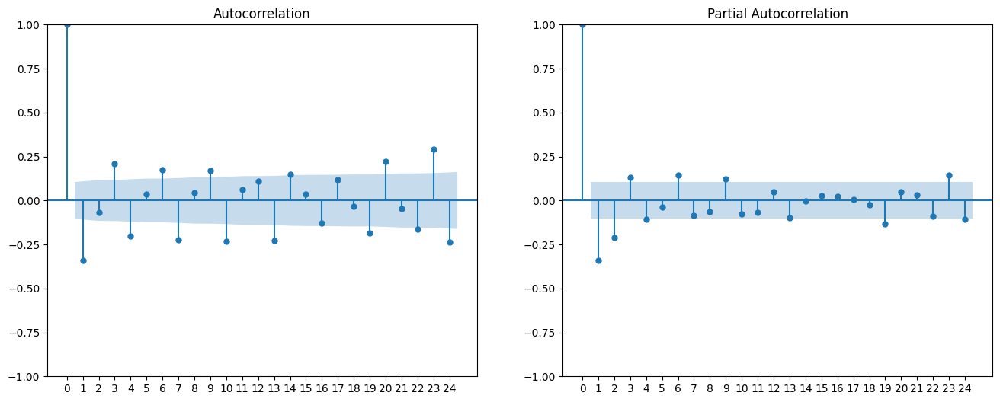


Time series assumptions are met.


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Data of Actual vs Forecasted values with error metrics:'

Total_Exports_(Customs_basis),actual,forecast,error,abs_error,squared_error,abs_percentage_error
2010-02-01,0.007756,0.025254,-0.017497,0.017497,0.000306,2.255919
2010-03-01,0.044331,0.023303,0.021028,0.021028,0.000442,0.474333
2010-04-01,0.004051,-0.027061,0.031113,0.031113,0.000968,7.679391
2010-05-01,0.039930,-0.011500,0.051430,0.051430,0.002645,1.288014
2010-06-01,0.084999,0.010934,0.074065,0.074065,0.005486,0.871364
...,...,...,...,...,...,...
2023-12-01,-0.011903,-0.005668,-0.006236,0.006236,0.000039,0.523851
2024-01-01,0.020506,-0.006954,0.027460,0.027460,0.000754,1.339095
2024-02-01,-0.013592,0.041115,-0.054708,0.054708,0.002993,4.024859
2024-03-01,-0.044153,-0.014255,-0.029898,0.029898,0.000894,0.677146


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Total Mean Absolute Error (Per Forecast): 0.03944135928483341'

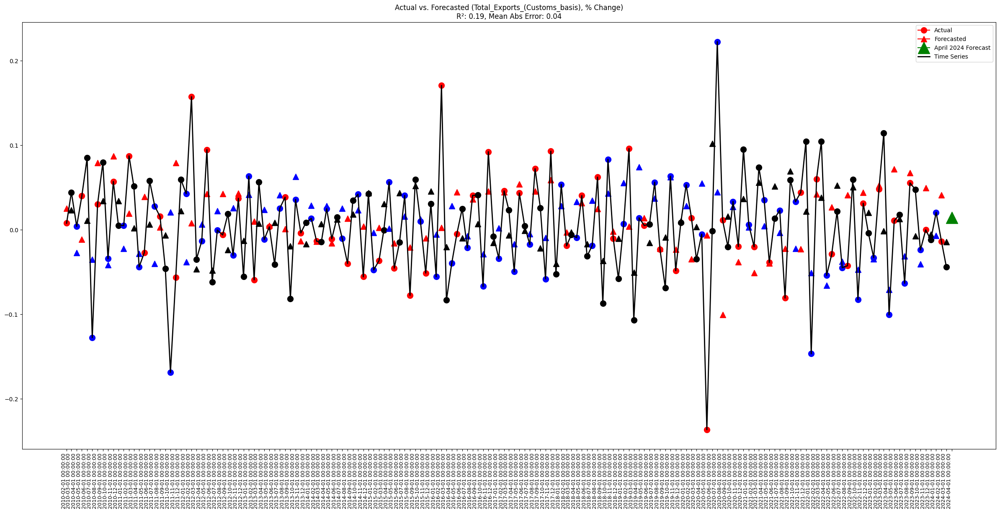

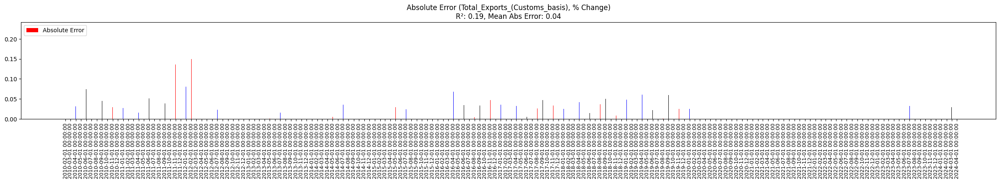

In [89]:
df = df_export_ANALYSIS[[name]]

df.plot(title=f"Export Value ({name})", label=f"{name}")
df.pct_change().plot(title=f"Export Value % Change ({name})", label=f"{name} % Change")
ts = df.pct_change().dropna()
display("Timeseries of component in % form:")
display(ts)
display("-" * 150)

### check if the data timeseries & statistical assumptions validity (stationary, seasonality, autocorrelation)
#freq 12 is used since the data is monthly, so the seasonality is 12 months YoY
display("Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):")
display(check_time_series_assumptions(ts, freq=12))
display("-" * 150)

#read the pickle file
with open(f'data/cleaned/deseasonalised_x13/update/dict_deseasonalized_value_{name}.pickle', 'rb') as handle:
    dict_deseasonalized_value = pickle.load(handle)[name]
adj_ts = dict_deseasonalized_value['seasadj'].pct_change().dropna()
display("Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):")
check_time_series_assumptions(adj_ts, freq=12)
display("-" * 150)

df_accuracy = pd.read_pickle(f"data/cleaned/SARIMA_RollWalkForward/combined/updated/accuracy/df_accuracy_{name}.pickle")
df_accuracy.columns.name = name
#Forecast are all Out-Of-Sample on a rolling basis
display("Data of Actual vs Forecasted values with error metrics:")
display(df_accuracy)
display("-" * 150)

#Plot Actual vs Forecasted values with error metrics
average_abs_error = df_accuracy["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_accuracy, name)


## Coverage_Adjustment

In [90]:
df = df_export_ANALYSIS.copy()
name = df.columns[37]
display(f"Component: {name}")

'Component: Coverage_Adjustment'

'Timeseries of component in % form:'

class,Coverage_Adjustment
1995-02-01,-0.316990
1995-03-01,1.296899
1995-04-01,-0.425928
1995-05-01,0.503618
1995-06-01,-0.098994
...,...
2023-11-01,0.604792
2023-12-01,0.082835
2024-01-01,0.550565
2024-02-01,-0.453620


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -18.61738404728031
p-value: 2.062661680538337e-30
Critical Value 1%: -3.449226932880019
Critical Value 5%: -2.869857365438656
Critical Value 10%: -2.571201085130664
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.2308992478719636
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


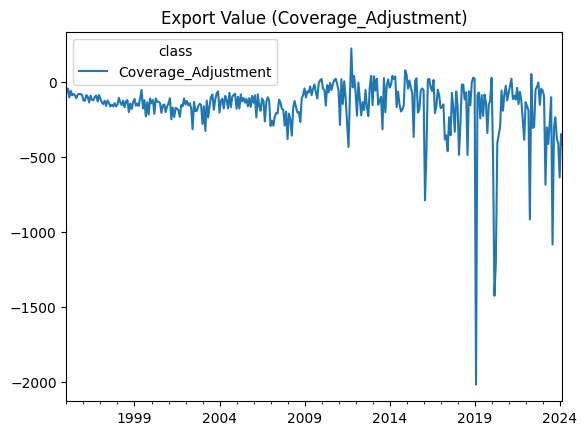

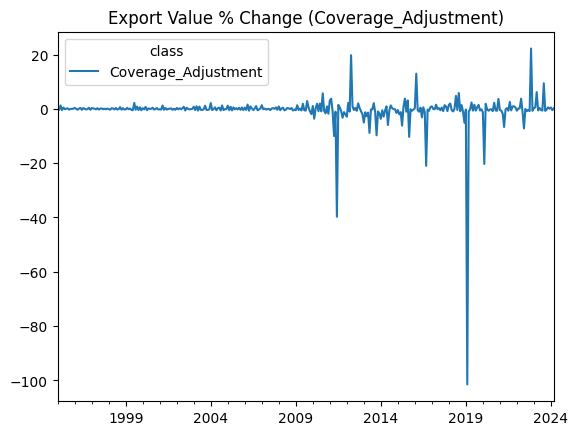

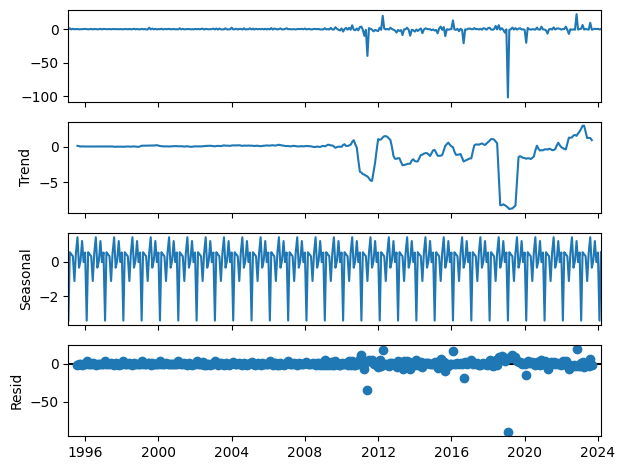


Plotting Residuals for Homoscedasticity Check...


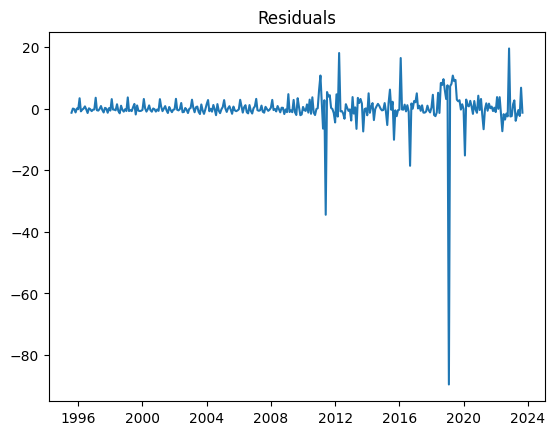

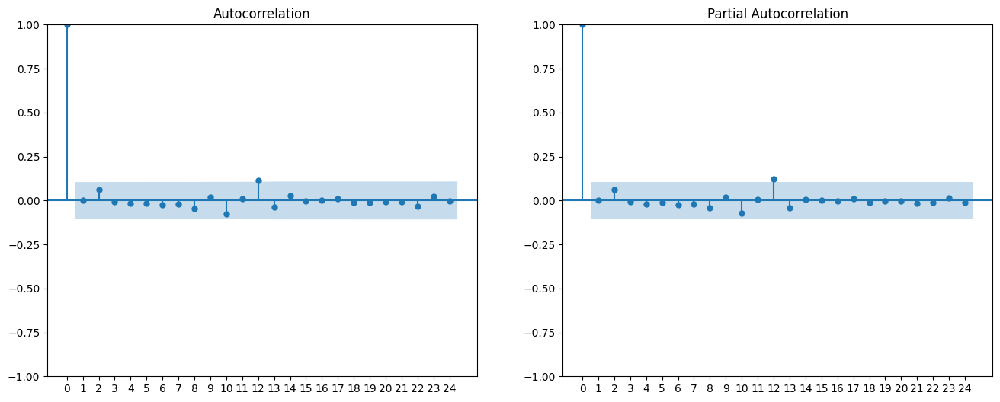


Time series assumptions are met.


True

'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -2.942814871532678
p-value: 0.040590954217201825
Critical Value 1%: -3.450081345901191
Critical Value 5%: -2.870232621465807
Critical Value 10%: -2.571401168202517
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.48846664309019094
p-value: 0.044264269574281326
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: False

Decomposing the Series...


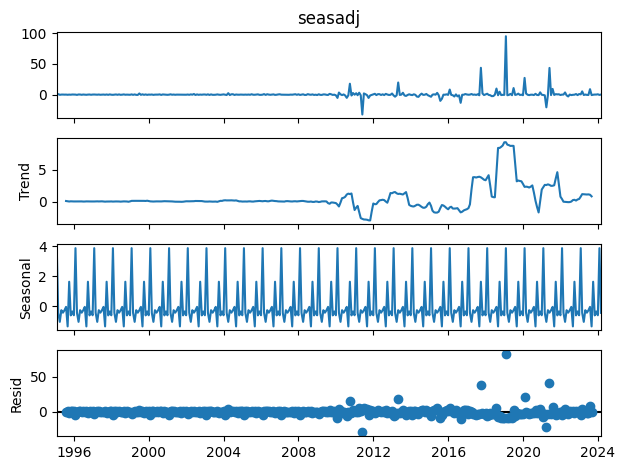


Plotting Residuals for Homoscedasticity Check...


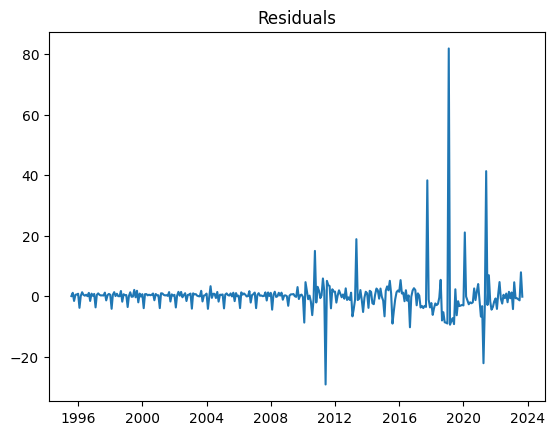

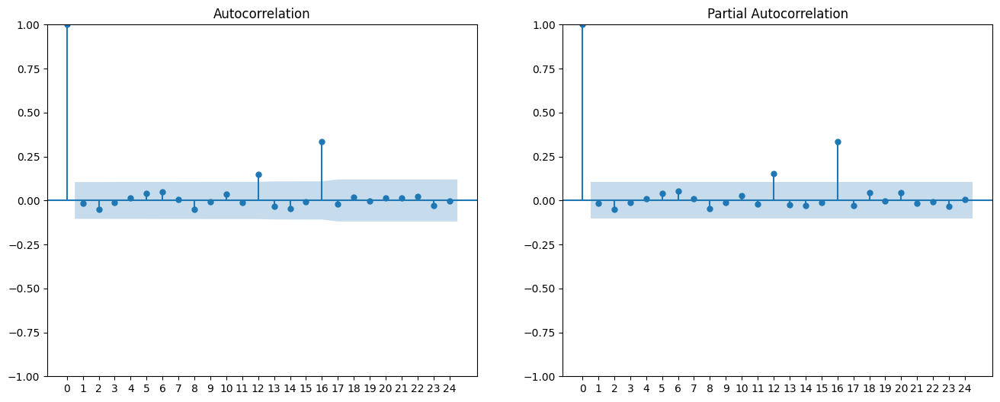


Time series assumptions are not met. Further investigation needed.


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Data of Actual vs Forecasted values with error metrics:'

Coverage_Adjustment,actual,forecast,error,abs_error,squared_error,abs_percentage_error
2010-02-01,-5.297214,0.604674,-5.901888,5.901888,34.832284,1.114149
2010-03-01,3.429791,0.251969,3.177822,3.177822,10.098553,0.926535
2010-04-01,0.573724,-0.108074,0.681798,0.681798,0.464849,1.188373
2010-05-01,-0.732752,0.298221,-1.030973,1.030973,1.062904,1.406987
2010-06-01,0.362550,0.345022,0.017527,0.017527,0.000307,0.048344
...,...,...,...,...,...,...
2023-12-01,0.152881,1.084302,-0.931421,0.931421,0.867544,6.092452
2024-01-01,0.615977,1.339454,-0.723478,0.723478,0.523420,1.174522
2024-02-01,-0.451317,1.213539,-1.664857,1.664857,2.771748,3.688882
2024-03-01,0.135495,1.917972,-1.782477,1.782477,3.177223,13.155284


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Total Mean Absolute Error (Per Forecast): 3.7708927618355332'

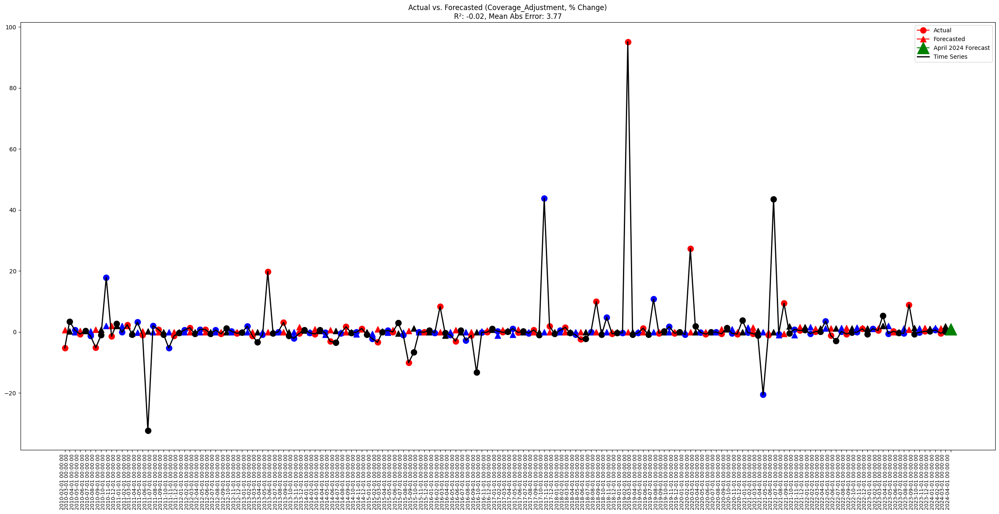

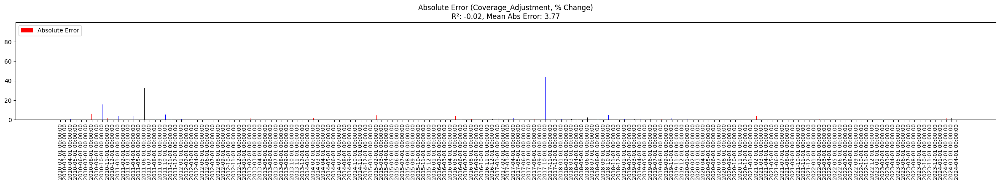

In [91]:
df = df_export_ANALYSIS[[name]]

df.plot(title=f"Export Value ({name})", label=f"{name}")
df.pct_change().plot(title=f"Export Value % Change ({name})", label=f"{name} % Change")
ts = df.pct_change().dropna()
display("Timeseries of component in % form:")
display(ts)
display("-" * 150)

### check if the data timeseries & statistical assumptions validity (stationary, seasonality, autocorrelation)
#freq 12 is used since the data is monthly, so the seasonality is 12 months YoY
display("Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):")
display(check_time_series_assumptions(ts, freq=12))
display("-" * 150)

#read the pickle file
with open(f'data/cleaned/deseasonalised_x13/update/dict_deseasonalized_value_{name}.pickle', 'rb') as handle:
    dict_deseasonalized_value = pickle.load(handle)[name]
adj_ts = dict_deseasonalized_value['seasadj'].pct_change().dropna()
display("Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):")
check_time_series_assumptions(adj_ts, freq=12)
display("-" * 150)

df_accuracy = pd.read_pickle(f"data/cleaned/SARIMA_RollWalkForward/combined/updated/accuracy/df_accuracy_{name}.pickle")
df_accuracy.columns.name = name
df_accuracy["forecast"] = cap_extreme_values(df_accuracy[["forecast"]])["forecast"].dropna() ####CAP IS APPLIED HERE####
#Forecast are all Out-Of-Sample on a rolling basis
display("Data of Actual vs Forecasted values with error metrics:")
display(df_accuracy)
display("-" * 150)

#Plot Actual vs Forecasted values with error metrics
average_abs_error = df_accuracy["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_accuracy, name)

## `Timing_Adjustment` has too few significant AR points with random shocks, would be better to omit and no-change at 0

## Exports,_f.o.b._(BOP_basis)

In [92]:
df = df_export_ANALYSIS.copy()
name = df.columns[39]
display(f"Component: {name}")

'Component: Exports,_f.o.b._(BOP_basis)'

'Timeseries of component in % form:'

class,"Exports,_f.o.b._(BOP_basis)"
1995-02-01,0.005346
1995-03-01,0.287161
1995-04-01,-0.212079
1995-05-01,0.195755
1995-06-01,0.032157
...,...
2023-11-01,-0.010378
2023-12-01,-0.031152
2024-01-01,-0.016448
2024-02-01,0.046531


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -4.878580924094646
p-value: 3.8381529130956075e-05
Critical Value 1%: -3.4502011472639724
Critical Value 5%: -2.8702852297358983
Critical Value 10%: -2.5714292194077513
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.06865483610896644
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


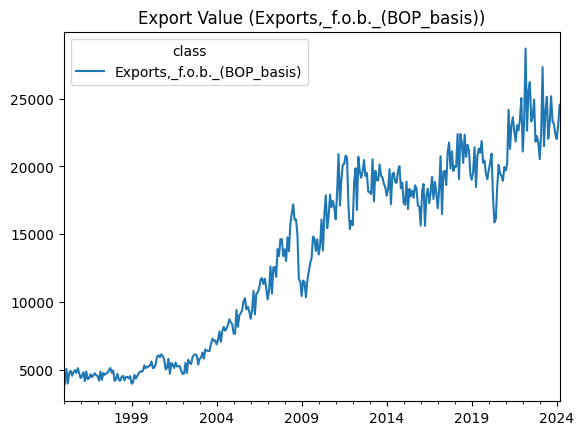

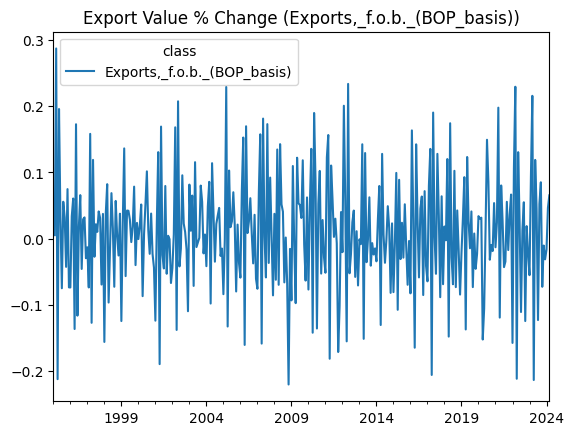

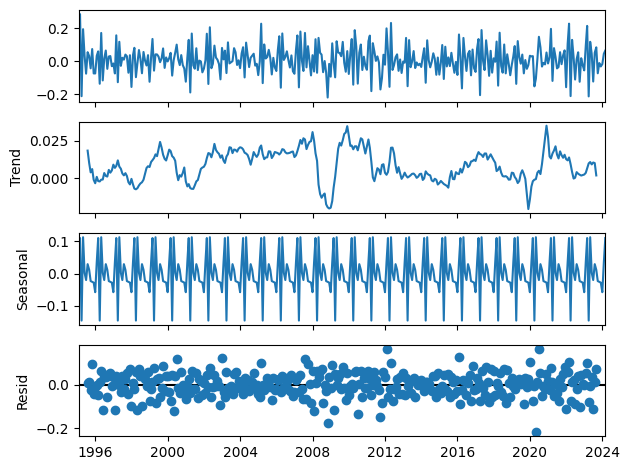


Plotting Residuals for Homoscedasticity Check...


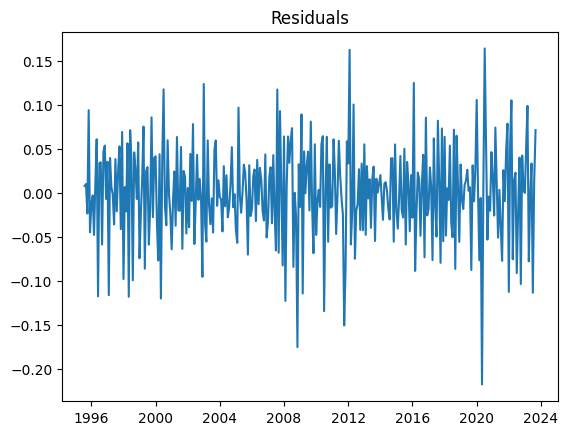

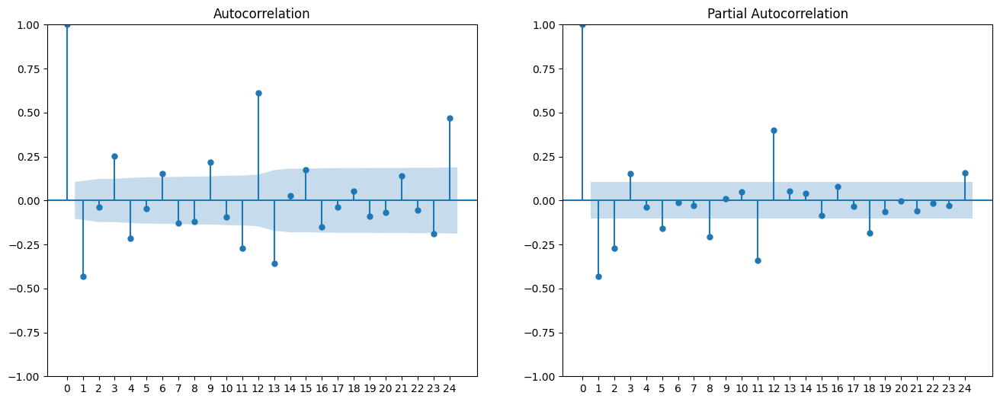


Time series assumptions are met.


True

'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):'

Running ADF Test for Stationarity...
ADF Statistic: -7.1806422891222725
p-value: 2.655476784300986e-10
Critical Value 1%: -3.4495033946549123
Critical Value 5%: -2.8699787979596136
Critical Value 10%: -2.5712658305164955
is_stationary: True

Running KPSS Test for Stationarity...
KPSS Statistic: 0.1468459558118012
p-value: 0.1
Critical Value 10%: 0.347
Critical Value 5%: 0.463
Critical Value 2.5%: 0.574
Critical Value 1%: 0.739
is_stationary: True

Decomposing the Series...


/home/wheelfredie/scripts/BoT_Exports/helper.py:61: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result = kpss(series, regression='c')


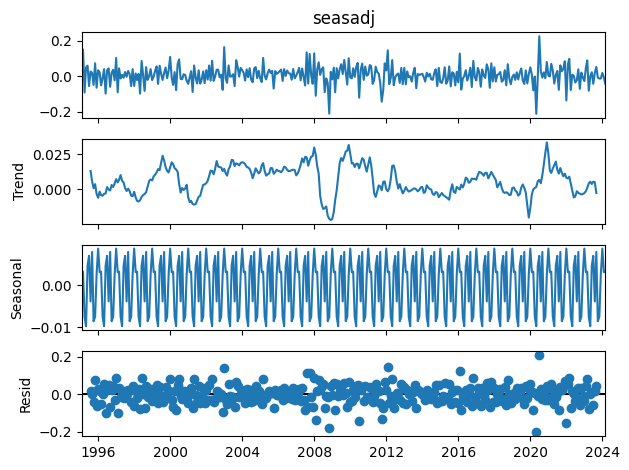


Plotting Residuals for Homoscedasticity Check...


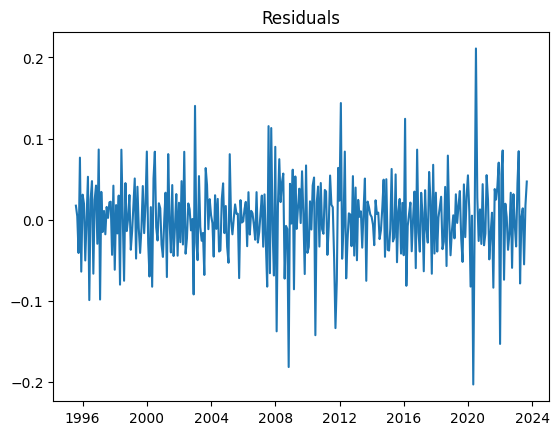

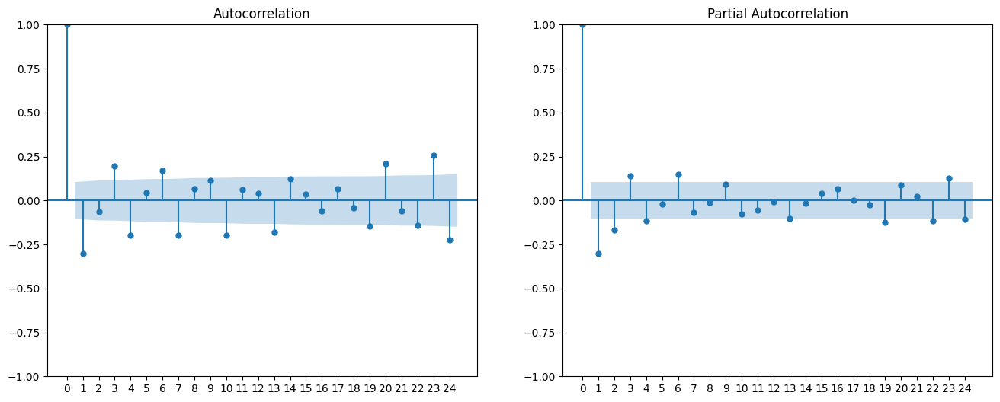


Time series assumptions are met.


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Data of Actual vs Forecasted values with error metrics:'

"Exports,_f.o.b._(BOP_basis)",actual,forecast,error,abs_error,squared_error,abs_percentage_error
2010-02-01,-0.012069,0.007016,-0.019085,0.019085,0.000364,1.581279
2010-03-01,0.044460,0.045477,-0.001017,0.001017,0.000001,0.022878
2010-04-01,-0.003778,-0.028084,0.024306,0.024306,0.000591,6.433609
2010-05-01,0.050561,-0.008684,0.059245,0.059245,0.003510,1.171757
2010-06-01,0.074909,0.016149,0.058760,0.058760,0.003453,0.784413
...,...,...,...,...,...,...
2023-12-01,-0.013067,-0.004826,-0.008241,0.008241,0.000068,0.630679
2024-01-01,0.018430,0.005392,0.013038,0.013038,0.000170,0.707420
2024-02-01,-0.007643,0.036119,-0.043762,0.043762,0.001915,5.725941
2024-03-01,-0.042899,-0.015008,-0.027891,0.027891,0.000778,0.650158


'------------------------------------------------------------------------------------------------------------------------------------------------------'

'Total Mean Absolute Error (Per Forecast): 0.036641612307191554'

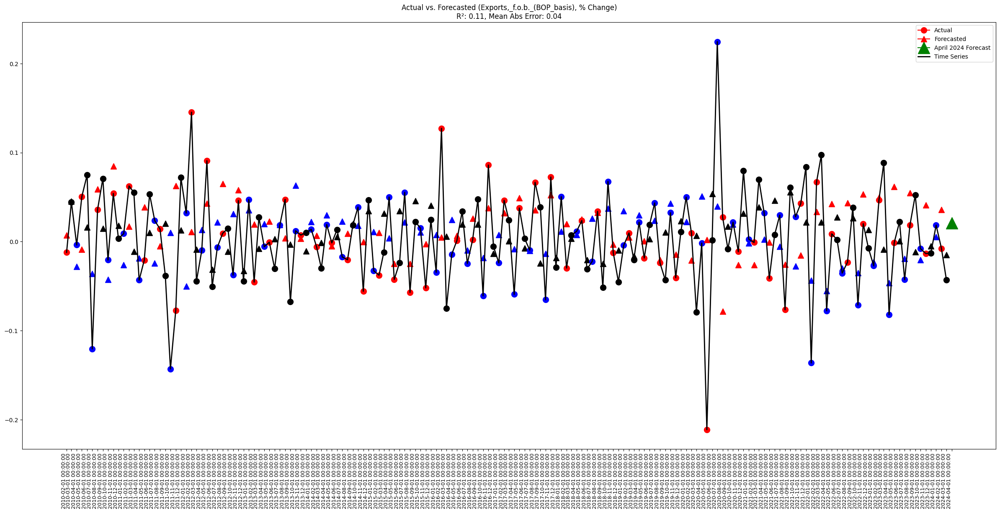

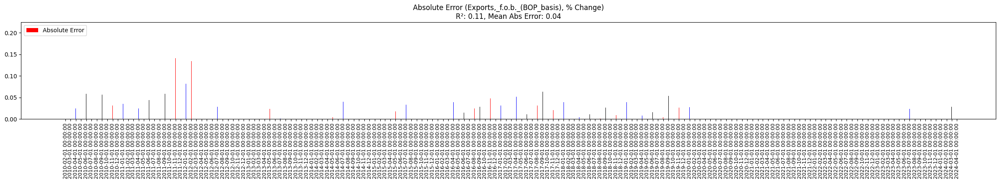

In [93]:
df = df_export_ANALYSIS[[name]]

df.plot(title=f"Export Value ({name})", label=f"{name}")
df.pct_change().plot(title=f"Export Value % Change ({name})", label=f"{name} % Change")
ts = df.pct_change().dropna()
display("Timeseries of component in % form:")
display(ts)
display("-" * 150)

### check if the data timeseries & statistical assumptions validity (stationary, seasonality, autocorrelation)
#freq 12 is used since the data is monthly, so the seasonality is 12 months YoY
display("Statistical Assumptions & Properties Analysis (Pre-Seasonality Adjusted):")
display(check_time_series_assumptions(ts, freq=12))
display("-" * 150)

#read the pickle file
with open(f'data/cleaned/deseasonalised_x13/update/dict_deseasonalized_value_{name}.pickle', 'rb') as handle:
    dict_deseasonalized_value = pickle.load(handle)[name]
adj_ts = dict_deseasonalized_value['seasadj'].pct_change().dropna()
display("Statistical Assumptions & Properties Analysis (POST-Seasonality Adjusted):")
check_time_series_assumptions(adj_ts, freq=12)
display("-" * 150)

df_accuracy = pd.read_pickle(f"data/cleaned/SARIMA_RollWalkForward/combined/updated/accuracy/df_accuracy_{name}.pickle")
df_accuracy.columns.name = name
#Forecast are all Out-Of-Sample on a rolling basis
display("Data of Actual vs Forecasted values with error metrics:")
display(df_accuracy)
display("-" * 150)

#Plot Actual vs Forecasted values with error metrics
average_abs_error = df_accuracy["abs_error"].mean()
display(f"Total Mean Absolute Error (Per Forecast): {average_abs_error}")
plot_actual_vs_forecast(df_accuracy, name)


# Upcoming Notebook `2_composite_weight_analysis.ipynb`: check if weights change drastically across months and Out of Sample forecast of next month(t) using last release(t-1,...,t-ar_lag)

# Upcoming Notebook `3_stitching_series.ipynb`: Restitching the Components into the Total Export Series(BoP) with Error Optimisation